<a href="https://colab.research.google.com/github/jerryzhu1/Have-fun-with-deep-learning----pytorch-tensorflow/blob/master/DCGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install -U -q PyDrive
from pydrive.auth import GoogleAuth

from pydrive.drive import GoogleDrive
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials


In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
download = drive.CreateFile({'id': '1i1M7GQZY5e8TYnFyD0ov-J7YjrI_YIGI'})
download.GetContentFile('data.zip')

In [0]:
!unzip data.zip > /dev/null # Dont show any output
!ls

replace animeface-character-dataset/tools/tag_ja.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: N
adc.json		     data.zip	   gan_plot.png  __MACOSX
animeface-character-dataset  dis_plot.png  images	 sample_data


In [0]:
import os
import glob
os.environ["KERAS_BACKEND"] = "tensorflow"
import numpy as np
from sklearn.utils import shuffle
import time
import cv2
import scipy
from PIL import Image
import matplotlib.gridspec as gridspec
from keras.layers import Dense
from keras.layers import Reshape
from keras.layers.core import Activation
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import UpSampling2D
from keras.layers.pooling import MaxPooling2D
from keras.layers.core import Flatten
from keras.layers import Conv2D, Conv2DTranspose, Dropout
from keras.models import Model
from keras.optimizers import SGD, Adam, RMSprop
from keras.layers.advanced_activations import LeakyReLU
import matplotlib.pyplot as plt
from keras.models import load_model
from keras.utils.vis_utils import plot_model
import keras.backend as K

K.tensorflow_backend._get_available_gpus()

#from scipy.interpolate import spline
# K.set_image_dim_ordering('tf')
K.tensorflow_backend.set_image_dim_ordering('tf')
import numpy as np
from sklearn.utils import shuffle
import tensorflow as tf
from keras.backend.tensorflow_backend import set_session
from keras.layers import Input, merge
from keras.initializers import RandomNormal
# K.set_image_dim_ordering('tf')
K.tensorflow_backend.set_image_dim_ordering('tf')
config = tf.ConfigProto()
config.gpu_options.allow_growth = True 
set_session(tf.Session(config=config))
from collections import deque

Using TensorFlow backend.


In [0]:
filenames = glob.glob('animeface-character-dataset/*/*/*.pn*')

print("Num_Images: ",len(filenames))

Num_Images:  14490


In [0]:
# plt.figure(figsize=(10, 8))
# for i in range(5):
#     img = plt.imread(filenames[i], 0)
#     plt.subplot(4, 5, i+1)
#     plt.imshow(img)
#     plt.title(img.shape)
#     plt.xticks([])
#     plt.yticks([])
# plt.tight_layout()
# plt.show()

In [0]:
# A function to normalize image pixels.
def norm_img(img):
    '''A function to Normalize Images.
    Input:
        img : Original image as numpy array.
    Output: Normailized Image as numpy array
    '''
    img = (img / 127.5) - 1
    return img

def denorm_img(img):
    '''A function to Denormailze, i.e. recreate image from normalized image
    Input:
        img : Normalized image as numpy array.
    Output: Original Image as numpy array
    '''
    img = (img + 1) * 127.5
    return img.astype(np.uint8) 

def sample_from_dataset(batch_size, image_shape, data_dir=None):
    '''Create a batch of image samples by sampling random images from a data directory.
    Resizes the image using image_shape and normalize the images.
    Input:
        batch_size : Sample size required
        image_size : Size that Image should be resized to
        data_dir : Path of directory where training images are placed.

    Output:
        sample : batch of processed images 
    '''
    sample_dim = (batch_size,) + image_shape
    sample = np.empty(sample_dim, dtype=np.float32)
    all_data_dirlist = list(glob.glob(data_dir))
    sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)
    for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        image = image.convert('RGB') 
        image = np.asarray(image)
        image = norm_img(image)
        sample[index,...] = image
    return sample

In [0]:
def gen_noise(batch_size, noise_shape):
    ''' Generates a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)
    Input:
        batch_size : size of batch
        noise_shape: shape of noise vector, normally kept as 100
    Output:a numpy vector sampled from normal distribution of shape (batch_size,noise_shape)     
    '''
    return np.random.normal(0, 1, size=(batch_size,)+noise_shape)

In [0]:
def get_gen_normal(noise_shape):
    ''' This function takes as input shape of the noise vector and creates the Keras generator    architecture.
    '''
    kernel_init = 'glorot_uniform'    
    gen_input = Input(shape = noise_shape) 
    
    # Transpose 2D conv layer 1. 
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 2.
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 3.
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 4.
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # conv 2D layer 1.
    generator = Conv2D(filters = 64, kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Final Transpose 2D conv layer 5 to generate final image. Filter size 3 for 3 image channel
    generator = Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    
    # Tanh activation to get final normalized image
    generator = Activation('tanh')(generator)
    
    # defining the optimizer and compiling the generator model.
    gen_opt = Adam(lr=0.00015, beta_1=0.5)
    generator_model = Model(input = gen_input, output = generator)
    generator_model.compile(loss='binary_crossentropy', optimizer=gen_opt, metrics=['accuracy'])
    generator_model.summary()
    return generator_model

In [0]:
def get_disc_normal(image_shape=(64,64,3)):
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)
    
    # Conv layer 1:
    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 2:
    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 3:   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 4:
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)#discriminator = MaxPooling2D(pool_size=(2, 2))(discriminator)
    # Flatten
    discriminator = Flatten()(discriminator)
    # Dense Layer
    discriminator = Dense(1)(discriminator)
    # Sigmoid Activation
    discriminator = Activation('sigmoid')(discriminator)
    # Optimizer and Compiling model
    dis_opt = Adam(lr=0.0002, beta_1=0.5)
    discriminator_model = Model(input = dis_input, output = discriminator)
    discriminator_model.compile(loss='binary_crossentropy', optimizer=dis_opt, metrics=['accuracy'])
    discriminator_model.summary()
    return discriminator_model

In [0]:
!mkdir images
!ls

mkdir: cannot create directory ‘images’: File exists
adc.json		     data.zip	   gan_plot.png  __MACOSX
animeface-character-dataset  dis_plot.png  images	 sample_data


In [0]:
# Shape of noise vector to be input to the Generator
noise_shape = (1,1,100)
# Number of steps for training. num_epochs = num_steps*batch_size/data_size
num_steps = 10000
# batch size for training.
batch_size = 128
# Location to save images and logs 
img_save_dir = "images/"
# Image size to reshape to
image_shape = (64,64,3)
# Location of data directory
data_dir = "animeface-character-dataset/*/*/*.pn*"
# set up log and save directories
log_dir = img_save_dir
save_model_dir = img_save_dir

In [0]:
def save_img_batch(img_batch,img_save_dir):
    '''Takes as input a image batch and a img_save_dir and saves 16 images from the batch in a 4x4 grid in the img_save_dir
    '''
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show() 

In [0]:
discriminator = get_disc_normal(image_shape)
generator = get_gen_normal(noise_shape)








Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 64, 64, 3)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 256)         5245

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("ac...)`


In [0]:
# plot_model(generator, to_file='gen_plot.png', show_shapes=True, show_layer_names=True)

In [0]:
# plot_model(discriminator, to_file='dis_plot.png', show_shapes=True, show_layer_names=True)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:12: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("mo...)`
  if sys.path[0] == '':


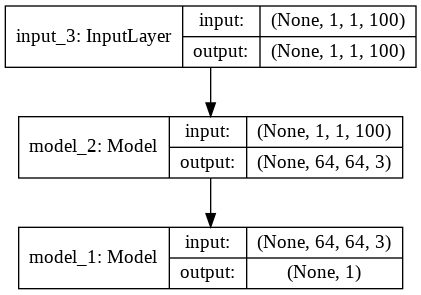

In [0]:
discriminator.trainable = False

# Optimizer for the GAN
opt = Adam(lr=0.00015, beta_1=0.5) #same as generator
# Input to the generator
gen_inp = Input(shape=noise_shape)

GAN_inp = generator(gen_inp)
GAN_opt = discriminator(GAN_inp)

# Final GAN
gan = Model(input = gen_inp, output = GAN_opt)
gan.compile(loss = 'binary_crossentropy', optimizer = opt, metrics=['accuracy'])

plot_model(gan, to_file='gan_plot.png', show_shapes=True, show_layer_names=True)

Begin step:  0




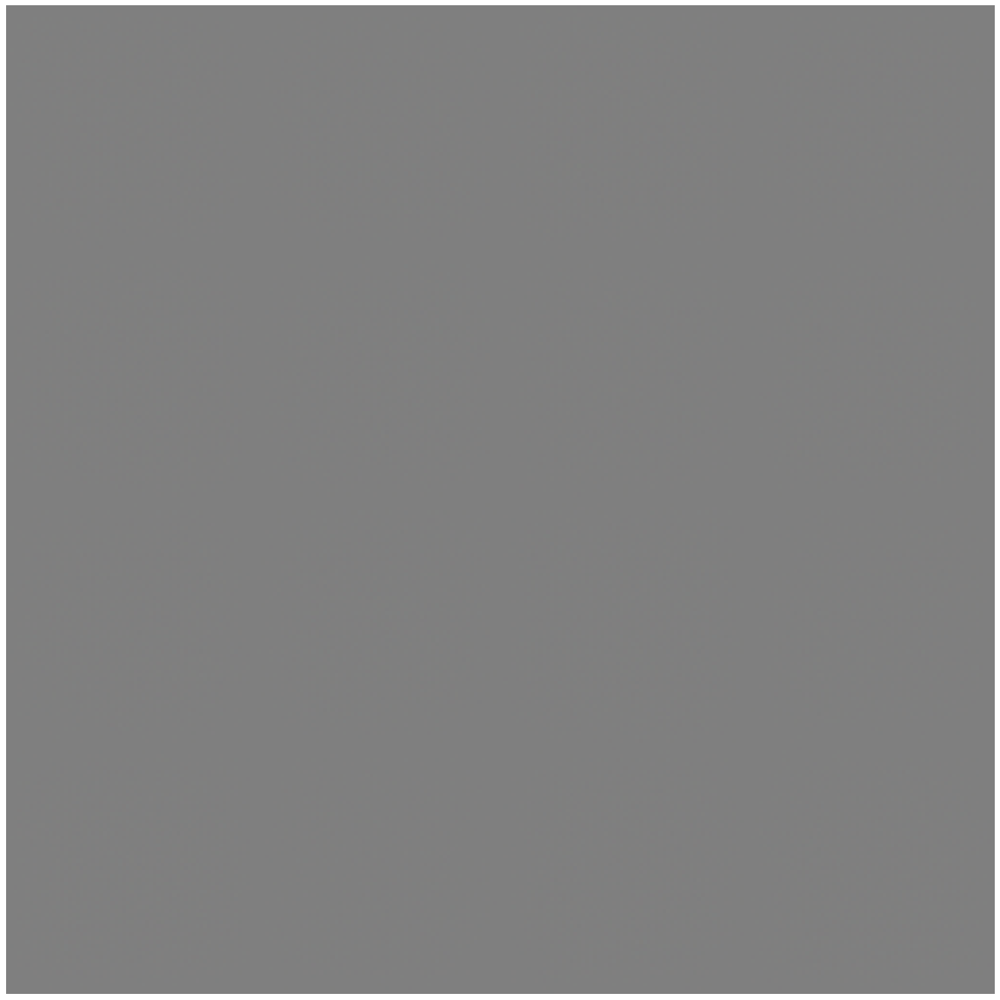



Disc: real loss: 0.708192 fake loss: 3.191809
GAN loss: 1.818120
Step 0 completed. Time took: 7 secs.
Begin step:  1
Disc: real loss: 0.543833 fake loss: 0.404290
GAN loss: 4.033764
Step 1 completed. Time took: 0 secs.
Begin step:  2
Disc: real loss: 0.537668 fake loss: 0.391299
GAN loss: 3.334177
Step 2 completed. Time took: 0 secs.
Begin step:  3
Disc: real loss: 0.498888 fake loss: 0.712533
GAN loss: 5.435783
Step 3 completed. Time took: 0 secs.
Begin step:  4
Disc: real loss: 0.593630 fake loss: 0.547613
GAN loss: 3.382321
Step 4 completed. Time took: 0 secs.
Begin step:  5
Disc: real loss: 0.501149 fake loss: 1.149485
GAN loss: 6.785016
Step 5 completed. Time took: 0 secs.
Begin step:  6
Disc: real loss: 0.582392 fake loss: 0.740322
GAN loss: 6.556059
Step 6 completed. Time took: 0 secs.
Begin step:  7
Disc: real loss: 0.586894 fake loss: 0.356357
GAN loss: 2.327147
Step 7 completed. Time took: 0 secs.
Begin step:  8
Disc: real loss: 0.538944 fake loss: 1.245414
GAN loss: 8.9134

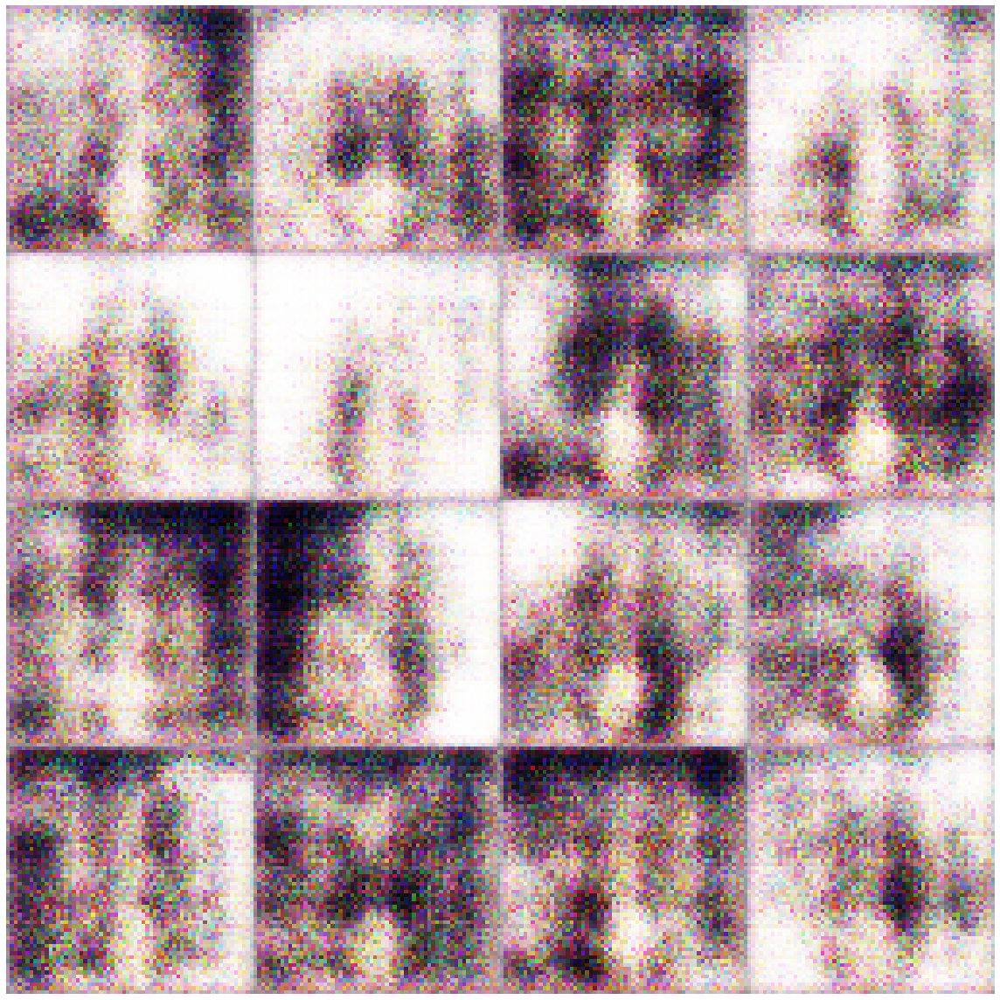

Disc: real loss: 0.399996 fake loss: 0.506280
GAN loss: 3.462271
Step 100 completed. Time took: 1 secs.
Begin step:  101
Disc: real loss: 0.451255 fake loss: 0.376414
GAN loss: 2.645261
Step 101 completed. Time took: 0 secs.
Begin step:  102
Disc: real loss: 0.423801 fake loss: 0.484317
GAN loss: 3.912486
Step 102 completed. Time took: 0 secs.
Begin step:  103
Disc: real loss: 0.537249 fake loss: 0.354996
GAN loss: 2.055193
Step 103 completed. Time took: 0 secs.
Begin step:  104
Disc: real loss: 0.419740 fake loss: 0.527242
GAN loss: 4.637286
Step 104 completed. Time took: 0 secs.
Begin step:  105
Disc: real loss: 0.699399 fake loss: 0.389295
GAN loss: 1.933753
Step 105 completed. Time took: 0 secs.
Begin step:  106
Disc: real loss: 0.450941 fake loss: 0.735658
GAN loss: 5.960051
Step 106 completed. Time took: 0 secs.
Begin step:  107
Disc: real loss: 0.821634 fake loss: 0.474274
GAN loss: 2.376493
Step 107 completed. Time took: 0 secs.
Begin step:  108
Disc: real loss: 0.419807 fake l

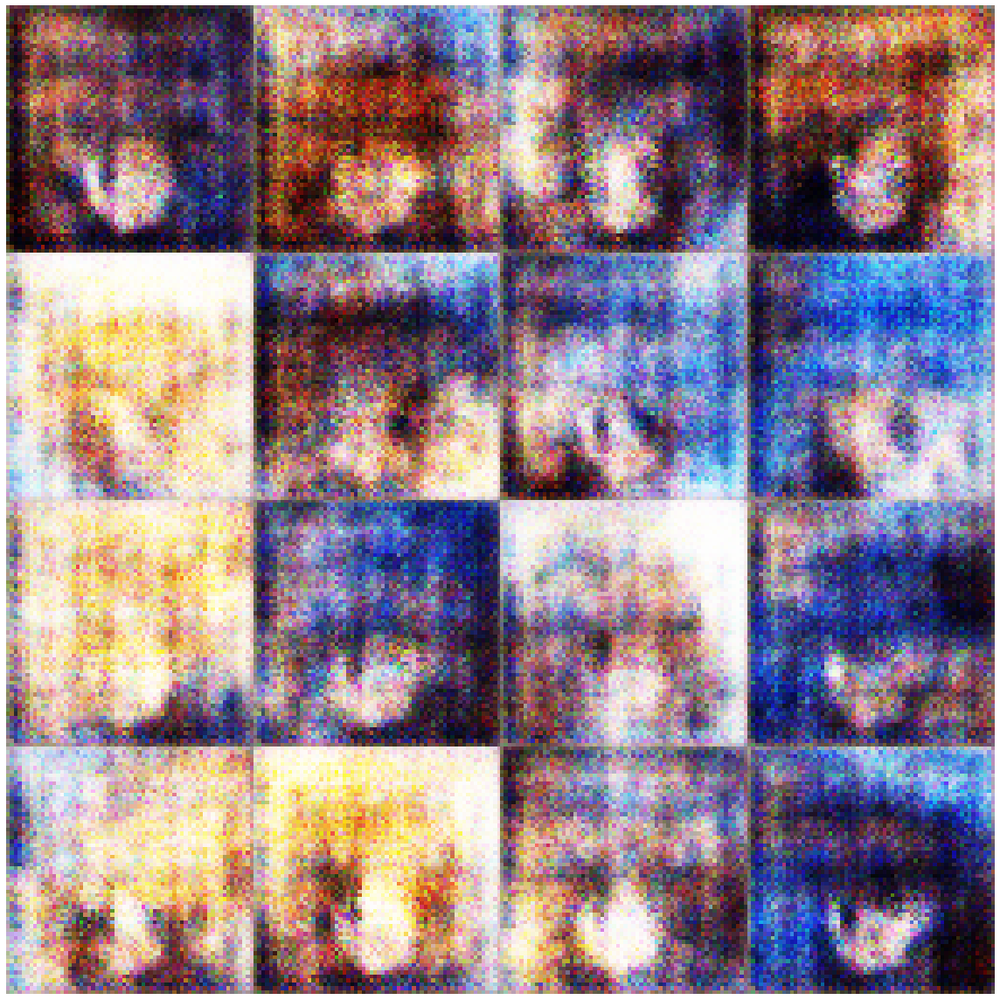

Disc: real loss: 0.489274 fake loss: 0.604261
GAN loss: 2.489811
Step 200 completed. Time took: 1 secs.
Begin step:  201
Disc: real loss: 0.417745 fake loss: 0.397125
GAN loss: 2.426741
Step 201 completed. Time took: 0 secs.
Begin step:  202
Disc: real loss: 0.479233 fake loss: 0.493934
GAN loss: 2.451208
Step 202 completed. Time took: 0 secs.
Begin step:  203
Disc: real loss: 0.483936 fake loss: 0.368361
GAN loss: 2.177650
Step 203 completed. Time took: 0 secs.
Begin step:  204
Disc: real loss: 0.395187 fake loss: 0.425035
GAN loss: 2.195456
Step 204 completed. Time took: 0 secs.
Begin step:  205
Disc: real loss: 0.371962 fake loss: 0.354059
GAN loss: 2.483143
Step 205 completed. Time took: 0 secs.
Begin step:  206
Disc: real loss: 0.489502 fake loss: 0.452269
GAN loss: 2.330649
Step 206 completed. Time took: 0 secs.
Begin step:  207
Disc: real loss: 0.480236 fake loss: 0.429431
GAN loss: 2.353501
Step 207 completed. Time took: 0 secs.
Begin step:  208
Disc: real loss: 0.389374 fake l

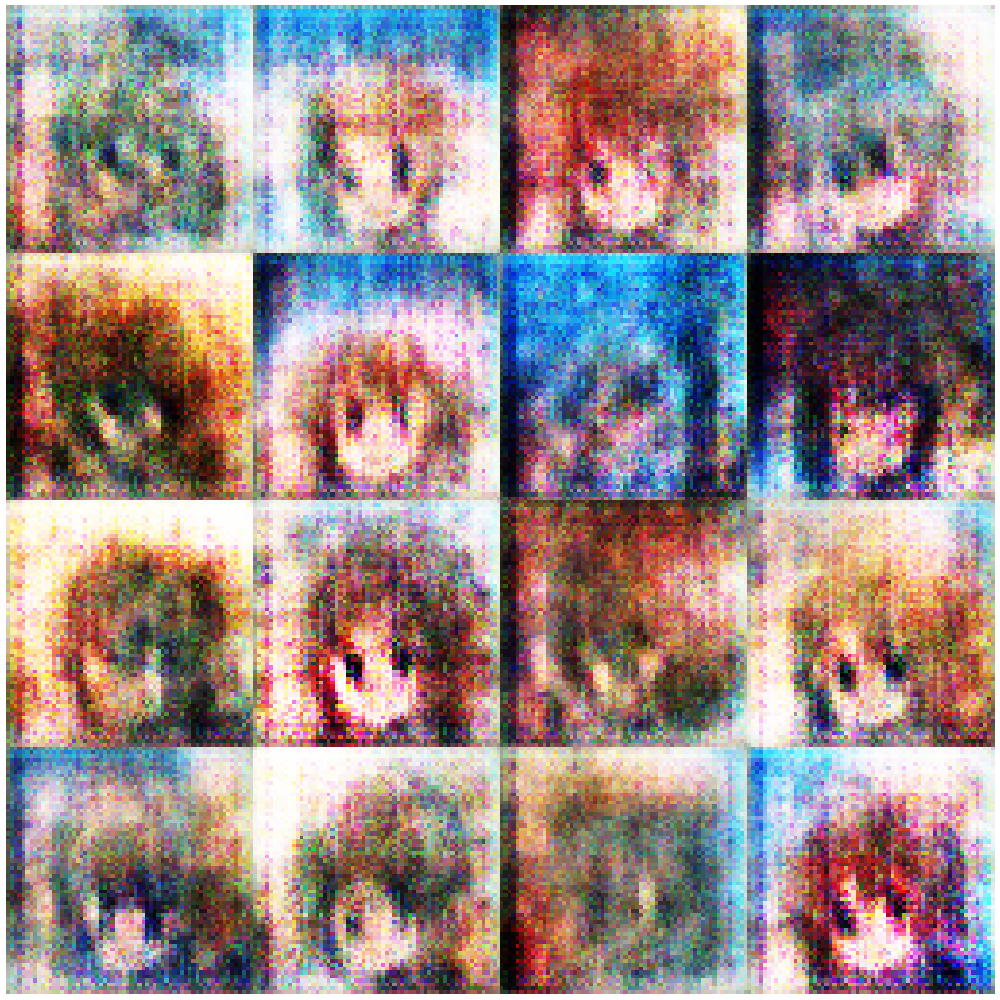

Disc: real loss: 0.443702 fake loss: 0.390812
GAN loss: 2.444638
Step 300 completed. Time took: 1 secs.
Begin step:  301
Disc: real loss: 0.425898 fake loss: 0.458306
GAN loss: 3.216305
Step 301 completed. Time took: 0 secs.
Begin step:  302
Disc: real loss: 0.665071 fake loss: 0.571711
GAN loss: 3.350011
Step 302 completed. Time took: 0 secs.
Begin step:  303
Disc: real loss: 0.452856 fake loss: 0.402206
GAN loss: 2.349031
Step 303 completed. Time took: 0 secs.
Begin step:  304
Disc: real loss: 0.387317 fake loss: 0.549220
GAN loss: 3.518713
Step 304 completed. Time took: 0 secs.
Begin step:  305
Disc: real loss: 0.613972 fake loss: 0.391522
GAN loss: 2.433821
Step 305 completed. Time took: 0 secs.
Begin step:  306
Disc: real loss: 0.393793 fake loss: 0.523049
GAN loss: 3.382137
Step 306 completed. Time took: 0 secs.
Begin step:  307
Disc: real loss: 0.623948 fake loss: 0.428641
GAN loss: 2.337247
Step 307 completed. Time took: 0 secs.
Begin step:  308
Disc: real loss: 0.395540 fake l

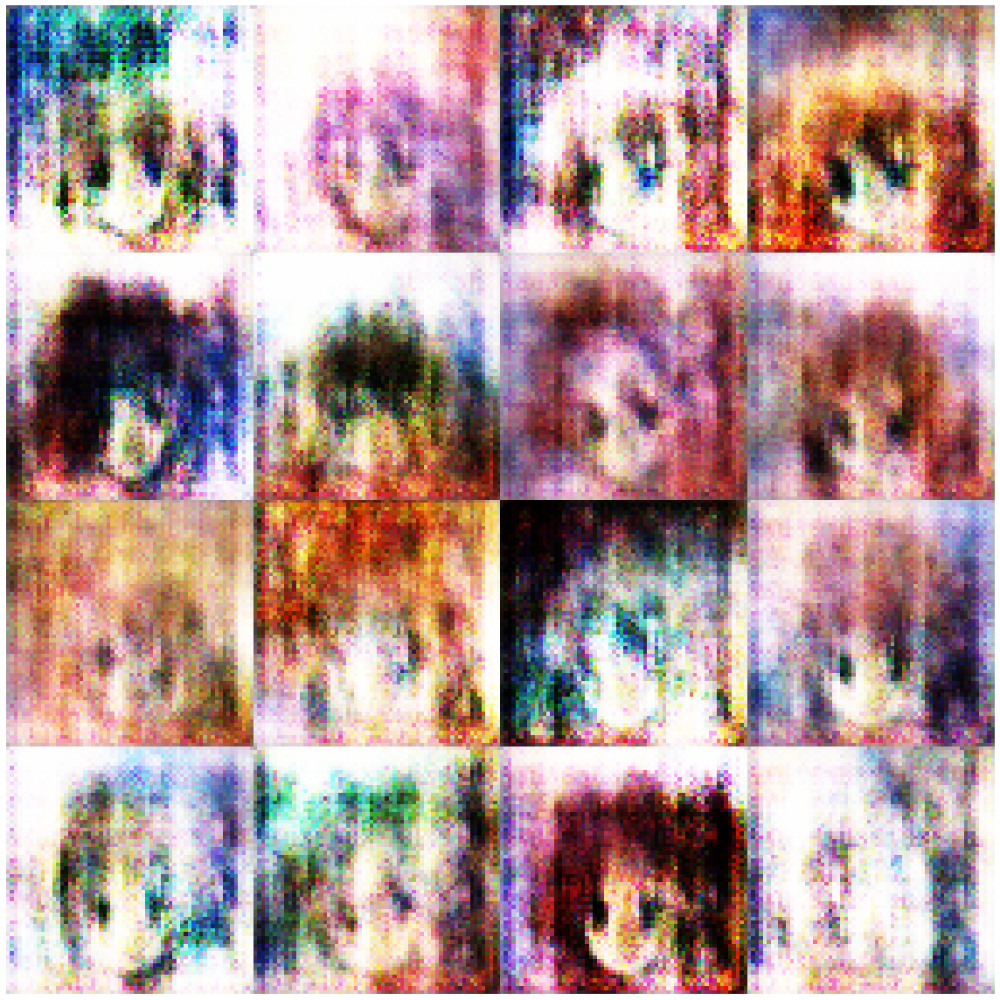

Disc: real loss: 0.570224 fake loss: 0.369231
GAN loss: 2.393885
Step 400 completed. Time took: 1 secs.
Begin step:  401
Disc: real loss: 0.433646 fake loss: 0.504901
GAN loss: 3.461080
Step 401 completed. Time took: 0 secs.
Begin step:  402
Disc: real loss: 0.670039 fake loss: 0.466920
GAN loss: 2.722238
Step 402 completed. Time took: 0 secs.
Begin step:  403
Disc: real loss: 0.436127 fake loss: 0.416581
GAN loss: 2.947882
Step 403 completed. Time took: 0 secs.
Begin step:  404
Disc: real loss: 0.433945 fake loss: 0.373725
GAN loss: 2.623173
Step 404 completed. Time took: 0 secs.
Begin step:  405
Disc: real loss: 0.506153 fake loss: 0.540292
GAN loss: 3.146467
Step 405 completed. Time took: 0 secs.
Begin step:  406
Disc: real loss: 0.541261 fake loss: 0.394986
GAN loss: 2.440416
Step 406 completed. Time took: 0 secs.
Begin step:  407
Disc: real loss: 0.364198 fake loss: 0.450980
GAN loss: 3.125792
Step 407 completed. Time took: 0 secs.
Begin step:  408
Disc: real loss: 0.495265 fake l

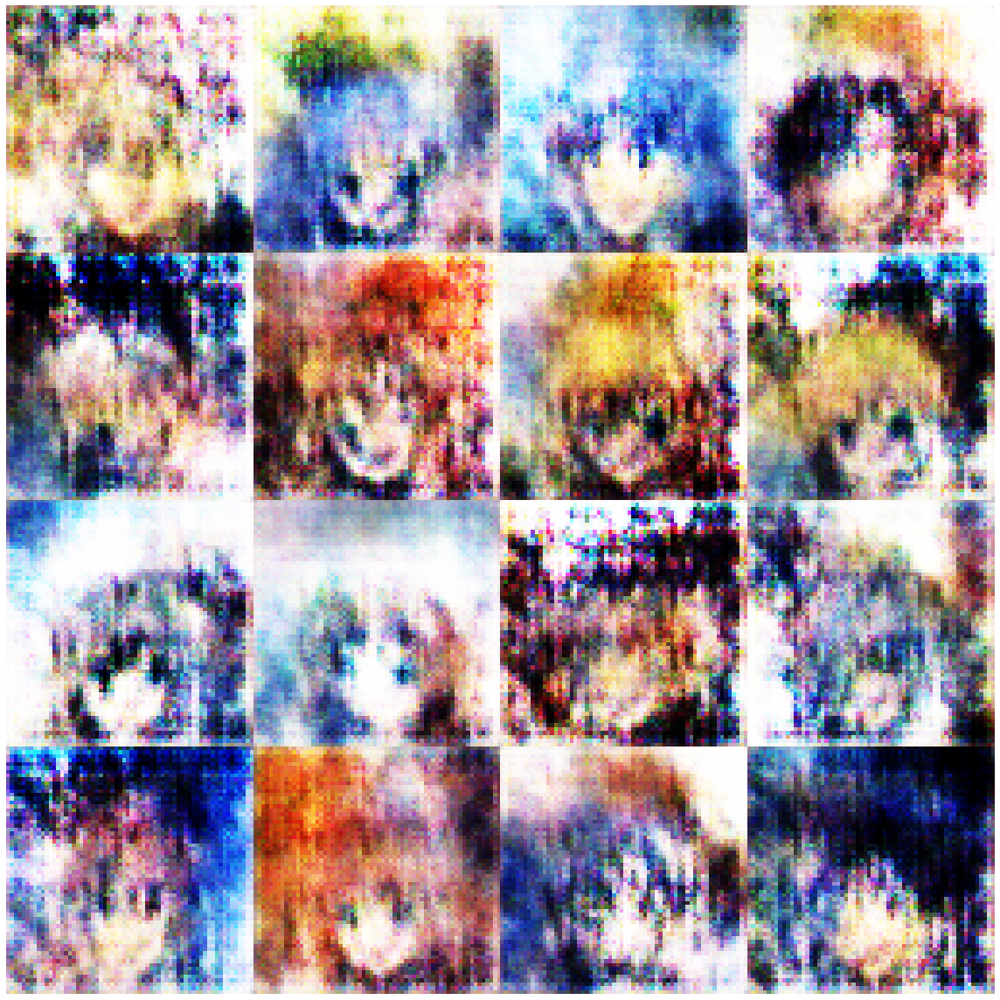

Begin step:  500


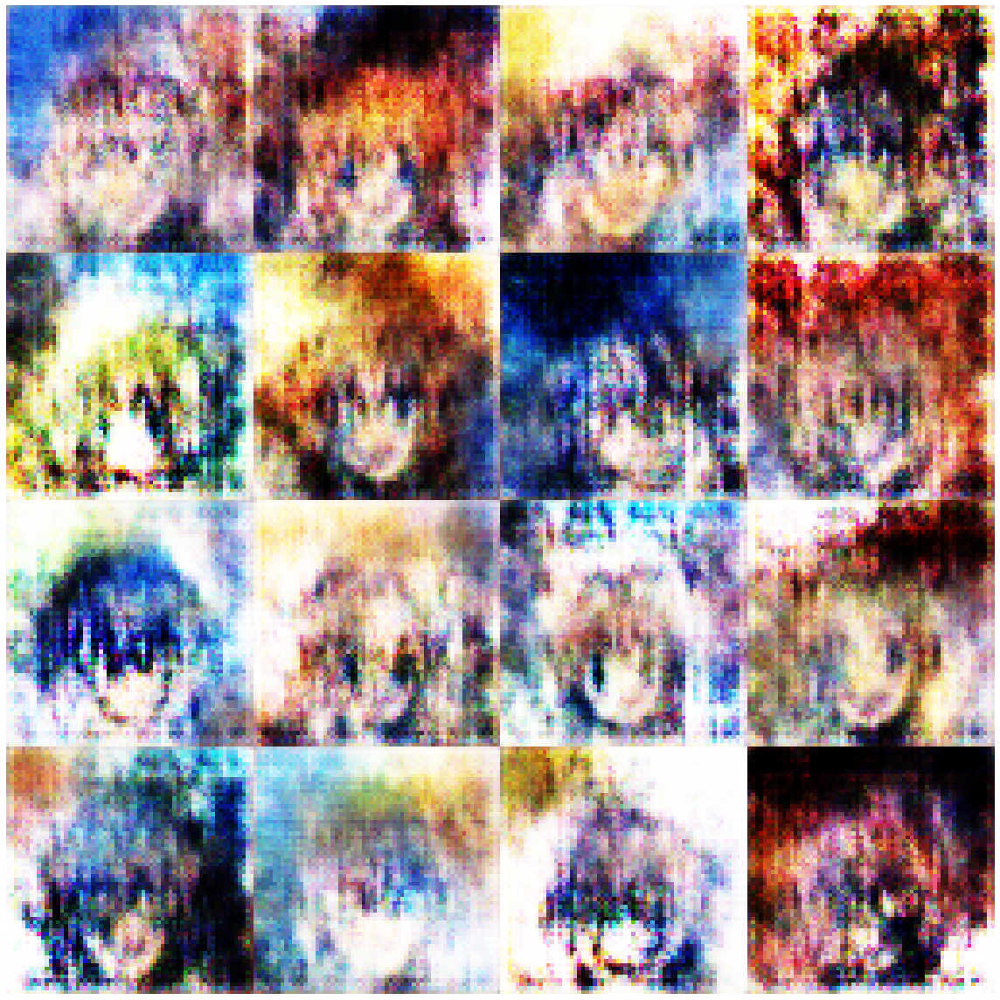

Disc: real loss: 0.406940 fake loss: 0.557752
GAN loss: 2.918424
Step 500 completed. Time took: 1 secs.
Begin step:  501
Disc: real loss: 0.606754 fake loss: 0.374898
GAN loss: 2.211241
Step 501 completed. Time took: 0 secs.
Begin step:  502
Disc: real loss: 0.399310 fake loss: 0.500274
GAN loss: 2.818791
Step 502 completed. Time took: 0 secs.
Begin step:  503
Disc: real loss: 0.498238 fake loss: 0.402631
GAN loss: 2.375764
Step 503 completed. Time took: 0 secs.
Begin step:  504
Disc: real loss: 0.421319 fake loss: 0.442512
GAN loss: 3.034540
Step 504 completed. Time took: 0 secs.
Begin step:  505
Disc: real loss: 0.544226 fake loss: 0.400487
GAN loss: 2.179721
Step 505 completed. Time took: 0 secs.
Begin step:  506
Disc: real loss: 0.414164 fake loss: 0.403714
GAN loss: 2.998052
Step 506 completed. Time took: 0 secs.
Begin step:  507
Disc: real loss: 0.610427 fake loss: 0.536472
GAN loss: 3.300732
Step 507 completed. Time took: 0 secs.
Begin step:  508
Disc: real loss: 0.460970 fake l

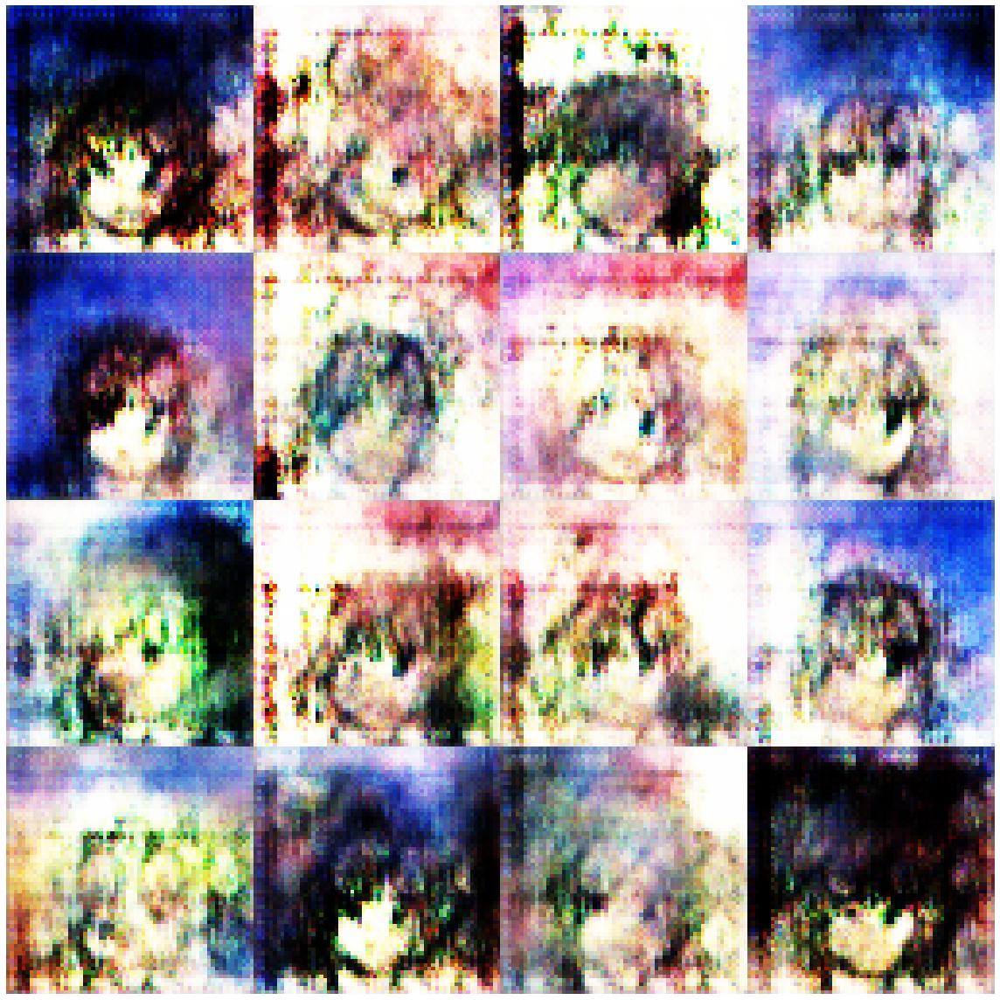

Disc: real loss: 0.408864 fake loss: 0.425813
GAN loss: 2.505449
Step 600 completed. Time took: 1 secs.
Begin step:  601
Disc: real loss: 0.474731 fake loss: 0.407468
GAN loss: 2.512059
Step 601 completed. Time took: 0 secs.
Begin step:  602
Disc: real loss: 0.434965 fake loss: 0.394562
GAN loss: 2.393072
Step 602 completed. Time took: 0 secs.
Begin step:  603
Disc: real loss: 0.483298 fake loss: 0.484911
GAN loss: 3.019527
Step 603 completed. Time took: 0 secs.
Begin step:  604
Disc: real loss: 0.448345 fake loss: 0.334276
GAN loss: 2.231205
Step 604 completed. Time took: 0 secs.
Begin step:  605
Disc: real loss: 0.423304 fake loss: 0.602215
GAN loss: 3.340572
Step 605 completed. Time took: 0 secs.
Begin step:  606
Disc: real loss: 0.668044 fake loss: 0.441081
GAN loss: 2.636388
Step 606 completed. Time took: 0 secs.
Begin step:  607
Disc: real loss: 0.402164 fake loss: 0.381103
GAN loss: 2.451147
Step 607 completed. Time took: 0 secs.
Begin step:  608
Disc: real loss: 0.403138 fake l

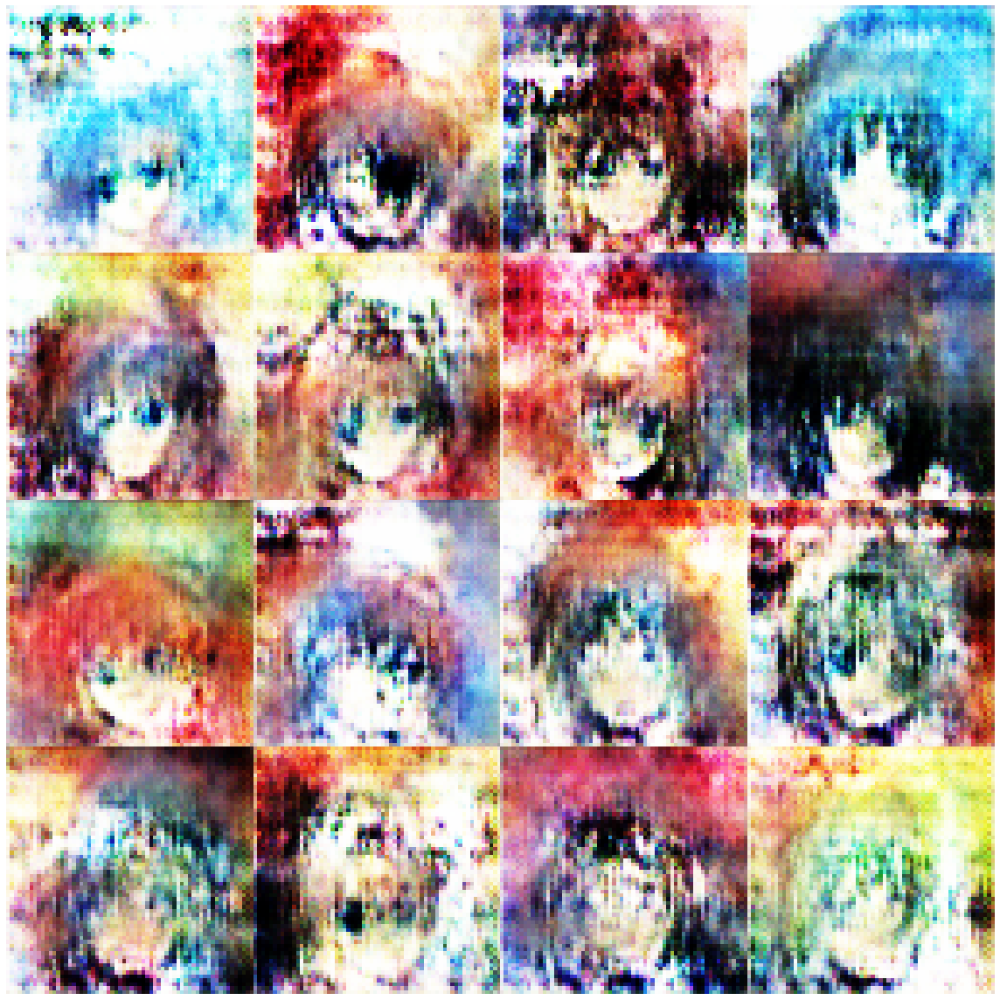

Disc: real loss: 0.668524 fake loss: 0.368160
GAN loss: 1.651866
Step 700 completed. Time took: 1 secs.
Begin step:  701
Disc: real loss: 0.396441 fake loss: 0.672471
GAN loss: 3.471284
Step 701 completed. Time took: 0 secs.
Begin step:  702
Disc: real loss: 0.693527 fake loss: 0.362788
GAN loss: 1.942821
Step 702 completed. Time took: 0 secs.
Begin step:  703
Disc: real loss: 0.377098 fake loss: 0.663115
GAN loss: 4.826557
Step 703 completed. Time took: 0 secs.
Begin step:  704
Disc: real loss: 1.100452 fake loss: 0.481511
GAN loss: 2.044897
Step 704 completed. Time took: 0 secs.
Begin step:  705
Disc: real loss: 0.390864 fake loss: 0.472870
GAN loss: 3.712618
Step 705 completed. Time took: 0 secs.
Begin step:  706
Disc: real loss: 0.649800 fake loss: 0.396501
GAN loss: 2.146159
Step 706 completed. Time took: 0 secs.
Begin step:  707
Disc: real loss: 0.385220 fake loss: 0.607683
GAN loss: 3.460458
Step 707 completed. Time took: 0 secs.
Begin step:  708
Disc: real loss: 0.663510 fake l

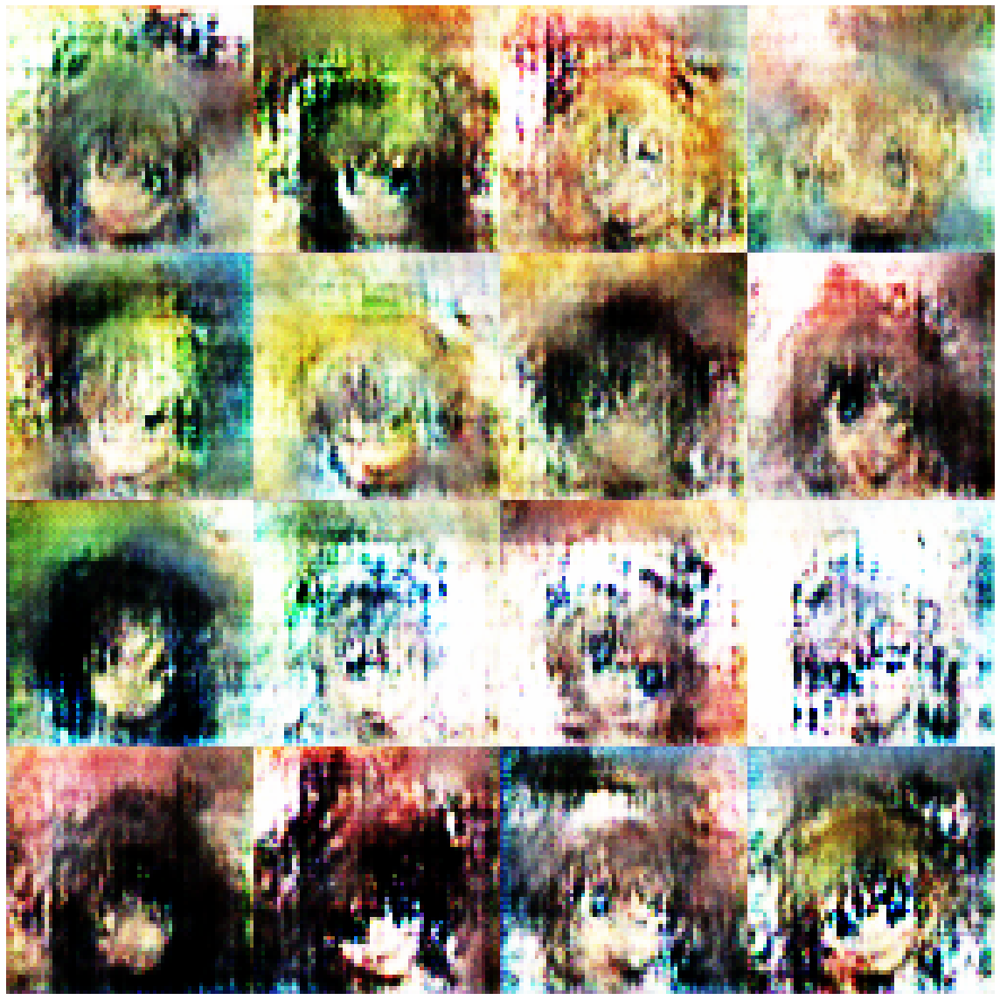

Disc: real loss: 0.694056 fake loss: 0.364452
GAN loss: 1.899385
Step 800 completed. Time took: 1 secs.
Begin step:  801
Disc: real loss: 0.393581 fake loss: 0.705805
GAN loss: 5.044859
Step 801 completed. Time took: 0 secs.
Begin step:  802
Disc: real loss: 0.948677 fake loss: 0.365344
GAN loss: 1.678837
Step 802 completed. Time took: 0 secs.
Begin step:  803
Disc: real loss: 0.366486 fake loss: 0.732889
GAN loss: 4.331943
Step 803 completed. Time took: 0 secs.
Begin step:  804
Disc: real loss: 0.527213 fake loss: 0.431458
GAN loss: 2.756680
Step 804 completed. Time took: 0 secs.
Begin step:  805
Disc: real loss: 0.410094 fake loss: 0.569785
GAN loss: 3.161211
Step 805 completed. Time took: 0 secs.
Begin step:  806
Disc: real loss: 0.553072 fake loss: 0.414043
GAN loss: 2.672410
Step 806 completed. Time took: 0 secs.
Begin step:  807
Disc: real loss: 0.388985 fake loss: 0.455649
GAN loss: 3.233104
Step 807 completed. Time took: 0 secs.
Begin step:  808
Disc: real loss: 0.505507 fake l

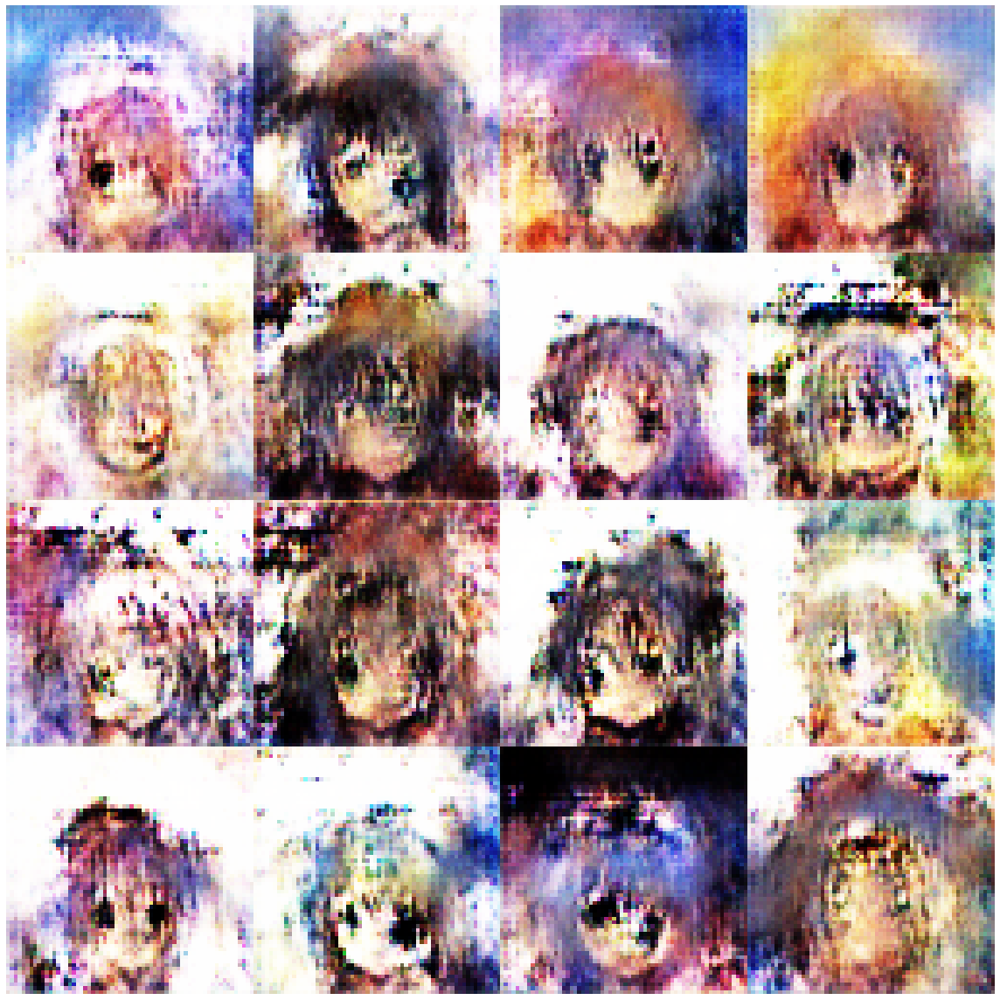

Disc: real loss: 0.349485 fake loss: 0.734243
GAN loss: 4.482604
Step 900 completed. Time took: 1 secs.
Begin step:  901
Disc: real loss: 0.683282 fake loss: 0.395903
GAN loss: 2.270285
Step 901 completed. Time took: 0 secs.
Begin step:  902
Disc: real loss: 0.370080 fake loss: 0.560638
GAN loss: 2.943968
Step 902 completed. Time took: 0 secs.
Begin step:  903
Disc: real loss: 0.411842 fake loss: 0.334415
GAN loss: 2.315506
Step 903 completed. Time took: 0 secs.
Begin step:  904
Disc: real loss: 0.407062 fake loss: 0.565862
GAN loss: 3.150749
Step 904 completed. Time took: 0 secs.
Begin step:  905
Disc: real loss: 0.543204 fake loss: 0.384035
GAN loss: 2.170746
Step 905 completed. Time took: 0 secs.
Begin step:  906
Disc: real loss: 0.362622 fake loss: 0.446571
GAN loss: 3.208215
Step 906 completed. Time took: 0 secs.
Begin step:  907
Disc: real loss: 0.451339 fake loss: 0.403365
GAN loss: 2.729700
Step 907 completed. Time took: 0 secs.
Begin step:  908
Disc: real loss: 0.457226 fake l

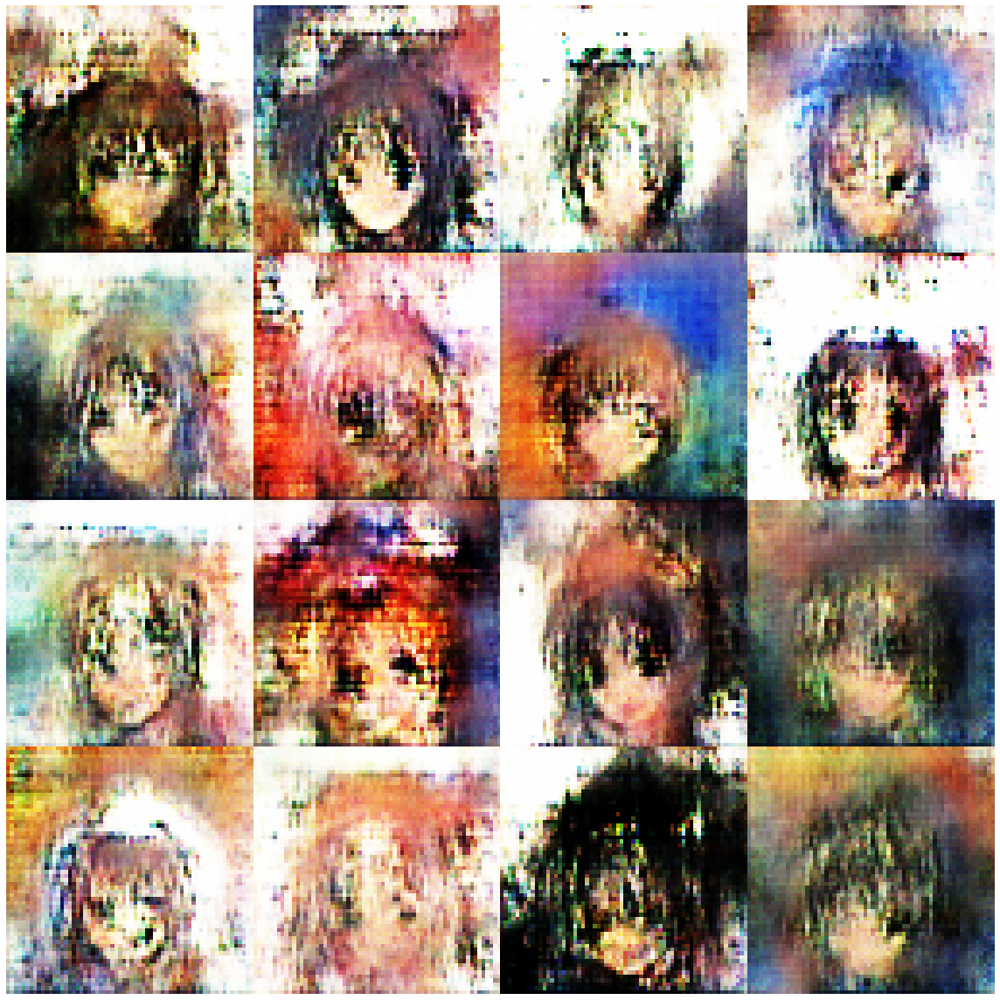

Begin step:  1000


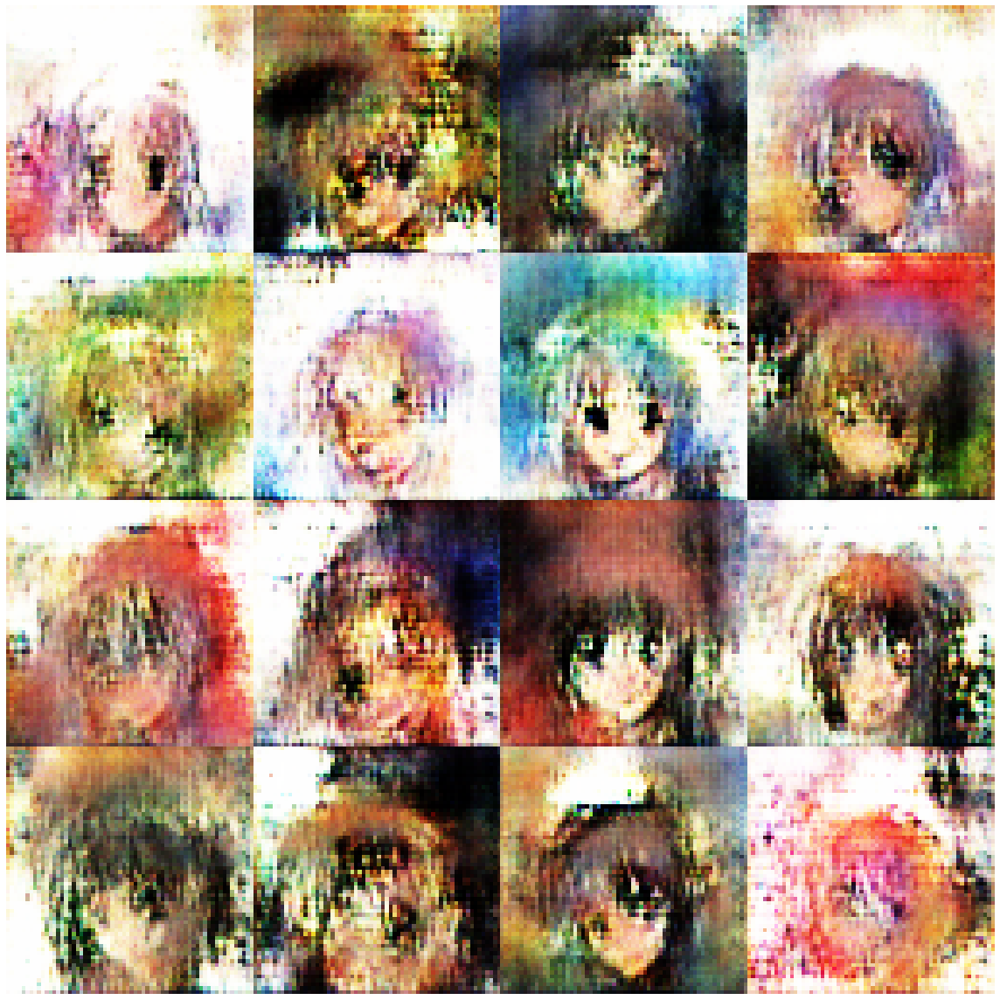

Disc: real loss: 0.375029 fake loss: 0.501181
GAN loss: 3.092651
Step 1000 completed. Time took: 1 secs.
Begin step:  1001
Disc: real loss: 0.468932 fake loss: 0.347806
GAN loss: 2.095068
Step 1001 completed. Time took: 0 secs.
Begin step:  1002
Disc: real loss: 0.381377 fake loss: 0.634467
GAN loss: 3.713946
Step 1002 completed. Time took: 0 secs.
Begin step:  1003
Disc: real loss: 0.704391 fake loss: 0.365455
GAN loss: 1.572385
Step 1003 completed. Time took: 0 secs.
Begin step:  1004
Disc: real loss: 0.423654 fake loss: 0.510246
GAN loss: 3.118068
Step 1004 completed. Time took: 0 secs.
Begin step:  1005
Disc: real loss: 0.445462 fake loss: 0.347671
GAN loss: 2.176161
Step 1005 completed. Time took: 0 secs.
Begin step:  1006
Disc: real loss: 0.351784 fake loss: 0.538859
GAN loss: 3.224840
Step 1006 completed. Time took: 0 secs.
Begin step:  1007
Disc: real loss: 0.555316 fake loss: 0.349196
GAN loss: 1.893192
Step 1007 completed. Time took: 0 secs.
Begin step:  1008
Disc: real loss:

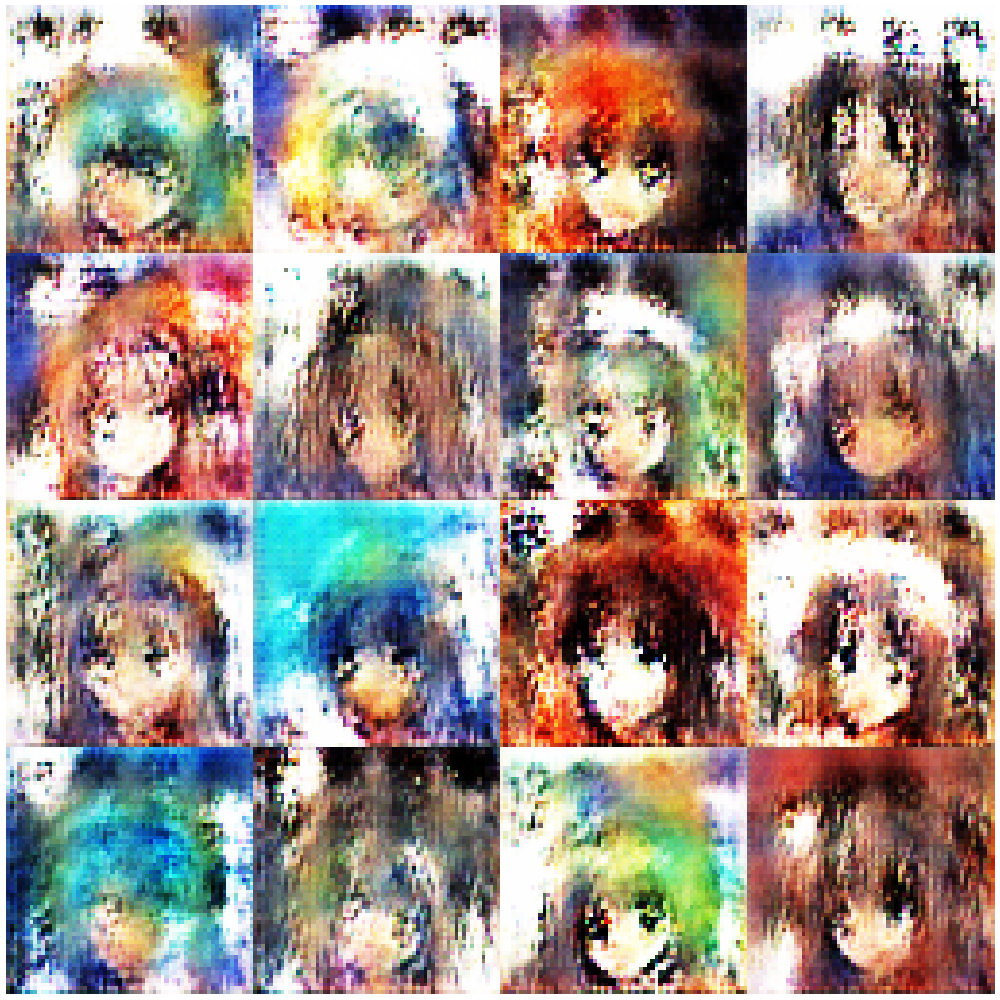

Disc: real loss: 0.377859 fake loss: 0.525189
GAN loss: 3.368481
Step 1100 completed. Time took: 1 secs.
Begin step:  1101
Disc: real loss: 0.514977 fake loss: 0.354488
GAN loss: 1.998371
Step 1101 completed. Time took: 0 secs.
Begin step:  1102
Disc: real loss: 0.377536 fake loss: 0.579960
GAN loss: 3.994188
Step 1102 completed. Time took: 0 secs.
Begin step:  1103
Disc: real loss: 0.587155 fake loss: 0.353958
GAN loss: 1.860549
Step 1103 completed. Time took: 0 secs.
Begin step:  1104
Disc: real loss: 0.362978 fake loss: 0.699129
GAN loss: 4.614268
Step 1104 completed. Time took: 0 secs.
Begin step:  1105
Disc: real loss: 0.592646 fake loss: 0.428638
GAN loss: 2.649681
Step 1105 completed. Time took: 0 secs.
Begin step:  1106
Disc: real loss: 0.342638 fake loss: 0.568076
GAN loss: 3.270427
Step 1106 completed. Time took: 0 secs.
Begin step:  1107
Disc: real loss: 0.411622 fake loss: 0.384376
GAN loss: 2.370123
Step 1107 completed. Time took: 0 secs.
Begin step:  1108
Disc: real loss:

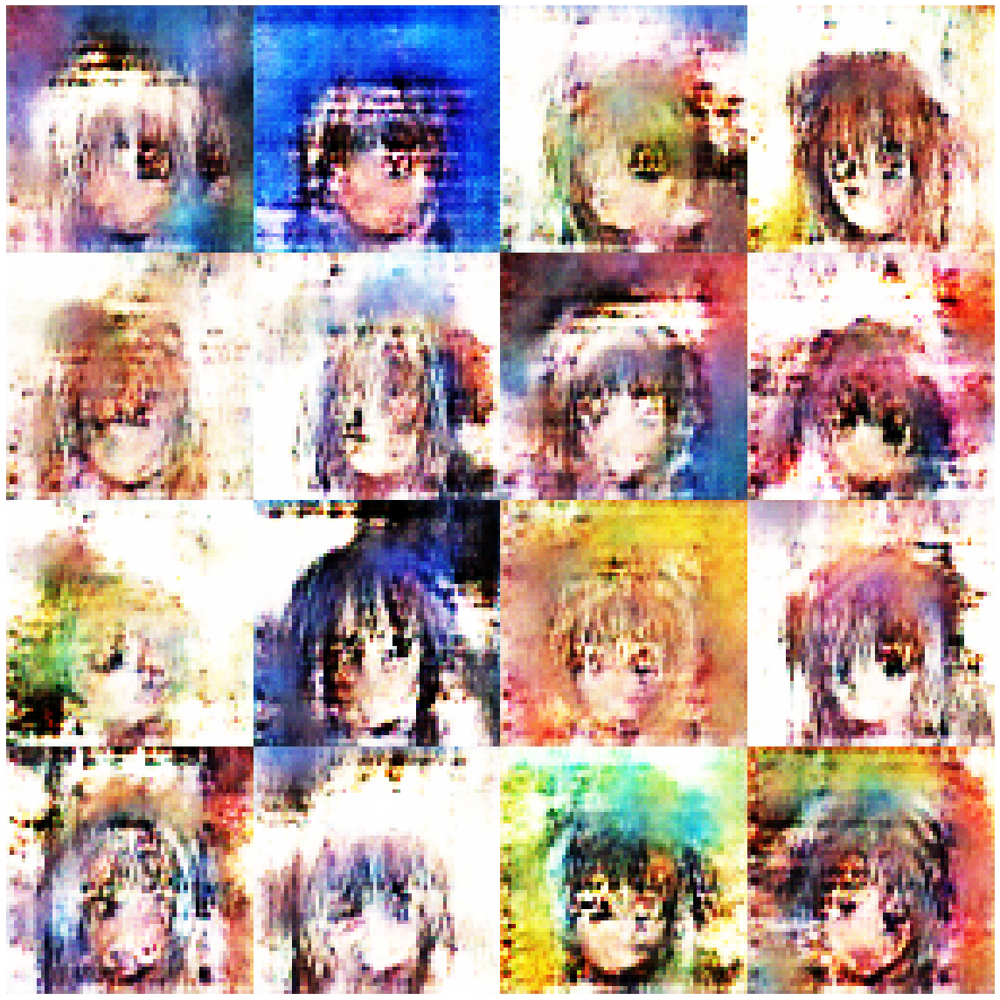

Disc: real loss: 0.594834 fake loss: 0.326609
GAN loss: 2.054028
Step 1200 completed. Time took: 1 secs.
Begin step:  1201
Disc: real loss: 0.370626 fake loss: 0.416945
GAN loss: 3.443398
Step 1201 completed. Time took: 0 secs.
Begin step:  1202
Disc: real loss: 0.479899 fake loss: 0.365607
GAN loss: 1.976513
Step 1202 completed. Time took: 0 secs.
Begin step:  1203
Disc: real loss: 0.367372 fake loss: 0.441321
GAN loss: 3.443279
Step 1203 completed. Time took: 0 secs.
Begin step:  1204
Disc: real loss: 0.450783 fake loss: 0.376031
GAN loss: 1.772180
Step 1204 completed. Time took: 0 secs.
Begin step:  1205
Disc: real loss: 0.355858 fake loss: 0.473043
GAN loss: 3.613604
Step 1205 completed. Time took: 0 secs.
Begin step:  1206
Disc: real loss: 0.571356 fake loss: 0.355536
GAN loss: 1.385753
Step 1206 completed. Time took: 0 secs.
Begin step:  1207
Disc: real loss: 0.375634 fake loss: 0.596266
GAN loss: 4.863397
Step 1207 completed. Time took: 0 secs.
Begin step:  1208
Disc: real loss:

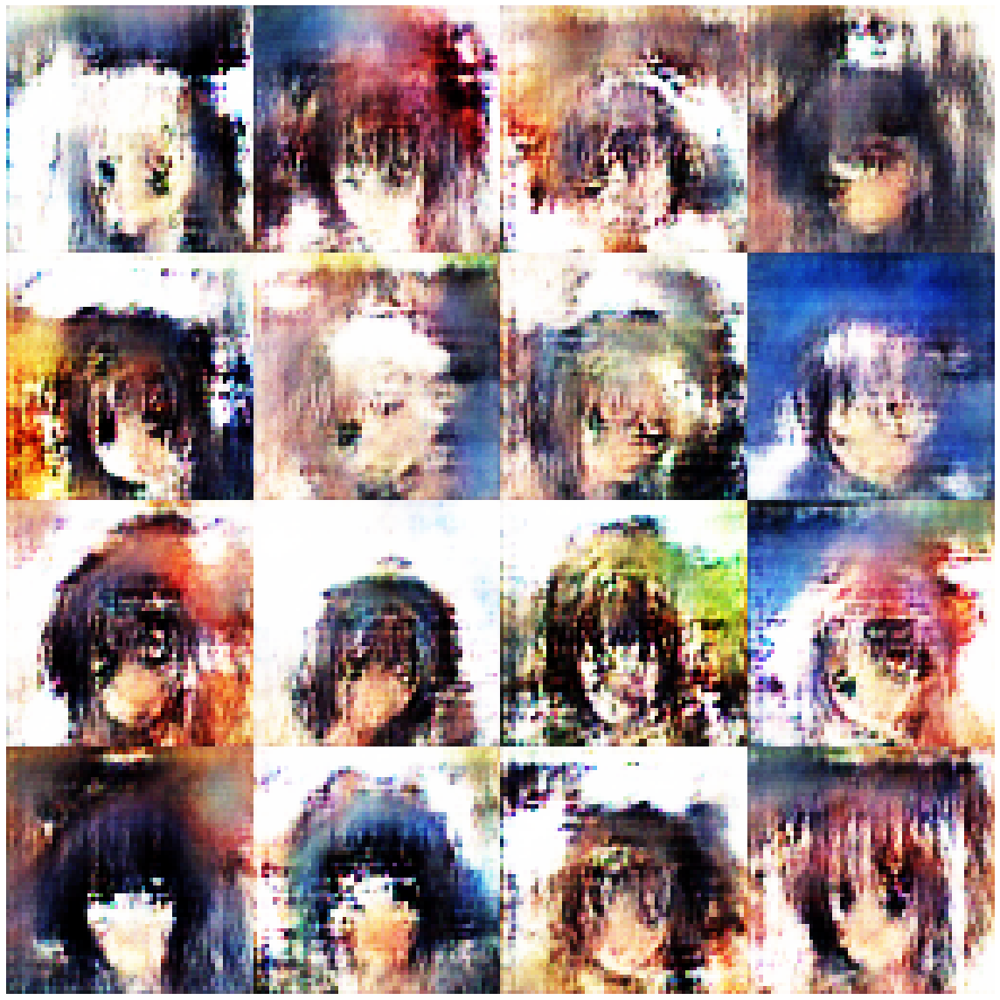

Disc: real loss: 0.379492 fake loss: 0.353673
GAN loss: 2.431403
Step 1300 completed. Time took: 1 secs.
Begin step:  1301
Disc: real loss: 0.349119 fake loss: 0.402644
GAN loss: 2.605790
Step 1301 completed. Time took: 0 secs.
Begin step:  1302
Disc: real loss: 0.397400 fake loss: 0.436662
GAN loss: 3.362446
Step 1302 completed. Time took: 0 secs.
Begin step:  1303
Disc: real loss: 0.466922 fake loss: 0.371254
GAN loss: 1.740991
Step 1303 completed. Time took: 0 secs.
Begin step:  1304
Disc: real loss: 0.374020 fake loss: 0.556515
GAN loss: 4.563881
Step 1304 completed. Time took: 0 secs.
Begin step:  1305
Disc: real loss: 0.654717 fake loss: 0.360979
GAN loss: 2.296370
Step 1305 completed. Time took: 0 secs.
Begin step:  1306
Disc: real loss: 0.358791 fake loss: 0.384376
GAN loss: 3.129979
Step 1306 completed. Time took: 0 secs.
Begin step:  1307
Disc: real loss: 0.413908 fake loss: 0.412000
GAN loss: 3.276001
Step 1307 completed. Time took: 0 secs.
Begin step:  1308
Disc: real loss:

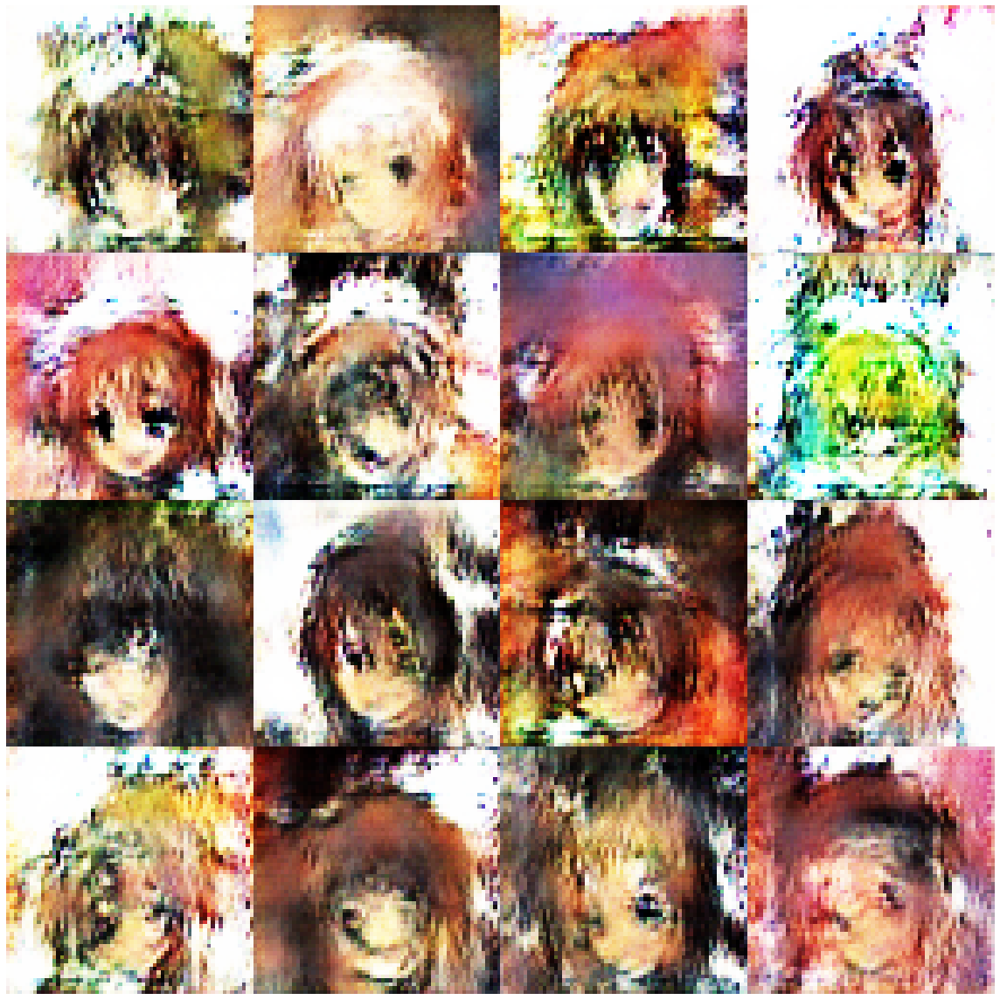

Disc: real loss: 0.401742 fake loss: 0.378651
GAN loss: 2.486109
Step 1400 completed. Time took: 1 secs.
Begin step:  1401
Disc: real loss: 0.375936 fake loss: 0.358890
GAN loss: 2.500747
Step 1401 completed. Time took: 0 secs.
Begin step:  1402
Disc: real loss: 0.414667 fake loss: 0.535386
GAN loss: 3.540131
Step 1402 completed. Time took: 0 secs.
Begin step:  1403
Disc: real loss: 0.534550 fake loss: 0.344552
GAN loss: 1.727676
Step 1403 completed. Time took: 0 secs.
Begin step:  1404
Disc: real loss: 0.359658 fake loss: 0.481256
GAN loss: 3.599811
Step 1404 completed. Time took: 0 secs.
Begin step:  1405
Disc: real loss: 0.568172 fake loss: 0.345808
GAN loss: 1.507560
Step 1405 completed. Time took: 0 secs.
Begin step:  1406
Disc: real loss: 0.378518 fake loss: 0.572086
GAN loss: 3.780053
Step 1406 completed. Time took: 0 secs.
Begin step:  1407
Disc: real loss: 0.626584 fake loss: 0.339009
GAN loss: 1.492966
Step 1407 completed. Time took: 0 secs.
Begin step:  1408
Disc: real loss:

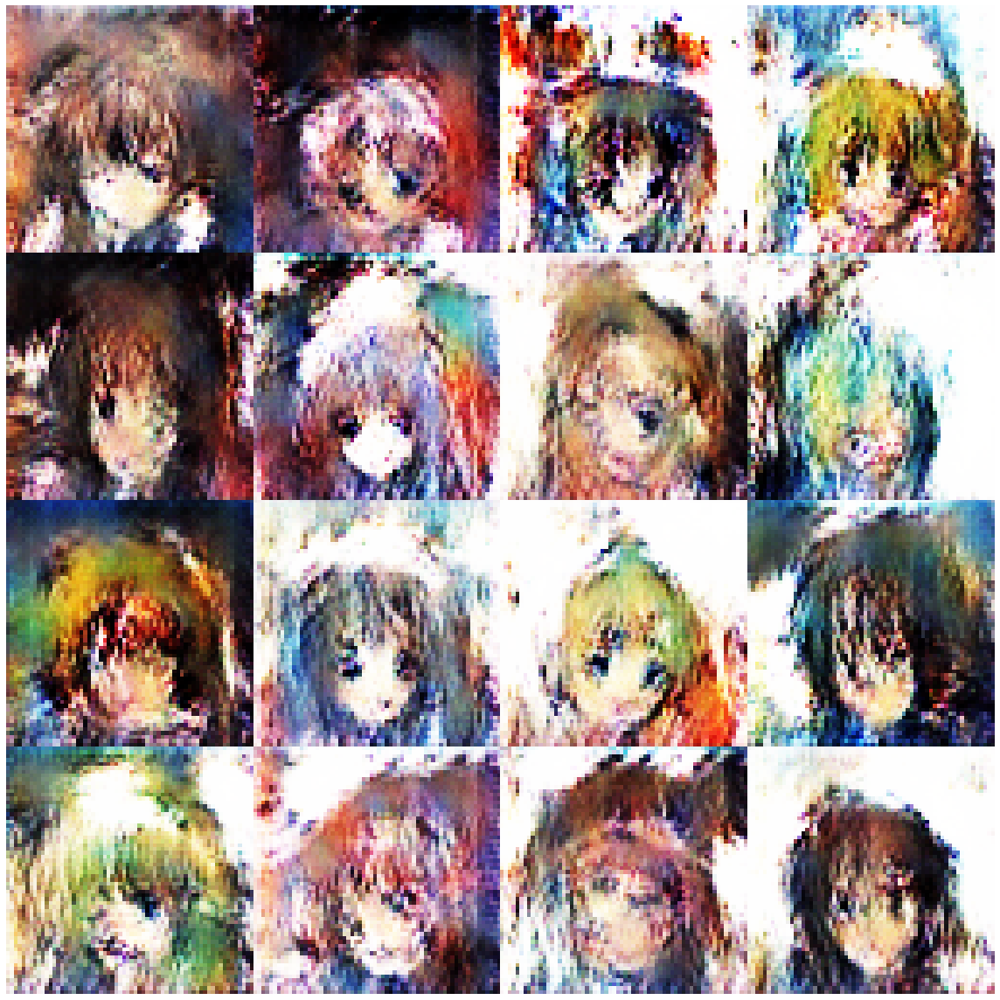

Begin step:  1500


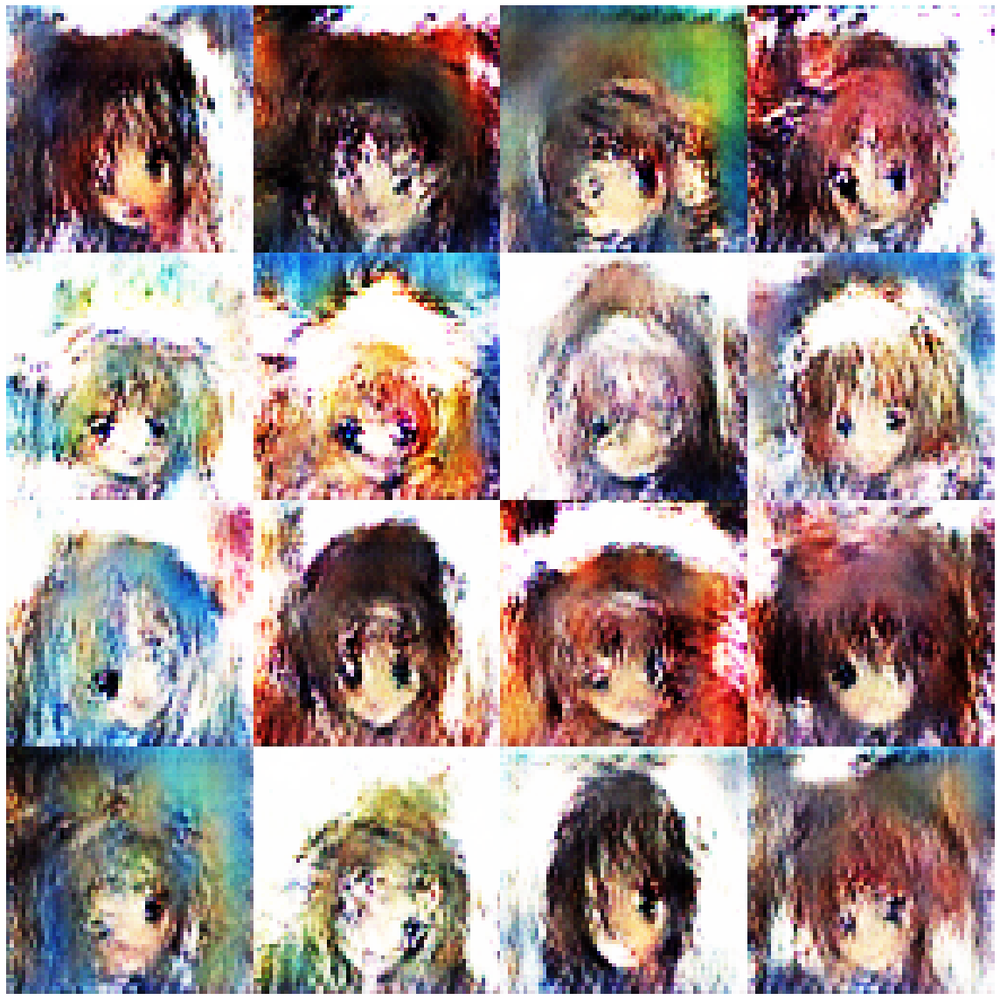

Disc: real loss: 0.395541 fake loss: 0.344819
GAN loss: 2.316271
Step 1500 completed. Time took: 1 secs.
Begin step:  1501
Disc: real loss: 0.338906 fake loss: 0.397081
GAN loss: 2.873075
Step 1501 completed. Time took: 0 secs.
Begin step:  1502
Disc: real loss: 0.400043 fake loss: 0.348282
GAN loss: 2.028461
Step 1502 completed. Time took: 0 secs.
Begin step:  1503
Disc: real loss: 0.360529 fake loss: 0.419555
GAN loss: 3.278076
Step 1503 completed. Time took: 0 secs.
Begin step:  1504
Disc: real loss: 0.530097 fake loss: 0.388735
GAN loss: 2.169747
Step 1504 completed. Time took: 0 secs.
Begin step:  1505
Disc: real loss: 0.349830 fake loss: 0.356155
GAN loss: 2.648560
Step 1505 completed. Time took: 0 secs.
Begin step:  1506
Disc: real loss: 0.365214 fake loss: 0.349634
GAN loss: 2.449434
Step 1506 completed. Time took: 0 secs.
Begin step:  1507
Disc: real loss: 0.350325 fake loss: 0.398664
GAN loss: 2.860212
Step 1507 completed. Time took: 0 secs.
Begin step:  1508
Disc: real loss:

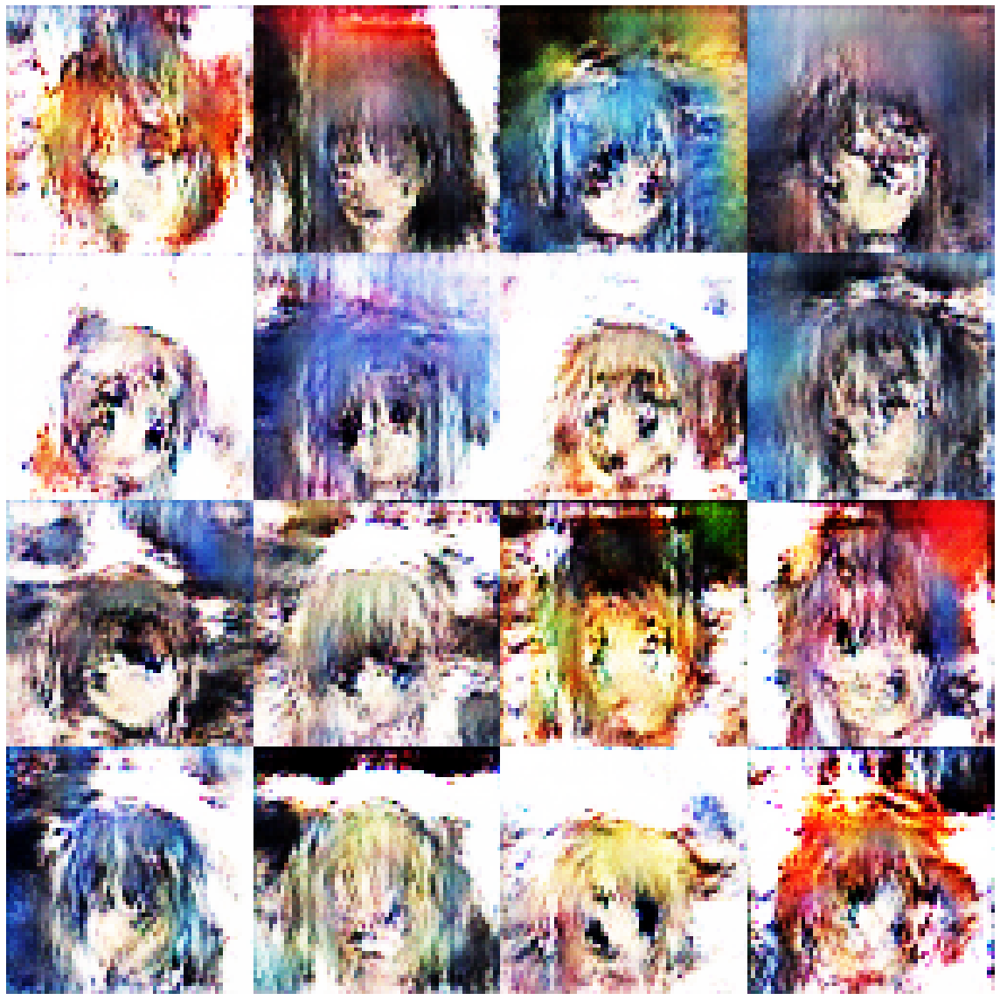

Disc: real loss: 0.367114 fake loss: 0.405833
GAN loss: 2.701133
Step 1600 completed. Time took: 1 secs.
Begin step:  1601
Disc: real loss: 0.360319 fake loss: 0.383085
GAN loss: 2.111255
Step 1601 completed. Time took: 0 secs.
Begin step:  1602
Disc: real loss: 0.353775 fake loss: 0.508522
GAN loss: 3.656594
Step 1602 completed. Time took: 0 secs.
Begin step:  1603
Disc: real loss: 0.521898 fake loss: 0.338260
GAN loss: 1.958927
Step 1603 completed. Time took: 0 secs.
Begin step:  1604
Disc: real loss: 0.352229 fake loss: 0.462252
GAN loss: 3.471427
Step 1604 completed. Time took: 0 secs.
Begin step:  1605
Disc: real loss: 0.473737 fake loss: 0.369959
GAN loss: 1.717617
Step 1605 completed. Time took: 0 secs.
Begin step:  1606
Disc: real loss: 0.357871 fake loss: 0.478290
GAN loss: 3.003591
Step 1606 completed. Time took: 0 secs.
Begin step:  1607
Disc: real loss: 0.446938 fake loss: 0.338391
GAN loss: 1.813569
Step 1607 completed. Time took: 0 secs.
Begin step:  1608
Disc: real loss:

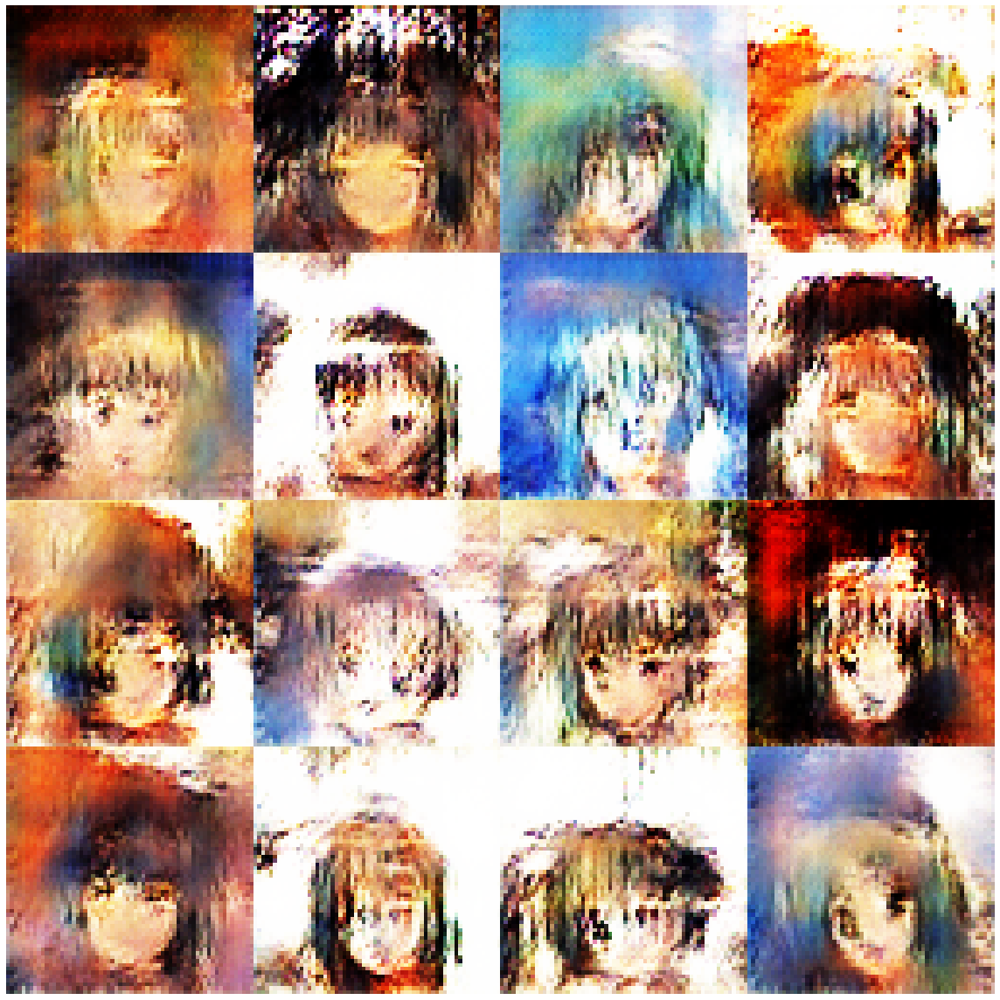

Disc: real loss: 0.366305 fake loss: 0.475051
GAN loss: 2.507460
Step 1700 completed. Time took: 1 secs.
Begin step:  1701
Disc: real loss: 0.484001 fake loss: 0.380383
GAN loss: 1.776774
Step 1701 completed. Time took: 0 secs.
Begin step:  1702
Disc: real loss: 0.352317 fake loss: 0.342602
GAN loss: 2.170017
Step 1702 completed. Time took: 0 secs.
Begin step:  1703
Disc: real loss: 0.381976 fake loss: 0.375159
GAN loss: 2.119919
Step 1703 completed. Time took: 0 secs.
Begin step:  1704
Disc: real loss: 0.427132 fake loss: 0.418989
GAN loss: 2.293049
Step 1704 completed. Time took: 0 secs.
Begin step:  1705
Disc: real loss: 0.346931 fake loss: 0.357818
GAN loss: 2.016327
Step 1705 completed. Time took: 0 secs.
Begin step:  1706
Disc: real loss: 0.369677 fake loss: 0.443418
GAN loss: 2.913920
Step 1706 completed. Time took: 0 secs.
Begin step:  1707
Disc: real loss: 0.427435 fake loss: 0.346422
GAN loss: 2.258682
Step 1707 completed. Time took: 0 secs.
Begin step:  1708
Disc: real loss:

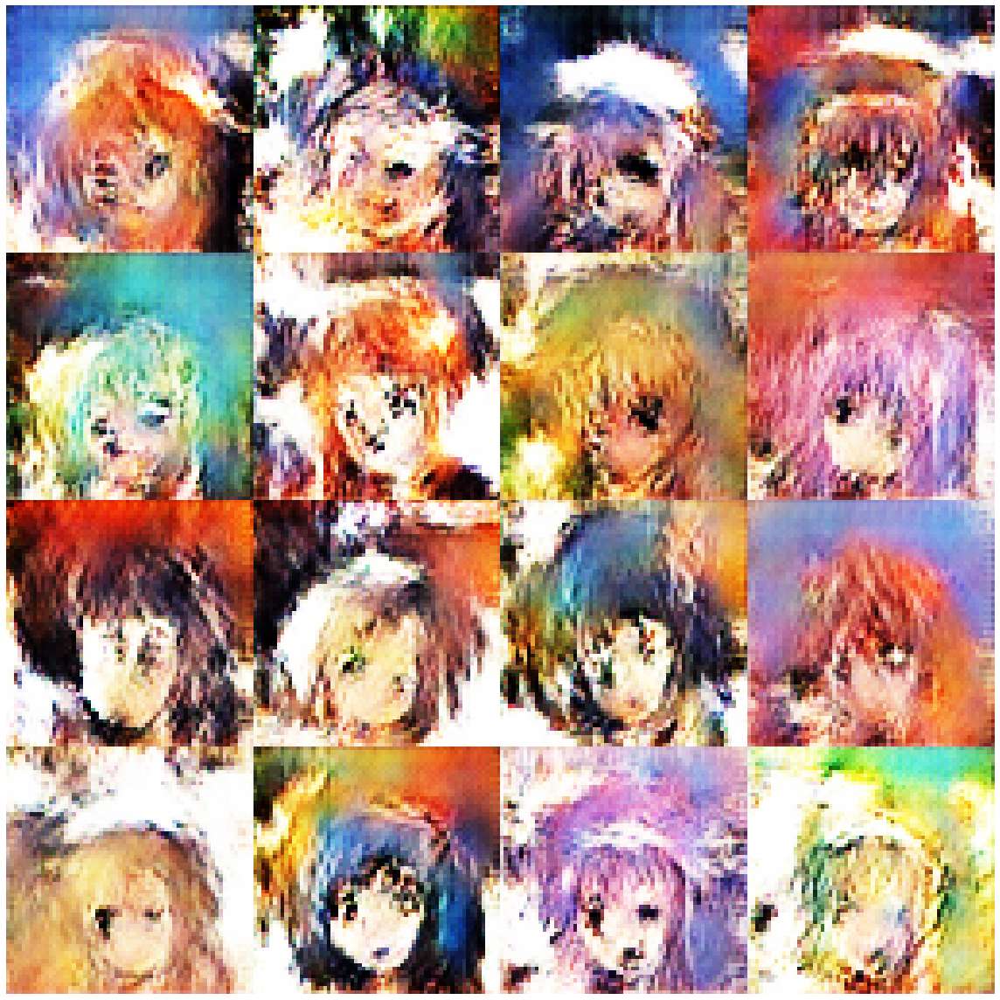

Disc: real loss: 0.366492 fake loss: 0.354304
GAN loss: 2.362970
Step 1800 completed. Time took: 1 secs.
Begin step:  1801
Disc: real loss: 0.358525 fake loss: 0.403527
GAN loss: 2.799633
Step 1801 completed. Time took: 0 secs.
Begin step:  1802
Disc: real loss: 0.505226 fake loss: 0.406004
GAN loss: 2.509579
Step 1802 completed. Time took: 0 secs.
Begin step:  1803
Disc: real loss: 0.357699 fake loss: 0.343059
GAN loss: 2.157554
Step 1803 completed. Time took: 0 secs.
Begin step:  1804
Disc: real loss: 0.333221 fake loss: 0.442198
GAN loss: 3.056573
Step 1804 completed. Time took: 0 secs.
Begin step:  1805
Disc: real loss: 0.402800 fake loss: 0.376830
GAN loss: 1.997789
Step 1805 completed. Time took: 0 secs.
Begin step:  1806
Disc: real loss: 0.354871 fake loss: 0.452418
GAN loss: 3.310330
Step 1806 completed. Time took: 0 secs.
Begin step:  1807
Disc: real loss: 0.460706 fake loss: 0.347848
GAN loss: 1.840498
Step 1807 completed. Time took: 0 secs.
Begin step:  1808
Disc: real loss:

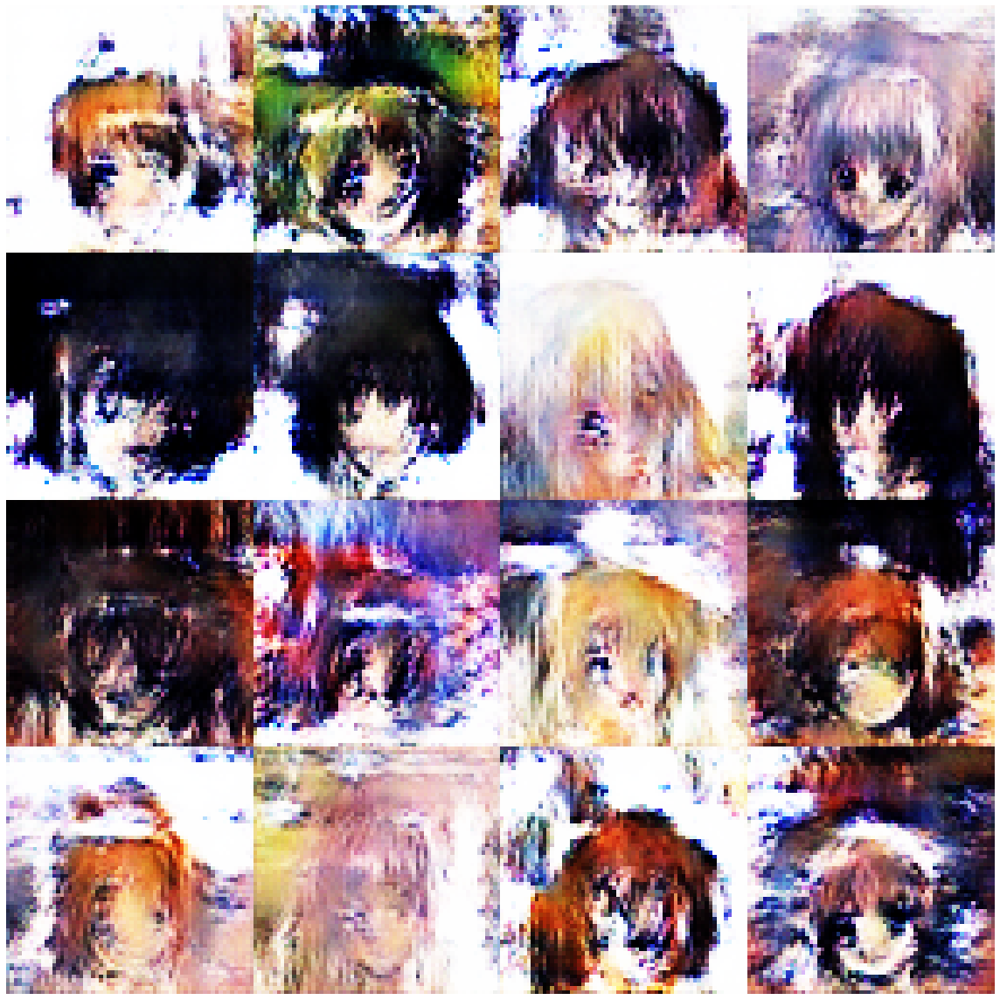

Disc: real loss: 0.370707 fake loss: 0.672495
GAN loss: 4.225012
Step 1900 completed. Time took: 1 secs.
Begin step:  1901
Disc: real loss: 0.945775 fake loss: 0.518233
GAN loss: 2.255903
Step 1901 completed. Time took: 0 secs.
Begin step:  1902
Disc: real loss: 0.378393 fake loss: 0.394185
GAN loss: 2.403755
Step 1902 completed. Time took: 0 secs.
Begin step:  1903
Disc: real loss: 0.360906 fake loss: 0.379822
GAN loss: 2.315590
Step 1903 completed. Time took: 0 secs.
Begin step:  1904
Disc: real loss: 0.375667 fake loss: 0.426865
GAN loss: 3.103927
Step 1904 completed. Time took: 0 secs.
Begin step:  1905
Disc: real loss: 0.416681 fake loss: 0.326290
GAN loss: 2.291620
Step 1905 completed. Time took: 0 secs.
Begin step:  1906
Disc: real loss: 0.364868 fake loss: 0.410325
GAN loss: 3.326372
Step 1906 completed. Time took: 0 secs.
Begin step:  1907
Disc: real loss: 0.465820 fake loss: 0.364793
GAN loss: 1.601089
Step 1907 completed. Time took: 0 secs.
Begin step:  1908
Disc: real loss:

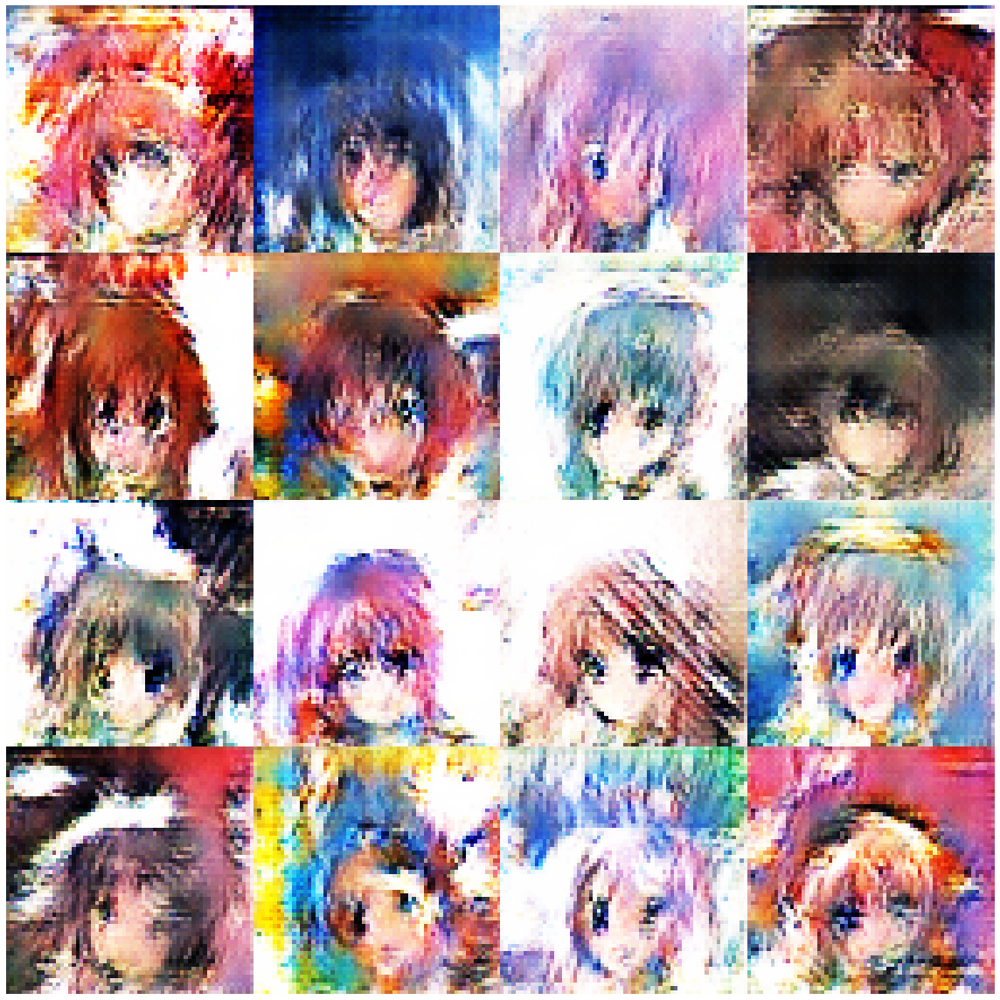

Begin step:  2000


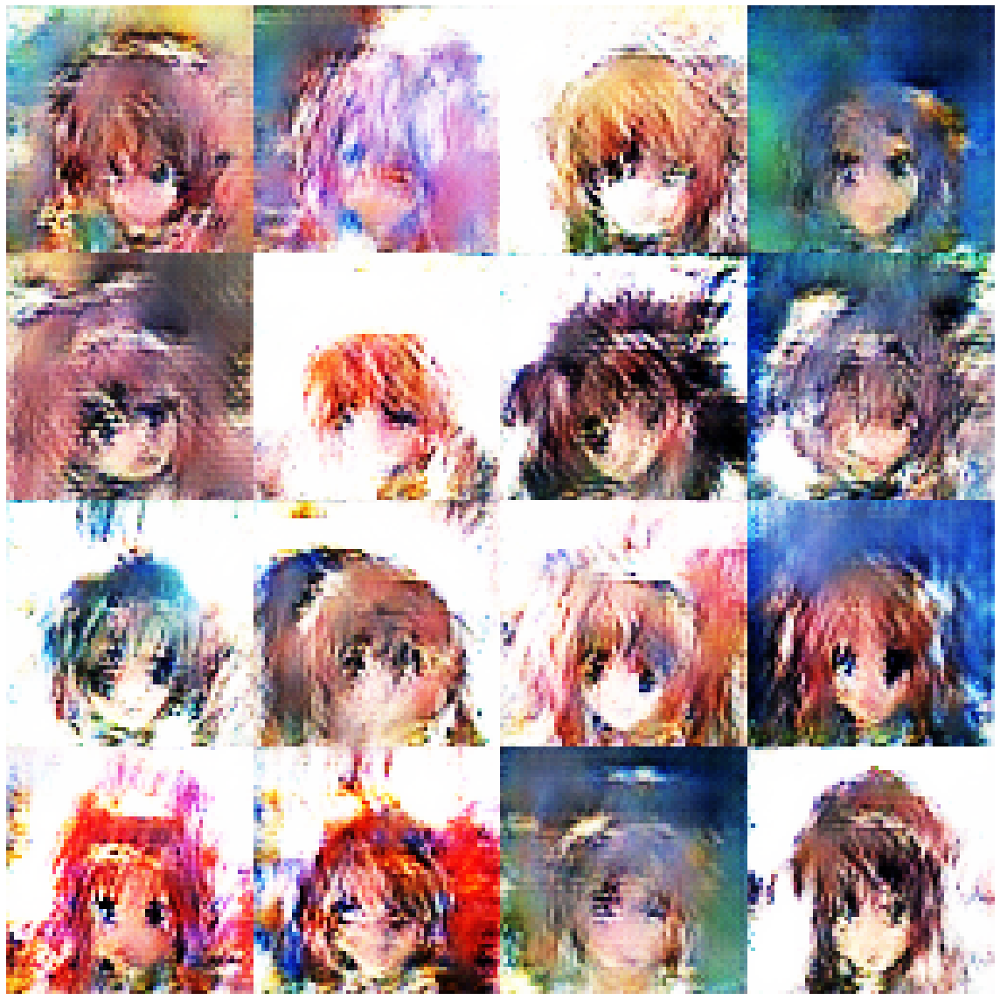

Disc: real loss: 0.392643 fake loss: 0.377946
GAN loss: 2.877138
Step 2000 completed. Time took: 1 secs.
Begin step:  2001
Disc: real loss: 0.383072 fake loss: 0.359013
GAN loss: 2.644946
Step 2001 completed. Time took: 0 secs.
Begin step:  2002
Disc: real loss: 0.395704 fake loss: 0.469122
GAN loss: 3.391226
Step 2002 completed. Time took: 0 secs.
Begin step:  2003
Disc: real loss: 0.522200 fake loss: 0.364715
GAN loss: 2.584578
Step 2003 completed. Time took: 0 secs.
Begin step:  2004
Disc: real loss: 0.366241 fake loss: 0.366811
GAN loss: 2.400216
Step 2004 completed. Time took: 0 secs.
Begin step:  2005
Disc: real loss: 0.358292 fake loss: 0.384824
GAN loss: 3.173081
Step 2005 completed. Time took: 0 secs.
Begin step:  2006
Disc: real loss: 0.410995 fake loss: 0.359377
GAN loss: 1.721418
Step 2006 completed. Time took: 0 secs.
Begin step:  2007
Disc: real loss: 0.349951 fake loss: 0.403195
GAN loss: 3.010615
Step 2007 completed. Time took: 0 secs.
Begin step:  2008
Disc: real loss:

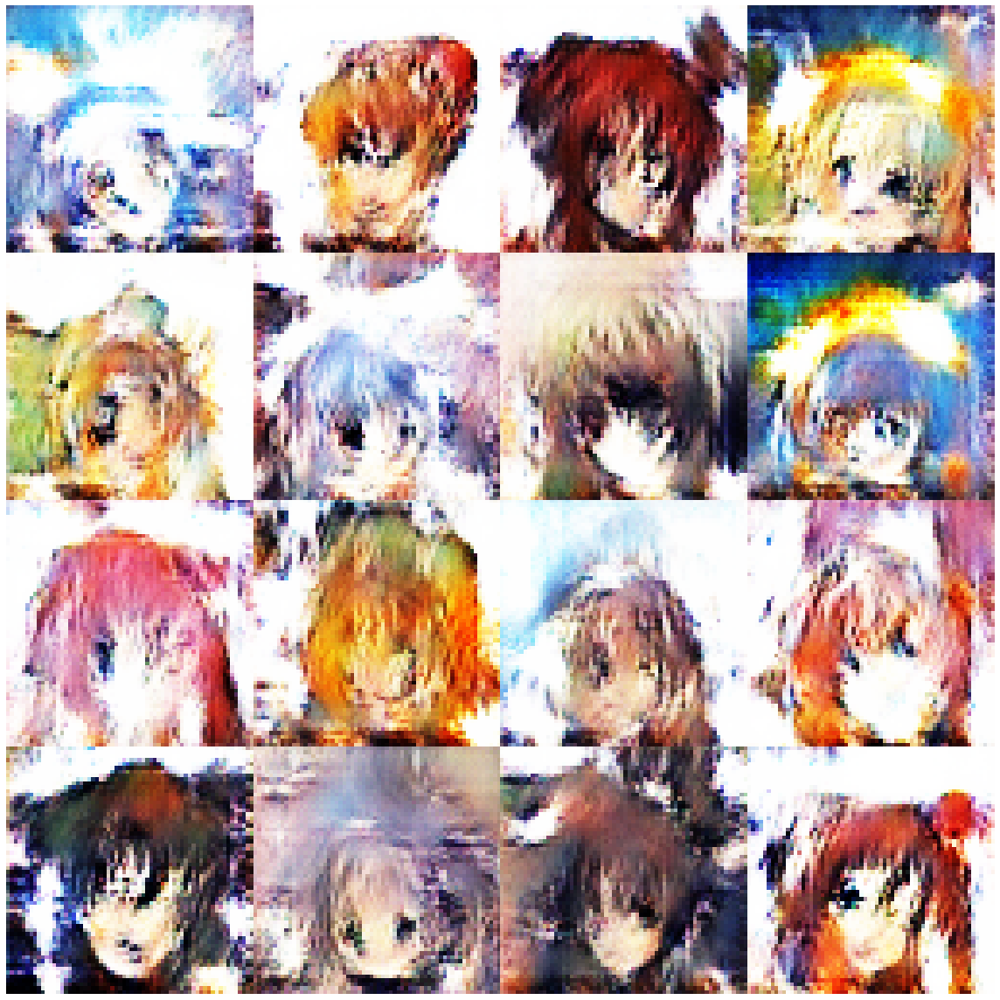

Disc: real loss: 0.343688 fake loss: 0.611789
GAN loss: 4.752251
Step 2100 completed. Time took: 1 secs.
Begin step:  2101
Disc: real loss: 0.770431 fake loss: 0.336824
GAN loss: 1.600567
Step 2101 completed. Time took: 0 secs.
Begin step:  2102
Disc: real loss: 0.355419 fake loss: 0.525158
GAN loss: 3.617711
Step 2102 completed. Time took: 0 secs.
Begin step:  2103
Disc: real loss: 0.449885 fake loss: 0.360941
GAN loss: 1.894773
Step 2103 completed. Time took: 0 secs.
Begin step:  2104
Disc: real loss: 0.336718 fake loss: 0.514962
GAN loss: 4.049798
Step 2104 completed. Time took: 0 secs.
Begin step:  2105
Disc: real loss: 0.620217 fake loss: 0.365858
GAN loss: 1.879878
Step 2105 completed. Time took: 0 secs.
Begin step:  2106
Disc: real loss: 0.354207 fake loss: 0.451721
GAN loss: 3.873904
Step 2106 completed. Time took: 0 secs.
Begin step:  2107
Disc: real loss: 0.546188 fake loss: 0.375297
GAN loss: 2.034723
Step 2107 completed. Time took: 0 secs.
Begin step:  2108
Disc: real loss:

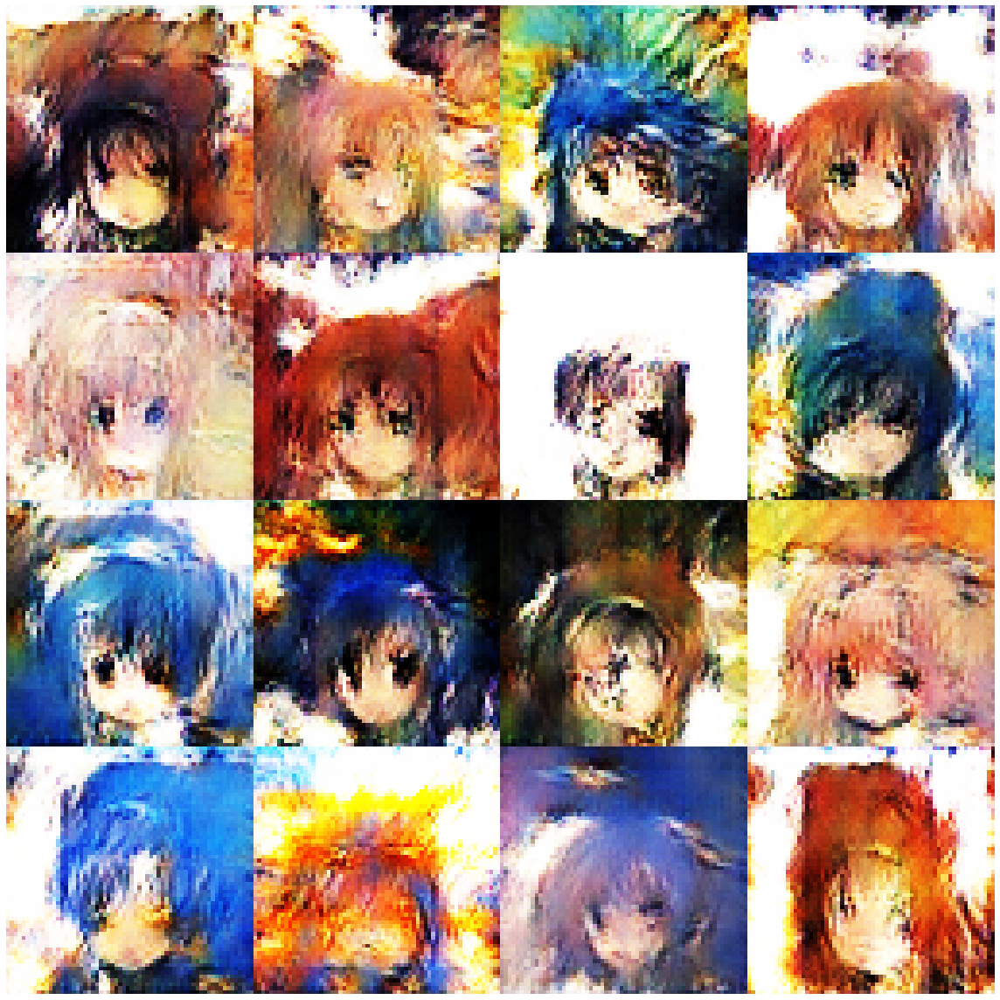

Disc: real loss: 0.364111 fake loss: 0.367278
GAN loss: 2.217303
Step 2200 completed. Time took: 1 secs.
Begin step:  2201
Disc: real loss: 0.373140 fake loss: 0.376070
GAN loss: 1.602859
Step 2201 completed. Time took: 0 secs.
Begin step:  2202
Disc: real loss: 0.345840 fake loss: 0.418432
GAN loss: 2.992856
Step 2202 completed. Time took: 0 secs.
Begin step:  2203
Disc: real loss: 0.481106 fake loss: 0.345431
GAN loss: 2.013363
Step 2203 completed. Time took: 0 secs.
Begin step:  2204
Disc: real loss: 0.350666 fake loss: 0.346454
GAN loss: 2.401793
Step 2204 completed. Time took: 0 secs.
Begin step:  2205
Disc: real loss: 0.348608 fake loss: 0.342738
GAN loss: 2.209795
Step 2205 completed. Time took: 0 secs.
Begin step:  2206
Disc: real loss: 0.381083 fake loss: 0.353519
GAN loss: 2.170038
Step 2206 completed. Time took: 0 secs.
Begin step:  2207
Disc: real loss: 0.372546 fake loss: 0.548170
GAN loss: 4.519986
Step 2207 completed. Time took: 0 secs.
Begin step:  2208
Disc: real loss:

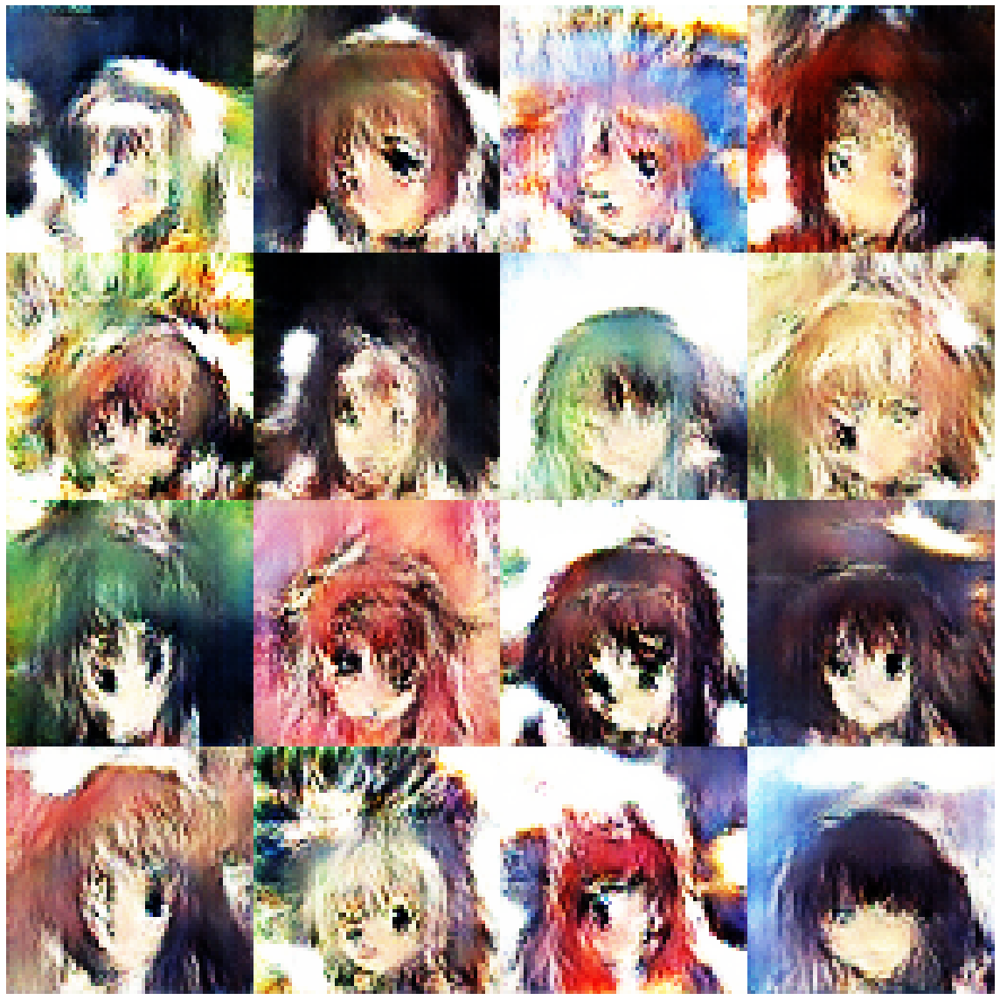

Disc: real loss: 0.402418 fake loss: 0.494093
GAN loss: 3.240510
Step 2300 completed. Time took: 1 secs.
Begin step:  2301
Disc: real loss: 0.469690 fake loss: 0.340612
GAN loss: 1.933607
Step 2301 completed. Time took: 0 secs.
Begin step:  2302
Disc: real loss: 0.362256 fake loss: 0.355146
GAN loss: 2.930005
Step 2302 completed. Time took: 0 secs.
Begin step:  2303
Disc: real loss: 0.345468 fake loss: 0.412322
GAN loss: 1.978703
Step 2303 completed. Time took: 0 secs.
Begin step:  2304
Disc: real loss: 0.351337 fake loss: 0.407528
GAN loss: 2.995930
Step 2304 completed. Time took: 0 secs.
Begin step:  2305
Disc: real loss: 0.405118 fake loss: 0.341387
GAN loss: 1.866586
Step 2305 completed. Time took: 0 secs.
Begin step:  2306
Disc: real loss: 0.326653 fake loss: 0.369741
GAN loss: 2.536820
Step 2306 completed. Time took: 0 secs.
Begin step:  2307
Disc: real loss: 0.343145 fake loss: 0.362132
GAN loss: 2.237484
Step 2307 completed. Time took: 0 secs.
Begin step:  2308
Disc: real loss:

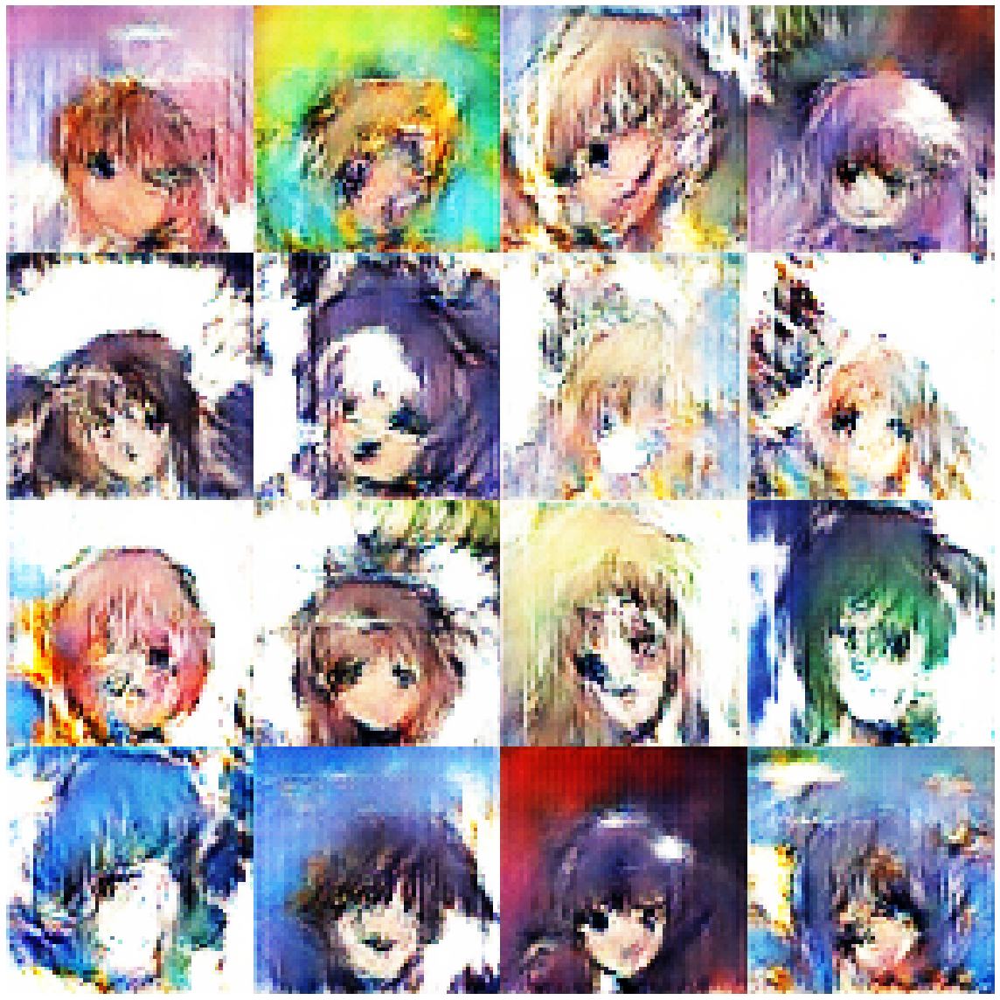

Disc: real loss: 0.454034 fake loss: 0.375722
GAN loss: 1.953888
Step 2400 completed. Time took: 1 secs.
Begin step:  2401
Disc: real loss: 0.368888 fake loss: 0.436449
GAN loss: 3.159545
Step 2401 completed. Time took: 0 secs.
Begin step:  2402
Disc: real loss: 0.377756 fake loss: 0.345265
GAN loss: 2.633359
Step 2402 completed. Time took: 0 secs.
Begin step:  2403
Disc: real loss: 0.352359 fake loss: 0.465014
GAN loss: 3.126479
Step 2403 completed. Time took: 0 secs.
Begin step:  2404
Disc: real loss: 0.448876 fake loss: 0.369622
GAN loss: 2.030207
Step 2404 completed. Time took: 0 secs.
Begin step:  2405
Disc: real loss: 0.329742 fake loss: 0.378602
GAN loss: 2.836355
Step 2405 completed. Time took: 0 secs.
Begin step:  2406
Disc: real loss: 0.387927 fake loss: 0.347906
GAN loss: 1.872235
Step 2406 completed. Time took: 0 secs.
Begin step:  2407
Disc: real loss: 0.351248 fake loss: 0.353485
GAN loss: 1.969191
Step 2407 completed. Time took: 0 secs.
Begin step:  2408
Disc: real loss:

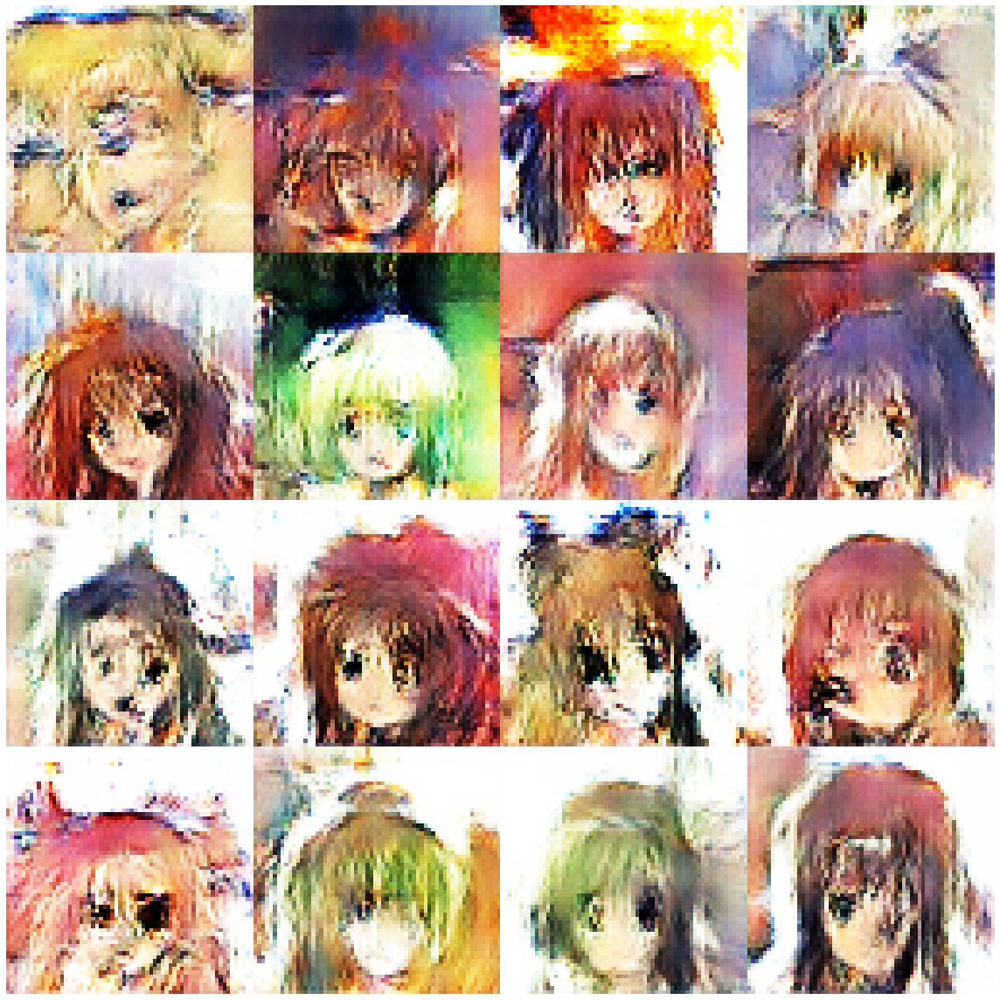

Begin step:  2500


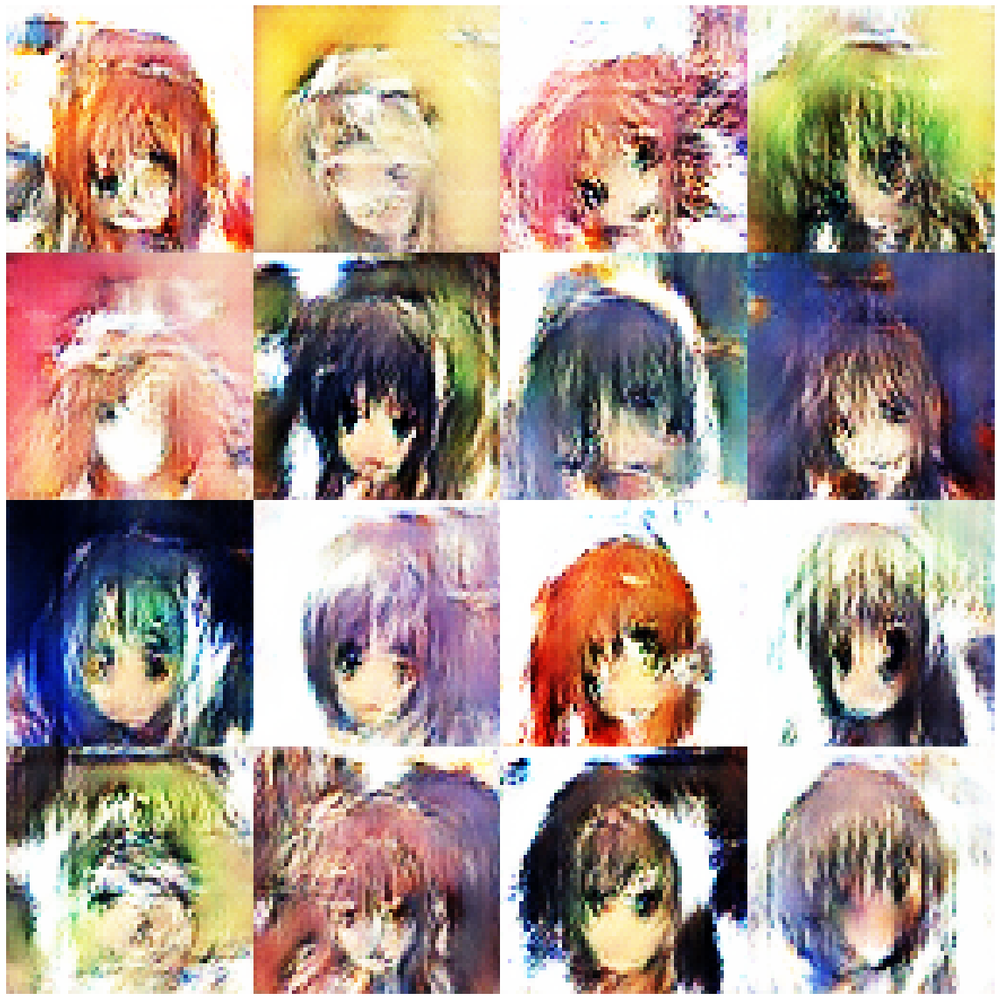

Disc: real loss: 0.383101 fake loss: 0.554742
GAN loss: 4.565287
Step 2500 completed. Time took: 1 secs.
Begin step:  2501
Disc: real loss: 0.693222 fake loss: 0.339001
GAN loss: 1.604031
Step 2501 completed. Time took: 0 secs.
Begin step:  2502
Disc: real loss: 0.390063 fake loss: 0.415603
GAN loss: 3.198765
Step 2502 completed. Time took: 0 secs.
Begin step:  2503
Disc: real loss: 0.412861 fake loss: 0.362744
GAN loss: 1.999461
Step 2503 completed. Time took: 0 secs.
Begin step:  2504
Disc: real loss: 0.333158 fake loss: 0.380693
GAN loss: 2.444730
Step 2504 completed. Time took: 0 secs.
Begin step:  2505
Disc: real loss: 0.350814 fake loss: 0.335824
GAN loss: 1.994691
Step 2505 completed. Time took: 0 secs.
Begin step:  2506
Disc: real loss: 0.341125 fake loss: 0.492225
GAN loss: 3.706567
Step 2506 completed. Time took: 0 secs.
Begin step:  2507
Disc: real loss: 0.903549 fake loss: 0.926441
GAN loss: 4.610465
Step 2507 completed. Time took: 0 secs.
Begin step:  2508
Disc: real loss:

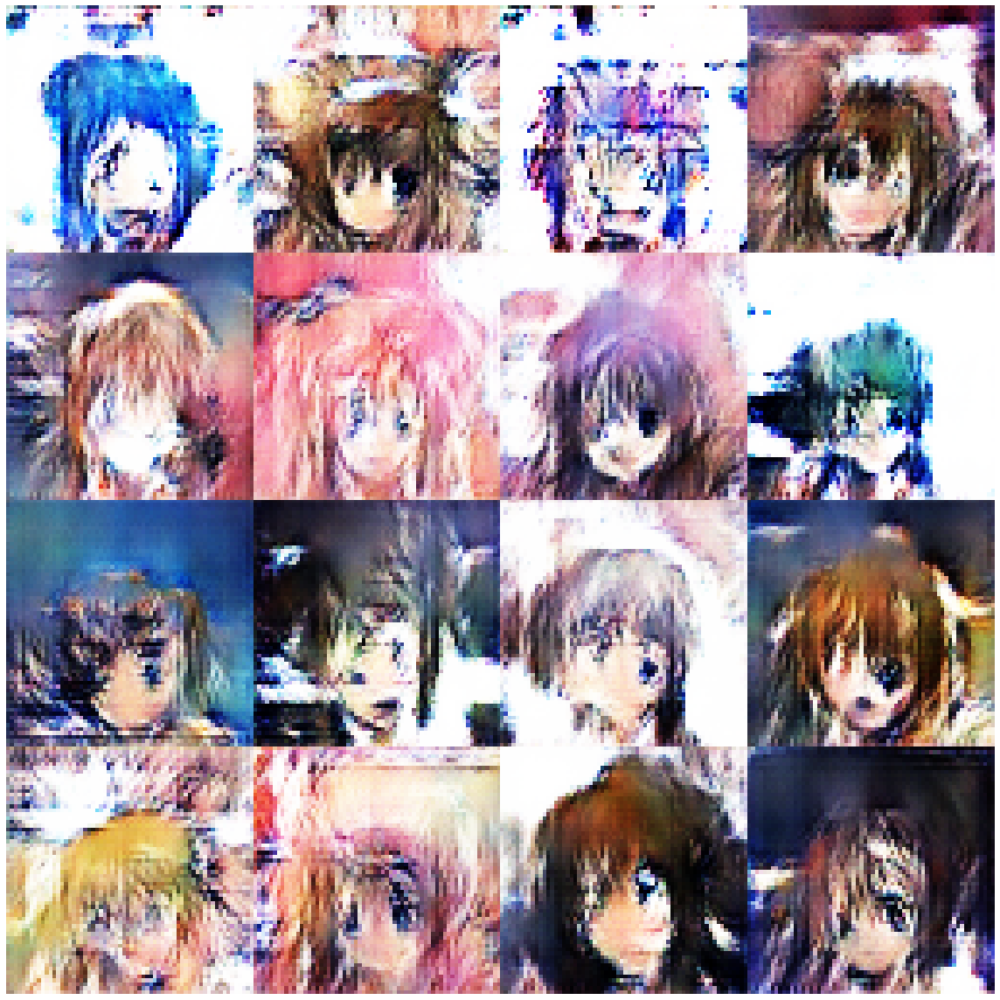

Disc: real loss: 0.357766 fake loss: 0.390743
GAN loss: 2.554936
Step 2600 completed. Time took: 1 secs.
Begin step:  2601
Disc: real loss: 0.499348 fake loss: 0.497030
GAN loss: 2.973943
Step 2601 completed. Time took: 0 secs.
Begin step:  2602
Disc: real loss: 0.383727 fake loss: 0.393996
GAN loss: 2.152056
Step 2602 completed. Time took: 0 secs.
Begin step:  2603
Disc: real loss: 0.353200 fake loss: 0.470491
GAN loss: 3.124011
Step 2603 completed. Time took: 0 secs.
Begin step:  2604
Disc: real loss: 0.439080 fake loss: 0.351741
GAN loss: 1.842909
Step 2604 completed. Time took: 0 secs.
Begin step:  2605
Disc: real loss: 0.344753 fake loss: 0.458924
GAN loss: 3.526016
Step 2605 completed. Time took: 0 secs.
Begin step:  2606
Disc: real loss: 0.511733 fake loss: 0.352084
GAN loss: 1.581765
Step 2606 completed. Time took: 0 secs.
Begin step:  2607
Disc: real loss: 0.390637 fake loss: 0.428167
GAN loss: 2.924643
Step 2607 completed. Time took: 0 secs.
Begin step:  2608
Disc: real loss:

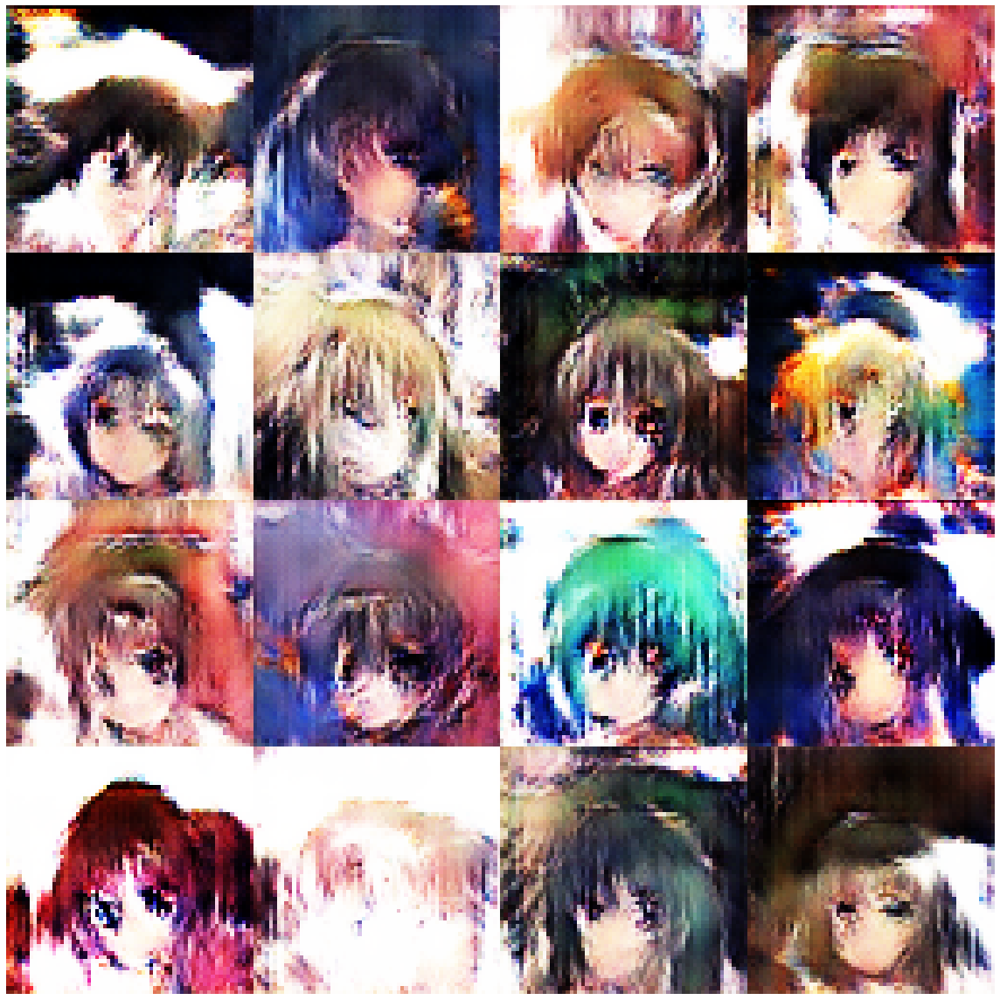

Disc: real loss: 0.528762 fake loss: 0.356511
GAN loss: 1.840418
Step 2700 completed. Time took: 1 secs.
Begin step:  2701
Disc: real loss: 0.332505 fake loss: 0.428423
GAN loss: 3.454770
Step 2701 completed. Time took: 0 secs.
Begin step:  2702
Disc: real loss: 0.432210 fake loss: 0.367478
GAN loss: 1.974193
Step 2702 completed. Time took: 0 secs.
Begin step:  2703
Disc: real loss: 0.347406 fake loss: 0.467951
GAN loss: 3.896754
Step 2703 completed. Time took: 0 secs.
Begin step:  2704
Disc: real loss: 0.435932 fake loss: 0.385471
GAN loss: 1.815975
Step 2704 completed. Time took: 0 secs.
Begin step:  2705
Disc: real loss: 0.363655 fake loss: 0.662910
GAN loss: 4.694595
Step 2705 completed. Time took: 0 secs.
Begin step:  2706
Disc: real loss: 0.883445 fake loss: 0.530140
GAN loss: 3.366606
Step 2706 completed. Time took: 0 secs.
Begin step:  2707
Disc: real loss: 0.361358 fake loss: 0.432882
GAN loss: 2.130793
Step 2707 completed. Time took: 0 secs.
Begin step:  2708
Disc: real loss:

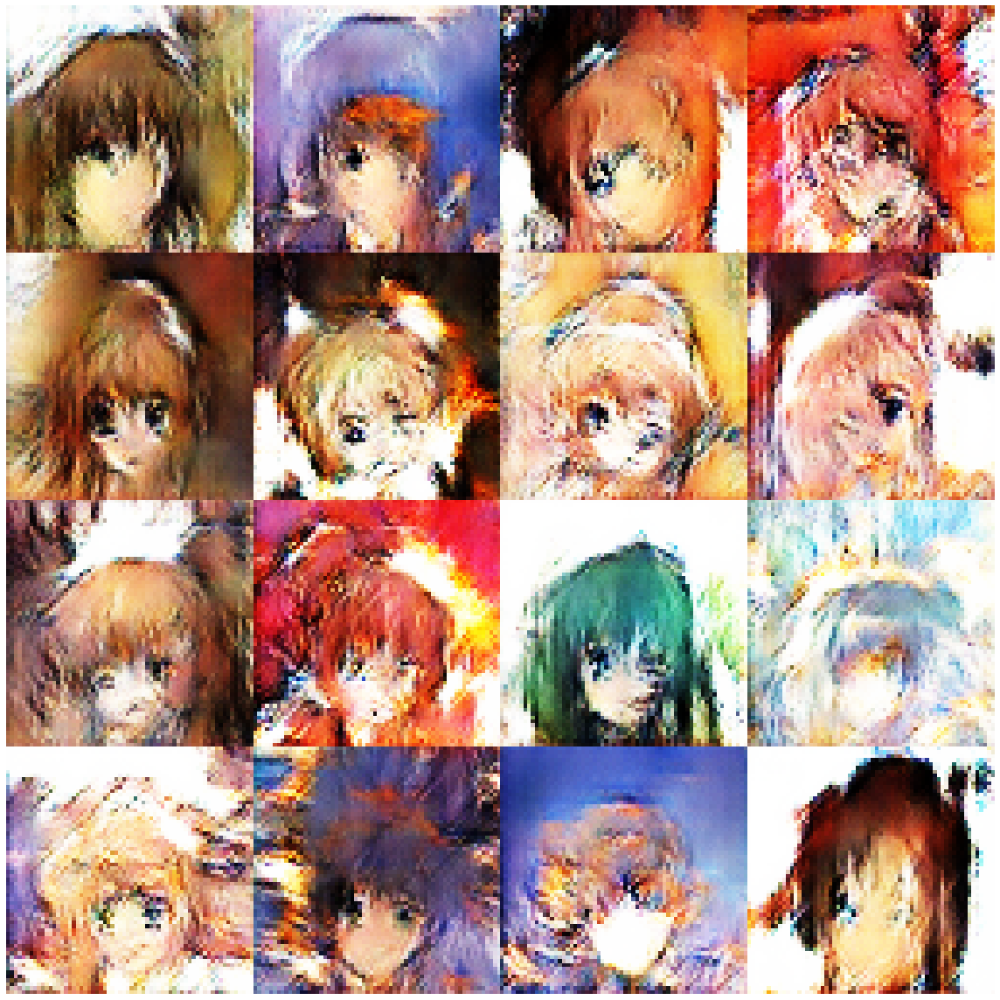

Disc: real loss: 0.356246 fake loss: 0.353119
GAN loss: 2.126963
Step 2800 completed. Time took: 1 secs.
Begin step:  2801
Disc: real loss: 0.351910 fake loss: 0.371905
GAN loss: 2.539116
Step 2801 completed. Time took: 0 secs.
Begin step:  2802
Disc: real loss: 0.390317 fake loss: 0.356925
GAN loss: 2.505190
Step 2802 completed. Time took: 0 secs.
Begin step:  2803
Disc: real loss: 0.359774 fake loss: 0.379146
GAN loss: 2.611143
Step 2803 completed. Time took: 0 secs.
Begin step:  2804
Disc: real loss: 0.387602 fake loss: 0.358010
GAN loss: 2.130371
Step 2804 completed. Time took: 0 secs.
Begin step:  2805
Disc: real loss: 0.347349 fake loss: 0.353919
GAN loss: 2.371098
Step 2805 completed. Time took: 0 secs.
Begin step:  2806
Disc: real loss: 0.346268 fake loss: 0.351023
GAN loss: 2.752542
Step 2806 completed. Time took: 0 secs.
Begin step:  2807
Disc: real loss: 0.357968 fake loss: 0.328752
GAN loss: 2.288896
Step 2807 completed. Time took: 0 secs.
Begin step:  2808
Disc: real loss:

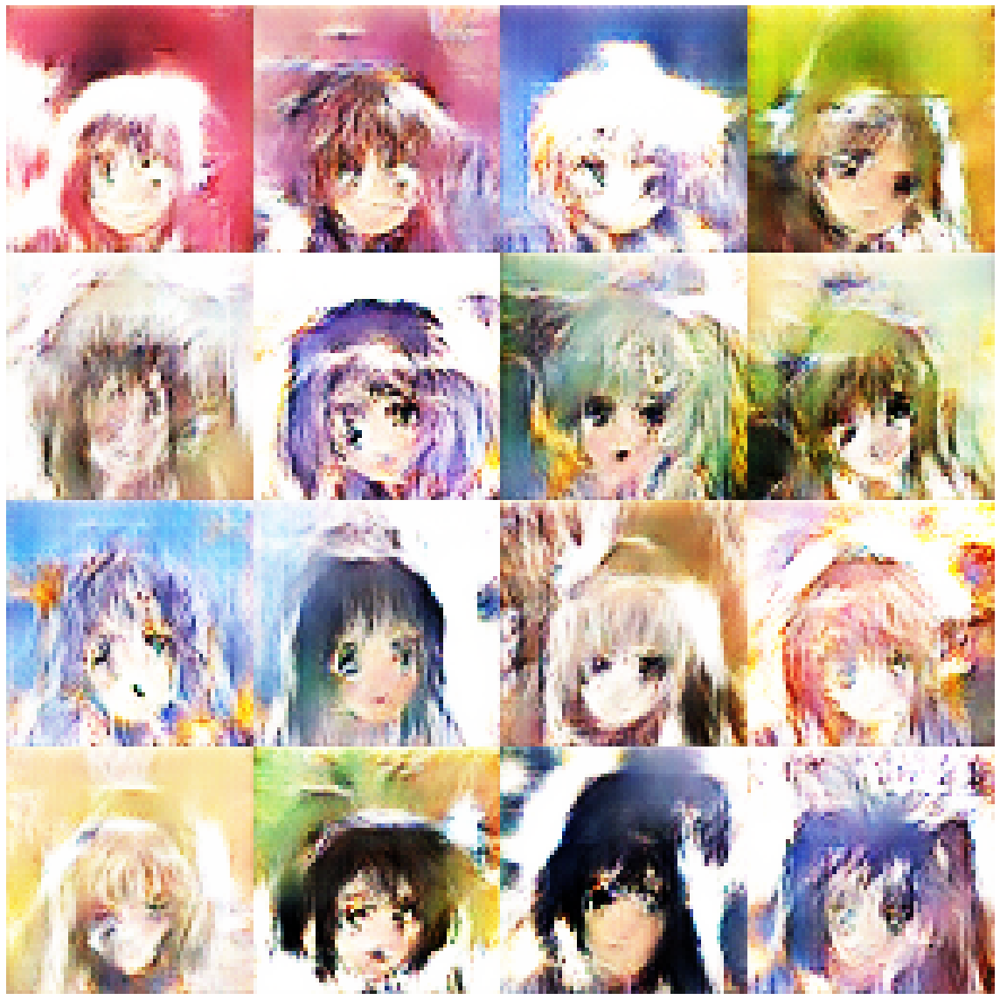

Disc: real loss: 0.487511 fake loss: 0.334963
GAN loss: 1.413088
Step 2900 completed. Time took: 1 secs.
Begin step:  2901
Disc: real loss: 0.372823 fake loss: 0.369908
GAN loss: 2.974747
Step 2901 completed. Time took: 0 secs.
Begin step:  2902
Disc: real loss: 0.384371 fake loss: 0.353282
GAN loss: 1.825038
Step 2902 completed. Time took: 0 secs.
Begin step:  2903
Disc: real loss: 0.342165 fake loss: 0.384011
GAN loss: 2.556584
Step 2903 completed. Time took: 0 secs.
Begin step:  2904
Disc: real loss: 0.469255 fake loss: 0.429042
GAN loss: 2.779474
Step 2904 completed. Time took: 0 secs.
Begin step:  2905
Disc: real loss: 0.351344 fake loss: 0.361735
GAN loss: 1.982807
Step 2905 completed. Time took: 0 secs.
Begin step:  2906
Disc: real loss: 0.383131 fake loss: 0.367064
GAN loss: 2.112729
Step 2906 completed. Time took: 0 secs.
Begin step:  2907
Disc: real loss: 0.376437 fake loss: 0.480869
GAN loss: 3.680670
Step 2907 completed. Time took: 0 secs.
Begin step:  2908
Disc: real loss:

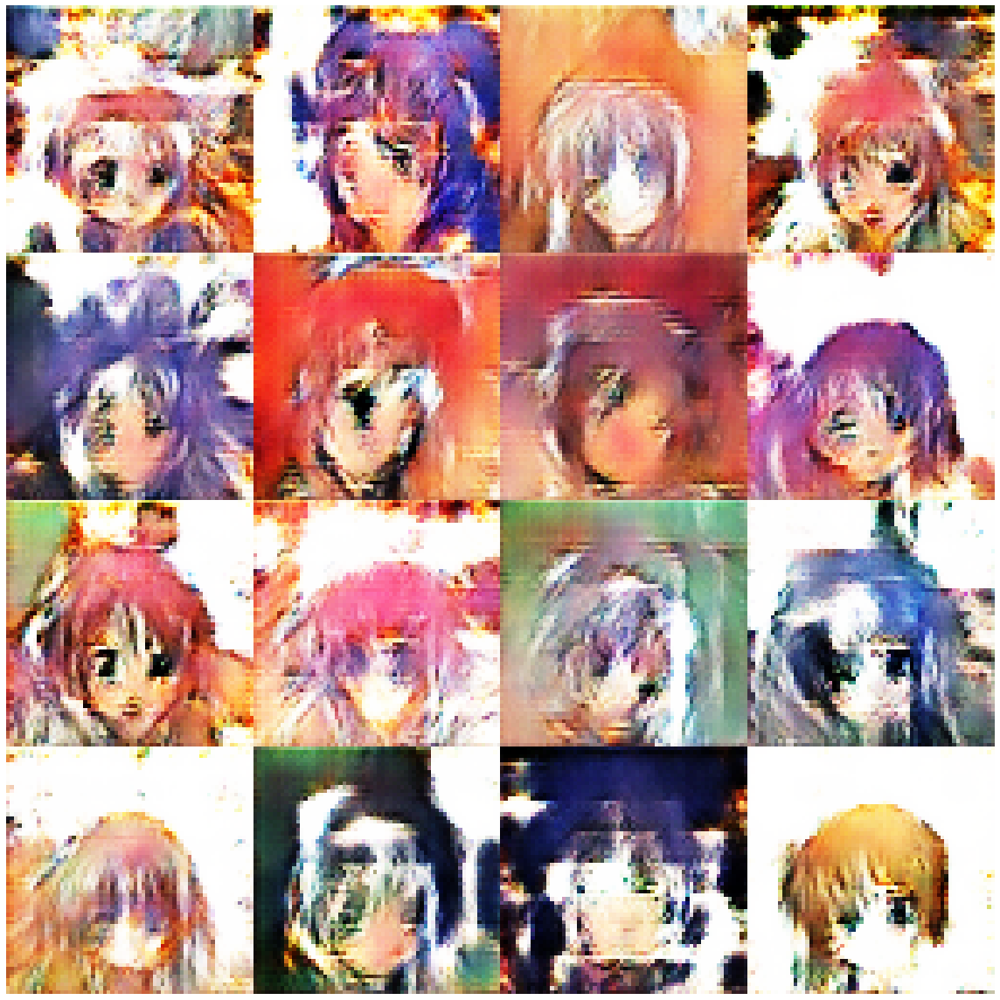

Begin step:  3000


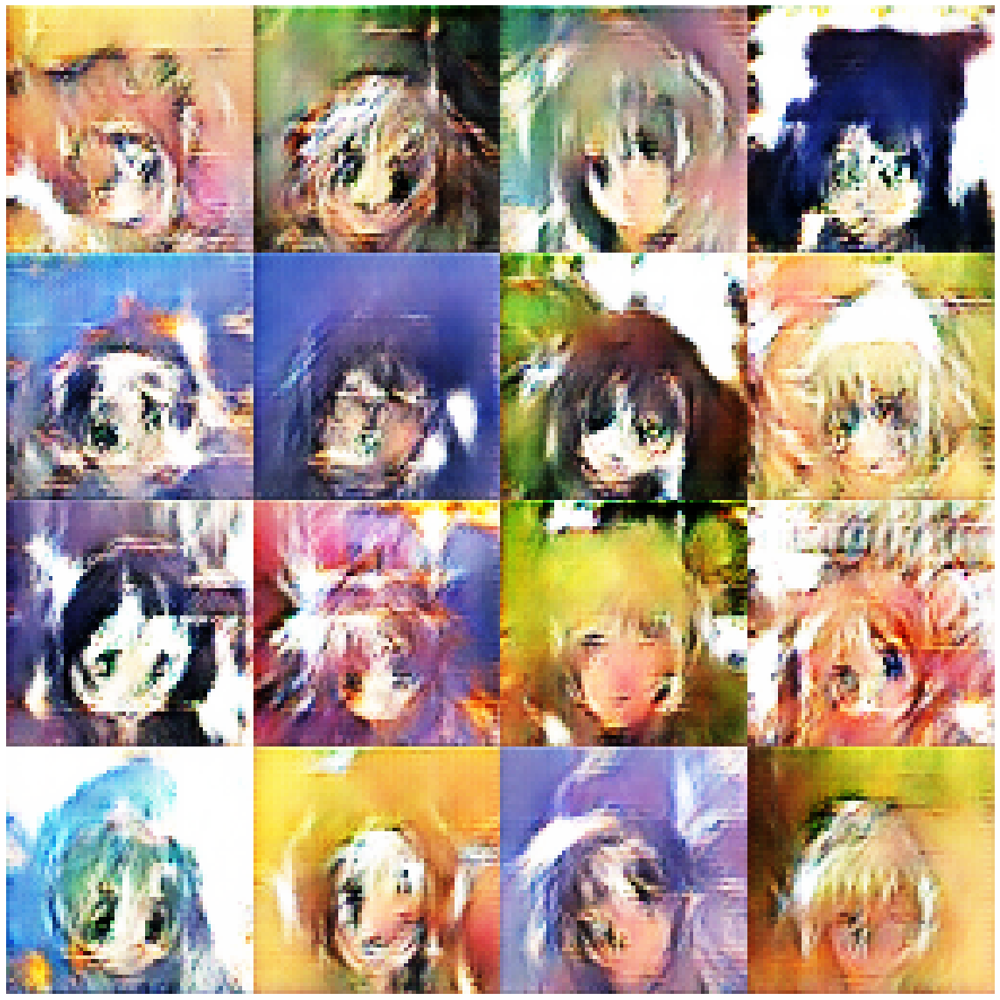

Disc: real loss: 0.385312 fake loss: 0.560113
GAN loss: 3.647038
Step 3000 completed. Time took: 1 secs.
Begin step:  3001
Disc: real loss: 0.634985 fake loss: 0.352530
GAN loss: 1.572332
Step 3001 completed. Time took: 0 secs.
Begin step:  3002
Disc: real loss: 0.374642 fake loss: 0.437557
GAN loss: 3.573192
Step 3002 completed. Time took: 0 secs.
Begin step:  3003
Disc: real loss: 0.416461 fake loss: 0.360621
GAN loss: 2.235710
Step 3003 completed. Time took: 0 secs.
Begin step:  3004
Disc: real loss: 0.369813 fake loss: 0.472971
GAN loss: 3.128406
Step 3004 completed. Time took: 0 secs.
Begin step:  3005
Disc: real loss: 0.419279 fake loss: 0.373985
GAN loss: 1.747473
Step 3005 completed. Time took: 0 secs.
Begin step:  3006
Disc: real loss: 0.359344 fake loss: 0.466705
GAN loss: 2.906612
Step 3006 completed. Time took: 0 secs.
Begin step:  3007
Disc: real loss: 0.423536 fake loss: 0.325654
GAN loss: 1.919915
Step 3007 completed. Time took: 0 secs.
Begin step:  3008
Disc: real loss:

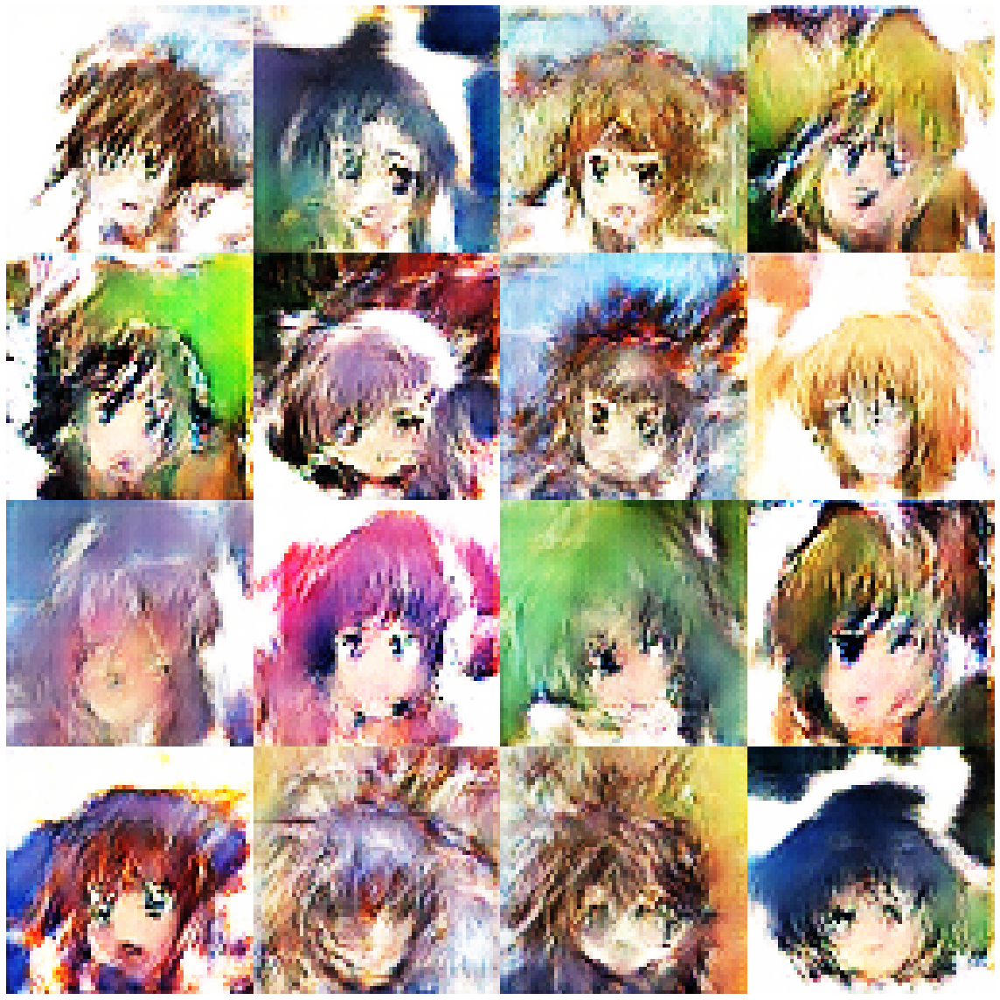

Disc: real loss: 0.386012 fake loss: 0.336983
GAN loss: 2.208531
Step 3100 completed. Time took: 1 secs.
Begin step:  3101
Disc: real loss: 0.361372 fake loss: 0.420778
GAN loss: 2.899127
Step 3101 completed. Time took: 0 secs.
Begin step:  3102
Disc: real loss: 0.453763 fake loss: 0.354525
GAN loss: 1.760771
Step 3102 completed. Time took: 0 secs.
Begin step:  3103
Disc: real loss: 0.364063 fake loss: 0.402476
GAN loss: 3.096898
Step 3103 completed. Time took: 0 secs.
Begin step:  3104
Disc: real loss: 0.463866 fake loss: 0.376342
GAN loss: 2.309328
Step 3104 completed. Time took: 0 secs.
Begin step:  3105
Disc: real loss: 0.335299 fake loss: 0.357764
GAN loss: 2.472606
Step 3105 completed. Time took: 0 secs.
Begin step:  3106
Disc: real loss: 0.356110 fake loss: 0.358930
GAN loss: 2.291889
Step 3106 completed. Time took: 0 secs.
Begin step:  3107
Disc: real loss: 0.372273 fake loss: 0.414322
GAN loss: 2.688768
Step 3107 completed. Time took: 0 secs.
Begin step:  3108
Disc: real loss:

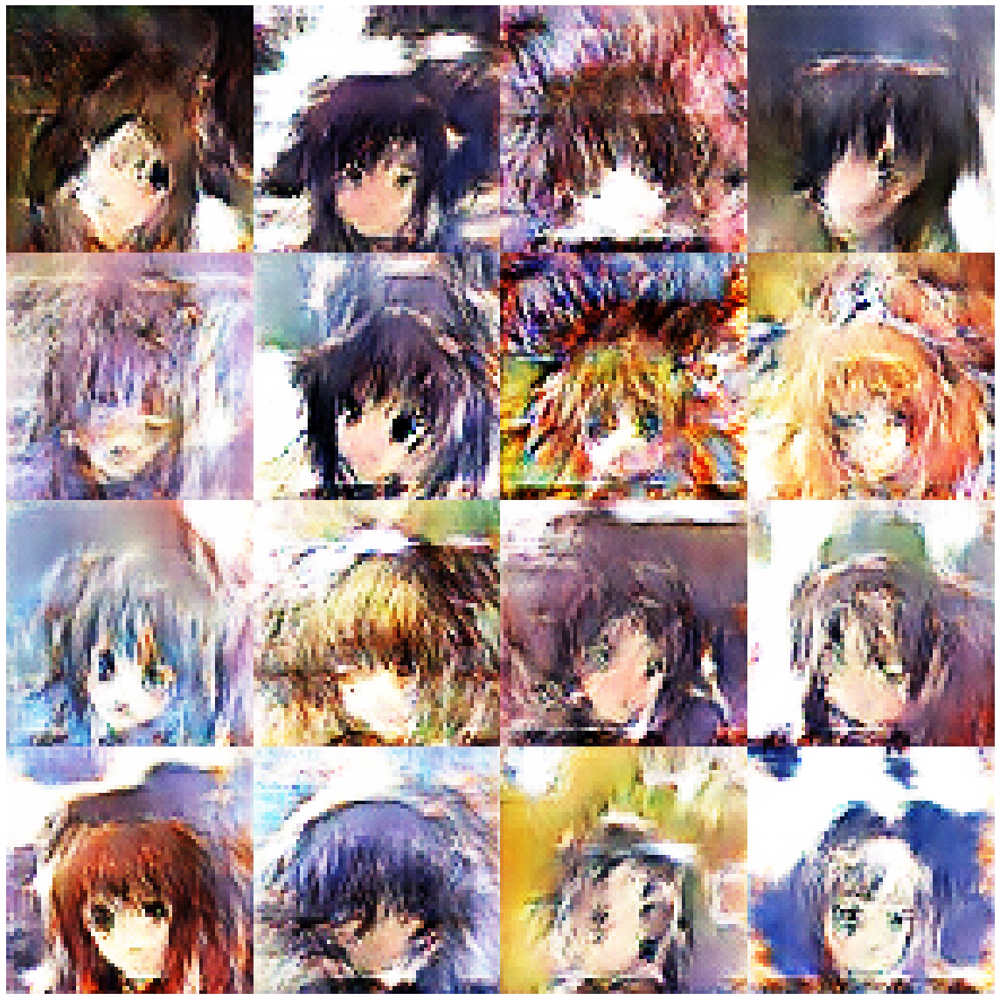

Disc: real loss: 0.346507 fake loss: 0.485469
GAN loss: 4.414566
Step 3200 completed. Time took: 1 secs.
Begin step:  3201
Disc: real loss: 0.589037 fake loss: 0.345499
GAN loss: 1.783100
Step 3201 completed. Time took: 0 secs.
Begin step:  3202
Disc: real loss: 0.350850 fake loss: 0.367287
GAN loss: 3.002152
Step 3202 completed. Time took: 0 secs.
Begin step:  3203
Disc: real loss: 0.351014 fake loss: 0.332955
GAN loss: 2.280245
Step 3203 completed. Time took: 0 secs.
Begin step:  3204
Disc: real loss: 0.367788 fake loss: 0.355095
GAN loss: 2.533744
Step 3204 completed. Time took: 0 secs.
Begin step:  3205
Disc: real loss: 0.401544 fake loss: 0.432943
GAN loss: 2.767684
Step 3205 completed. Time took: 0 secs.
Begin step:  3206
Disc: real loss: 0.391757 fake loss: 0.341800
GAN loss: 2.093530
Step 3206 completed. Time took: 0 secs.
Begin step:  3207
Disc: real loss: 0.359002 fake loss: 0.355032
GAN loss: 1.898811
Step 3207 completed. Time took: 0 secs.
Begin step:  3208
Disc: real loss:

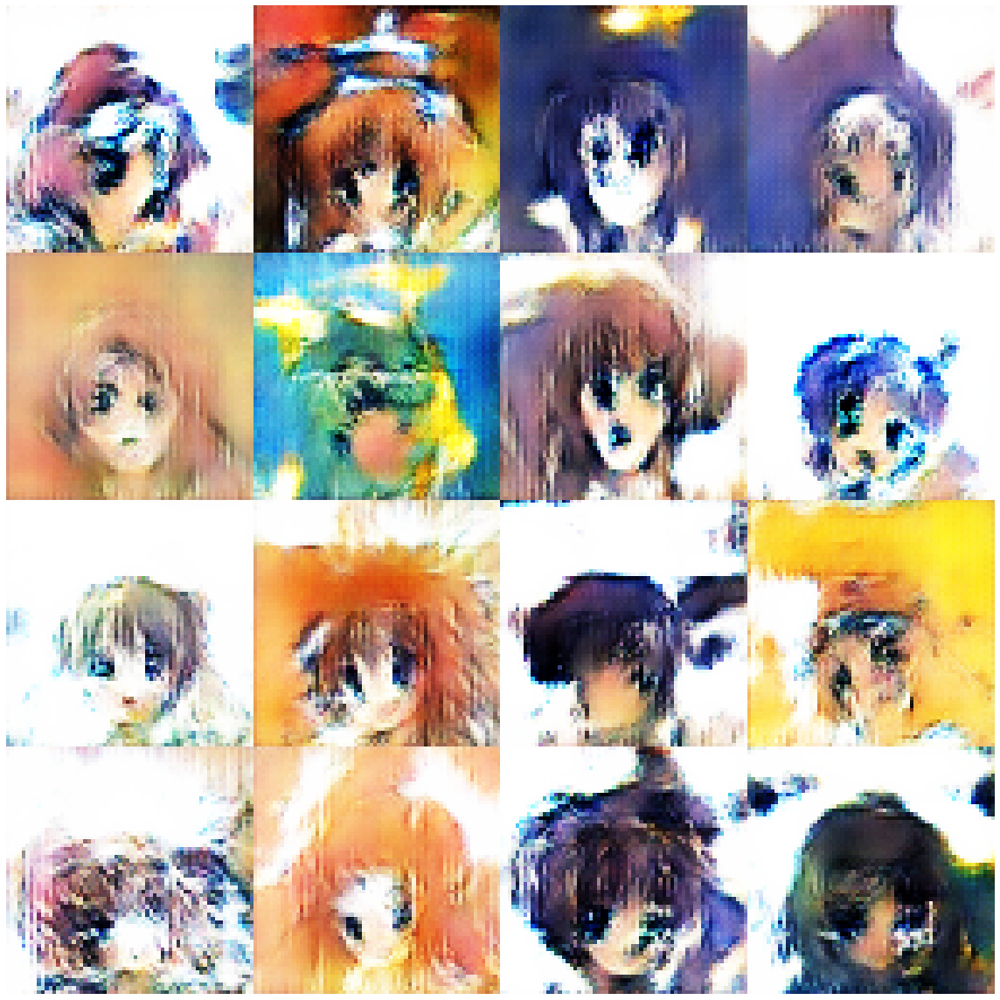

Disc: real loss: 0.720174 fake loss: 1.590755
GAN loss: 4.705508
Step 3300 completed. Time took: 1 secs.
Begin step:  3301
Disc: real loss: 1.718718 fake loss: 0.440241
GAN loss: 0.975519
Step 3301 completed. Time took: 0 secs.
Begin step:  3302
Disc: real loss: 0.424786 fake loss: 0.686121
GAN loss: 3.763747
Step 3302 completed. Time took: 0 secs.
Begin step:  3303
Disc: real loss: 0.567888 fake loss: 0.431369
GAN loss: 1.383119
Step 3303 completed. Time took: 0 secs.
Begin step:  3304
Disc: real loss: 0.389427 fake loss: 1.063516
GAN loss: 4.321627
Step 3304 completed. Time took: 0 secs.
Begin step:  3305
Disc: real loss: 1.153924 fake loss: 0.364256
GAN loss: 1.326086
Step 3305 completed. Time took: 0 secs.
Begin step:  3306
Disc: real loss: 0.394206 fake loss: 0.752627
GAN loss: 3.323164
Step 3306 completed. Time took: 0 secs.
Begin step:  3307
Disc: real loss: 0.456512 fake loss: 0.413075
GAN loss: 2.677577
Step 3307 completed. Time took: 0 secs.
Begin step:  3308
Disc: real loss:

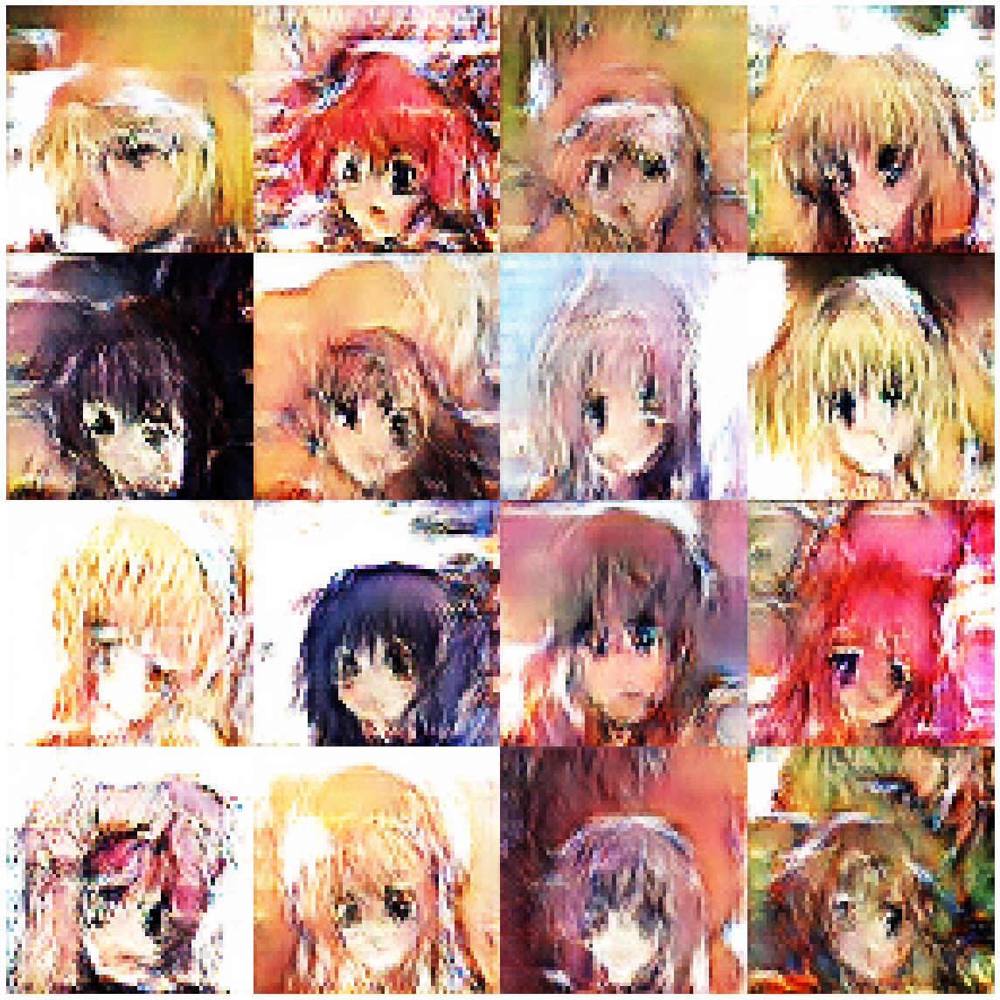

Disc: real loss: 0.360319 fake loss: 0.372154
GAN loss: 2.520206
Step 3400 completed. Time took: 1 secs.
Begin step:  3401
Disc: real loss: 0.367770 fake loss: 0.361890
GAN loss: 2.125262
Step 3401 completed. Time took: 0 secs.
Begin step:  3402
Disc: real loss: 0.352911 fake loss: 0.395083
GAN loss: 2.753622
Step 3402 completed. Time took: 0 secs.
Begin step:  3403
Disc: real loss: 0.378191 fake loss: 0.332319
GAN loss: 2.065099
Step 3403 completed. Time took: 0 secs.
Begin step:  3404
Disc: real loss: 0.327526 fake loss: 0.382060
GAN loss: 2.410598
Step 3404 completed. Time took: 0 secs.
Begin step:  3405
Disc: real loss: 0.375198 fake loss: 0.326486
GAN loss: 2.262051
Step 3405 completed. Time took: 0 secs.
Begin step:  3406
Disc: real loss: 0.361000 fake loss: 0.409327
GAN loss: 2.887908
Step 3406 completed. Time took: 0 secs.
Begin step:  3407
Disc: real loss: 0.399051 fake loss: 0.354099
GAN loss: 1.985187
Step 3407 completed. Time took: 0 secs.
Begin step:  3408
Disc: real loss:

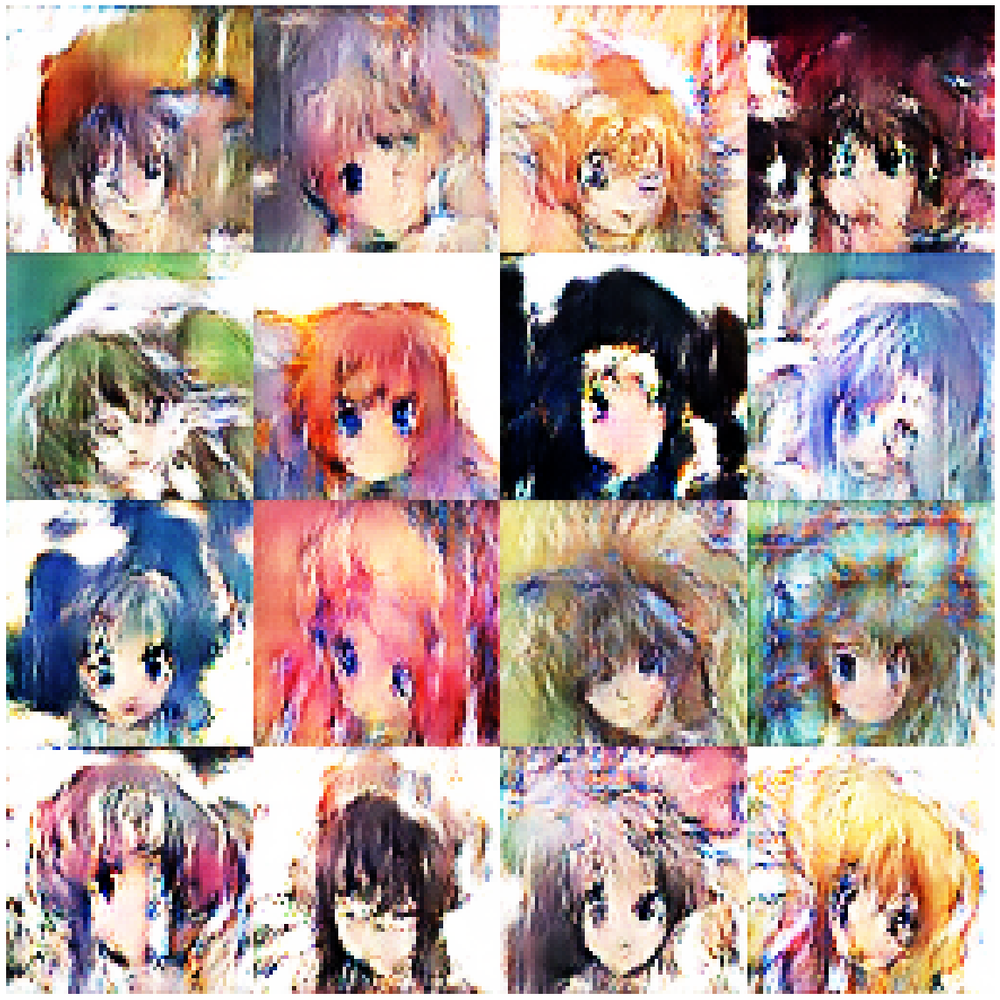

Begin step:  3500


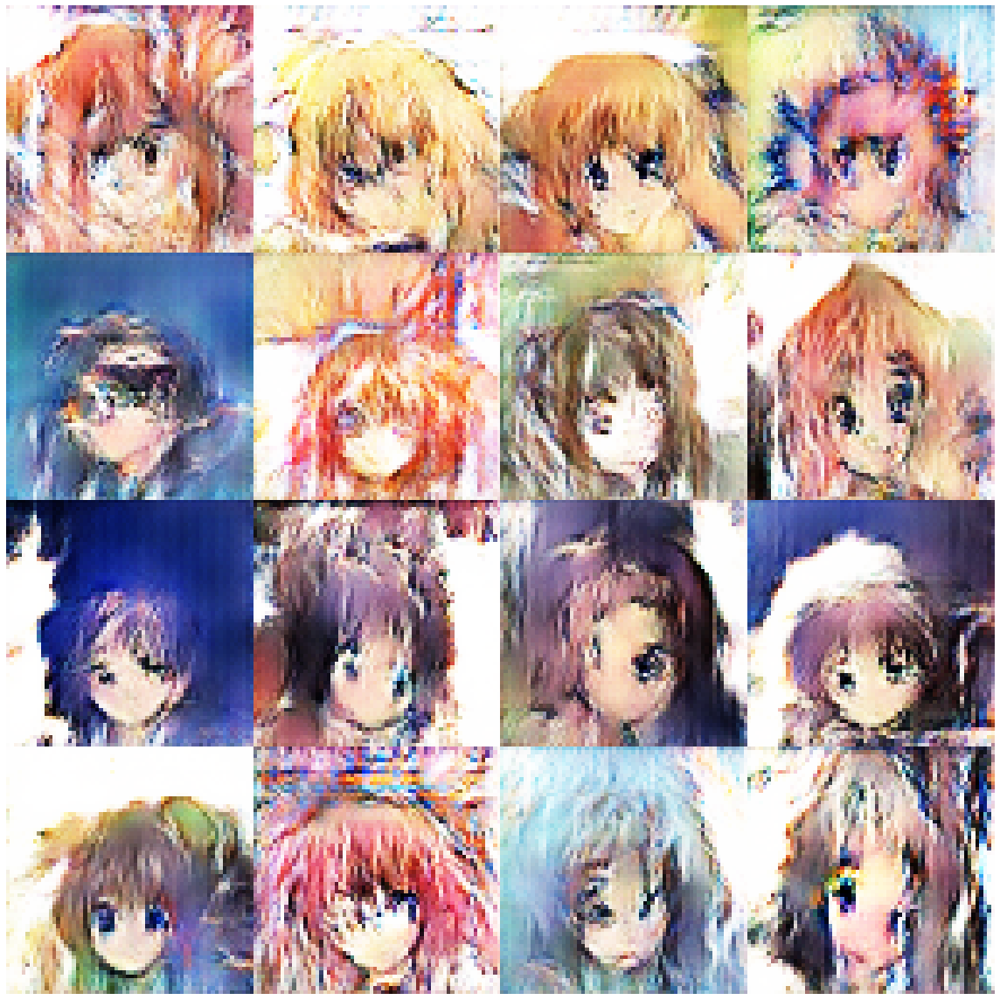

Disc: real loss: 0.636004 fake loss: 0.344215
GAN loss: 1.417549
Step 3500 completed. Time took: 1 secs.
Begin step:  3501
Disc: real loss: 0.511223 fake loss: 0.435016
GAN loss: 3.470541
Step 3501 completed. Time took: 0 secs.
Begin step:  3502
Disc: real loss: 0.364511 fake loss: 0.371196
GAN loss: 2.390399
Step 3502 completed. Time took: 0 secs.
Begin step:  3503
Disc: real loss: 0.332955 fake loss: 0.375195
GAN loss: 2.834999
Step 3503 completed. Time took: 0 secs.
Begin step:  3504
Disc: real loss: 0.391004 fake loss: 0.365679
GAN loss: 2.691618
Step 3504 completed. Time took: 0 secs.
Begin step:  3505
Disc: real loss: 0.383244 fake loss: 0.352279
GAN loss: 2.442200
Step 3505 completed. Time took: 0 secs.
Begin step:  3506
Disc: real loss: 0.342683 fake loss: 0.363917
GAN loss: 2.722406
Step 3506 completed. Time took: 0 secs.
Begin step:  3507
Disc: real loss: 0.380256 fake loss: 0.363633
GAN loss: 2.644927
Step 3507 completed. Time took: 0 secs.
Begin step:  3508
Disc: real loss:

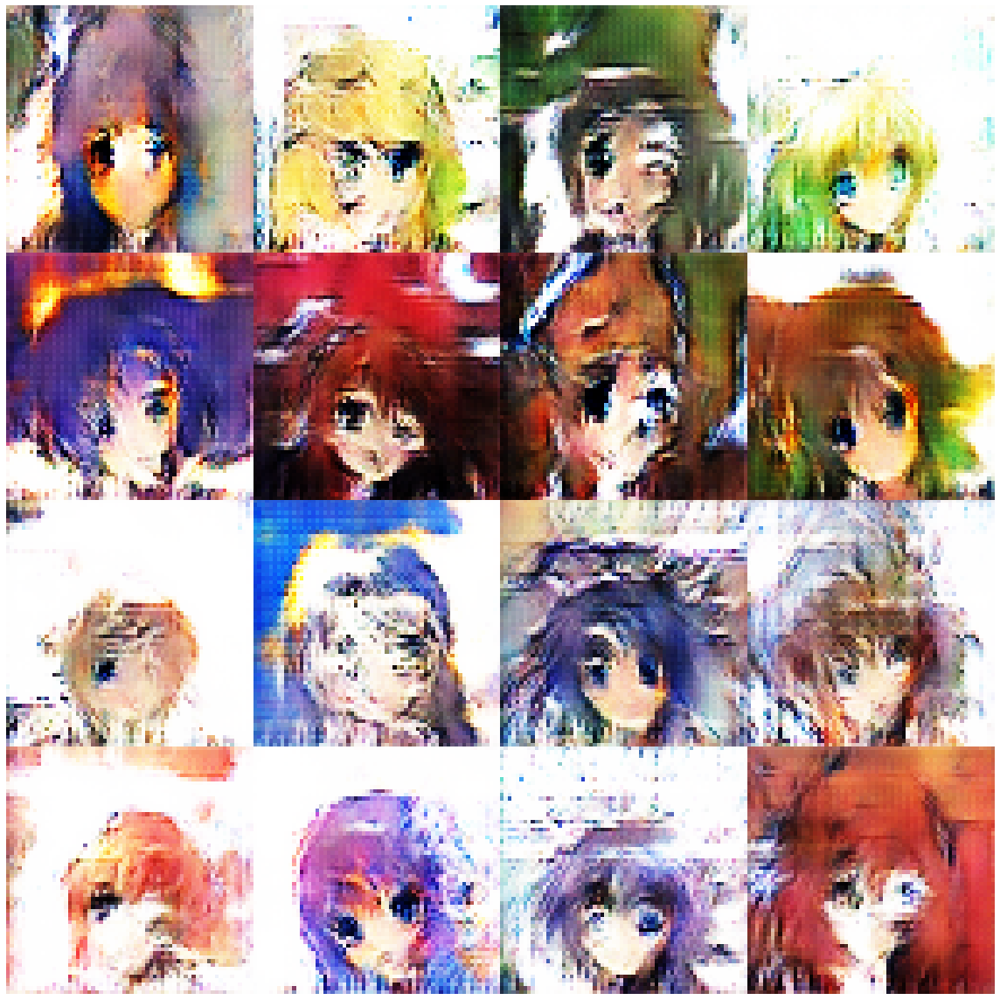

Disc: real loss: 0.466573 fake loss: 0.370058
GAN loss: 2.117968
Step 3600 completed. Time took: 1 secs.
Begin step:  3601
Disc: real loss: 0.352075 fake loss: 0.336389
GAN loss: 2.041946
Step 3601 completed. Time took: 0 secs.
Begin step:  3602
Disc: real loss: 0.362812 fake loss: 0.432114
GAN loss: 2.634479
Step 3602 completed. Time took: 0 secs.
Begin step:  3603
Disc: real loss: 0.385751 fake loss: 0.356518
GAN loss: 2.054999
Step 3603 completed. Time took: 0 secs.
Begin step:  3604
Disc: real loss: 0.355593 fake loss: 0.399094
GAN loss: 2.966520
Step 3604 completed. Time took: 0 secs.
Begin step:  3605
Disc: real loss: 0.412825 fake loss: 0.335288
GAN loss: 2.015287
Step 3605 completed. Time took: 0 secs.
Begin step:  3606
Disc: real loss: 0.367298 fake loss: 0.437415
GAN loss: 3.257416
Step 3606 completed. Time took: 0 secs.
Begin step:  3607
Disc: real loss: 0.456671 fake loss: 0.351594
GAN loss: 1.755211
Step 3607 completed. Time took: 0 secs.
Begin step:  3608
Disc: real loss:

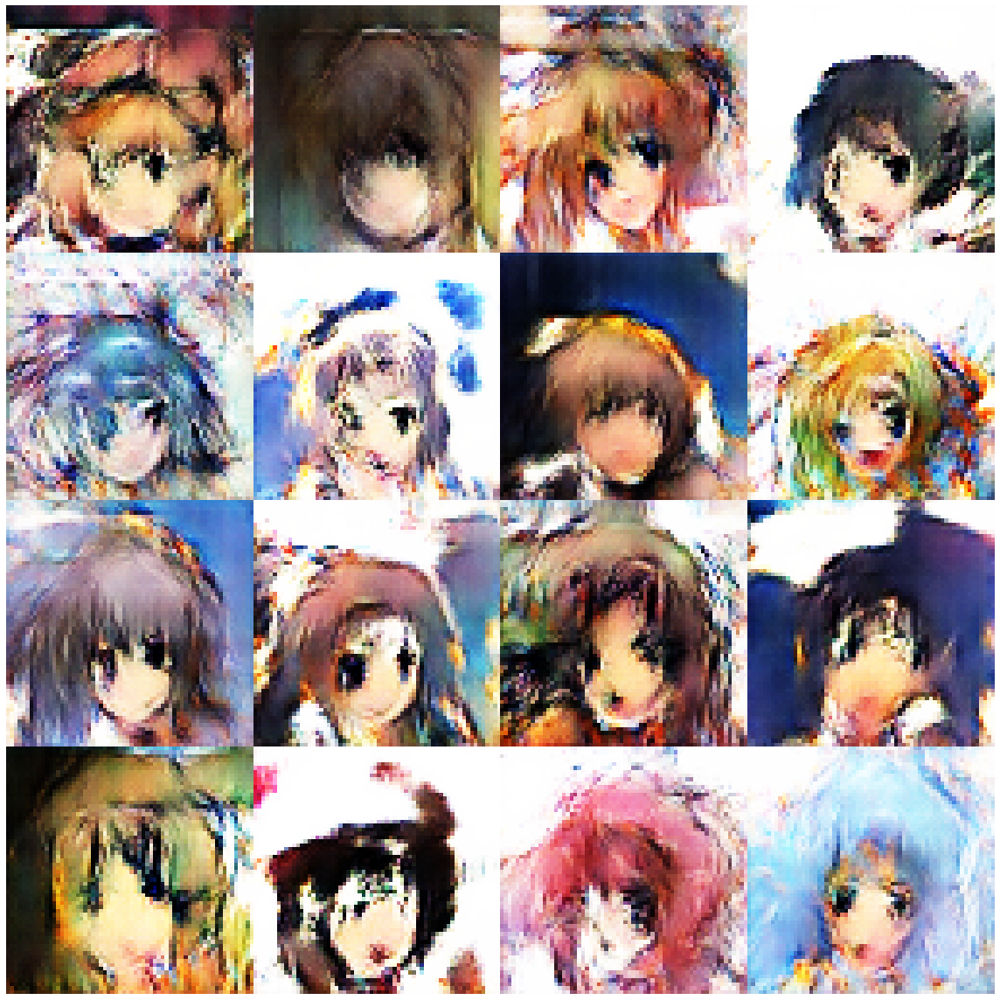

Disc: real loss: 0.333946 fake loss: 0.386980
GAN loss: 2.911288
Step 3700 completed. Time took: 1 secs.
Begin step:  3701
Disc: real loss: 0.458659 fake loss: 0.414354
GAN loss: 2.463952
Step 3701 completed. Time took: 0 secs.
Begin step:  3702
Disc: real loss: 0.347477 fake loss: 0.352931
GAN loss: 2.366309
Step 3702 completed. Time took: 0 secs.
Begin step:  3703
Disc: real loss: 0.345762 fake loss: 0.381952
GAN loss: 2.425410
Step 3703 completed. Time took: 0 secs.
Begin step:  3704
Disc: real loss: 0.338160 fake loss: 0.341564
GAN loss: 2.194294
Step 3704 completed. Time took: 0 secs.
Begin step:  3705
Disc: real loss: 0.348818 fake loss: 0.355386
GAN loss: 2.260406
Step 3705 completed. Time took: 0 secs.
Begin step:  3706
Disc: real loss: 0.395244 fake loss: 0.369998
GAN loss: 2.646073
Step 3706 completed. Time took: 0 secs.
Begin step:  3707
Disc: real loss: 0.346026 fake loss: 0.335232
GAN loss: 2.131270
Step 3707 completed. Time took: 0 secs.
Begin step:  3708
Disc: real loss:

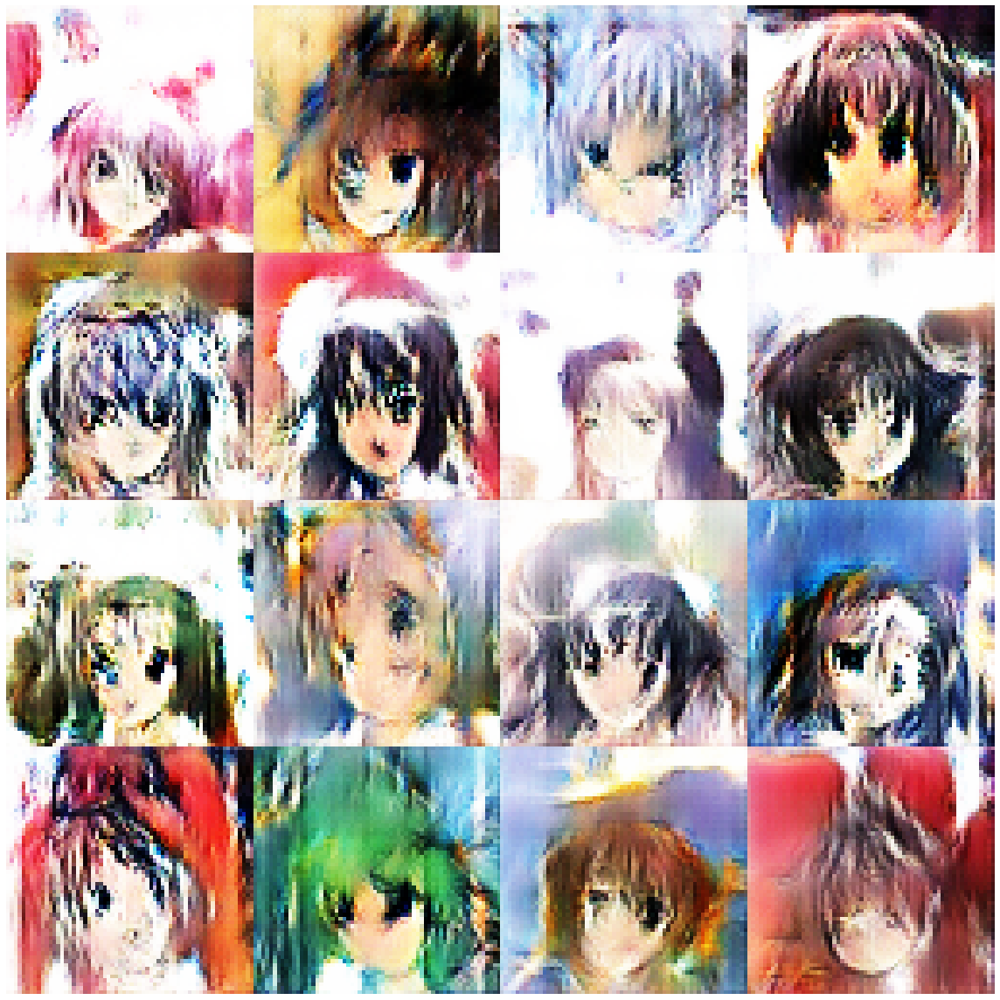

Disc: real loss: 0.398712 fake loss: 0.357567
GAN loss: 1.775986
Step 3800 completed. Time took: 1 secs.
Begin step:  3801
Disc: real loss: 0.379091 fake loss: 0.386307
GAN loss: 2.003058
Step 3801 completed. Time took: 0 secs.
Begin step:  3802
Disc: real loss: 0.429852 fake loss: 0.485201
GAN loss: 2.765731
Step 3802 completed. Time took: 0 secs.
Begin step:  3803
Disc: real loss: 0.476840 fake loss: 0.347508
GAN loss: 1.921800
Step 3803 completed. Time took: 0 secs.
Begin step:  3804
Disc: real loss: 0.383801 fake loss: 0.521867
GAN loss: 3.117695
Step 3804 completed. Time took: 0 secs.
Begin step:  3805
Disc: real loss: 0.606820 fake loss: 0.421944
GAN loss: 1.775139
Step 3805 completed. Time took: 0 secs.
Begin step:  3806
Disc: real loss: 0.348043 fake loss: 0.345420
GAN loss: 1.762434
Step 3806 completed. Time took: 0 secs.
Begin step:  3807
Disc: real loss: 0.353544 fake loss: 0.525255
GAN loss: 3.854894
Step 3807 completed. Time took: 0 secs.
Begin step:  3808
Disc: real loss:

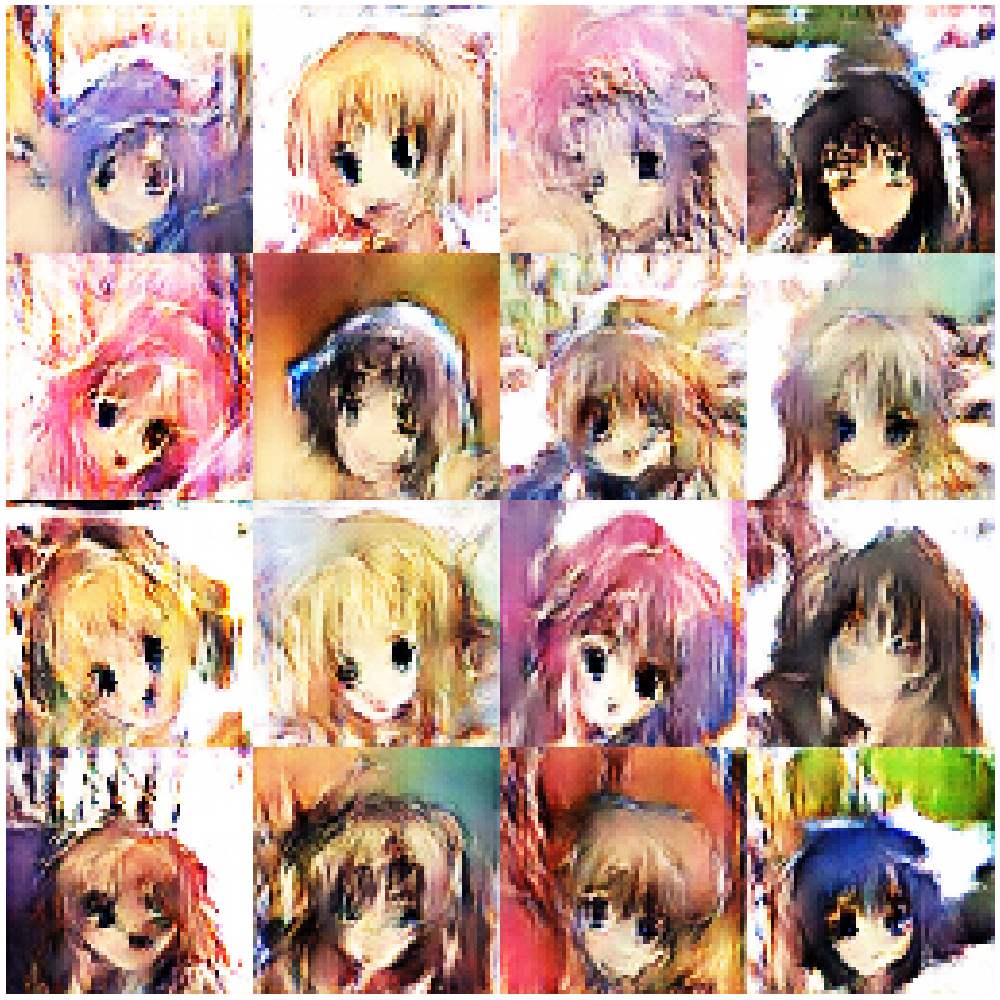

Disc: real loss: 0.339803 fake loss: 0.343134
GAN loss: 2.051292
Step 3900 completed. Time took: 1 secs.
Begin step:  3901
Disc: real loss: 0.371527 fake loss: 0.410617
GAN loss: 2.349765
Step 3901 completed. Time took: 0 secs.
Begin step:  3902
Disc: real loss: 0.386198 fake loss: 0.356697
GAN loss: 2.317230
Step 3902 completed. Time took: 0 secs.
Begin step:  3903
Disc: real loss: 0.356692 fake loss: 0.377374
GAN loss: 2.486364
Step 3903 completed. Time took: 0 secs.
Begin step:  3904
Disc: real loss: 0.342256 fake loss: 0.353324
GAN loss: 2.855194
Step 3904 completed. Time took: 0 secs.
Begin step:  3905
Disc: real loss: 0.363152 fake loss: 0.359057
GAN loss: 1.927101
Step 3905 completed. Time took: 0 secs.
Begin step:  3906
Disc: real loss: 0.333546 fake loss: 0.398371
GAN loss: 2.893941
Step 3906 completed. Time took: 0 secs.
Begin step:  3907
Disc: real loss: 0.389329 fake loss: 0.335112
GAN loss: 1.952790
Step 3907 completed. Time took: 0 secs.
Begin step:  3908
Disc: real loss:

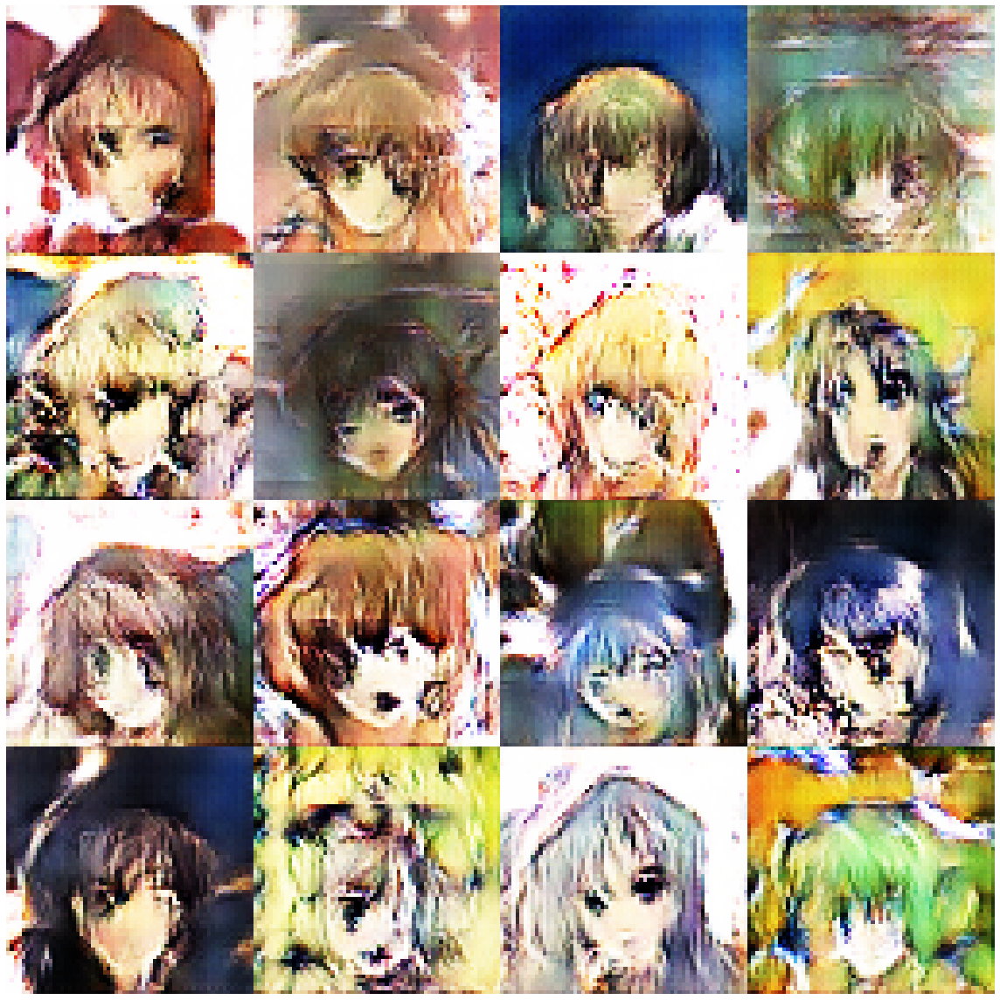

Begin step:  4000


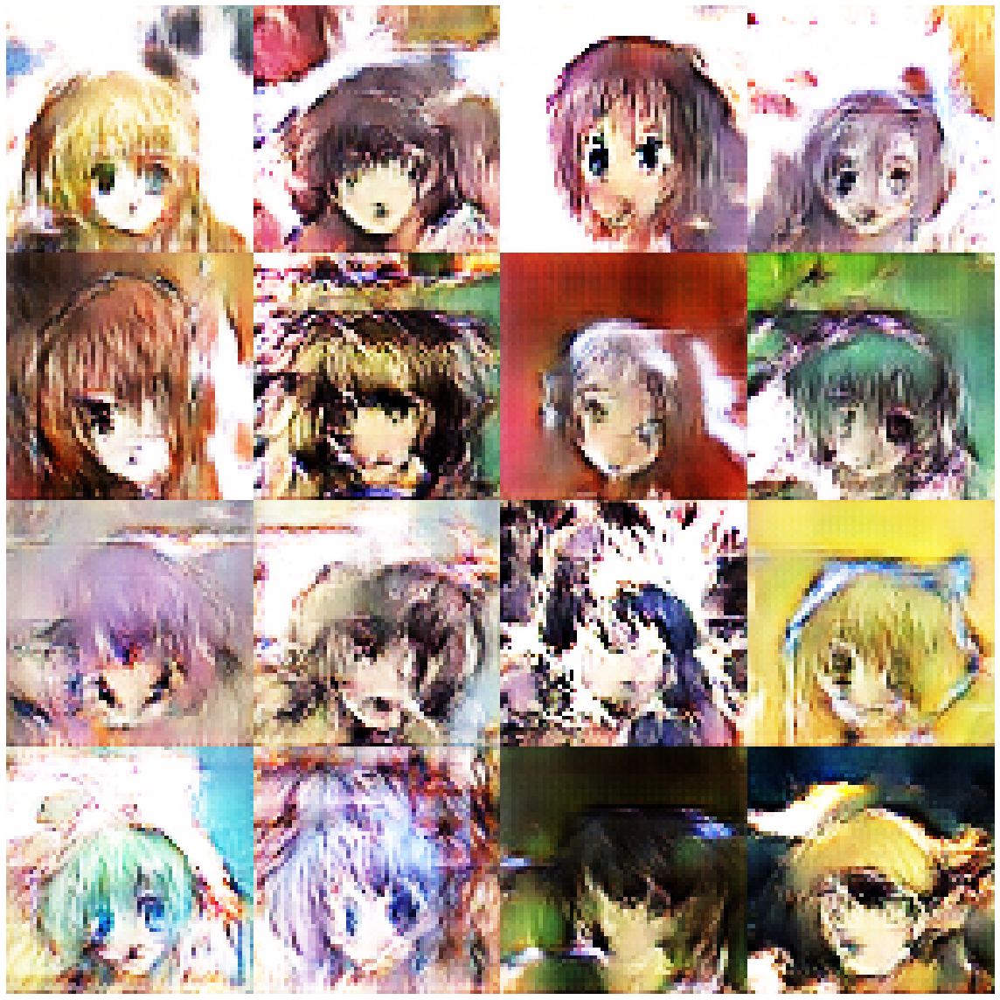

Disc: real loss: 0.392364 fake loss: 0.358283
GAN loss: 1.911768
Step 4000 completed. Time took: 1 secs.
Begin step:  4001
Disc: real loss: 0.339590 fake loss: 0.405275
GAN loss: 2.771107
Step 4001 completed. Time took: 0 secs.
Begin step:  4002
Disc: real loss: 0.501701 fake loss: 0.390401
GAN loss: 2.191912
Step 4002 completed. Time took: 0 secs.
Begin step:  4003
Disc: real loss: 0.345006 fake loss: 0.417066
GAN loss: 2.732412
Step 4003 completed. Time took: 0 secs.
Begin step:  4004
Disc: real loss: 0.364719 fake loss: 0.352573
GAN loss: 2.027679
Step 4004 completed. Time took: 0 secs.
Begin step:  4005
Disc: real loss: 0.343647 fake loss: 0.409098
GAN loss: 3.005210
Step 4005 completed. Time took: 0 secs.
Begin step:  4006
Disc: real loss: 0.406033 fake loss: 0.360156
GAN loss: 1.844041
Step 4006 completed. Time took: 0 secs.
Begin step:  4007
Disc: real loss: 0.371778 fake loss: 0.735392
GAN loss: 5.490467
Step 4007 completed. Time took: 0 secs.
Begin step:  4008
Disc: real loss:

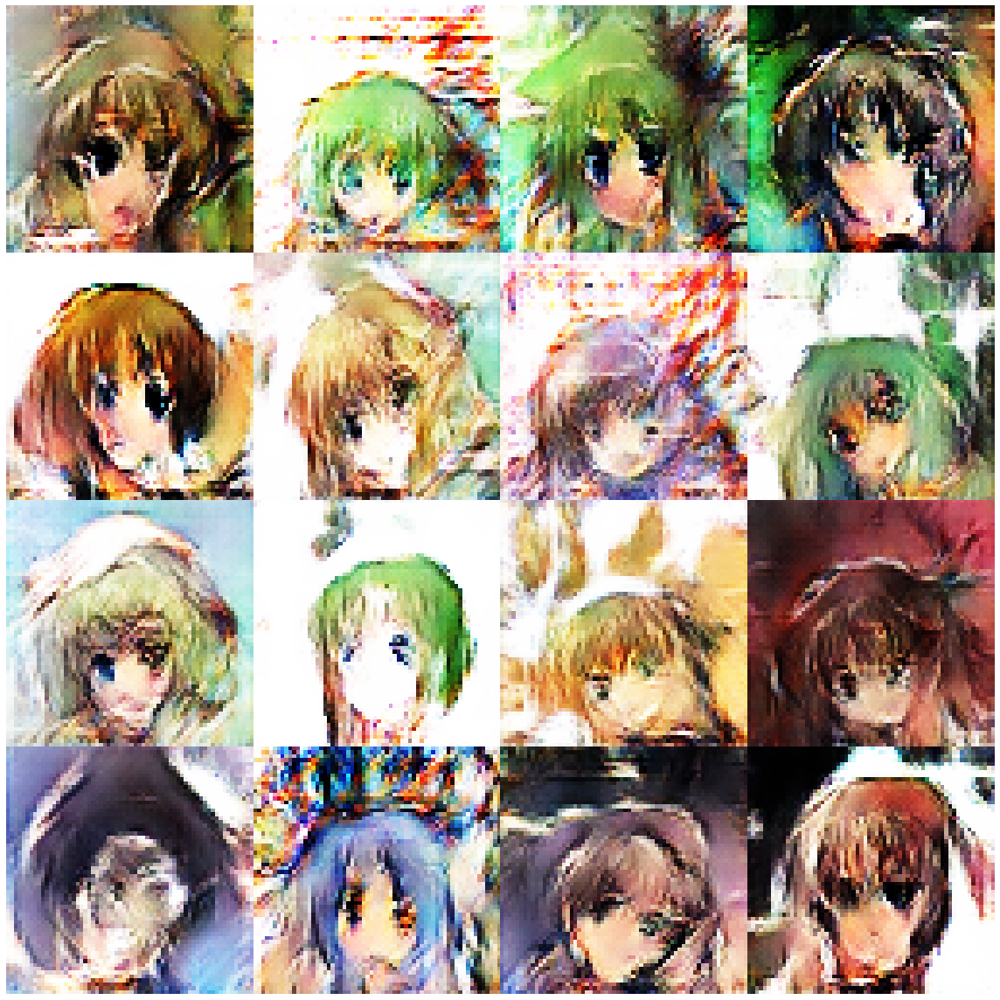

Disc: real loss: 0.368892 fake loss: 0.386456
GAN loss: 2.575619
Step 4100 completed. Time took: 1 secs.
Begin step:  4101
Disc: real loss: 0.343408 fake loss: 0.353482
GAN loss: 2.192425
Step 4101 completed. Time took: 0 secs.
Begin step:  4102
Disc: real loss: 0.347898 fake loss: 0.450091
GAN loss: 3.461147
Step 4102 completed. Time took: 0 secs.
Begin step:  4103
Disc: real loss: 0.503545 fake loss: 0.358496
GAN loss: 1.328797
Step 4103 completed. Time took: 0 secs.
Begin step:  4104
Disc: real loss: 0.419289 fake loss: 0.481062
GAN loss: 3.628922
Step 4104 completed. Time took: 0 secs.
Begin step:  4105
Disc: real loss: 0.467996 fake loss: 0.389602
GAN loss: 1.782500
Step 4105 completed. Time took: 0 secs.
Begin step:  4106
Disc: real loss: 0.365443 fake loss: 0.474710
GAN loss: 3.663803
Step 4106 completed. Time took: 0 secs.
Begin step:  4107
Disc: real loss: 0.410035 fake loss: 0.402728
GAN loss: 2.347132
Step 4107 completed. Time took: 0 secs.
Begin step:  4108
Disc: real loss:

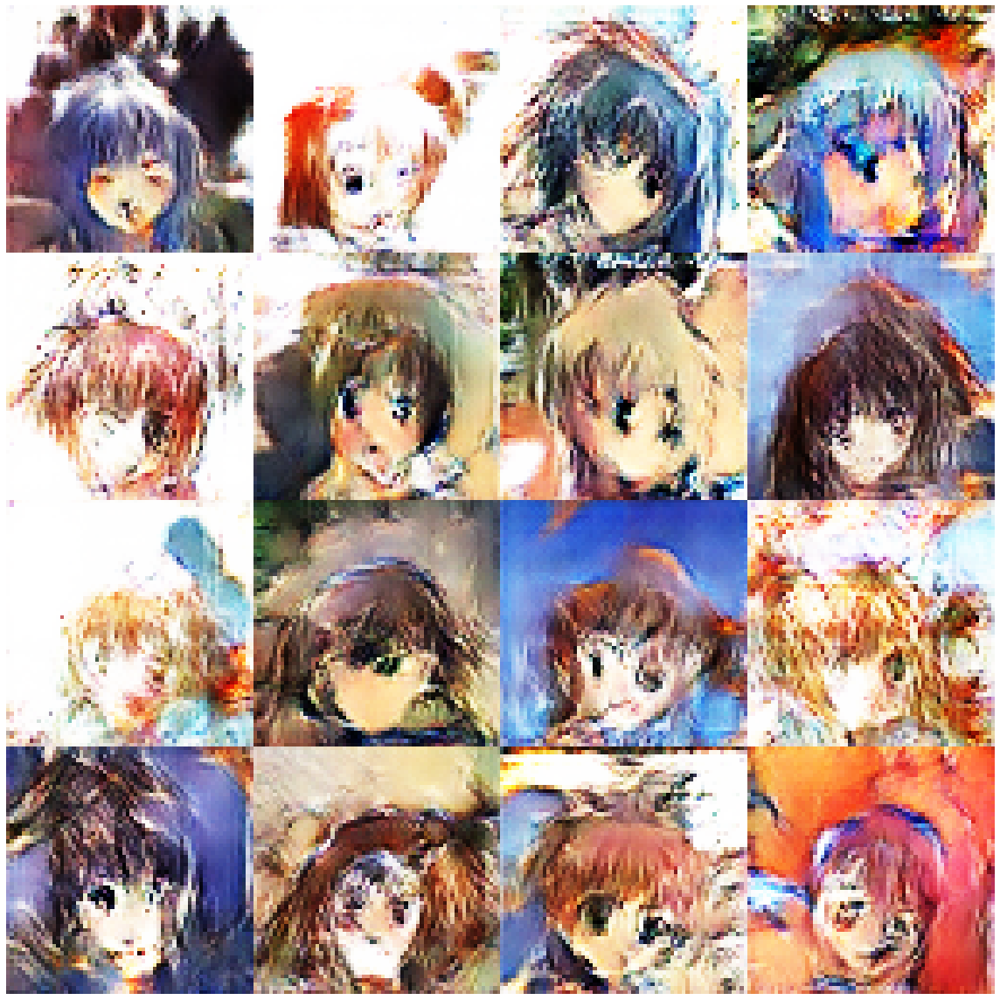

Disc: real loss: 0.376318 fake loss: 0.377563
GAN loss: 2.616413
Step 4200 completed. Time took: 1 secs.
Begin step:  4201
Disc: real loss: 0.372858 fake loss: 0.355519
GAN loss: 2.113910
Step 4201 completed. Time took: 0 secs.
Begin step:  4202
Disc: real loss: 0.348101 fake loss: 0.386003
GAN loss: 2.660355
Step 4202 completed. Time took: 0 secs.
Begin step:  4203
Disc: real loss: 0.390276 fake loss: 0.364371
GAN loss: 1.751660
Step 4203 completed. Time took: 0 secs.
Begin step:  4204
Disc: real loss: 0.354400 fake loss: 0.404680
GAN loss: 2.812175
Step 4204 completed. Time took: 0 secs.
Begin step:  4205
Disc: real loss: 0.432066 fake loss: 0.375517
GAN loss: 2.158825
Step 4205 completed. Time took: 0 secs.
Begin step:  4206
Disc: real loss: 0.340747 fake loss: 0.344251
GAN loss: 2.710325
Step 4206 completed. Time took: 0 secs.
Begin step:  4207
Disc: real loss: 0.379128 fake loss: 0.393313
GAN loss: 2.555812
Step 4207 completed. Time took: 0 secs.
Begin step:  4208
Disc: real loss:

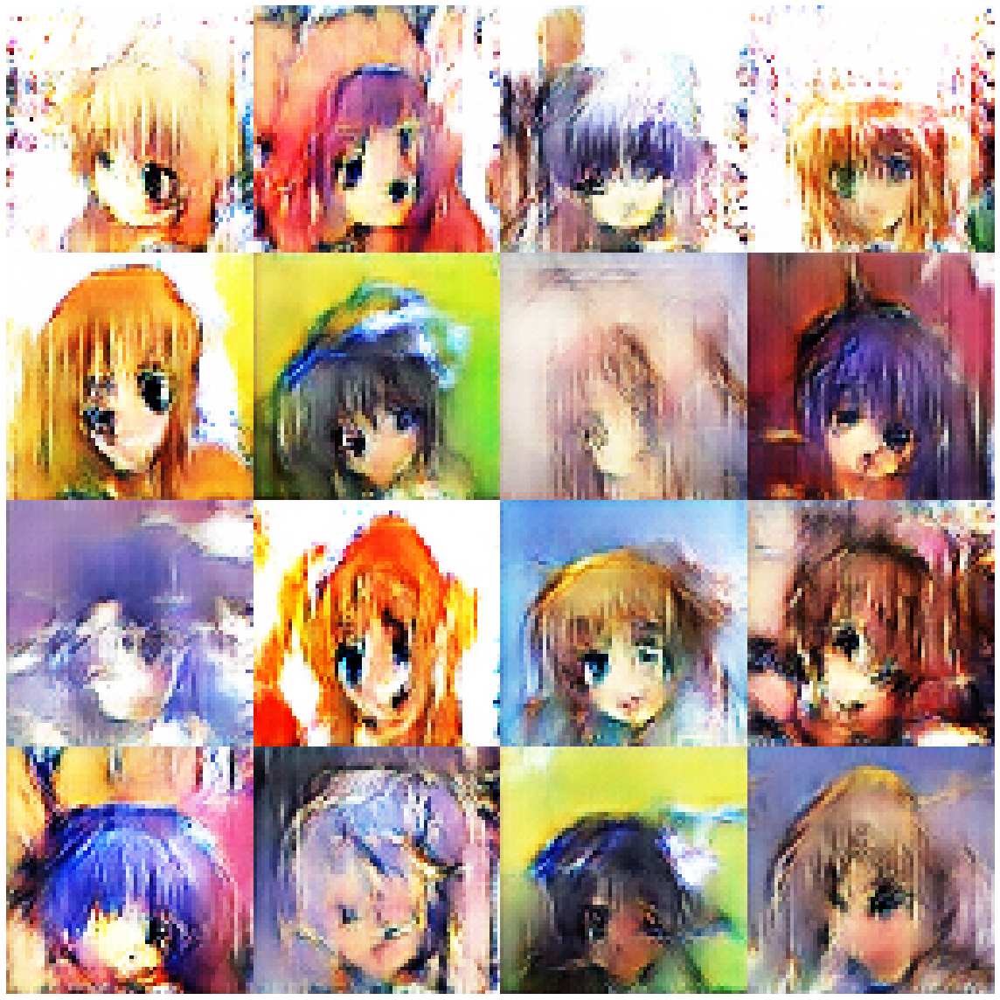

Disc: real loss: 0.641276 fake loss: 0.406775
GAN loss: 2.068500
Step 4300 completed. Time took: 1 secs.
Begin step:  4301
Disc: real loss: 0.350263 fake loss: 0.423976
GAN loss: 2.869059
Step 4301 completed. Time took: 0 secs.
Begin step:  4302
Disc: real loss: 0.389661 fake loss: 0.340230
GAN loss: 2.132426
Step 4302 completed. Time took: 0 secs.
Begin step:  4303
Disc: real loss: 0.358466 fake loss: 0.430234
GAN loss: 2.518696
Step 4303 completed. Time took: 0 secs.
Begin step:  4304
Disc: real loss: 0.445824 fake loss: 0.423196
GAN loss: 2.504050
Step 4304 completed. Time took: 0 secs.
Begin step:  4305
Disc: real loss: 0.418006 fake loss: 0.425169
GAN loss: 2.815067
Step 4305 completed. Time took: 0 secs.
Begin step:  4306
Disc: real loss: 0.511776 fake loss: 0.448395
GAN loss: 2.734142
Step 4306 completed. Time took: 0 secs.
Begin step:  4307
Disc: real loss: 0.352435 fake loss: 0.365259
GAN loss: 2.091425
Step 4307 completed. Time took: 0 secs.
Begin step:  4308
Disc: real loss:

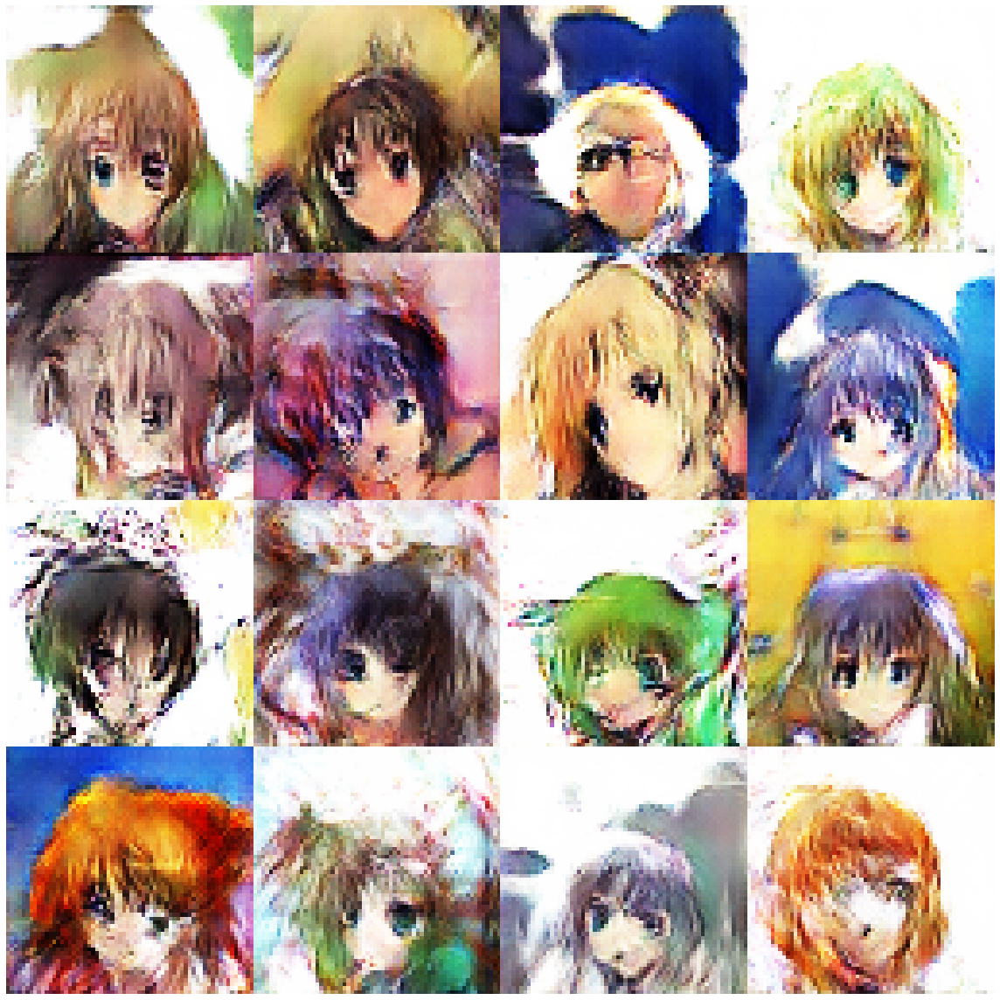

Disc: real loss: 0.360224 fake loss: 0.499805
GAN loss: 3.943532
Step 4400 completed. Time took: 1 secs.
Begin step:  4401
Disc: real loss: 0.489820 fake loss: 0.369194
GAN loss: 1.387830
Step 4401 completed. Time took: 0 secs.
Begin step:  4402
Disc: real loss: 0.402412 fake loss: 0.419505
GAN loss: 3.399320
Step 4402 completed. Time took: 0 secs.
Begin step:  4403
Disc: real loss: 0.439473 fake loss: 0.366775
GAN loss: 1.857500
Step 4403 completed. Time took: 0 secs.
Begin step:  4404
Disc: real loss: 0.330654 fake loss: 0.366564
GAN loss: 3.078947
Step 4404 completed. Time took: 0 secs.
Begin step:  4405
Disc: real loss: 0.381999 fake loss: 0.344597
GAN loss: 1.795722
Step 4405 completed. Time took: 0 secs.
Begin step:  4406
Disc: real loss: 0.352962 fake loss: 0.394777
GAN loss: 3.047361
Step 4406 completed. Time took: 0 secs.
Begin step:  4407
Disc: real loss: 0.424516 fake loss: 0.351171
GAN loss: 1.829965
Step 4407 completed. Time took: 0 secs.
Begin step:  4408
Disc: real loss:

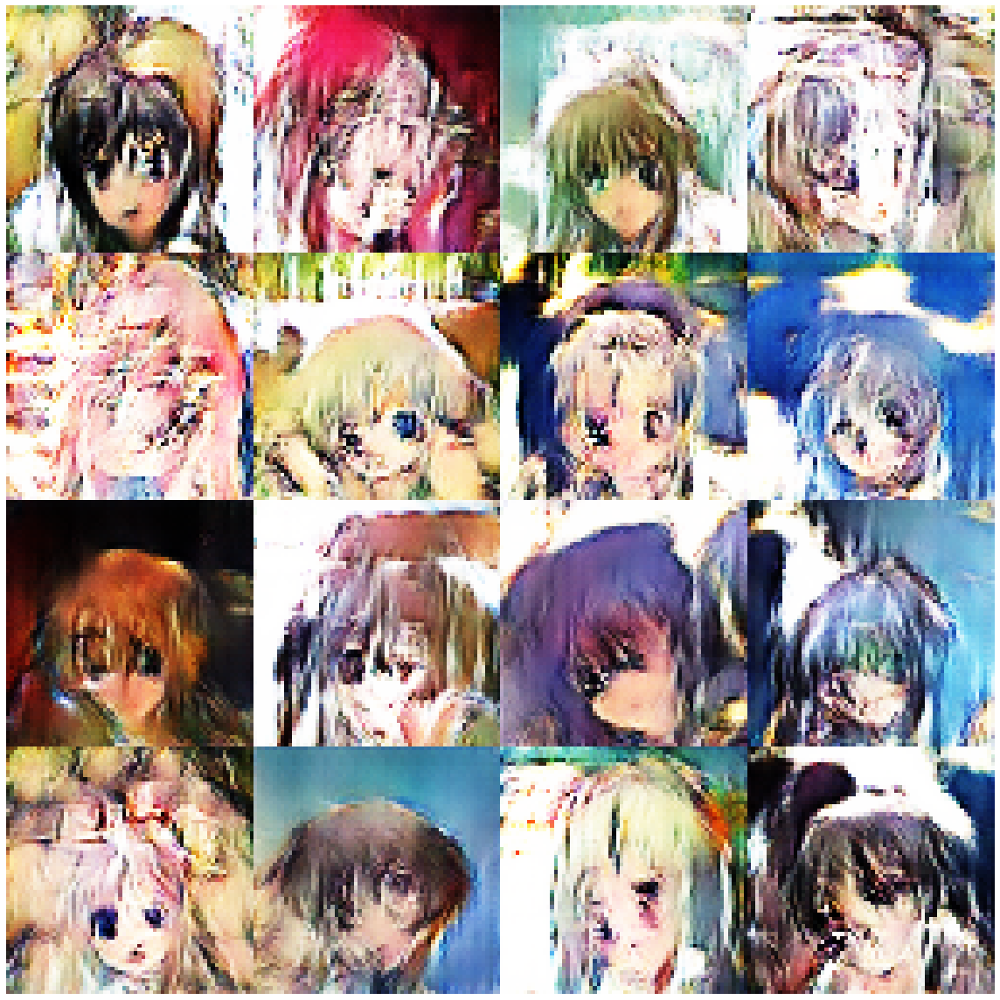

Begin step:  4500


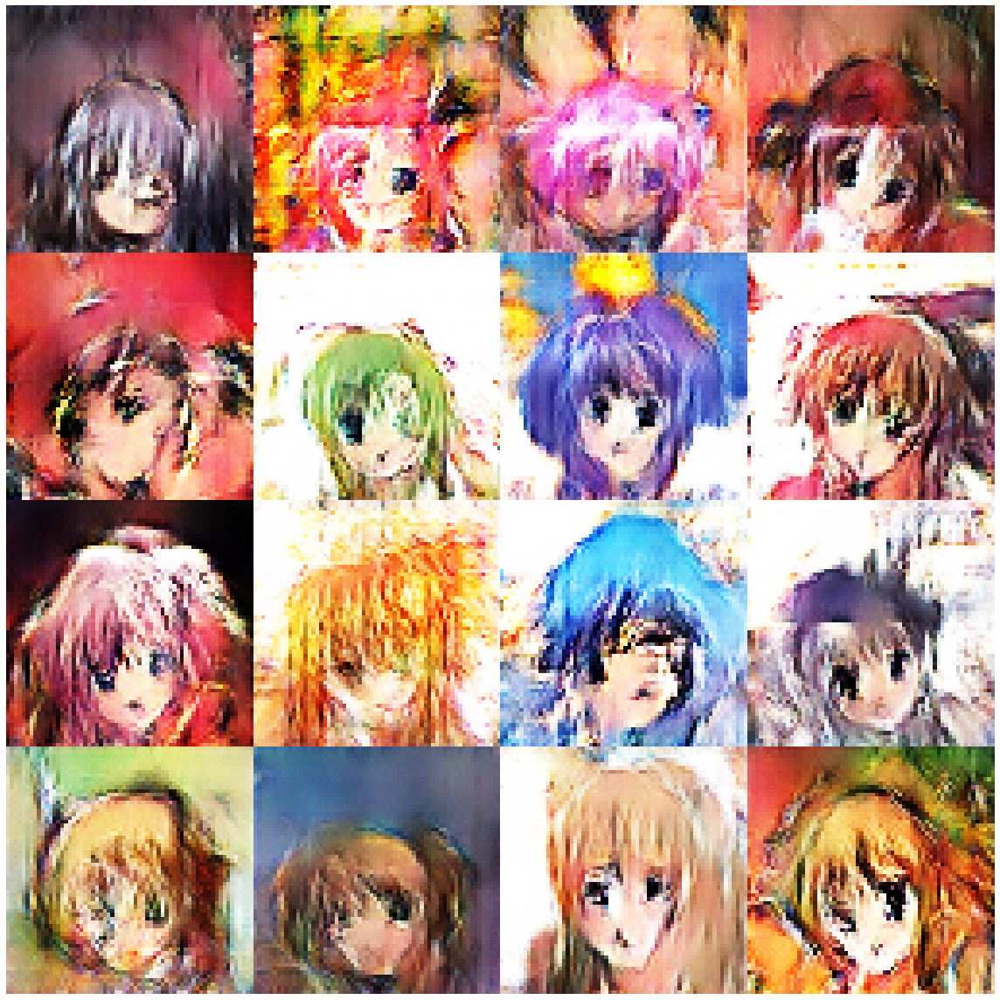

Disc: real loss: 0.340018 fake loss: 0.347159
GAN loss: 2.156618
Step 4500 completed. Time took: 1 secs.
Begin step:  4501
Disc: real loss: 0.342340 fake loss: 0.361934
GAN loss: 2.701657
Step 4501 completed. Time took: 0 secs.
Begin step:  4502
Disc: real loss: 0.369468 fake loss: 0.340614
GAN loss: 2.113741
Step 4502 completed. Time took: 0 secs.
Begin step:  4503
Disc: real loss: 0.342218 fake loss: 0.380982
GAN loss: 3.279306
Step 4503 completed. Time took: 0 secs.
Begin step:  4504
Disc: real loss: 0.408643 fake loss: 0.357493
GAN loss: 2.147264
Step 4504 completed. Time took: 0 secs.
Begin step:  4505
Disc: real loss: 0.370168 fake loss: 0.334600
GAN loss: 2.311336
Step 4505 completed. Time took: 0 secs.
Begin step:  4506
Disc: real loss: 0.367054 fake loss: 0.392107
GAN loss: 2.861087
Step 4506 completed. Time took: 0 secs.
Begin step:  4507
Disc: real loss: 0.450860 fake loss: 0.459587
GAN loss: 3.056650
Step 4507 completed. Time took: 0 secs.
Begin step:  4508
Disc: real loss:

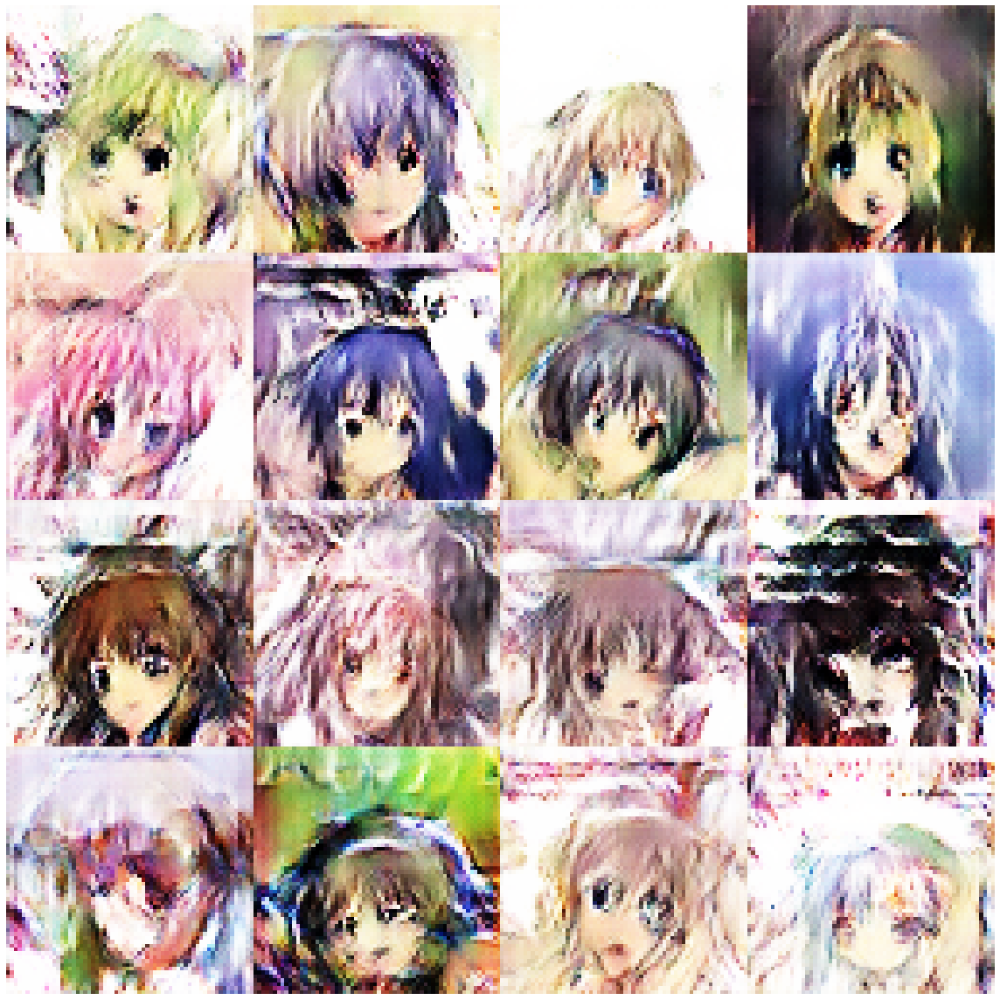

Disc: real loss: 0.442227 fake loss: 0.389233
GAN loss: 2.222240
Step 4600 completed. Time took: 1 secs.
Begin step:  4601
Disc: real loss: 0.393290 fake loss: 0.361268
GAN loss: 2.729673
Step 4601 completed. Time took: 0 secs.
Begin step:  4602
Disc: real loss: 0.401277 fake loss: 0.369937
GAN loss: 1.676494
Step 4602 completed. Time took: 0 secs.
Begin step:  4603
Disc: real loss: 0.336511 fake loss: 0.414256
GAN loss: 3.005556
Step 4603 completed. Time took: 0 secs.
Begin step:  4604
Disc: real loss: 0.415744 fake loss: 0.353192
GAN loss: 1.764531
Step 4604 completed. Time took: 0 secs.
Begin step:  4605
Disc: real loss: 0.313226 fake loss: 0.416765
GAN loss: 2.589141
Step 4605 completed. Time took: 0 secs.
Begin step:  4606
Disc: real loss: 0.390064 fake loss: 0.363738
GAN loss: 2.056526
Step 4606 completed. Time took: 0 secs.
Begin step:  4607
Disc: real loss: 0.351790 fake loss: 0.406627
GAN loss: 2.507043
Step 4607 completed. Time took: 0 secs.
Begin step:  4608
Disc: real loss:

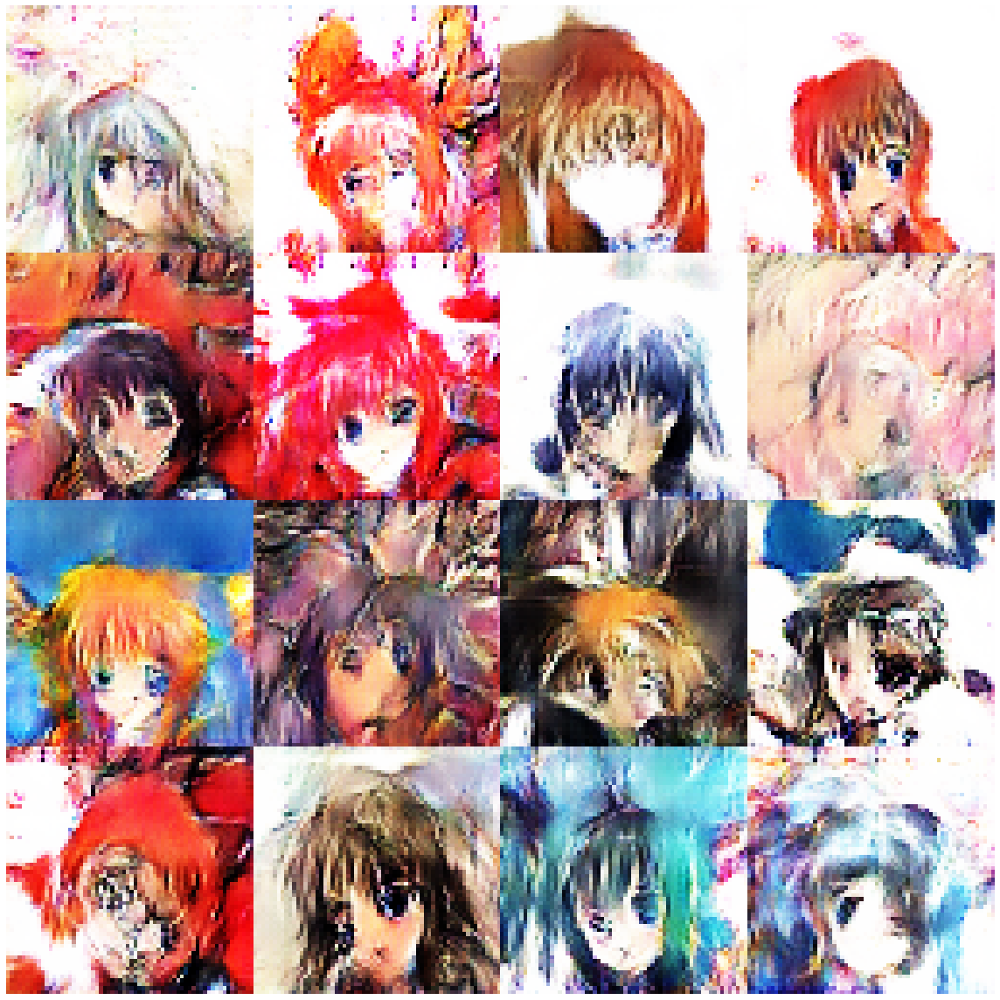

Disc: real loss: 3.950435 fake loss: 2.159994
GAN loss: 2.101450
Step 4700 completed. Time took: 1 secs.
Begin step:  4701
Disc: real loss: 0.704108 fake loss: 0.658992
GAN loss: 2.190059
Step 4701 completed. Time took: 0 secs.
Begin step:  4702
Disc: real loss: 0.728136 fake loss: 0.848709
GAN loss: 2.091354
Step 4702 completed. Time took: 0 secs.
Begin step:  4703
Disc: real loss: 0.762916 fake loss: 0.808862
GAN loss: 2.316726
Step 4703 completed. Time took: 0 secs.
Begin step:  4704
Disc: real loss: 0.944858 fake loss: 0.775813
GAN loss: 2.086014
Step 4704 completed. Time took: 0 secs.
Begin step:  4705
Disc: real loss: 0.737478 fake loss: 0.705849
GAN loss: 2.285314
Step 4705 completed. Time took: 0 secs.
Begin step:  4706
Disc: real loss: 0.740994 fake loss: 0.825363
GAN loss: 2.340779
Step 4706 completed. Time took: 0 secs.
Begin step:  4707
Disc: real loss: 0.758379 fake loss: 0.619029
GAN loss: 2.118189
Step 4707 completed. Time took: 0 secs.
Begin step:  4708
Disc: real loss:

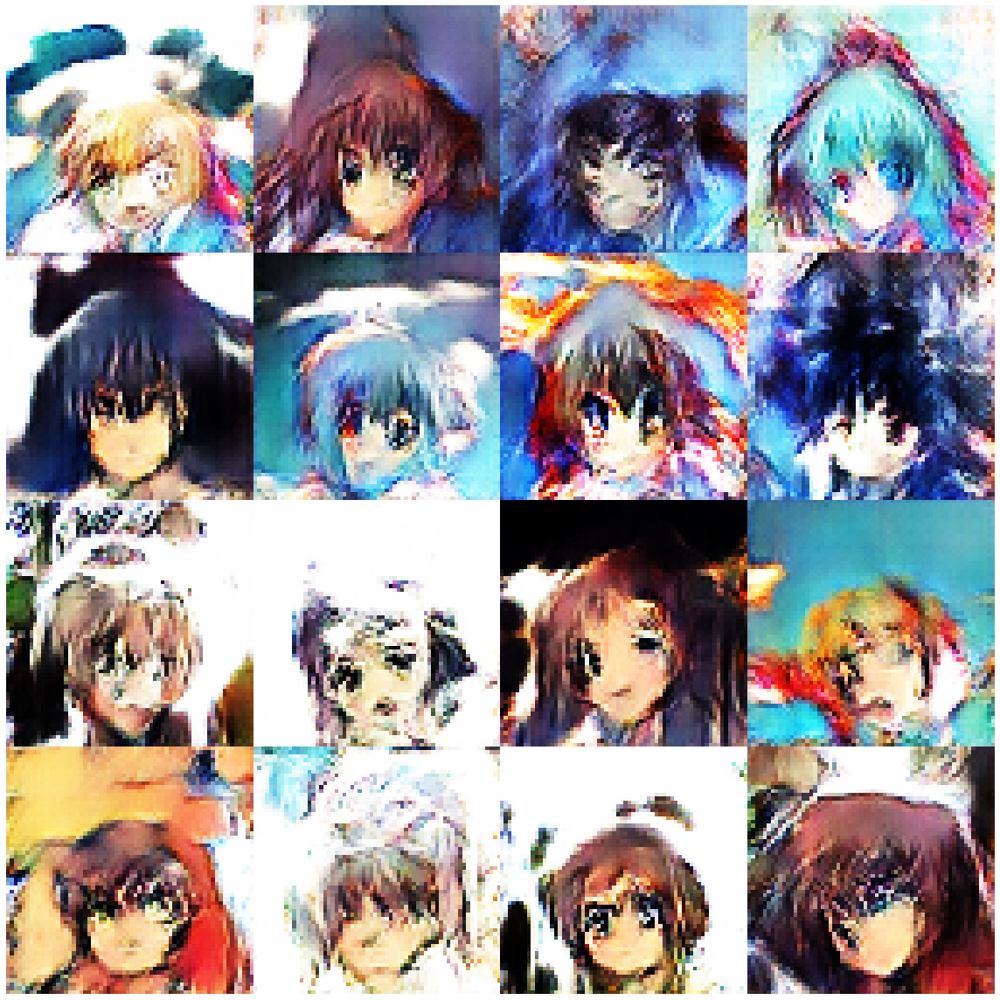

Disc: real loss: 0.431597 fake loss: 0.362705
GAN loss: 1.740784
Step 4800 completed. Time took: 1 secs.
Begin step:  4801
Disc: real loss: 0.337425 fake loss: 0.402814
GAN loss: 2.560779
Step 4801 completed. Time took: 0 secs.
Begin step:  4802
Disc: real loss: 0.423146 fake loss: 0.346699
GAN loss: 1.821228
Step 4802 completed. Time took: 0 secs.
Begin step:  4803
Disc: real loss: 0.342733 fake loss: 0.395965
GAN loss: 2.601876
Step 4803 completed. Time took: 0 secs.
Begin step:  4804
Disc: real loss: 0.407510 fake loss: 0.368457
GAN loss: 2.094409
Step 4804 completed. Time took: 0 secs.
Begin step:  4805
Disc: real loss: 0.348985 fake loss: 0.387452
GAN loss: 2.043520
Step 4805 completed. Time took: 0 secs.
Begin step:  4806
Disc: real loss: 0.353669 fake loss: 0.365315
GAN loss: 2.164678
Step 4806 completed. Time took: 0 secs.
Begin step:  4807
Disc: real loss: 0.380683 fake loss: 0.359445
GAN loss: 2.137712
Step 4807 completed. Time took: 0 secs.
Begin step:  4808
Disc: real loss:

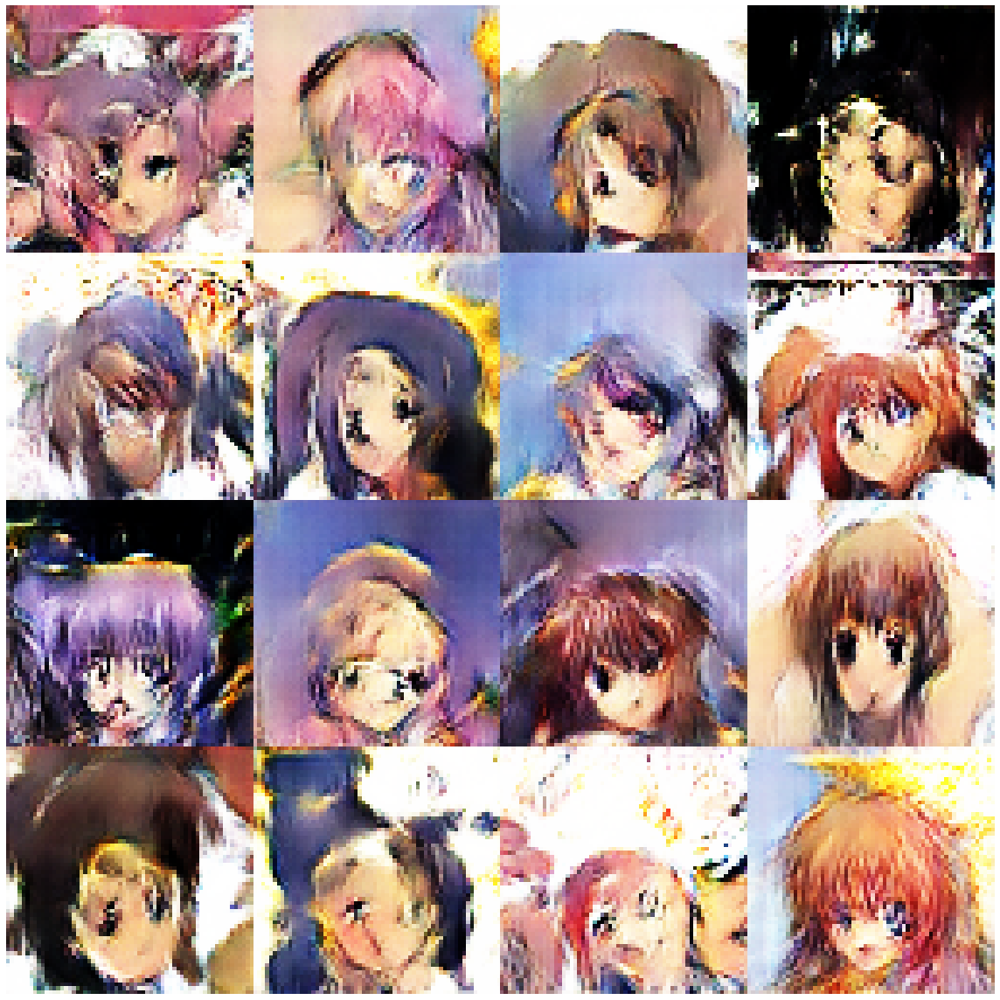

Disc: real loss: 0.380441 fake loss: 0.350248
GAN loss: 2.401083
Step 4900 completed. Time took: 1 secs.
Begin step:  4901
Disc: real loss: 0.342090 fake loss: 0.328502
GAN loss: 2.457905
Step 4901 completed. Time took: 0 secs.
Begin step:  4902
Disc: real loss: 0.369599 fake loss: 0.359007
GAN loss: 2.242450
Step 4902 completed. Time took: 0 secs.
Begin step:  4903
Disc: real loss: 0.358526 fake loss: 0.418370
GAN loss: 2.694076
Step 4903 completed. Time took: 0 secs.
Begin step:  4904
Disc: real loss: 0.384412 fake loss: 0.347524
GAN loss: 1.965882
Step 4904 completed. Time took: 0 secs.
Begin step:  4905
Disc: real loss: 0.329958 fake loss: 0.402016
GAN loss: 2.994224
Step 4905 completed. Time took: 0 secs.
Begin step:  4906
Disc: real loss: 0.381634 fake loss: 0.345064
GAN loss: 2.005391
Step 4906 completed. Time took: 0 secs.
Begin step:  4907
Disc: real loss: 0.359546 fake loss: 0.361457
GAN loss: 2.364870
Step 4907 completed. Time took: 0 secs.
Begin step:  4908
Disc: real loss:

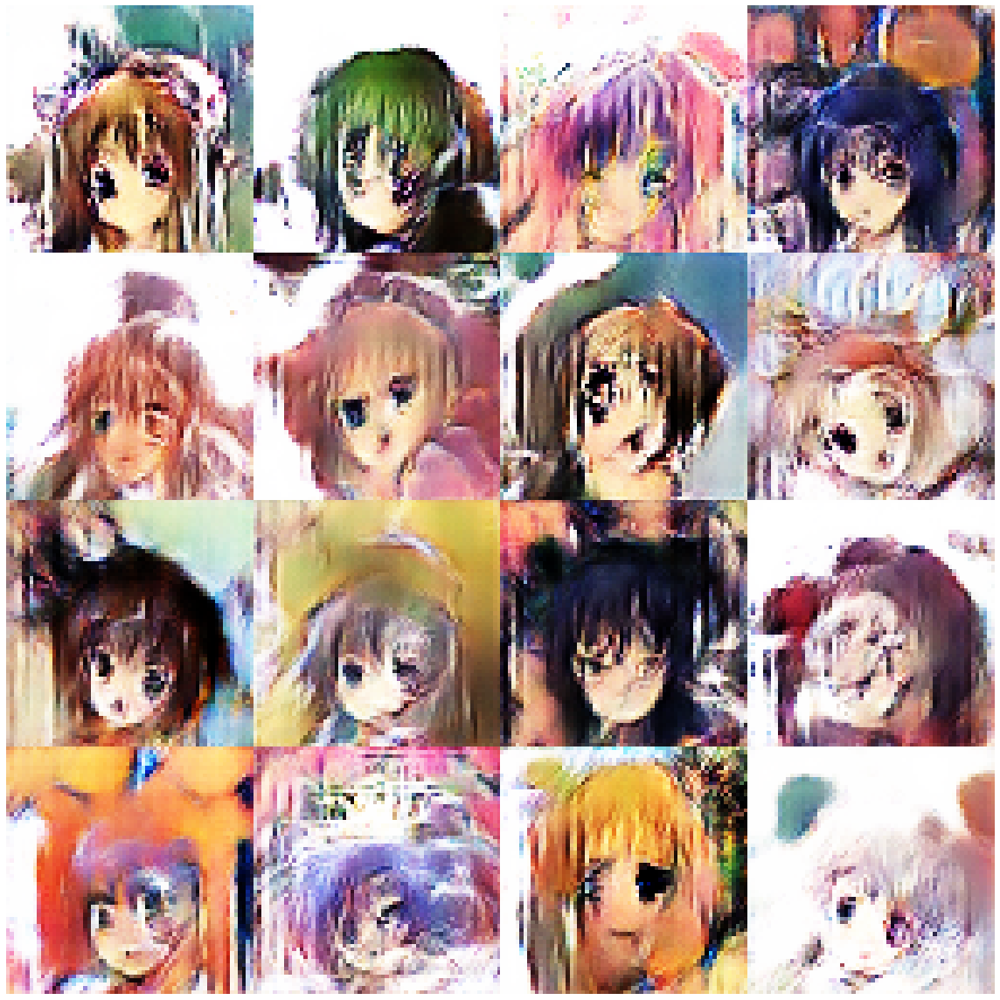

Begin step:  5000


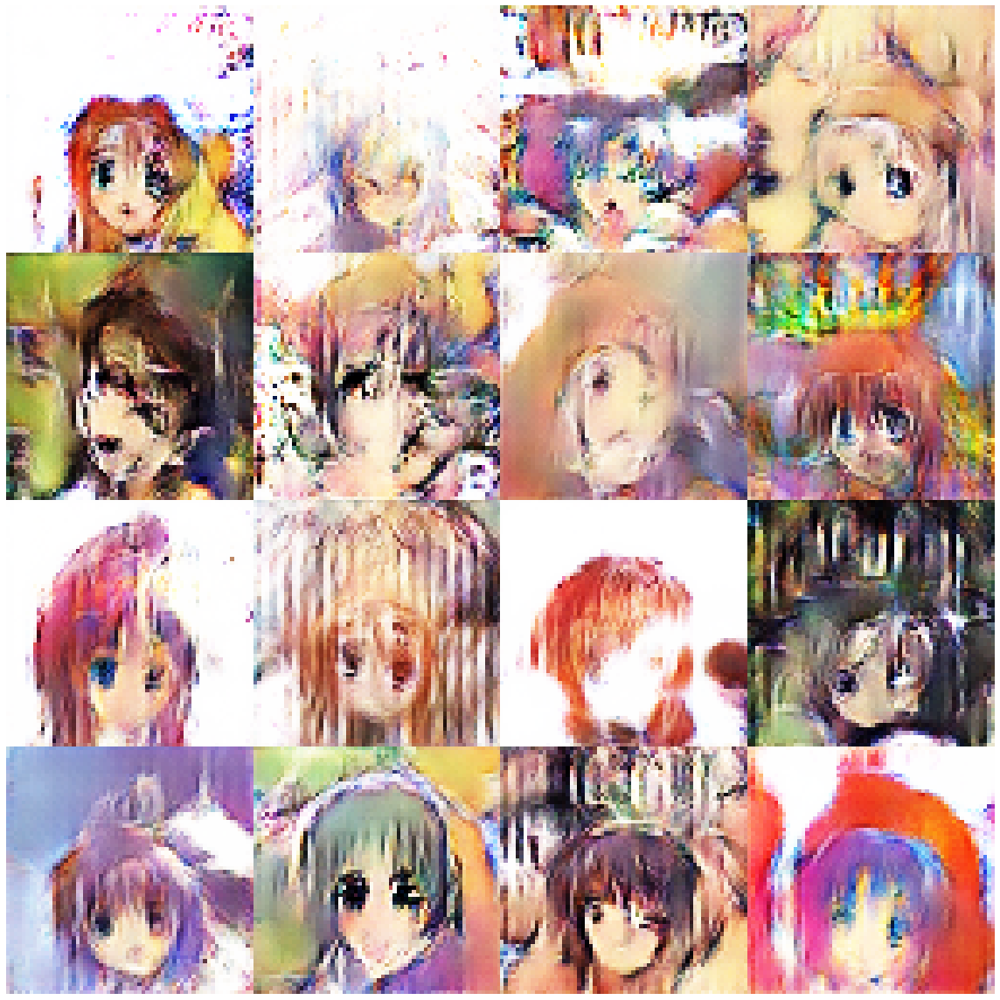

Disc: real loss: 0.347084 fake loss: 0.374661
GAN loss: 2.182226
Step 5000 completed. Time took: 1 secs.
Begin step:  5001
Disc: real loss: 0.349392 fake loss: 0.435076
GAN loss: 3.302091
Step 5001 completed. Time took: 0 secs.
Begin step:  5002
Disc: real loss: 0.393804 fake loss: 0.361127
GAN loss: 1.974801
Step 5002 completed. Time took: 0 secs.
Begin step:  5003
Disc: real loss: 0.344376 fake loss: 0.537744
GAN loss: 4.141691
Step 5003 completed. Time took: 0 secs.
Begin step:  5004
Disc: real loss: 0.762415 fake loss: 0.512559
GAN loss: 2.803732
Step 5004 completed. Time took: 0 secs.
Begin step:  5005
Disc: real loss: 0.357834 fake loss: 0.368976
GAN loss: 1.933369
Step 5005 completed. Time took: 0 secs.
Begin step:  5006
Disc: real loss: 0.360278 fake loss: 0.393626
GAN loss: 2.530912
Step 5006 completed. Time took: 0 secs.
Begin step:  5007
Disc: real loss: 0.410998 fake loss: 0.405914
GAN loss: 2.718227
Step 5007 completed. Time took: 0 secs.
Begin step:  5008
Disc: real loss:

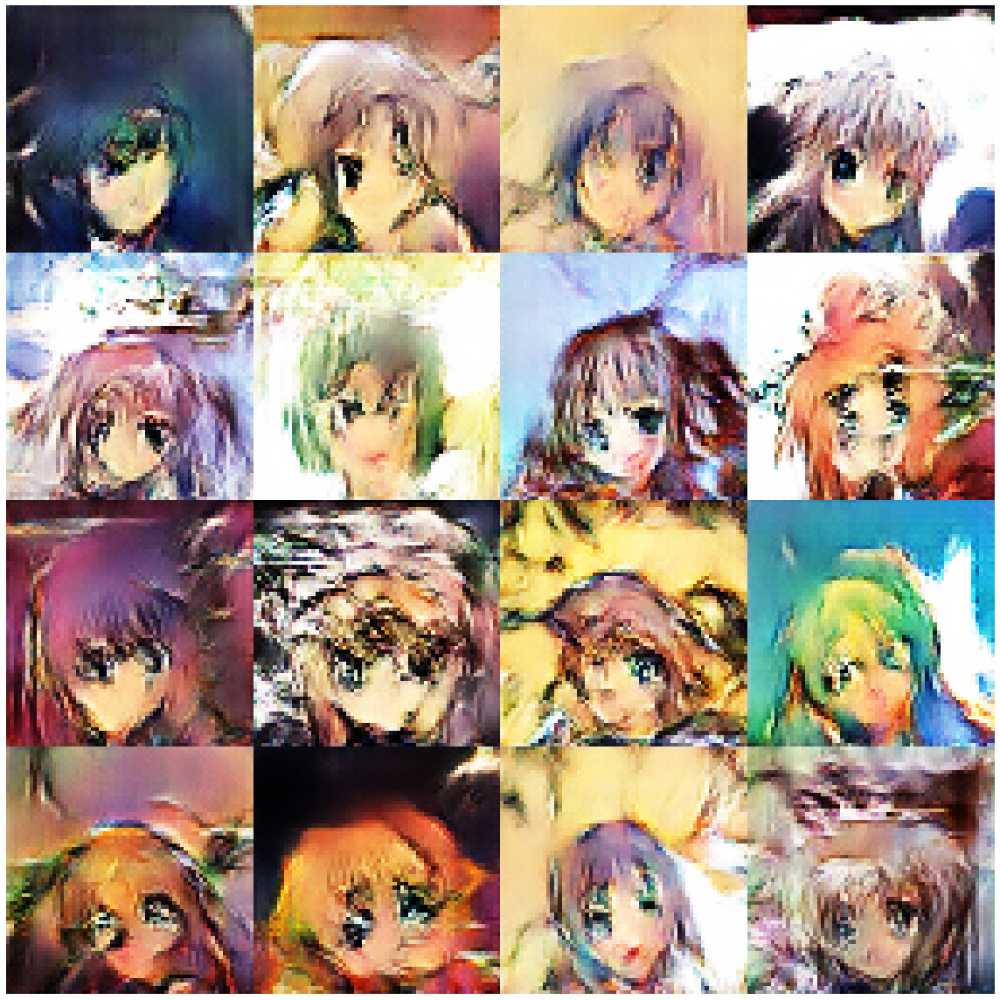

Disc: real loss: 0.354918 fake loss: 0.348682
GAN loss: 2.726010
Step 5100 completed. Time took: 1 secs.
Begin step:  5101
Disc: real loss: 0.343889 fake loss: 0.336790
GAN loss: 2.158485
Step 5101 completed. Time took: 0 secs.
Begin step:  5102
Disc: real loss: 0.318727 fake loss: 0.390045
GAN loss: 2.676210
Step 5102 completed. Time took: 0 secs.
Begin step:  5103
Disc: real loss: 0.421037 fake loss: 0.405306
GAN loss: 2.410908
Step 5103 completed. Time took: 0 secs.
Begin step:  5104
Disc: real loss: 0.346078 fake loss: 0.355827
GAN loss: 2.403467
Step 5104 completed. Time took: 0 secs.
Begin step:  5105
Disc: real loss: 0.321087 fake loss: 0.406006
GAN loss: 2.916649
Step 5105 completed. Time took: 0 secs.
Begin step:  5106
Disc: real loss: 0.398142 fake loss: 0.320936
GAN loss: 2.069135
Step 5106 completed. Time took: 0 secs.
Begin step:  5107
Disc: real loss: 0.331248 fake loss: 0.391001
GAN loss: 2.468868
Step 5107 completed. Time took: 0 secs.
Begin step:  5108
Disc: real loss:

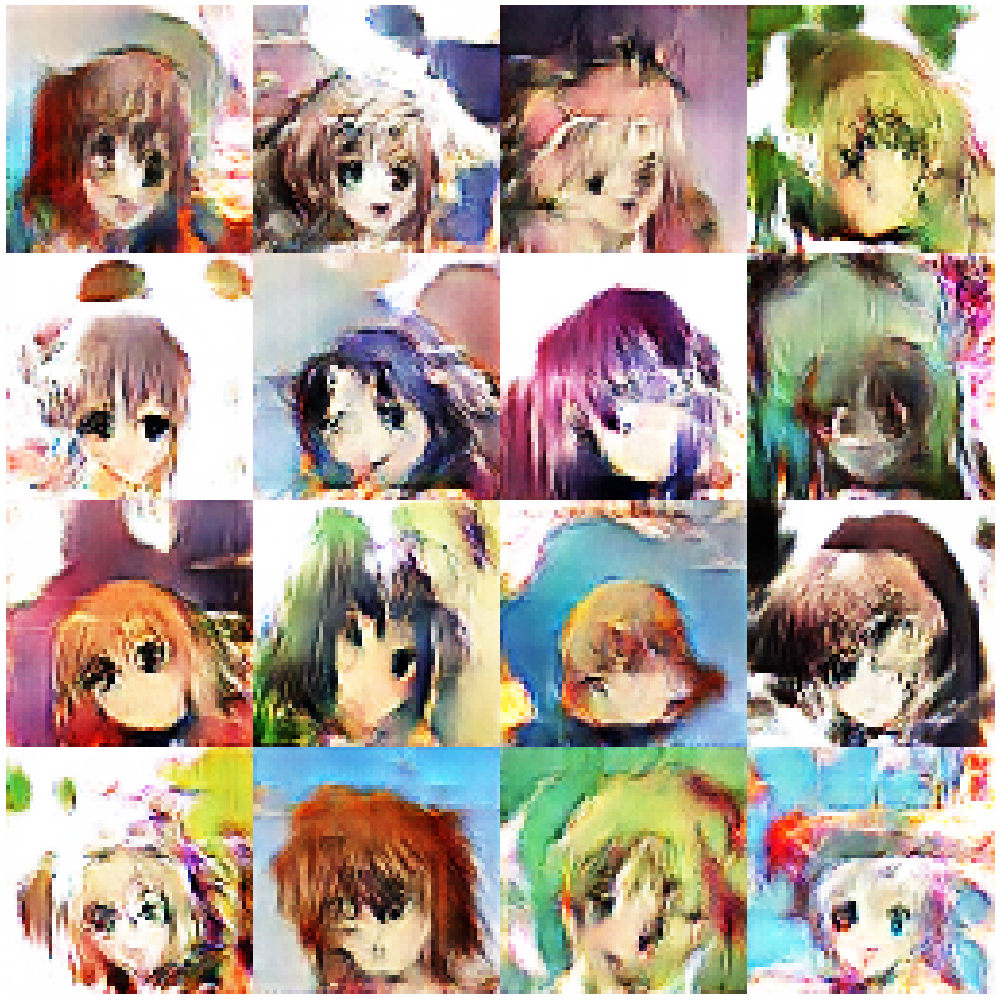

Disc: real loss: 0.358072 fake loss: 0.387715
GAN loss: 2.382615
Step 5200 completed. Time took: 1 secs.
Begin step:  5201
Disc: real loss: 0.384848 fake loss: 0.365535
GAN loss: 2.802793
Step 5201 completed. Time took: 0 secs.
Begin step:  5202
Disc: real loss: 0.423778 fake loss: 0.379809
GAN loss: 2.327754
Step 5202 completed. Time took: 0 secs.
Begin step:  5203
Disc: real loss: 0.376419 fake loss: 0.463236
GAN loss: 3.241713
Step 5203 completed. Time took: 0 secs.
Begin step:  5204
Disc: real loss: 0.341540 fake loss: 0.457138
GAN loss: 2.213342
Step 5204 completed. Time took: 0 secs.
Begin step:  5205
Disc: real loss: 0.327640 fake loss: 0.458186
GAN loss: 3.748870
Step 5205 completed. Time took: 0 secs.
Begin step:  5206
Disc: real loss: 0.551222 fake loss: 0.369132
GAN loss: 1.599061
Step 5206 completed. Time took: 0 secs.
Begin step:  5207
Disc: real loss: 0.356024 fake loss: 0.391871
GAN loss: 2.794663
Step 5207 completed. Time took: 0 secs.
Begin step:  5208
Disc: real loss:

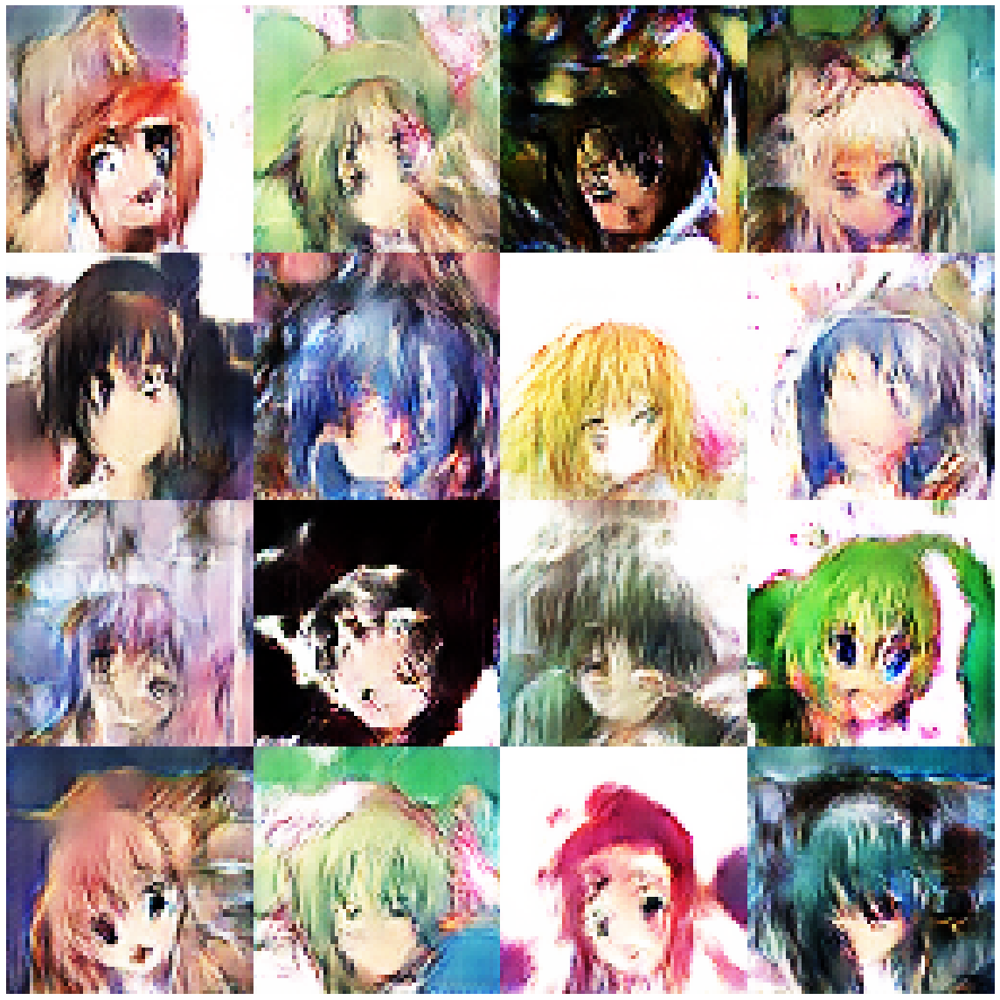

Disc: real loss: 0.329439 fake loss: 0.352430
GAN loss: 2.078082
Step 5300 completed. Time took: 1 secs.
Begin step:  5301
Disc: real loss: 0.347901 fake loss: 0.405547
GAN loss: 3.012406
Step 5301 completed. Time took: 0 secs.
Begin step:  5302
Disc: real loss: 0.402325 fake loss: 0.349201
GAN loss: 2.058834
Step 5302 completed. Time took: 0 secs.
Begin step:  5303
Disc: real loss: 0.356990 fake loss: 0.533394
GAN loss: 3.875868
Step 5303 completed. Time took: 0 secs.
Begin step:  5304
Disc: real loss: 0.388384 fake loss: 0.456034
GAN loss: 2.599836
Step 5304 completed. Time took: 0 secs.
Begin step:  5305
Disc: real loss: 0.392984 fake loss: 0.572954
GAN loss: 4.029249
Step 5305 completed. Time took: 0 secs.
Begin step:  5306
Disc: real loss: 0.511320 fake loss: 0.384030
GAN loss: 1.379878
Step 5306 completed. Time took: 0 secs.
Begin step:  5307
Disc: real loss: 0.394895 fake loss: 0.473215
GAN loss: 3.905955
Step 5307 completed. Time took: 0 secs.
Begin step:  5308
Disc: real loss:

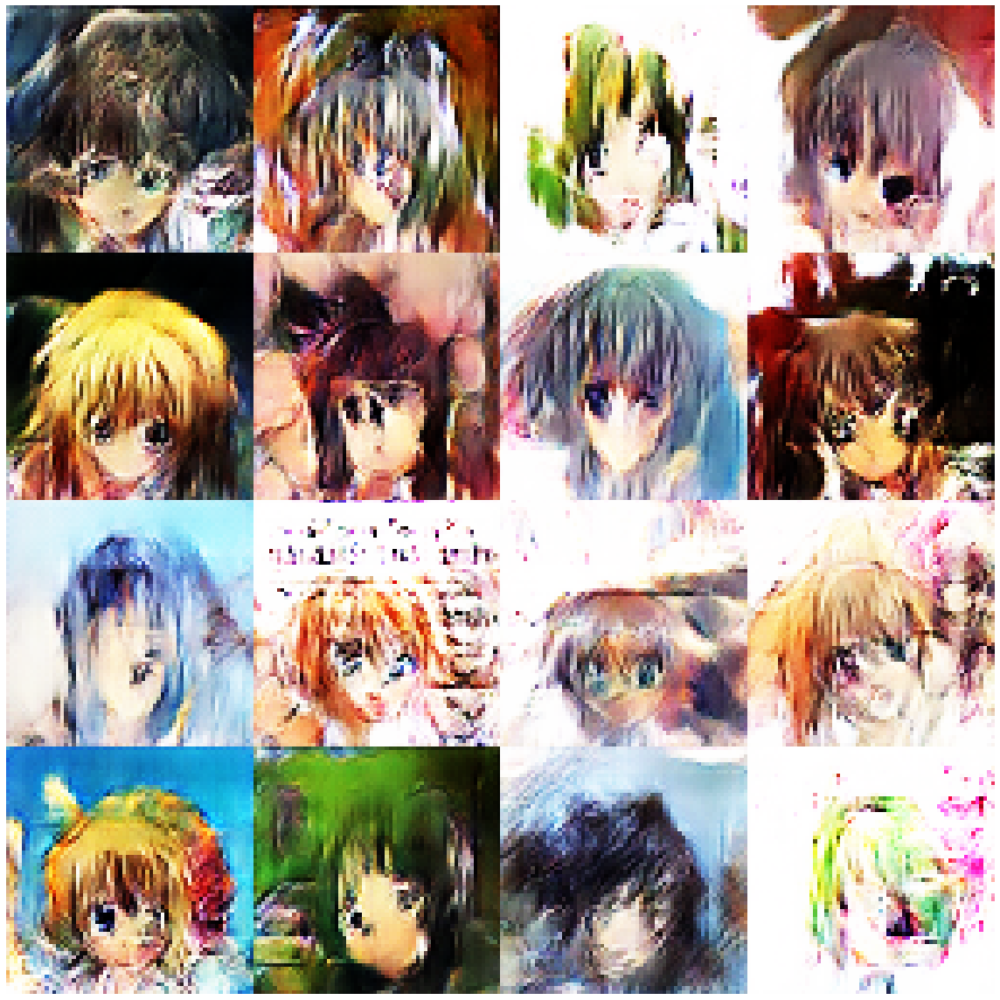

Disc: real loss: 0.348286 fake loss: 0.361851
GAN loss: 1.789676
Step 5400 completed. Time took: 1 secs.
Begin step:  5401
Disc: real loss: 0.338076 fake loss: 0.637174
GAN loss: 5.295222
Step 5401 completed. Time took: 0 secs.
Begin step:  5402
Disc: real loss: 0.864172 fake loss: 0.367640
GAN loss: 1.103363
Step 5402 completed. Time took: 0 secs.
Begin step:  5403
Disc: real loss: 0.534383 fake loss: 0.455952
GAN loss: 4.039034
Step 5403 completed. Time took: 0 secs.
Begin step:  5404
Disc: real loss: 0.474752 fake loss: 0.366213
GAN loss: 1.409930
Step 5404 completed. Time took: 0 secs.
Begin step:  5405
Disc: real loss: 0.432748 fake loss: 0.474945
GAN loss: 3.932111
Step 5405 completed. Time took: 0 secs.
Begin step:  5406
Disc: real loss: 0.435597 fake loss: 0.368695
GAN loss: 2.067124
Step 5406 completed. Time took: 0 secs.
Begin step:  5407
Disc: real loss: 0.323516 fake loss: 0.404100
GAN loss: 2.495352
Step 5407 completed. Time took: 0 secs.
Begin step:  5408
Disc: real loss:

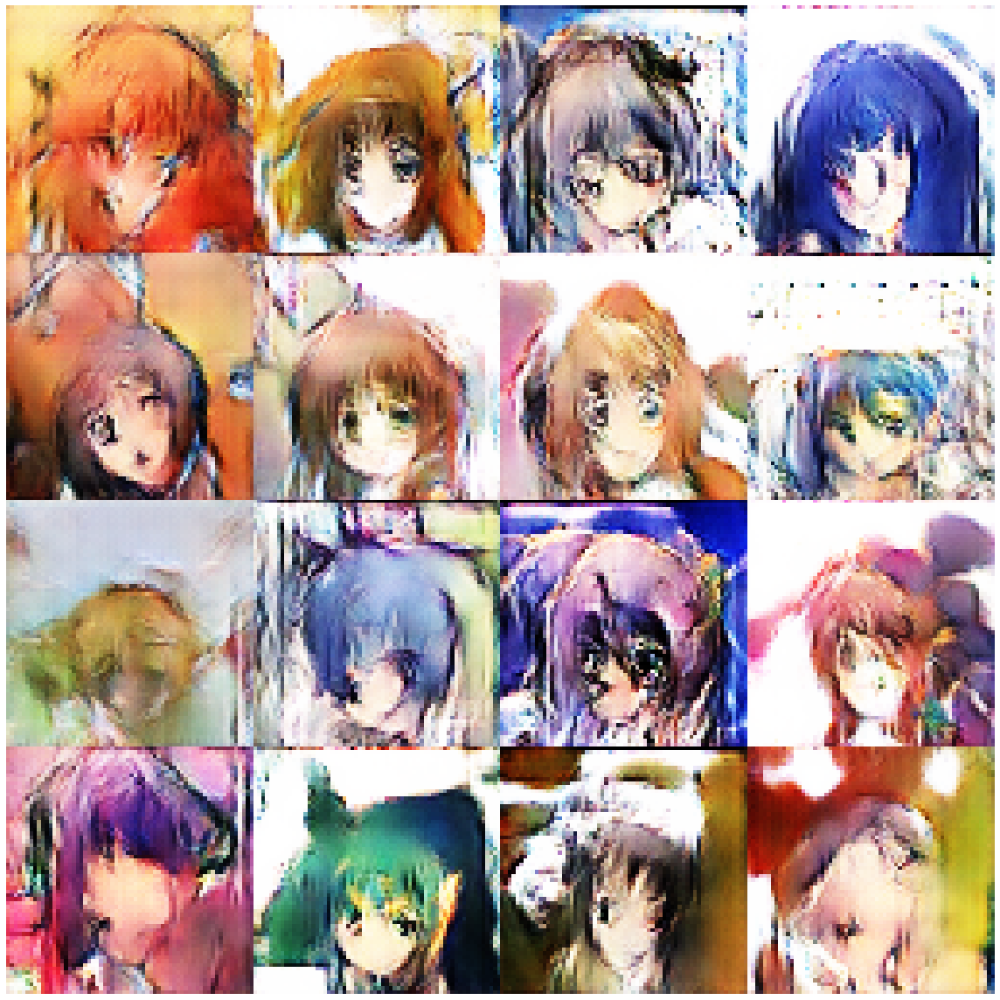

Begin step:  5500


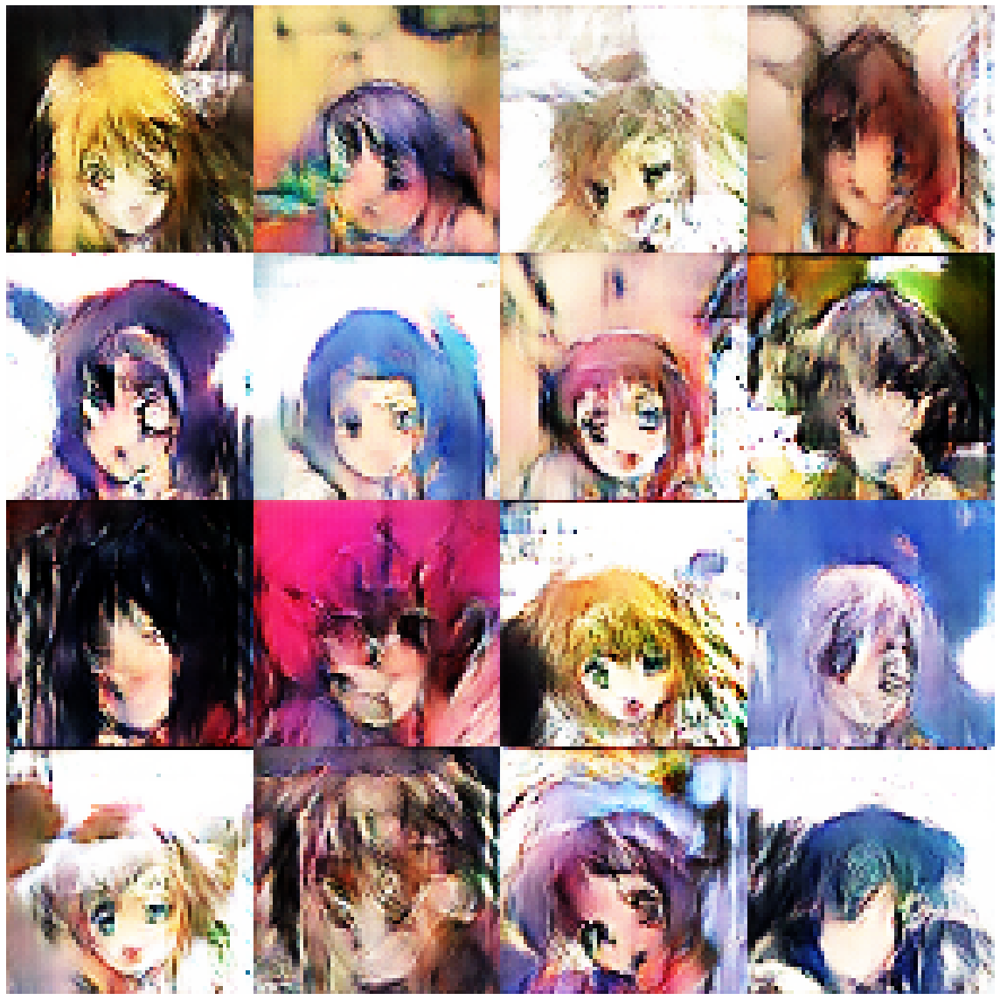

Disc: real loss: 0.338602 fake loss: 0.358444
GAN loss: 2.141200
Step 5500 completed. Time took: 1 secs.
Begin step:  5501
Disc: real loss: 0.374610 fake loss: 0.415490
GAN loss: 2.707116
Step 5501 completed. Time took: 0 secs.
Begin step:  5502
Disc: real loss: 0.372686 fake loss: 0.365017
GAN loss: 1.923178
Step 5502 completed. Time took: 0 secs.
Begin step:  5503
Disc: real loss: 0.366329 fake loss: 0.378272
GAN loss: 2.578363
Step 5503 completed. Time took: 0 secs.
Begin step:  5504
Disc: real loss: 0.344576 fake loss: 0.343960
GAN loss: 2.437533
Step 5504 completed. Time took: 0 secs.
Begin step:  5505
Disc: real loss: 0.406509 fake loss: 0.553336
GAN loss: 3.432944
Step 5505 completed. Time took: 0 secs.
Begin step:  5506
Disc: real loss: 0.510244 fake loss: 0.354126
GAN loss: 1.658729
Step 5506 completed. Time took: 0 secs.
Begin step:  5507
Disc: real loss: 0.361740 fake loss: 0.438618
GAN loss: 3.291224
Step 5507 completed. Time took: 0 secs.
Begin step:  5508
Disc: real loss:

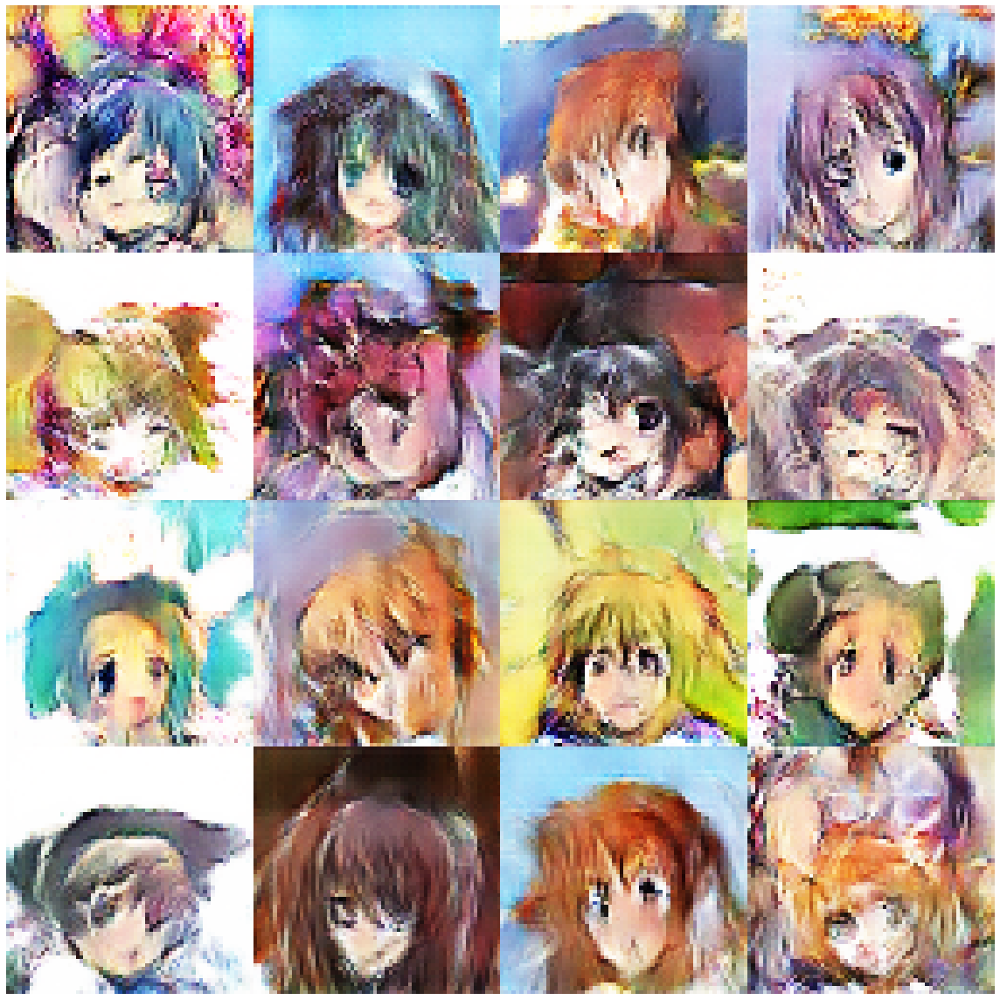

Disc: real loss: 0.403662 fake loss: 0.376448
GAN loss: 2.467666
Step 5600 completed. Time took: 1 secs.
Begin step:  5601
Disc: real loss: 0.358516 fake loss: 0.344359
GAN loss: 1.974246
Step 5601 completed. Time took: 0 secs.
Begin step:  5602
Disc: real loss: 0.366549 fake loss: 0.326593
GAN loss: 2.414660
Step 5602 completed. Time took: 0 secs.
Begin step:  5603
Disc: real loss: 0.370842 fake loss: 0.385035
GAN loss: 2.171198
Step 5603 completed. Time took: 0 secs.
Begin step:  5604
Disc: real loss: 0.355608 fake loss: 0.342973
GAN loss: 2.485540
Step 5604 completed. Time took: 0 secs.
Begin step:  5605
Disc: real loss: 0.343749 fake loss: 0.345942
GAN loss: 2.260677
Step 5605 completed. Time took: 0 secs.
Begin step:  5606
Disc: real loss: 0.363479 fake loss: 0.354016
GAN loss: 2.128468
Step 5606 completed. Time took: 0 secs.
Begin step:  5607
Disc: real loss: 0.370777 fake loss: 0.415354
GAN loss: 2.912227
Step 5607 completed. Time took: 0 secs.
Begin step:  5608
Disc: real loss:

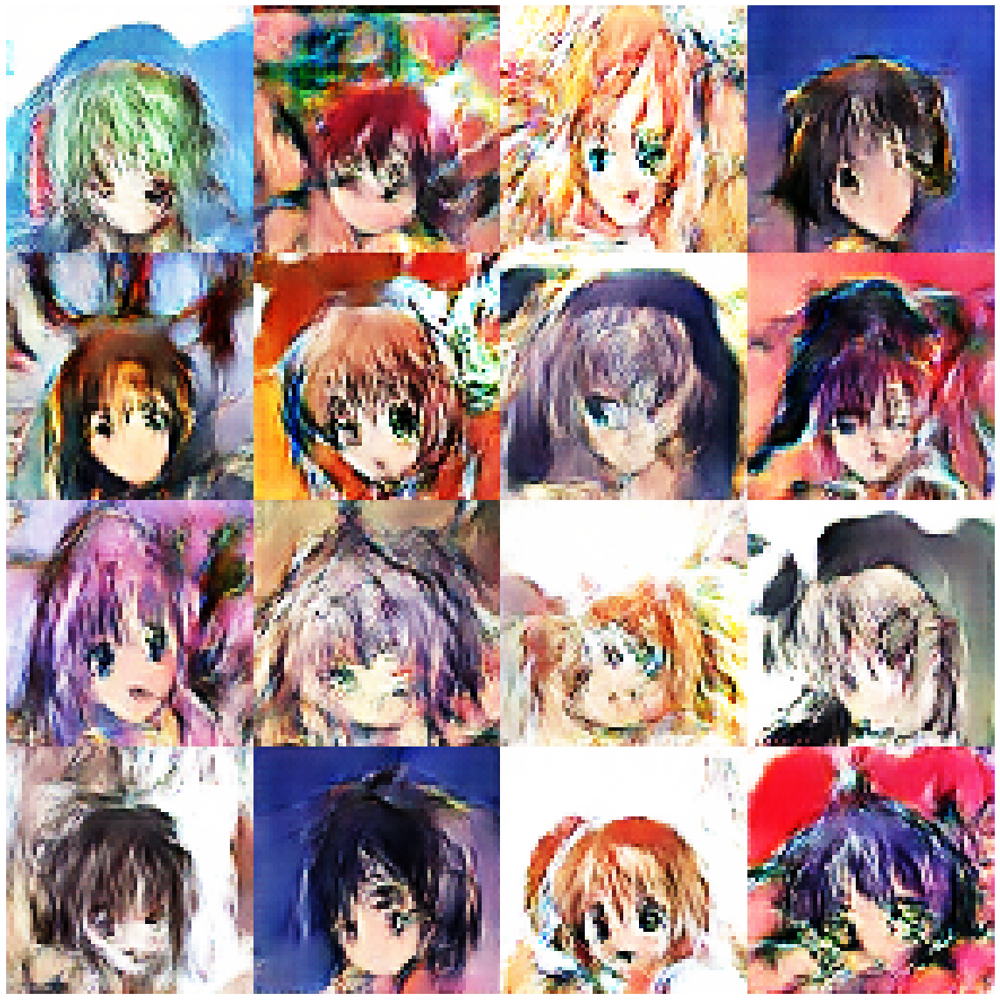

Disc: real loss: 0.333106 fake loss: 0.398375
GAN loss: 2.753907
Step 5700 completed. Time took: 1 secs.
Begin step:  5701
Disc: real loss: 0.350438 fake loss: 0.386821
GAN loss: 1.977512
Step 5701 completed. Time took: 0 secs.
Begin step:  5702
Disc: real loss: 0.339145 fake loss: 0.376143
GAN loss: 2.755356
Step 5702 completed. Time took: 0 secs.
Begin step:  5703
Disc: real loss: 0.415317 fake loss: 0.397757
GAN loss: 2.377667
Step 5703 completed. Time took: 0 secs.
Begin step:  5704
Disc: real loss: 0.341135 fake loss: 0.375983
GAN loss: 2.431036
Step 5704 completed. Time took: 0 secs.
Begin step:  5705
Disc: real loss: 0.344228 fake loss: 0.346897
GAN loss: 2.084257
Step 5705 completed. Time took: 0 secs.
Begin step:  5706
Disc: real loss: 0.376834 fake loss: 0.455805
GAN loss: 3.144922
Step 5706 completed. Time took: 0 secs.
Begin step:  5707
Disc: real loss: 0.404117 fake loss: 0.341056
GAN loss: 2.037921
Step 5707 completed. Time took: 0 secs.
Begin step:  5708
Disc: real loss:

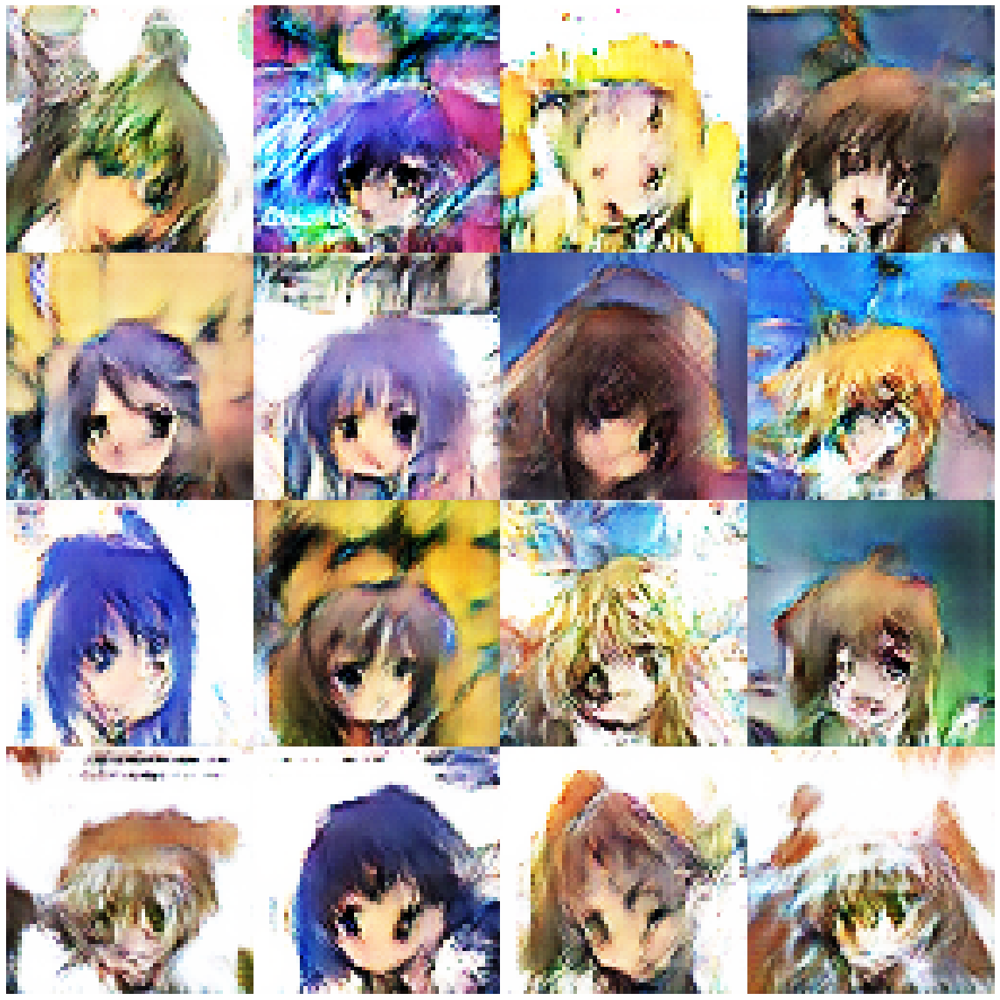

Disc: real loss: 0.345841 fake loss: 0.471240
GAN loss: 3.509606
Step 5800 completed. Time took: 1 secs.
Begin step:  5801
Disc: real loss: 0.452337 fake loss: 0.358457
GAN loss: 1.892098
Step 5801 completed. Time took: 0 secs.
Begin step:  5802
Disc: real loss: 0.350391 fake loss: 0.513161
GAN loss: 3.468427
Step 5802 completed. Time took: 0 secs.
Begin step:  5803
Disc: real loss: 0.577030 fake loss: 0.348605
GAN loss: 1.742298
Step 5803 completed. Time took: 0 secs.
Begin step:  5804
Disc: real loss: 0.387256 fake loss: 0.394352
GAN loss: 2.604943
Step 5804 completed. Time took: 0 secs.
Begin step:  5805
Disc: real loss: 0.381970 fake loss: 0.347958
GAN loss: 2.157124
Step 5805 completed. Time took: 0 secs.
Begin step:  5806
Disc: real loss: 0.366349 fake loss: 0.418346
GAN loss: 2.665694
Step 5806 completed. Time took: 0 secs.
Begin step:  5807
Disc: real loss: 0.440950 fake loss: 0.383976
GAN loss: 2.118868
Step 5807 completed. Time took: 0 secs.
Begin step:  5808
Disc: real loss:

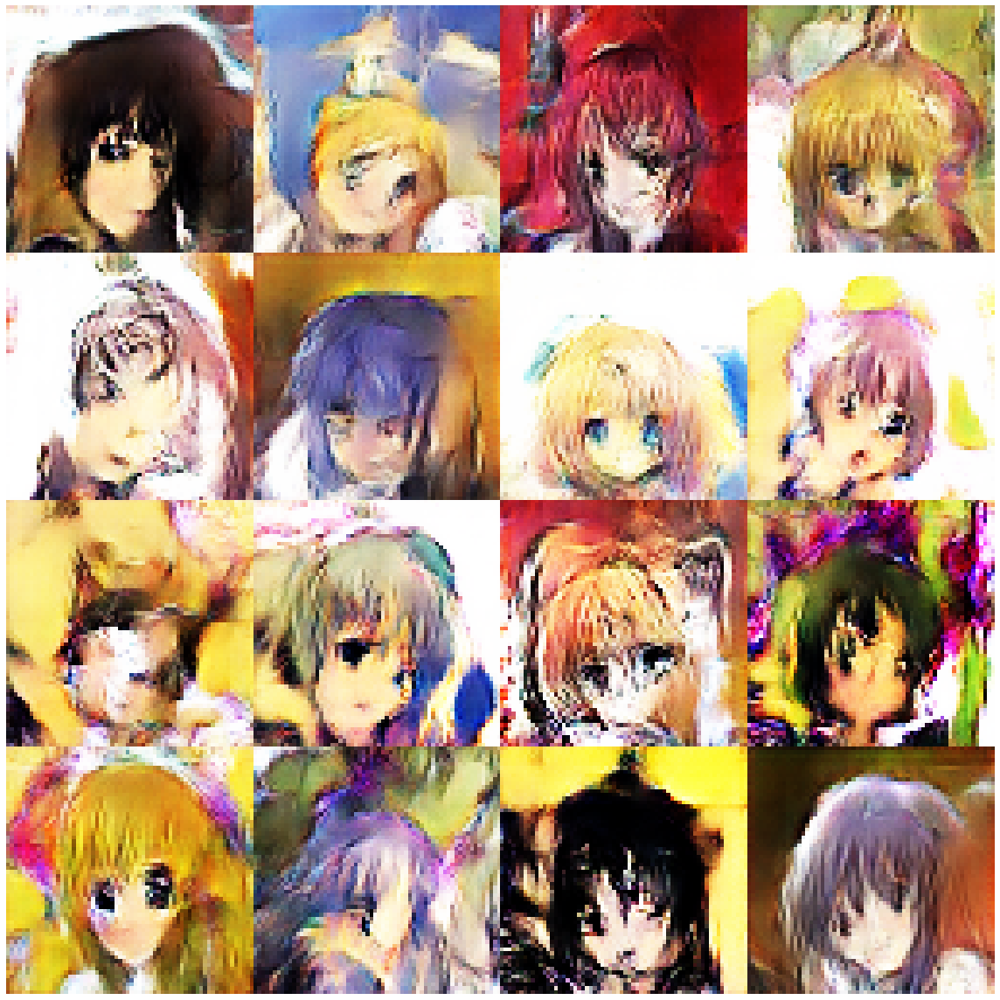

Disc: real loss: 0.349669 fake loss: 0.344833
GAN loss: 1.990092
Step 5900 completed. Time took: 1 secs.
Begin step:  5901
Disc: real loss: 0.339787 fake loss: 0.372688
GAN loss: 2.759321
Step 5901 completed. Time took: 0 secs.
Begin step:  5902
Disc: real loss: 0.458883 fake loss: 0.382867
GAN loss: 2.083239
Step 5902 completed. Time took: 0 secs.
Begin step:  5903
Disc: real loss: 0.324196 fake loss: 0.356359
GAN loss: 2.385900
Step 5903 completed. Time took: 0 secs.
Begin step:  5904
Disc: real loss: 0.344602 fake loss: 0.365067
GAN loss: 2.768562
Step 5904 completed. Time took: 0 secs.
Begin step:  5905
Disc: real loss: 0.361960 fake loss: 0.313482
GAN loss: 2.329225
Step 5905 completed. Time took: 0 secs.
Begin step:  5906
Disc: real loss: 0.352864 fake loss: 0.352771
GAN loss: 2.402858
Step 5906 completed. Time took: 0 secs.
Begin step:  5907
Disc: real loss: 0.344882 fake loss: 0.353896
GAN loss: 2.444166
Step 5907 completed. Time took: 0 secs.
Begin step:  5908
Disc: real loss:

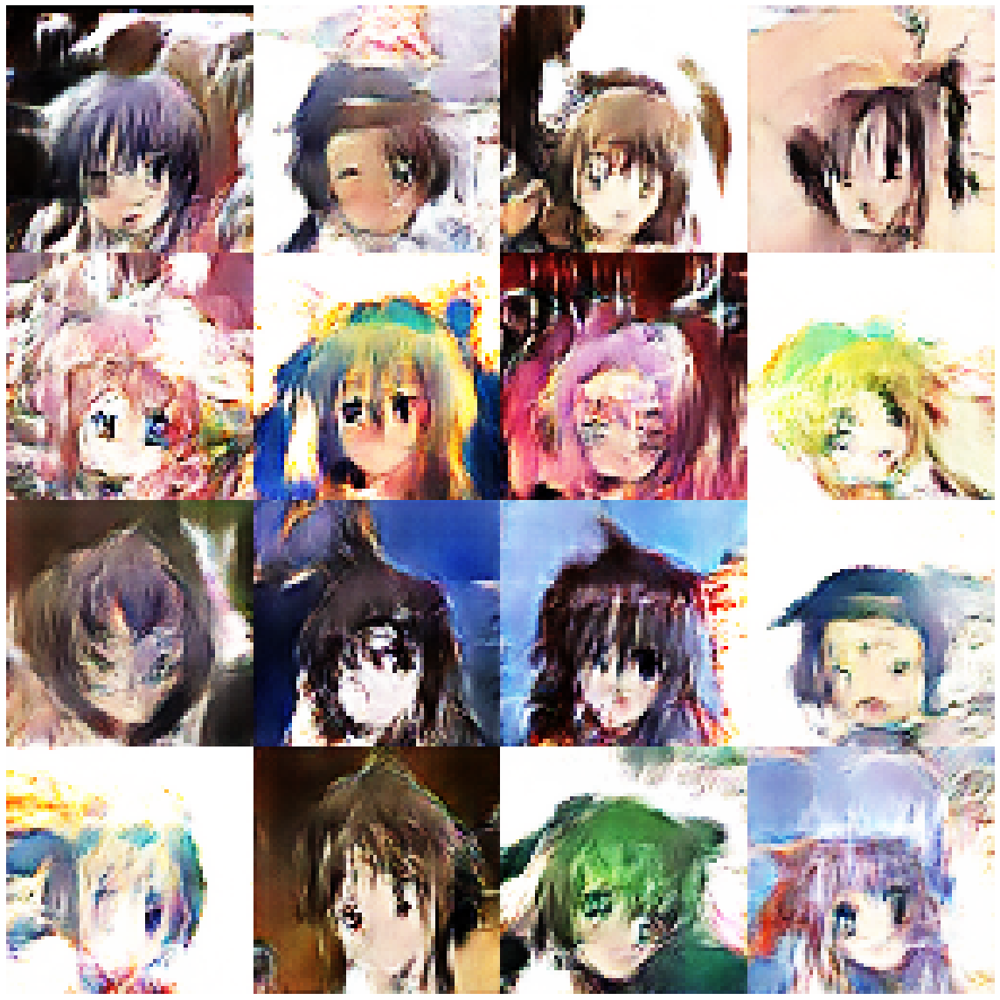

Begin step:  6000


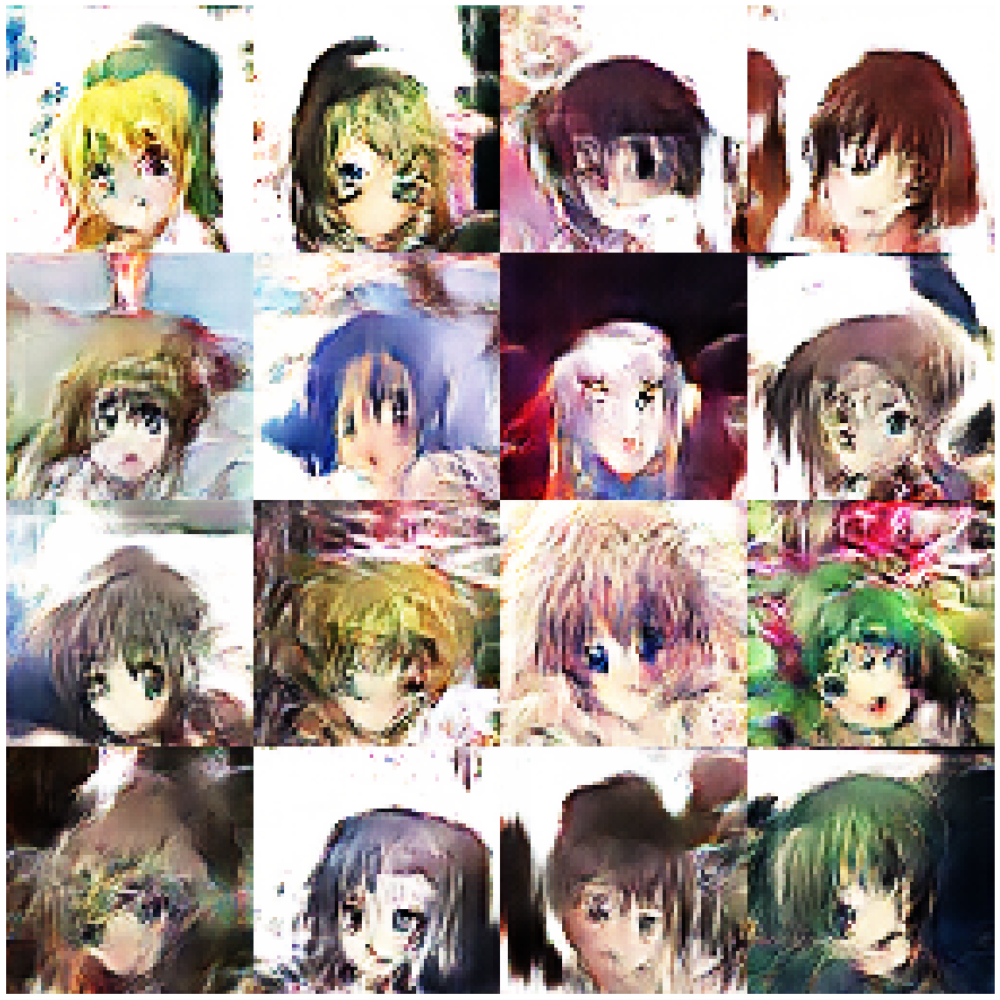

Disc: real loss: 0.343219 fake loss: 0.364907
GAN loss: 2.394464
Step 6000 completed. Time took: 1 secs.
Begin step:  6001
Disc: real loss: 0.314190 fake loss: 0.324523
GAN loss: 2.486628
Step 6001 completed. Time took: 0 secs.
Begin step:  6002
Disc: real loss: 0.366142 fake loss: 0.371858
GAN loss: 2.241800
Step 6002 completed. Time took: 0 secs.
Begin step:  6003
Disc: real loss: 0.362426 fake loss: 0.355238
GAN loss: 2.581252
Step 6003 completed. Time took: 0 secs.
Begin step:  6004
Disc: real loss: 0.386032 fake loss: 0.426975
GAN loss: 2.944844
Step 6004 completed. Time took: 0 secs.
Begin step:  6005
Disc: real loss: 0.373661 fake loss: 0.341831
GAN loss: 2.361068
Step 6005 completed. Time took: 0 secs.
Begin step:  6006
Disc: real loss: 0.349447 fake loss: 0.335563
GAN loss: 2.450421
Step 6006 completed. Time took: 0 secs.
Begin step:  6007
Disc: real loss: 0.337181 fake loss: 0.347638
GAN loss: 2.957595
Step 6007 completed. Time took: 0 secs.
Begin step:  6008
Disc: real loss:

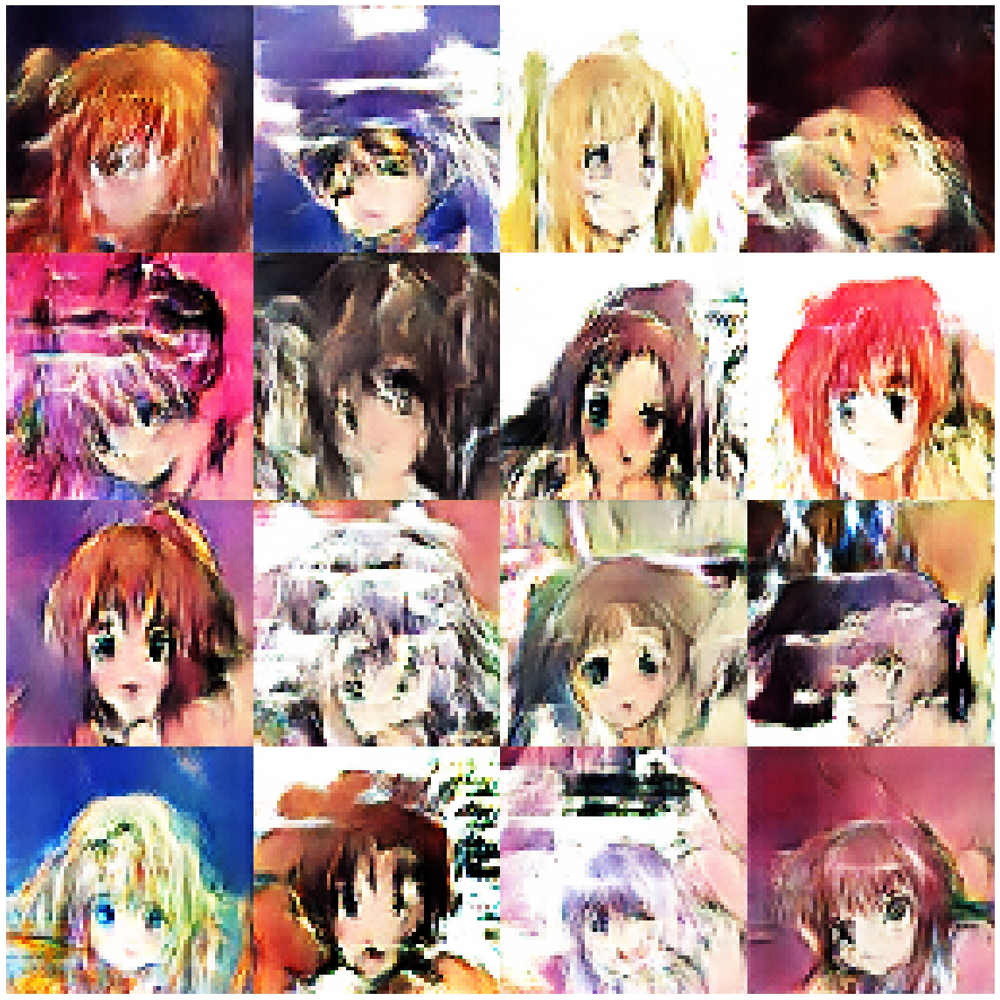

Disc: real loss: 0.332316 fake loss: 0.377573
GAN loss: 2.308689
Step 6100 completed. Time took: 1 secs.
Begin step:  6101
Disc: real loss: 0.354484 fake loss: 0.355713
GAN loss: 2.477578
Step 6101 completed. Time took: 0 secs.
Begin step:  6102
Disc: real loss: 0.377839 fake loss: 0.350086
GAN loss: 2.217659
Step 6102 completed. Time took: 0 secs.
Begin step:  6103
Disc: real loss: 0.359626 fake loss: 0.350887
GAN loss: 2.541353
Step 6103 completed. Time took: 0 secs.
Begin step:  6104
Disc: real loss: 0.367295 fake loss: 0.363807
GAN loss: 2.176276
Step 6104 completed. Time took: 0 secs.
Begin step:  6105
Disc: real loss: 0.352877 fake loss: 0.365975
GAN loss: 2.547328
Step 6105 completed. Time took: 0 secs.
Begin step:  6106
Disc: real loss: 0.347392 fake loss: 0.391309
GAN loss: 1.747633
Step 6106 completed. Time took: 0 secs.
Begin step:  6107
Disc: real loss: 0.345547 fake loss: 0.394592
GAN loss: 2.558092
Step 6107 completed. Time took: 0 secs.
Begin step:  6108
Disc: real loss:

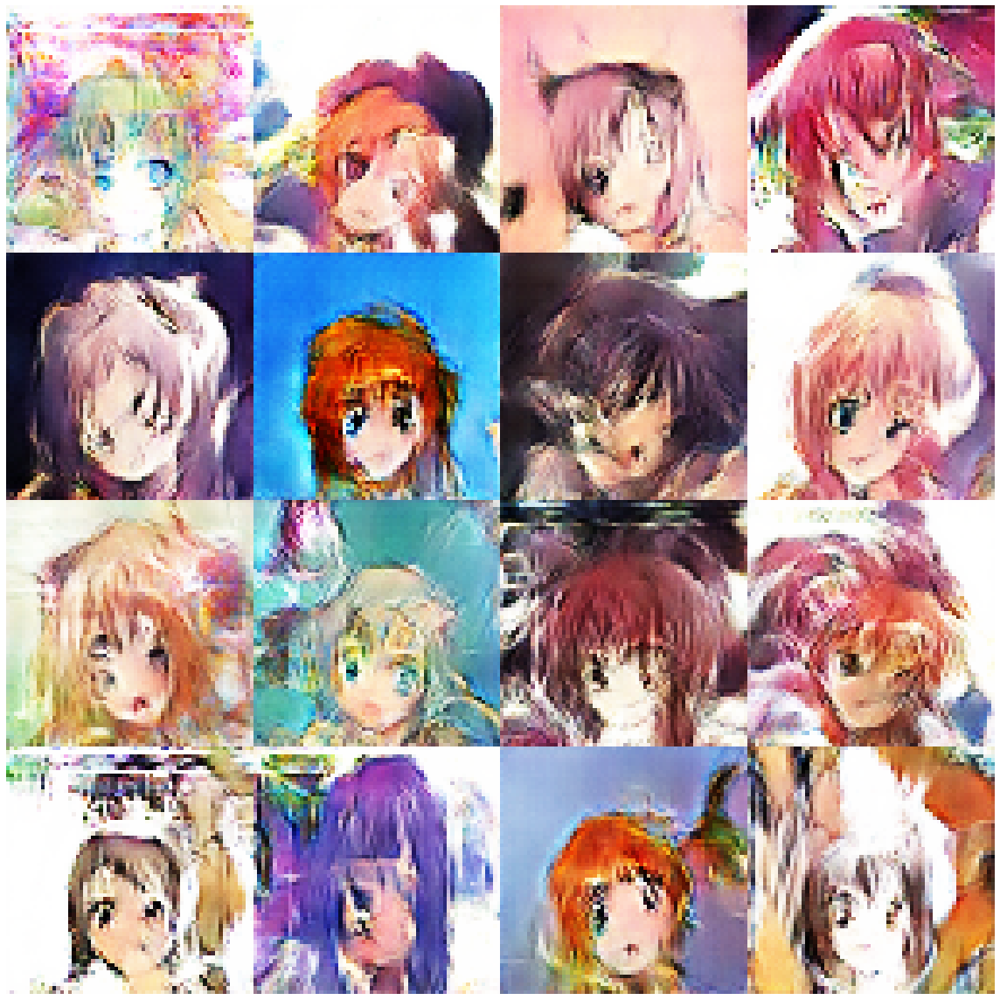

Disc: real loss: 0.535589 fake loss: 0.357204
GAN loss: 1.653292
Step 6200 completed. Time took: 1 secs.
Begin step:  6201
Disc: real loss: 0.372712 fake loss: 0.340647
GAN loss: 3.284055
Step 6201 completed. Time took: 0 secs.
Begin step:  6202
Disc: real loss: 0.406265 fake loss: 0.324955
GAN loss: 1.617249
Step 6202 completed. Time took: 0 secs.
Begin step:  6203
Disc: real loss: 0.359182 fake loss: 0.400951
GAN loss: 3.264019
Step 6203 completed. Time took: 0 secs.
Begin step:  6204
Disc: real loss: 0.494069 fake loss: 0.371080
GAN loss: 2.331510
Step 6204 completed. Time took: 0 secs.
Begin step:  6205
Disc: real loss: 0.364713 fake loss: 0.354977
GAN loss: 2.517682
Step 6205 completed. Time took: 0 secs.
Begin step:  6206
Disc: real loss: 0.346844 fake loss: 0.365659
GAN loss: 2.289088
Step 6206 completed. Time took: 0 secs.
Begin step:  6207
Disc: real loss: 0.328816 fake loss: 0.436285
GAN loss: 3.664099
Step 6207 completed. Time took: 0 secs.
Begin step:  6208
Disc: real loss:

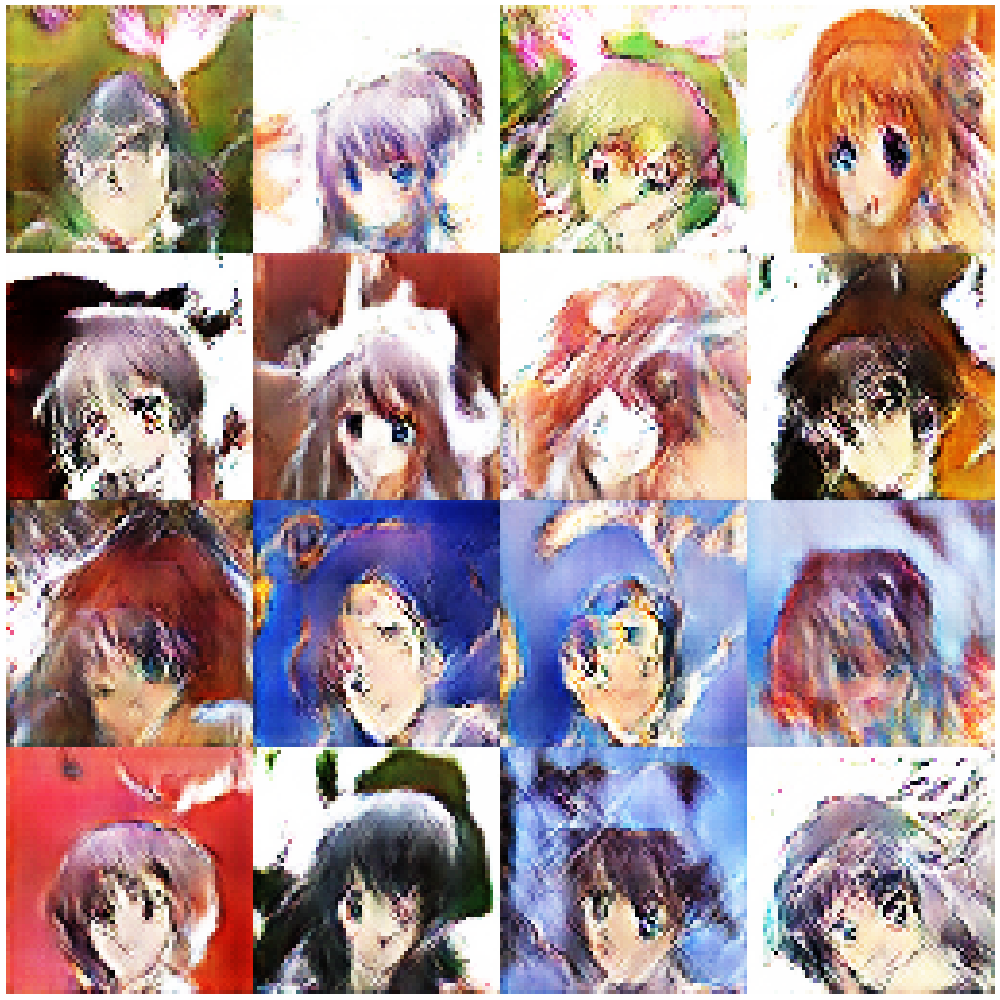

Disc: real loss: 0.628731 fake loss: 0.349303
GAN loss: 1.829571
Step 6300 completed. Time took: 1 secs.
Begin step:  6301
Disc: real loss: 0.360364 fake loss: 0.440621
GAN loss: 3.676390
Step 6301 completed. Time took: 0 secs.
Begin step:  6302
Disc: real loss: 0.400981 fake loss: 0.395020
GAN loss: 2.102448
Step 6302 completed. Time took: 0 secs.
Begin step:  6303
Disc: real loss: 0.366895 fake loss: 0.394137
GAN loss: 2.345648
Step 6303 completed. Time took: 0 secs.
Begin step:  6304
Disc: real loss: 0.381179 fake loss: 0.358955
GAN loss: 1.952769
Step 6304 completed. Time took: 0 secs.
Begin step:  6305
Disc: real loss: 0.364732 fake loss: 0.392767
GAN loss: 2.634073
Step 6305 completed. Time took: 0 secs.
Begin step:  6306
Disc: real loss: 0.414101 fake loss: 0.386298
GAN loss: 2.243013
Step 6306 completed. Time took: 0 secs.
Begin step:  6307
Disc: real loss: 0.397598 fake loss: 0.475663
GAN loss: 3.056917
Step 6307 completed. Time took: 0 secs.
Begin step:  6308
Disc: real loss:

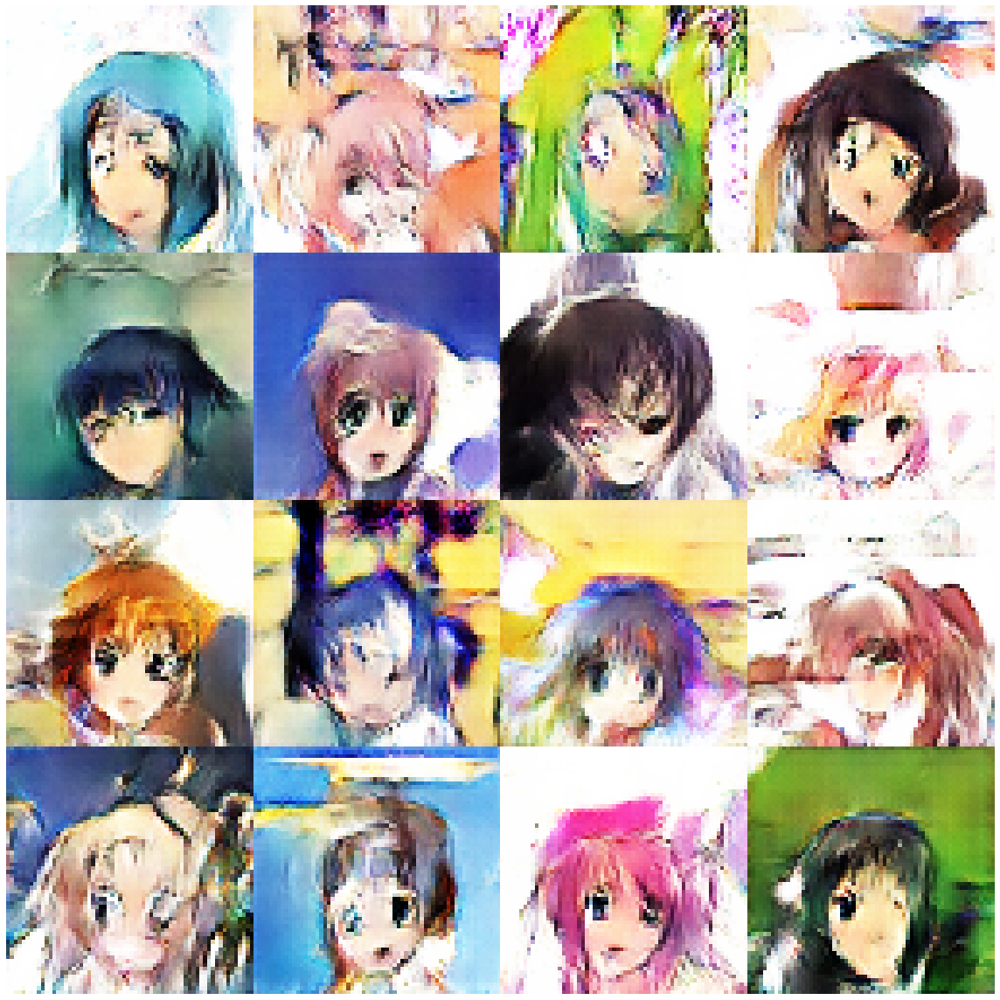

Disc: real loss: 0.335712 fake loss: 0.395053
GAN loss: 3.352825
Step 6400 completed. Time took: 1 secs.
Begin step:  6401
Disc: real loss: 0.489970 fake loss: 0.366387
GAN loss: 1.832816
Step 6401 completed. Time took: 0 secs.
Begin step:  6402
Disc: real loss: 0.337567 fake loss: 0.351382
GAN loss: 2.114072
Step 6402 completed. Time took: 0 secs.
Begin step:  6403
Disc: real loss: 0.340146 fake loss: 0.356660
GAN loss: 2.352446
Step 6403 completed. Time took: 0 secs.
Begin step:  6404
Disc: real loss: 0.345214 fake loss: 0.415268
GAN loss: 2.849924
Step 6404 completed. Time took: 0 secs.
Begin step:  6405
Disc: real loss: 0.372504 fake loss: 0.327657
GAN loss: 1.966807
Step 6405 completed. Time took: 0 secs.
Begin step:  6406
Disc: real loss: 0.335874 fake loss: 0.340394
GAN loss: 2.688468
Step 6406 completed. Time took: 0 secs.
Begin step:  6407
Disc: real loss: 0.374763 fake loss: 0.340868
GAN loss: 2.512014
Step 6407 completed. Time took: 0 secs.
Begin step:  6408
Disc: real loss:

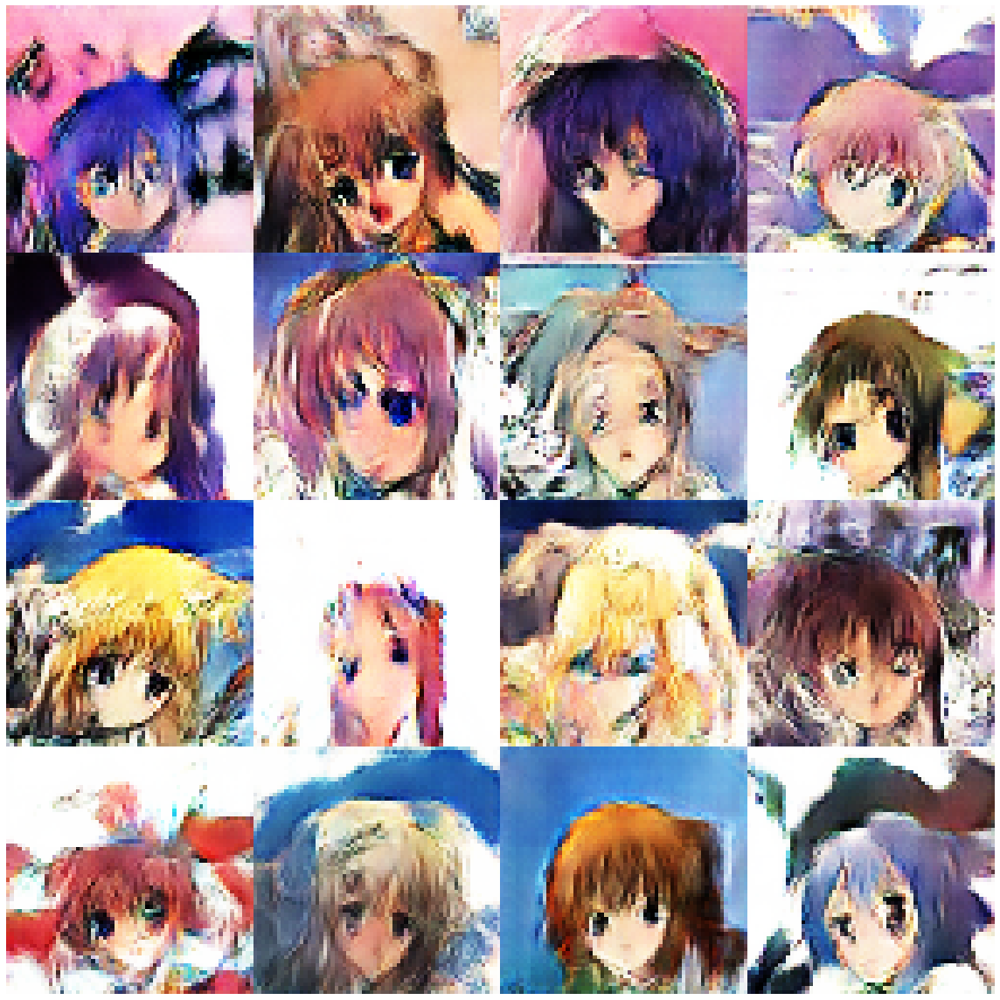

Begin step:  6500


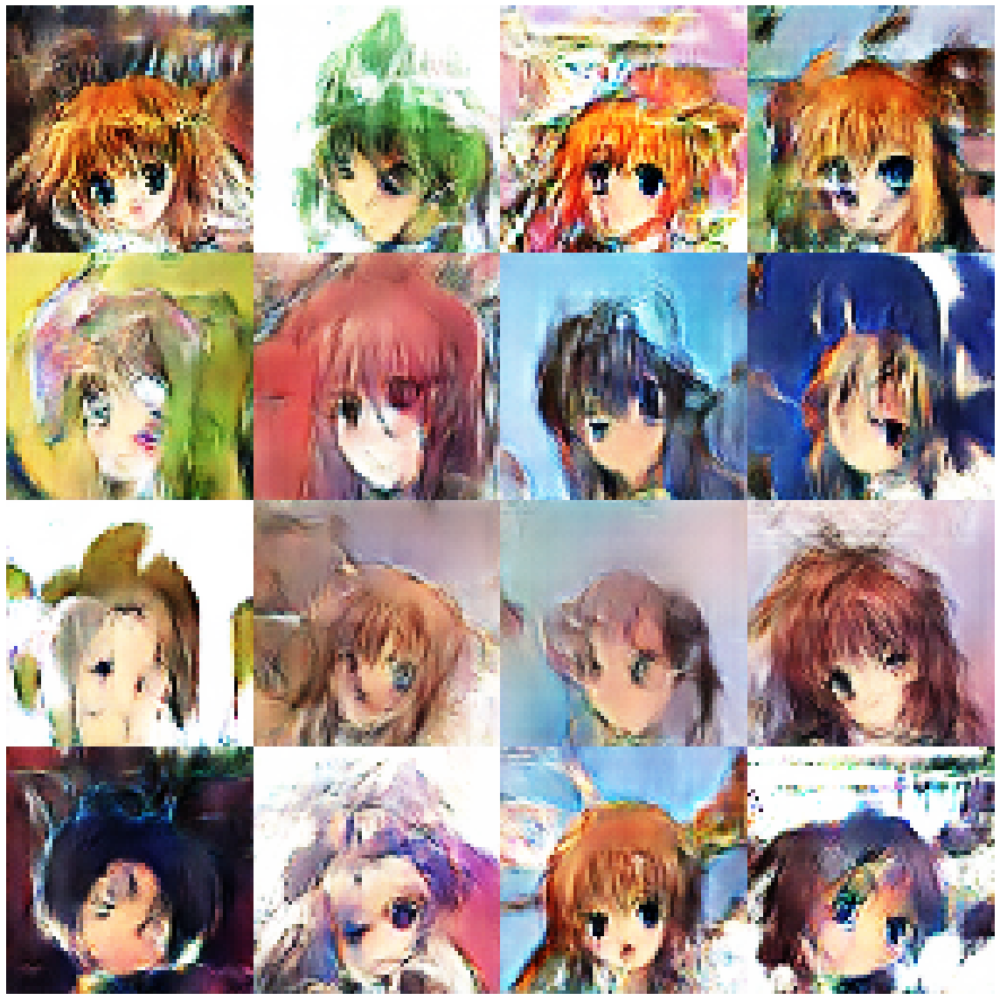

Disc: real loss: 0.358063 fake loss: 0.343972
GAN loss: 2.138083
Step 6500 completed. Time took: 1 secs.
Begin step:  6501
Disc: real loss: 0.351956 fake loss: 0.347998
GAN loss: 2.810272
Step 6501 completed. Time took: 0 secs.
Begin step:  6502
Disc: real loss: 0.354652 fake loss: 0.345361
GAN loss: 2.229826
Step 6502 completed. Time took: 0 secs.
Begin step:  6503
Disc: real loss: 0.366328 fake loss: 0.356103
GAN loss: 2.481356
Step 6503 completed. Time took: 0 secs.
Begin step:  6504
Disc: real loss: 0.334442 fake loss: 0.351337
GAN loss: 2.455141
Step 6504 completed. Time took: 0 secs.
Begin step:  6505
Disc: real loss: 0.331986 fake loss: 0.388453
GAN loss: 2.281201
Step 6505 completed. Time took: 0 secs.
Begin step:  6506
Disc: real loss: 0.344488 fake loss: 0.341508
GAN loss: 2.062263
Step 6506 completed. Time took: 0 secs.
Begin step:  6507
Disc: real loss: 0.335886 fake loss: 0.365571
GAN loss: 2.344977
Step 6507 completed. Time took: 0 secs.
Begin step:  6508
Disc: real loss:

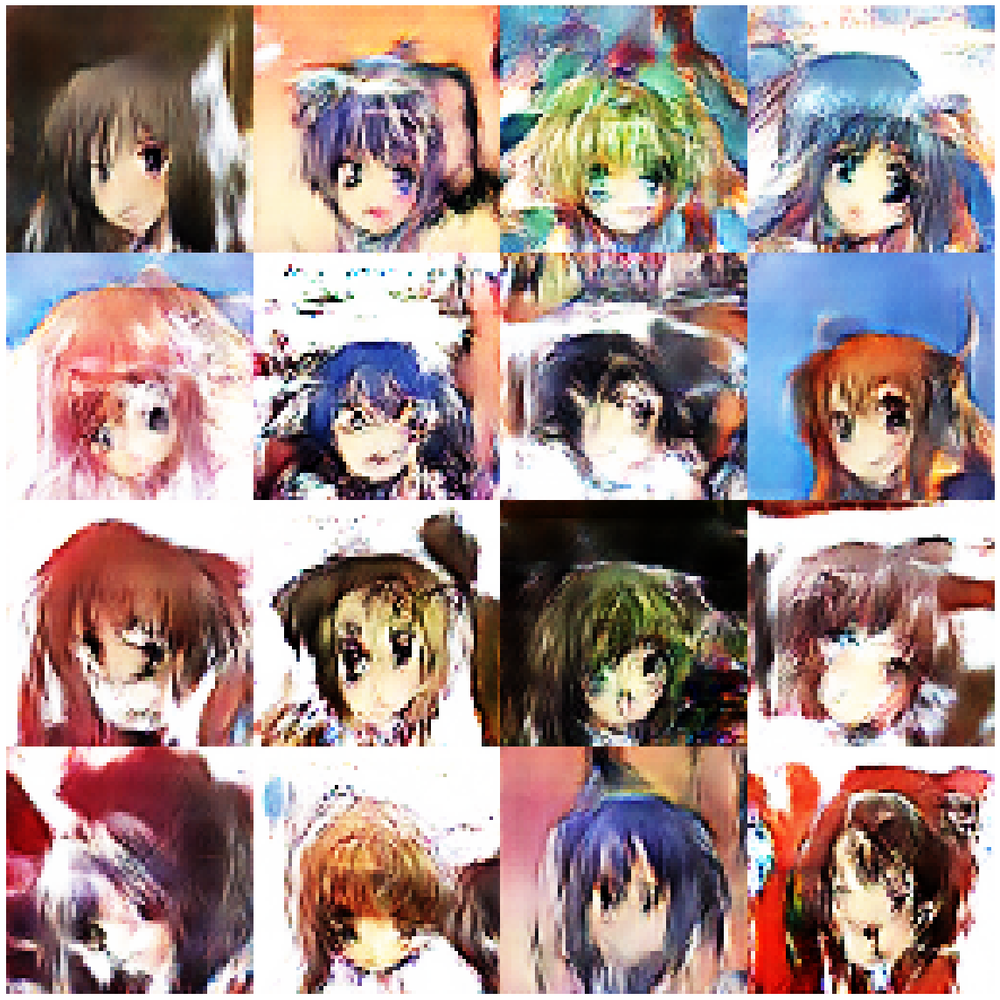

Disc: real loss: 0.355835 fake loss: 0.326870
GAN loss: 2.600007
Step 6600 completed. Time took: 1 secs.
Begin step:  6601
Disc: real loss: 0.383351 fake loss: 0.354415
GAN loss: 1.720357
Step 6601 completed. Time took: 0 secs.
Begin step:  6602
Disc: real loss: 0.342587 fake loss: 0.346393
GAN loss: 2.525284
Step 6602 completed. Time took: 0 secs.
Begin step:  6603
Disc: real loss: 0.410709 fake loss: 0.436612
GAN loss: 2.902518
Step 6603 completed. Time took: 0 secs.
Begin step:  6604
Disc: real loss: 0.352827 fake loss: 0.387825
GAN loss: 2.273061
Step 6604 completed. Time took: 0 secs.
Begin step:  6605
Disc: real loss: 0.377483 fake loss: 0.387819
GAN loss: 2.853513
Step 6605 completed. Time took: 0 secs.
Begin step:  6606
Disc: real loss: 0.414504 fake loss: 0.354564
GAN loss: 2.428140
Step 6606 completed. Time took: 0 secs.
Begin step:  6607
Disc: real loss: 0.348159 fake loss: 0.340315
GAN loss: 2.195900
Step 6607 completed. Time took: 0 secs.
Begin step:  6608
Disc: real loss:

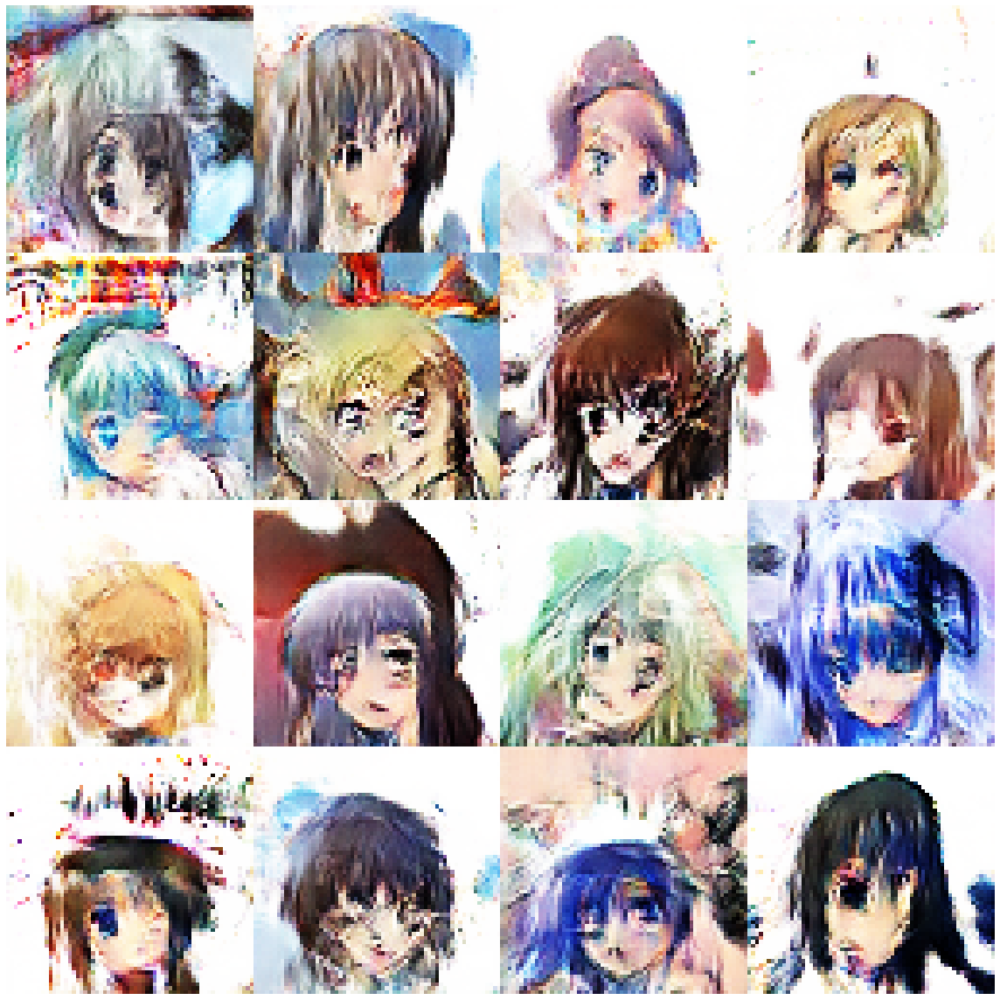

Disc: real loss: 0.427847 fake loss: 0.388759
GAN loss: 2.392666
Step 6700 completed. Time took: 1 secs.
Begin step:  6701
Disc: real loss: 0.327416 fake loss: 0.351198
GAN loss: 2.453695
Step 6701 completed. Time took: 0 secs.
Begin step:  6702
Disc: real loss: 0.334942 fake loss: 0.350052
GAN loss: 2.035747
Step 6702 completed. Time took: 0 secs.
Begin step:  6703
Disc: real loss: 0.331672 fake loss: 0.354806
GAN loss: 2.329289
Step 6703 completed. Time took: 0 secs.
Begin step:  6704
Disc: real loss: 0.366063 fake loss: 0.354974
GAN loss: 2.338607
Step 6704 completed. Time took: 0 secs.
Begin step:  6705
Disc: real loss: 0.331514 fake loss: 0.374245
GAN loss: 2.327350
Step 6705 completed. Time took: 0 secs.
Begin step:  6706
Disc: real loss: 0.358754 fake loss: 0.523198
GAN loss: 3.807549
Step 6706 completed. Time took: 0 secs.
Begin step:  6707
Disc: real loss: 0.529751 fake loss: 0.334492
GAN loss: 1.533476
Step 6707 completed. Time took: 0 secs.
Begin step:  6708
Disc: real loss:

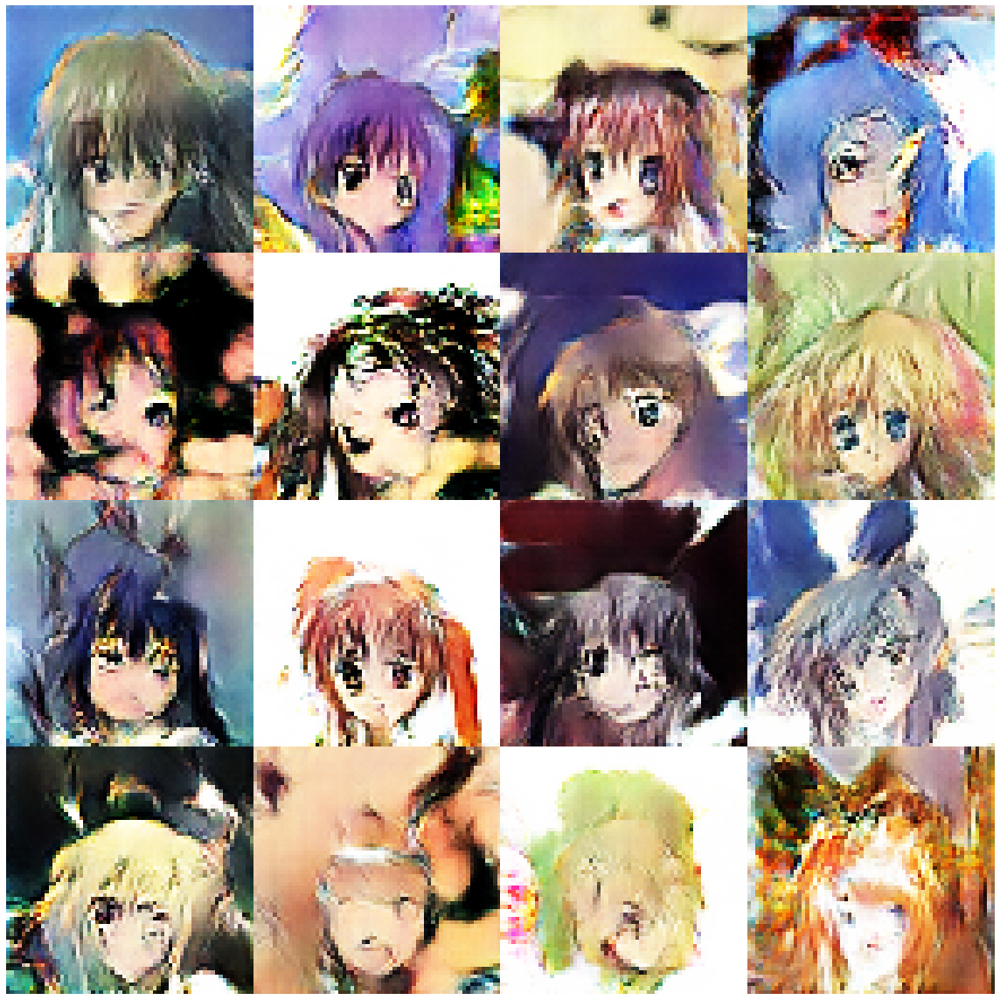

Disc: real loss: 0.329528 fake loss: 0.375332
GAN loss: 2.388631
Step 6800 completed. Time took: 1 secs.
Begin step:  6801
Disc: real loss: 0.367772 fake loss: 0.347170
GAN loss: 2.181681
Step 6801 completed. Time took: 0 secs.
Begin step:  6802
Disc: real loss: 0.361153 fake loss: 0.387564
GAN loss: 2.847921
Step 6802 completed. Time took: 0 secs.
Begin step:  6803
Disc: real loss: 0.370555 fake loss: 0.363616
GAN loss: 2.592065
Step 6803 completed. Time took: 0 secs.
Begin step:  6804
Disc: real loss: 0.337954 fake loss: 0.353778
GAN loss: 2.276144
Step 6804 completed. Time took: 0 secs.
Begin step:  6805
Disc: real loss: 0.343005 fake loss: 0.345742
GAN loss: 1.939537
Step 6805 completed. Time took: 0 secs.
Begin step:  6806
Disc: real loss: 0.355443 fake loss: 0.425636
GAN loss: 3.079558
Step 6806 completed. Time took: 0 secs.
Begin step:  6807
Disc: real loss: 0.391983 fake loss: 0.332064
GAN loss: 1.979914
Step 6807 completed. Time took: 0 secs.
Begin step:  6808
Disc: real loss:

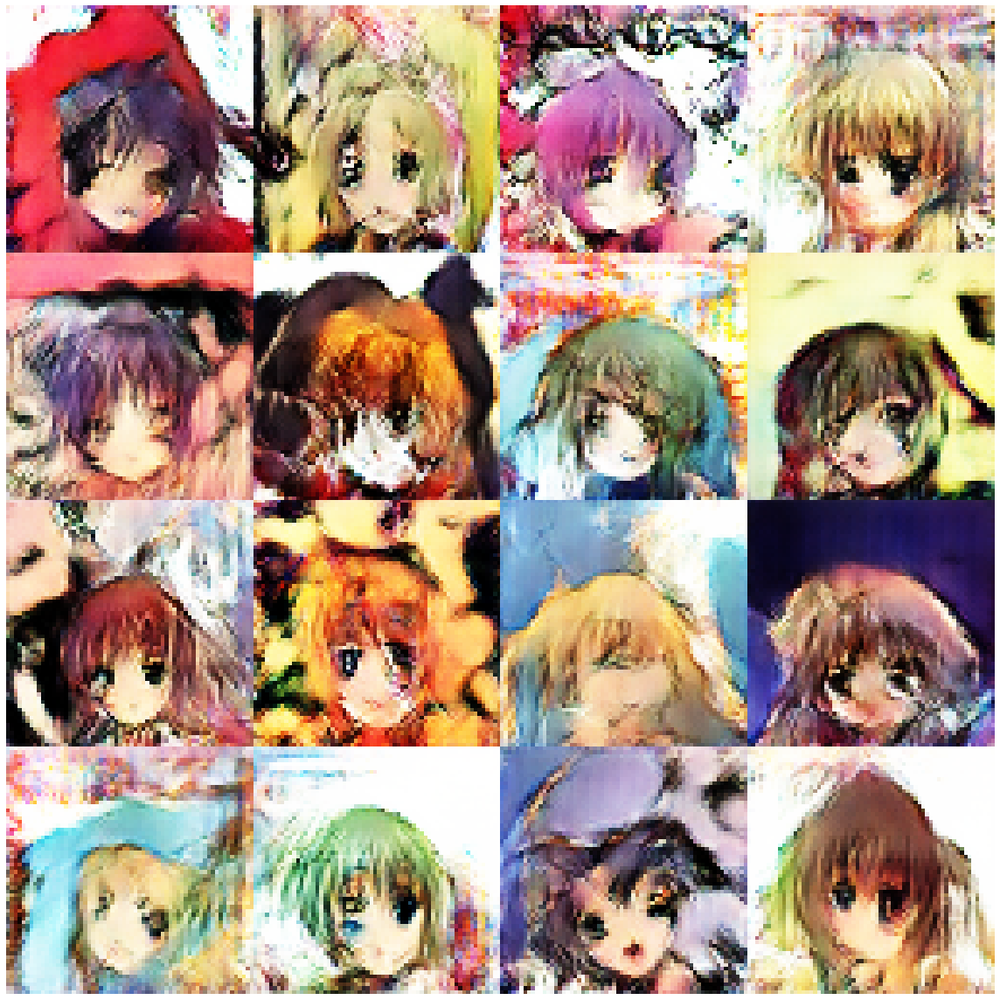

Disc: real loss: 0.329803 fake loss: 0.366806
GAN loss: 2.380114
Step 6900 completed. Time took: 1 secs.
Begin step:  6901
Disc: real loss: 0.364102 fake loss: 0.344890
GAN loss: 2.485044
Step 6901 completed. Time took: 0 secs.
Begin step:  6902
Disc: real loss: 0.378105 fake loss: 0.378156
GAN loss: 2.563910
Step 6902 completed. Time took: 0 secs.
Begin step:  6903
Disc: real loss: 0.399071 fake loss: 0.376020
GAN loss: 2.403634
Step 6903 completed. Time took: 0 secs.
Begin step:  6904
Disc: real loss: 0.352167 fake loss: 0.380061
GAN loss: 1.751762
Step 6904 completed. Time took: 0 secs.
Begin step:  6905
Disc: real loss: 0.356548 fake loss: 0.388949
GAN loss: 2.521795
Step 6905 completed. Time took: 0 secs.
Begin step:  6906
Disc: real loss: 0.415056 fake loss: 0.390739
GAN loss: 2.433017
Step 6906 completed. Time took: 0 secs.
Begin step:  6907
Disc: real loss: 0.375343 fake loss: 0.340296
GAN loss: 2.191308
Step 6907 completed. Time took: 0 secs.
Begin step:  6908
Disc: real loss:

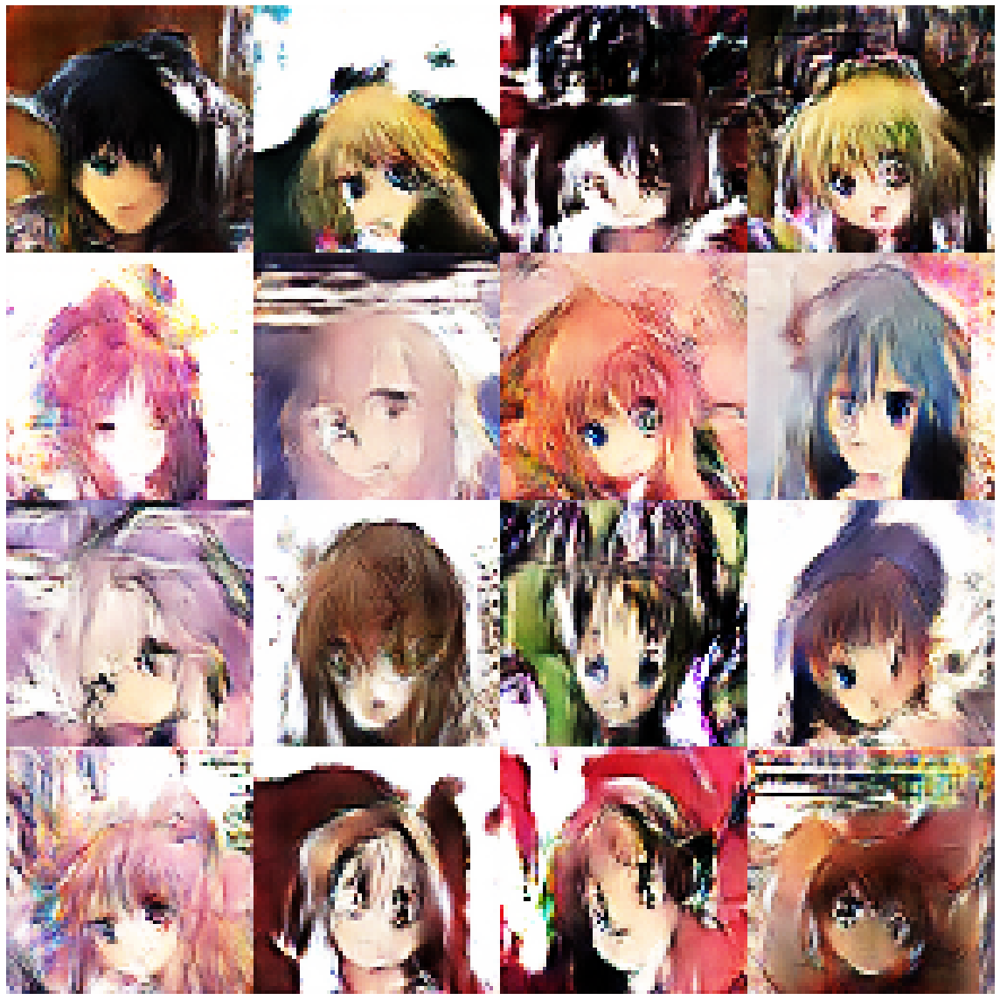

Begin step:  7000


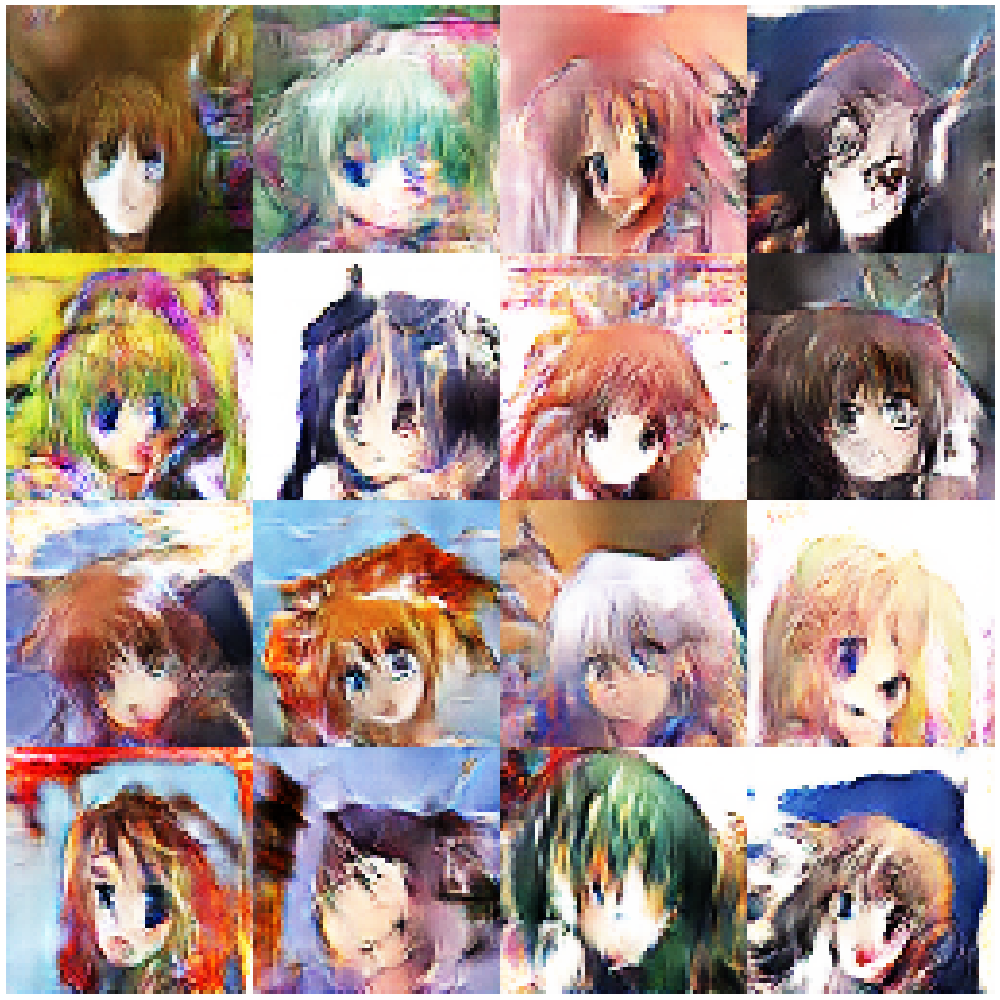

Disc: real loss: 0.359013 fake loss: 0.560290
GAN loss: 3.833695
Step 7000 completed. Time took: 1 secs.
Begin step:  7001
Disc: real loss: 0.775559 fake loss: 0.523420
GAN loss: 2.862884
Step 7001 completed. Time took: 0 secs.
Begin step:  7002
Disc: real loss: 0.347761 fake loss: 0.431516
GAN loss: 2.549460
Step 7002 completed. Time took: 0 secs.
Begin step:  7003
Disc: real loss: 0.359591 fake loss: 0.347772
GAN loss: 2.065925
Step 7003 completed. Time took: 0 secs.
Begin step:  7004
Disc: real loss: 0.376853 fake loss: 0.770888
GAN loss: 5.407752
Step 7004 completed. Time took: 0 secs.
Begin step:  7005
Disc: real loss: 1.449003 fake loss: 0.917514
GAN loss: 4.759031
Step 7005 completed. Time took: 0 secs.
Begin step:  7006
Disc: real loss: 1.236985 fake loss: 1.173312
GAN loss: 3.513187
Step 7006 completed. Time took: 0 secs.
Begin step:  7007
Disc: real loss: 0.382664 fake loss: 0.473721
GAN loss: 3.323135
Step 7007 completed. Time took: 0 secs.
Begin step:  7008
Disc: real loss:

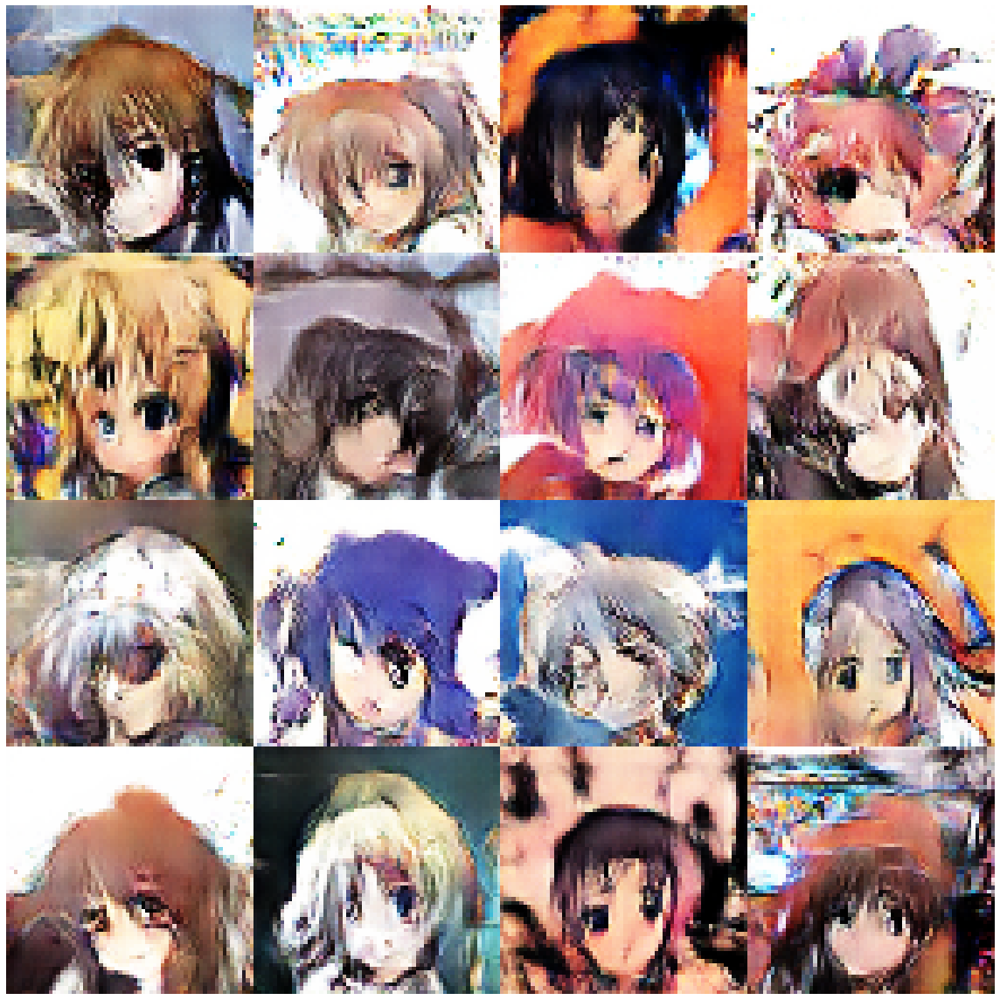

Disc: real loss: 0.341906 fake loss: 0.385117
GAN loss: 2.926239
Step 7100 completed. Time took: 1 secs.
Begin step:  7101
Disc: real loss: 0.379429 fake loss: 0.362910
GAN loss: 1.878604
Step 7101 completed. Time took: 0 secs.
Begin step:  7102
Disc: real loss: 0.360631 fake loss: 0.408679
GAN loss: 3.312125
Step 7102 completed. Time took: 0 secs.
Begin step:  7103
Disc: real loss: 0.447141 fake loss: 0.348095
GAN loss: 1.821074
Step 7103 completed. Time took: 0 secs.
Begin step:  7104
Disc: real loss: 0.342420 fake loss: 0.384643
GAN loss: 2.964425
Step 7104 completed. Time took: 0 secs.
Begin step:  7105
Disc: real loss: 0.367302 fake loss: 0.348037
GAN loss: 2.231082
Step 7105 completed. Time took: 0 secs.
Begin step:  7106
Disc: real loss: 0.340871 fake loss: 0.415738
GAN loss: 3.079010
Step 7106 completed. Time took: 0 secs.
Begin step:  7107
Disc: real loss: 0.394564 fake loss: 0.357111
GAN loss: 2.210402
Step 7107 completed. Time took: 0 secs.
Begin step:  7108
Disc: real loss:

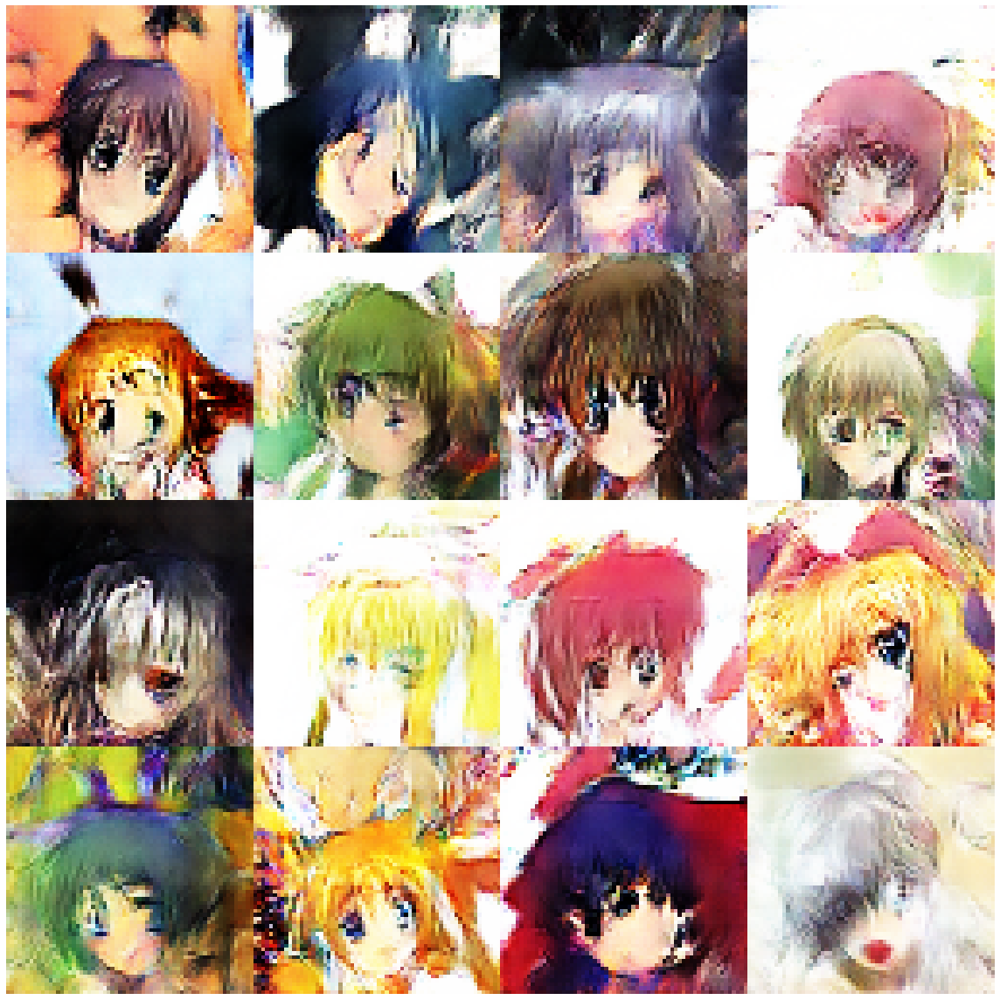

Disc: real loss: 0.364580 fake loss: 0.328284
GAN loss: 2.331929
Step 7200 completed. Time took: 1 secs.
Begin step:  7201
Disc: real loss: 0.335599 fake loss: 0.350076
GAN loss: 1.811496
Step 7201 completed. Time took: 0 secs.
Begin step:  7202
Disc: real loss: 0.346582 fake loss: 0.357113
GAN loss: 2.288294
Step 7202 completed. Time took: 0 secs.
Begin step:  7203
Disc: real loss: 0.359988 fake loss: 0.357086
GAN loss: 2.168542
Step 7203 completed. Time took: 0 secs.
Begin step:  7204
Disc: real loss: 0.348444 fake loss: 0.345166
GAN loss: 2.301311
Step 7204 completed. Time took: 0 secs.
Begin step:  7205
Disc: real loss: 0.352205 fake loss: 0.386499
GAN loss: 2.839142
Step 7205 completed. Time took: 0 secs.
Begin step:  7206
Disc: real loss: 0.397899 fake loss: 0.373708
GAN loss: 2.356399
Step 7206 completed. Time took: 0 secs.
Begin step:  7207
Disc: real loss: 0.326859 fake loss: 0.351852
GAN loss: 2.375324
Step 7207 completed. Time took: 0 secs.
Begin step:  7208
Disc: real loss:

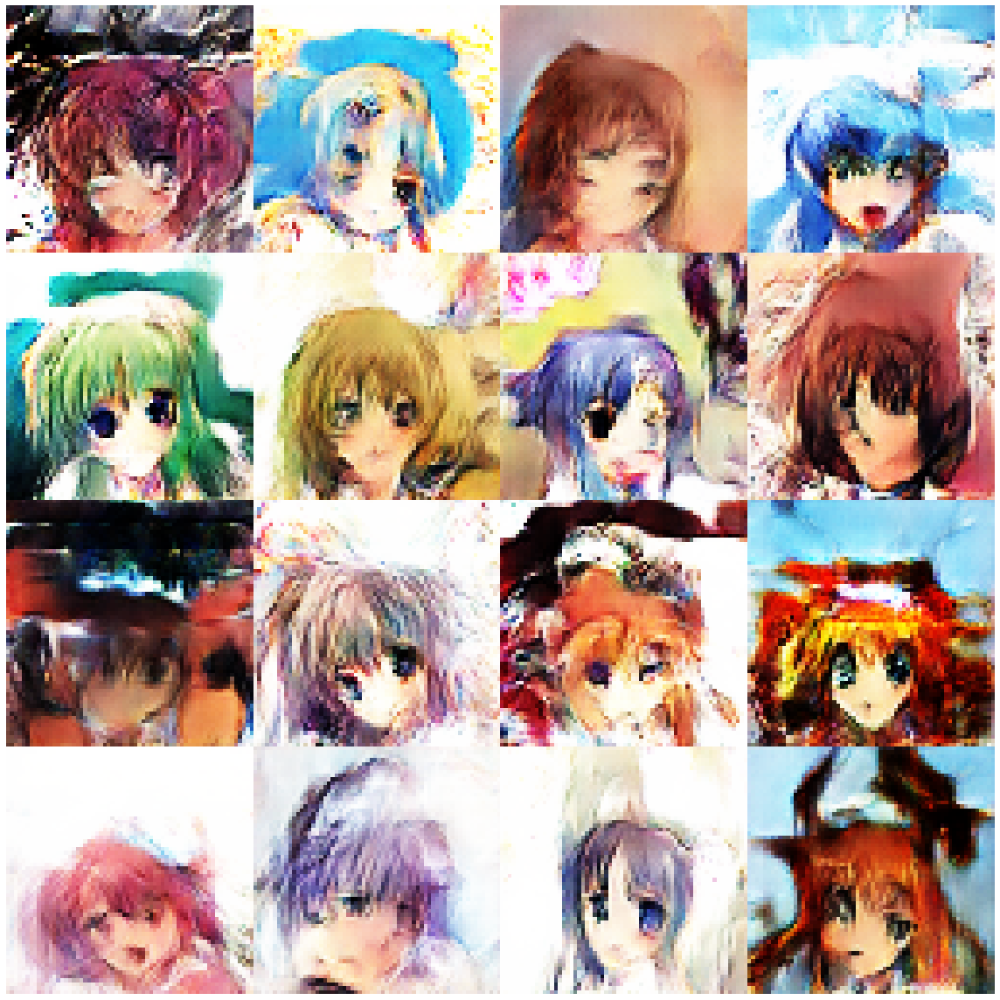

Disc: real loss: 0.327984 fake loss: 0.375340
GAN loss: 2.226348
Step 7300 completed. Time took: 1 secs.
Begin step:  7301
Disc: real loss: 0.371674 fake loss: 0.359552
GAN loss: 2.495877
Step 7301 completed. Time took: 0 secs.
Begin step:  7302
Disc: real loss: 0.360368 fake loss: 0.353008
GAN loss: 2.379295
Step 7302 completed. Time took: 0 secs.
Begin step:  7303
Disc: real loss: 0.356262 fake loss: 0.339543
GAN loss: 2.198639
Step 7303 completed. Time took: 0 secs.
Begin step:  7304
Disc: real loss: 0.331977 fake loss: 0.343305
GAN loss: 2.219282
Step 7304 completed. Time took: 0 secs.
Begin step:  7305
Disc: real loss: 0.359169 fake loss: 0.423945
GAN loss: 2.901482
Step 7305 completed. Time took: 0 secs.
Begin step:  7306
Disc: real loss: 0.431866 fake loss: 0.355550
GAN loss: 2.243527
Step 7306 completed. Time took: 0 secs.
Begin step:  7307
Disc: real loss: 0.337096 fake loss: 0.354596
GAN loss: 2.186201
Step 7307 completed. Time took: 0 secs.
Begin step:  7308
Disc: real loss:

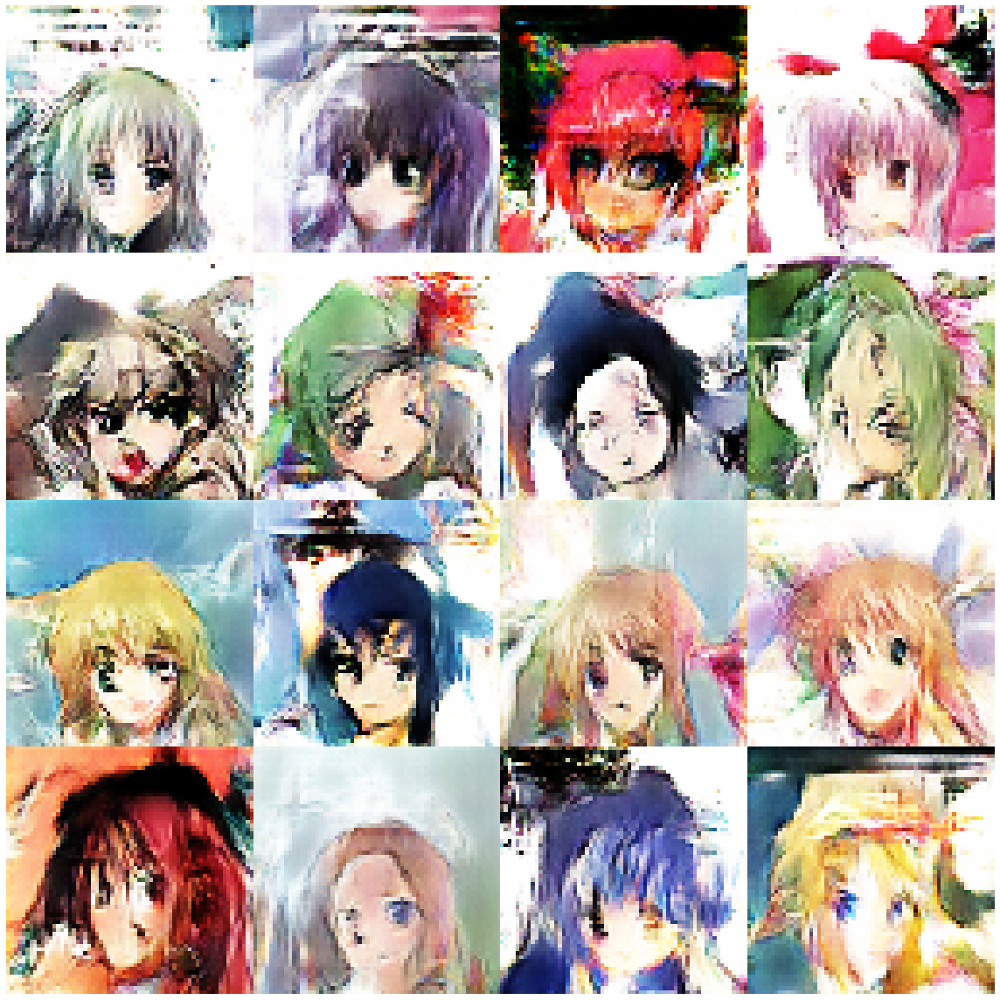

Disc: real loss: 0.349401 fake loss: 0.441288
GAN loss: 3.657024
Step 7400 completed. Time took: 1 secs.
Begin step:  7401
Disc: real loss: 0.466321 fake loss: 0.347466
GAN loss: 1.755130
Step 7401 completed. Time took: 0 secs.
Begin step:  7402
Disc: real loss: 0.375823 fake loss: 0.338812
GAN loss: 2.395178
Step 7402 completed. Time took: 0 secs.
Begin step:  7403
Disc: real loss: 0.347929 fake loss: 0.339530
GAN loss: 1.953584
Step 7403 completed. Time took: 0 secs.
Begin step:  7404
Disc: real loss: 0.357871 fake loss: 0.507252
GAN loss: 4.368587
Step 7404 completed. Time took: 0 secs.
Begin step:  7405
Disc: real loss: 0.685614 fake loss: 0.410662
GAN loss: 2.456955
Step 7405 completed. Time took: 0 secs.
Begin step:  7406
Disc: real loss: 0.359670 fake loss: 0.397286
GAN loss: 1.916441
Step 7406 completed. Time took: 0 secs.
Begin step:  7407
Disc: real loss: 0.369963 fake loss: 0.526962
GAN loss: 4.318480
Step 7407 completed. Time took: 0 secs.
Begin step:  7408
Disc: real loss:

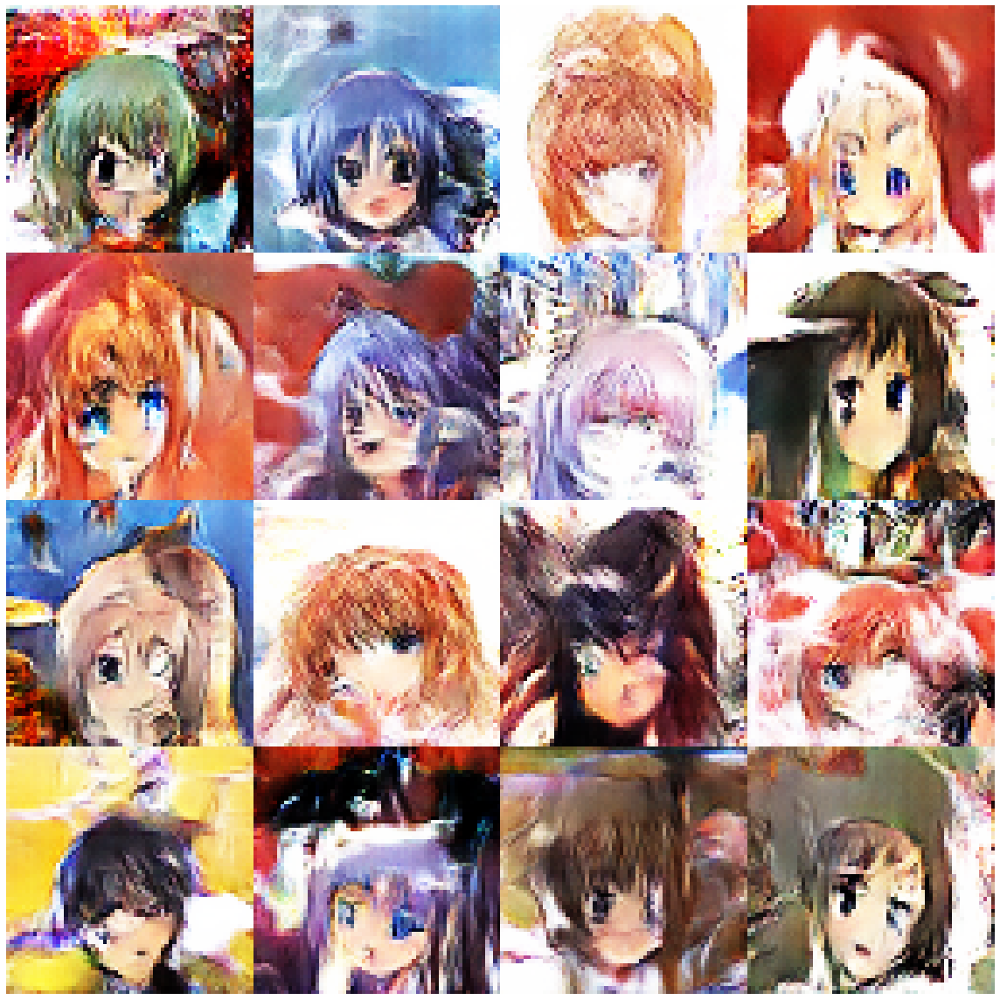

Begin step:  7500


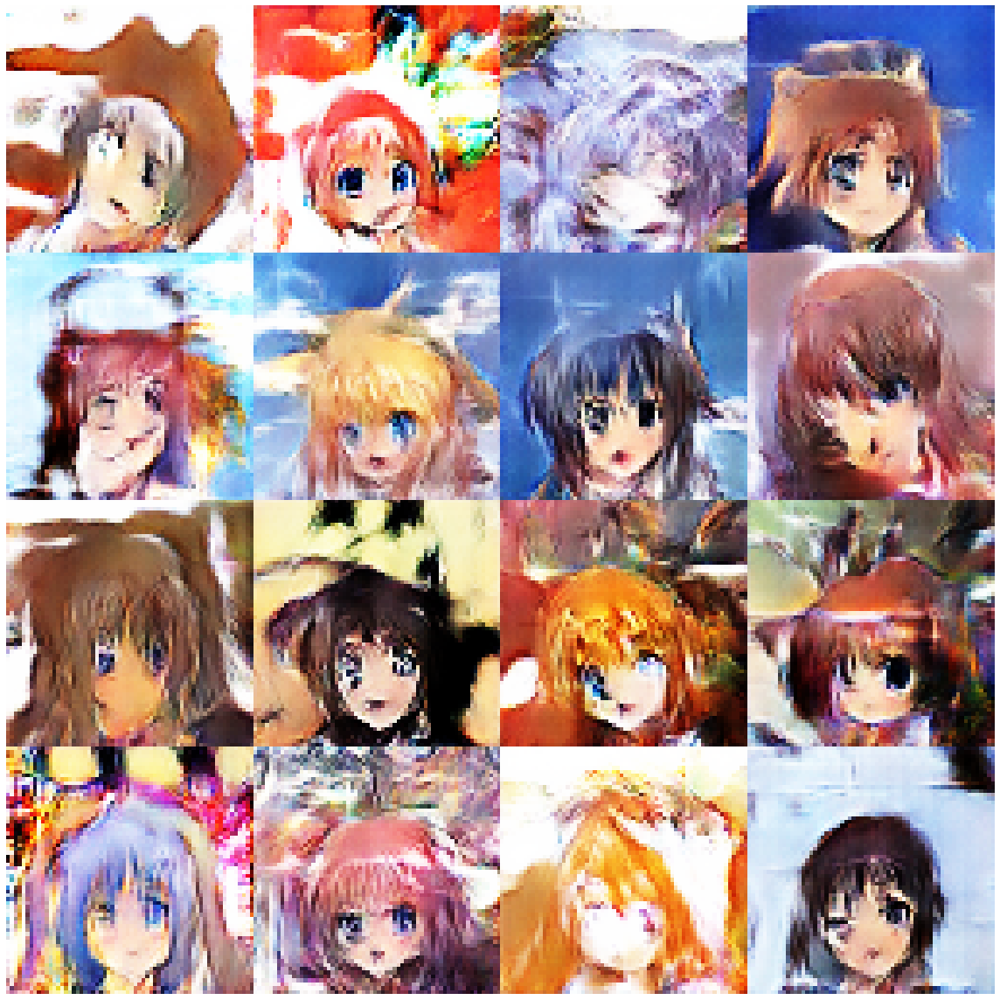

Disc: real loss: 0.408865 fake loss: 0.409666
GAN loss: 2.204149
Step 7500 completed. Time took: 1 secs.
Begin step:  7501
Disc: real loss: 0.356281 fake loss: 0.341021
GAN loss: 2.488608
Step 7501 completed. Time took: 0 secs.
Begin step:  7502
Disc: real loss: 0.413655 fake loss: 0.374977
GAN loss: 2.032060
Step 7502 completed. Time took: 0 secs.
Begin step:  7503
Disc: real loss: 0.371312 fake loss: 0.356296
GAN loss: 2.485129
Step 7503 completed. Time took: 0 secs.
Begin step:  7504
Disc: real loss: 0.362119 fake loss: 0.341837
GAN loss: 2.172955
Step 7504 completed. Time took: 0 secs.
Begin step:  7505
Disc: real loss: 0.355335 fake loss: 0.343798
GAN loss: 2.382844
Step 7505 completed. Time took: 0 secs.
Begin step:  7506
Disc: real loss: 0.393433 fake loss: 0.438036
GAN loss: 2.681993
Step 7506 completed. Time took: 0 secs.
Begin step:  7507
Disc: real loss: 0.381232 fake loss: 0.366682
GAN loss: 2.519122
Step 7507 completed. Time took: 0 secs.
Begin step:  7508
Disc: real loss:

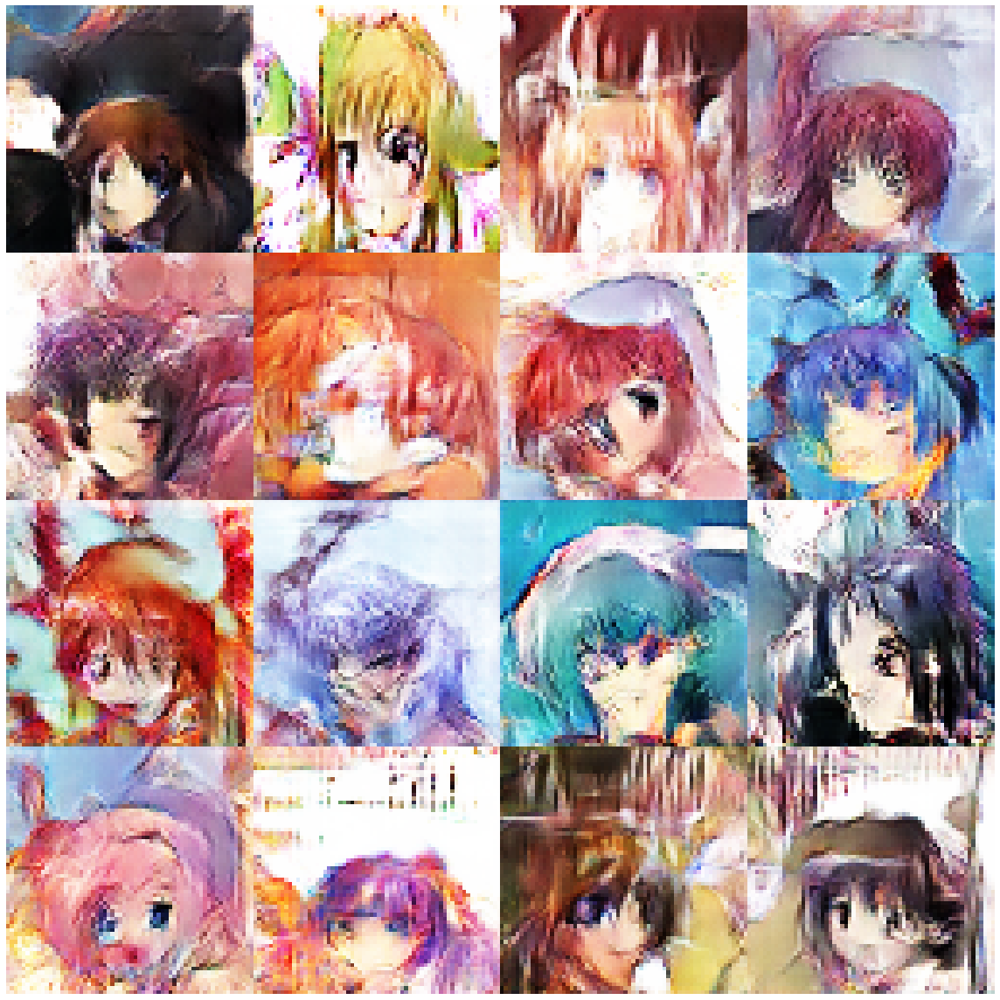

Disc: real loss: 0.349811 fake loss: 0.395189
GAN loss: 2.626462
Step 7600 completed. Time took: 1 secs.
Begin step:  7601
Disc: real loss: 0.348680 fake loss: 0.361075
GAN loss: 1.989285
Step 7601 completed. Time took: 0 secs.
Begin step:  7602
Disc: real loss: 0.347300 fake loss: 0.374144
GAN loss: 2.342697
Step 7602 completed. Time took: 0 secs.
Begin step:  7603
Disc: real loss: 0.322840 fake loss: 0.327506
GAN loss: 2.539049
Step 7603 completed. Time took: 0 secs.
Begin step:  7604
Disc: real loss: 0.374297 fake loss: 0.437319
GAN loss: 2.802352
Step 7604 completed. Time took: 0 secs.
Begin step:  7605
Disc: real loss: 0.366518 fake loss: 0.343524
GAN loss: 2.328914
Step 7605 completed. Time took: 0 secs.
Begin step:  7606
Disc: real loss: 0.323330 fake loss: 0.409874
GAN loss: 3.010944
Step 7606 completed. Time took: 0 secs.
Begin step:  7607
Disc: real loss: 0.388505 fake loss: 0.340138
GAN loss: 2.088175
Step 7607 completed. Time took: 0 secs.
Begin step:  7608
Disc: real loss:

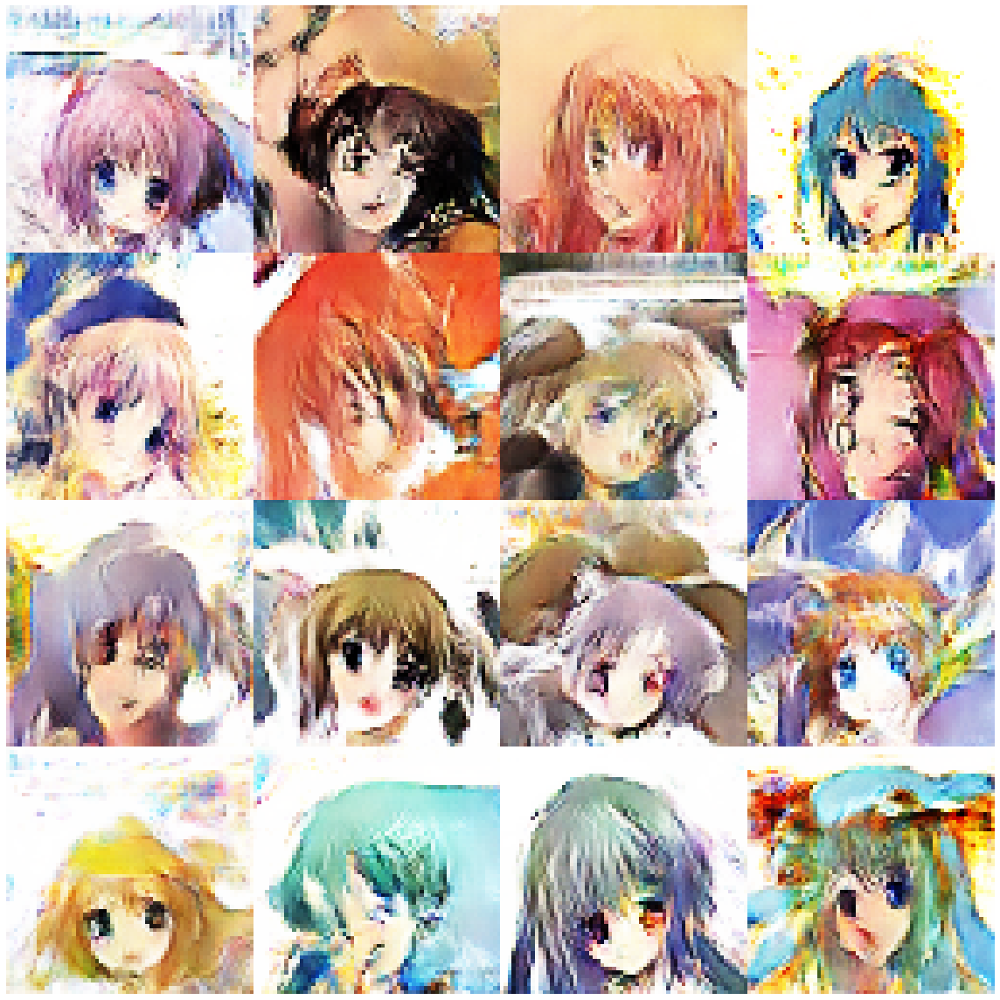

Disc: real loss: 0.337093 fake loss: 0.356839
GAN loss: 2.115316
Step 7700 completed. Time took: 1 secs.
Begin step:  7701
Disc: real loss: 0.342719 fake loss: 0.340077
GAN loss: 2.183986
Step 7701 completed. Time took: 0 secs.
Begin step:  7702
Disc: real loss: 0.408411 fake loss: 0.620643
GAN loss: 4.079457
Step 7702 completed. Time took: 0 secs.
Begin step:  7703
Disc: real loss: 0.668942 fake loss: 0.379919
GAN loss: 1.718962
Step 7703 completed. Time took: 0 secs.
Begin step:  7704
Disc: real loss: 0.343627 fake loss: 0.348684
GAN loss: 2.636401
Step 7704 completed. Time took: 0 secs.
Begin step:  7705
Disc: real loss: 0.375968 fake loss: 0.370503
GAN loss: 2.802804
Step 7705 completed. Time took: 0 secs.
Begin step:  7706
Disc: real loss: 0.396996 fake loss: 0.362142
GAN loss: 2.181112
Step 7706 completed. Time took: 0 secs.
Begin step:  7707
Disc: real loss: 0.345768 fake loss: 0.371917
GAN loss: 2.404388
Step 7707 completed. Time took: 0 secs.
Begin step:  7708
Disc: real loss:

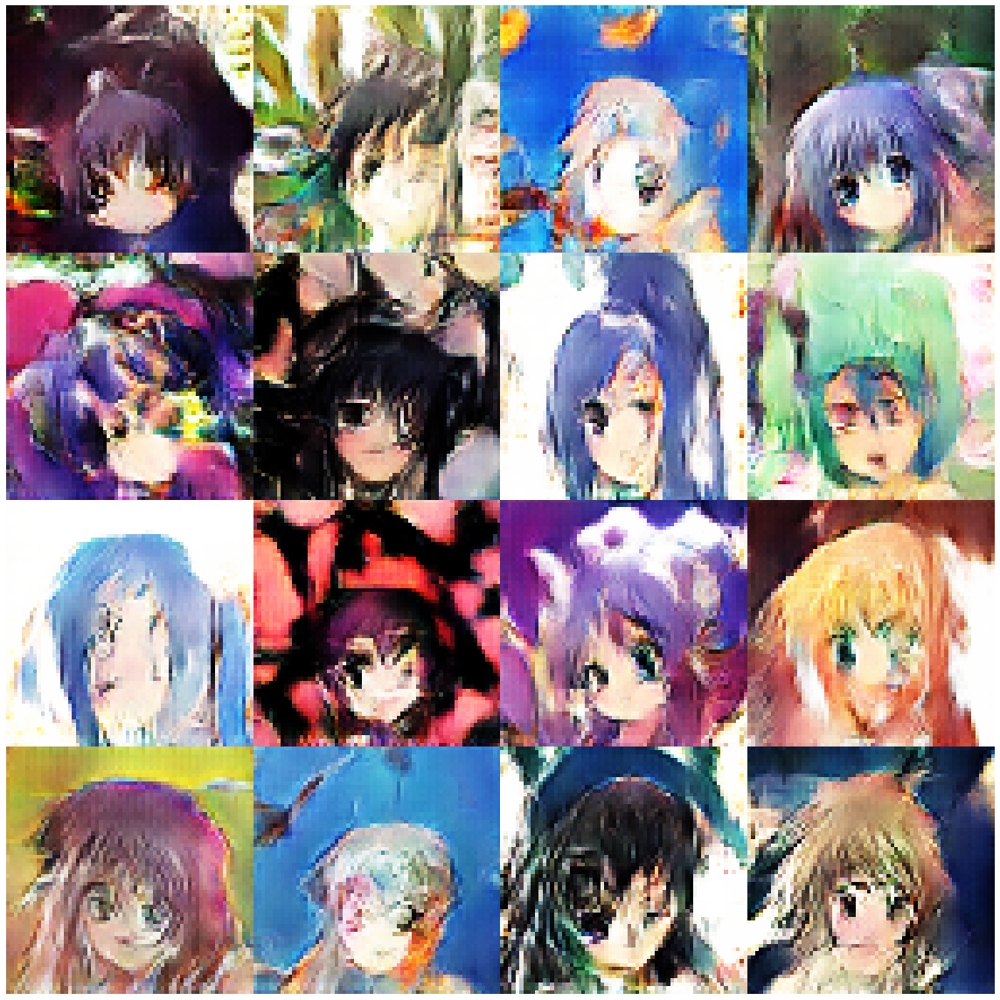

Disc: real loss: 0.338688 fake loss: 0.387599
GAN loss: 2.488910
Step 7800 completed. Time took: 1 secs.
Begin step:  7801
Disc: real loss: 0.391401 fake loss: 0.457817
GAN loss: 2.885429
Step 7801 completed. Time took: 0 secs.
Begin step:  7802
Disc: real loss: 0.408947 fake loss: 0.354910
GAN loss: 1.865450
Step 7802 completed. Time took: 0 secs.
Begin step:  7803
Disc: real loss: 0.348220 fake loss: 0.344594
GAN loss: 2.677286
Step 7803 completed. Time took: 0 secs.
Begin step:  7804
Disc: real loss: 0.355618 fake loss: 0.357534
GAN loss: 2.009595
Step 7804 completed. Time took: 0 secs.
Begin step:  7805
Disc: real loss: 0.327481 fake loss: 0.374124
GAN loss: 3.393444
Step 7805 completed. Time took: 0 secs.
Begin step:  7806
Disc: real loss: 0.468928 fake loss: 0.371504
GAN loss: 2.346845
Step 7806 completed. Time took: 0 secs.
Begin step:  7807
Disc: real loss: 0.371033 fake loss: 0.357997
GAN loss: 2.769597
Step 7807 completed. Time took: 0 secs.
Begin step:  7808
Disc: real loss:

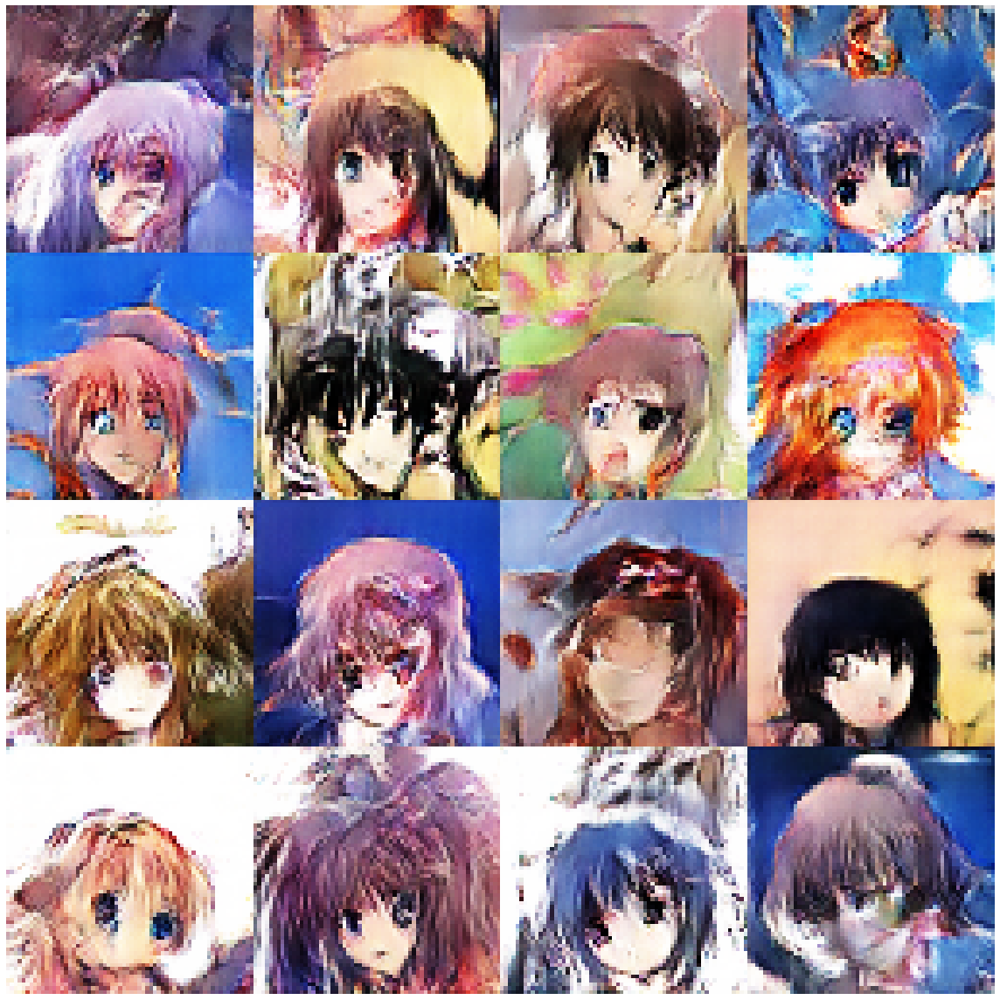

Disc: real loss: 0.345606 fake loss: 0.331744
GAN loss: 2.381284
Step 7900 completed. Time took: 1 secs.
Begin step:  7901
Disc: real loss: 0.356168 fake loss: 0.362659
GAN loss: 2.288737
Step 7901 completed. Time took: 0 secs.
Begin step:  7902
Disc: real loss: 0.356174 fake loss: 0.394106
GAN loss: 2.787955
Step 7902 completed. Time took: 0 secs.
Begin step:  7903
Disc: real loss: 0.390303 fake loss: 0.350161
GAN loss: 1.713134
Step 7903 completed. Time took: 0 secs.
Begin step:  7904
Disc: real loss: 0.358663 fake loss: 0.346362
GAN loss: 2.683053
Step 7904 completed. Time took: 0 secs.
Begin step:  7905
Disc: real loss: 0.356630 fake loss: 0.346404
GAN loss: 2.450705
Step 7905 completed. Time took: 0 secs.
Begin step:  7906
Disc: real loss: 0.334572 fake loss: 0.336993
GAN loss: 2.071632
Step 7906 completed. Time took: 0 secs.
Begin step:  7907
Disc: real loss: 0.338772 fake loss: 0.385672
GAN loss: 2.887042
Step 7907 completed. Time took: 0 secs.
Begin step:  7908
Disc: real loss:

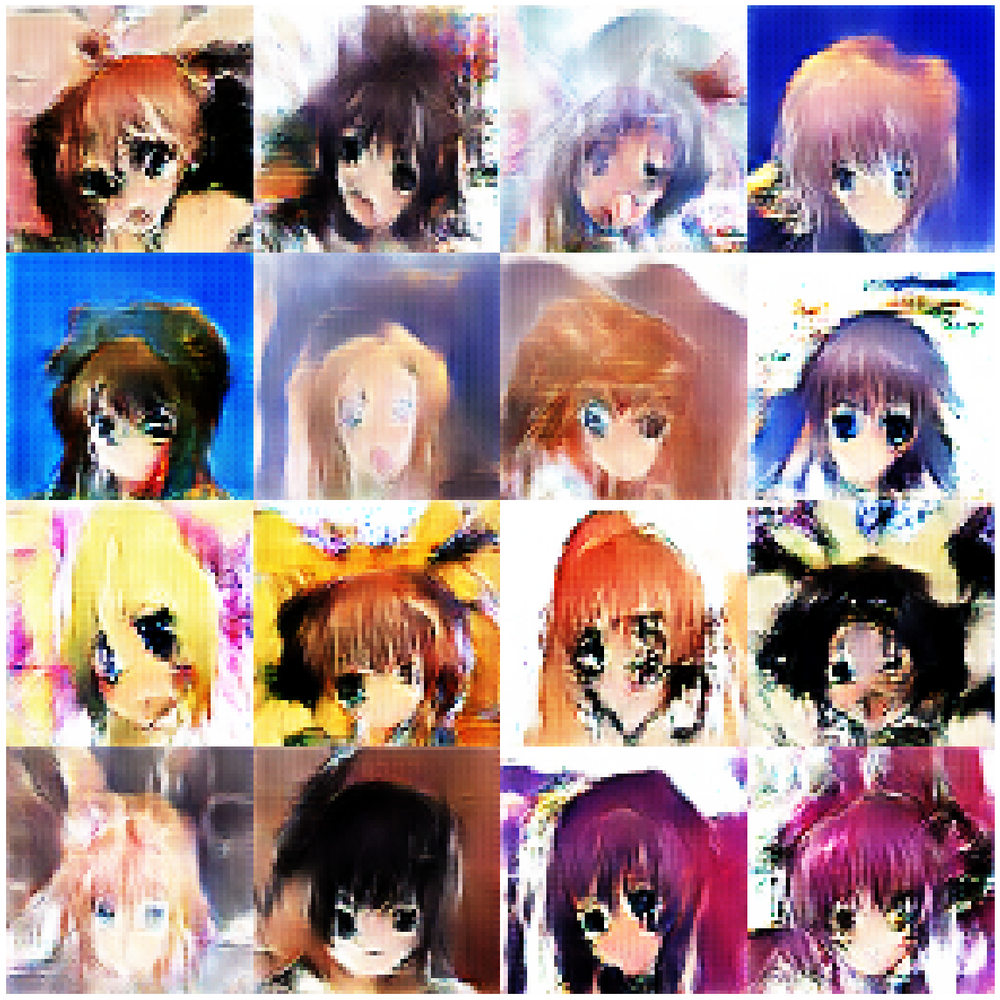

Begin step:  8000


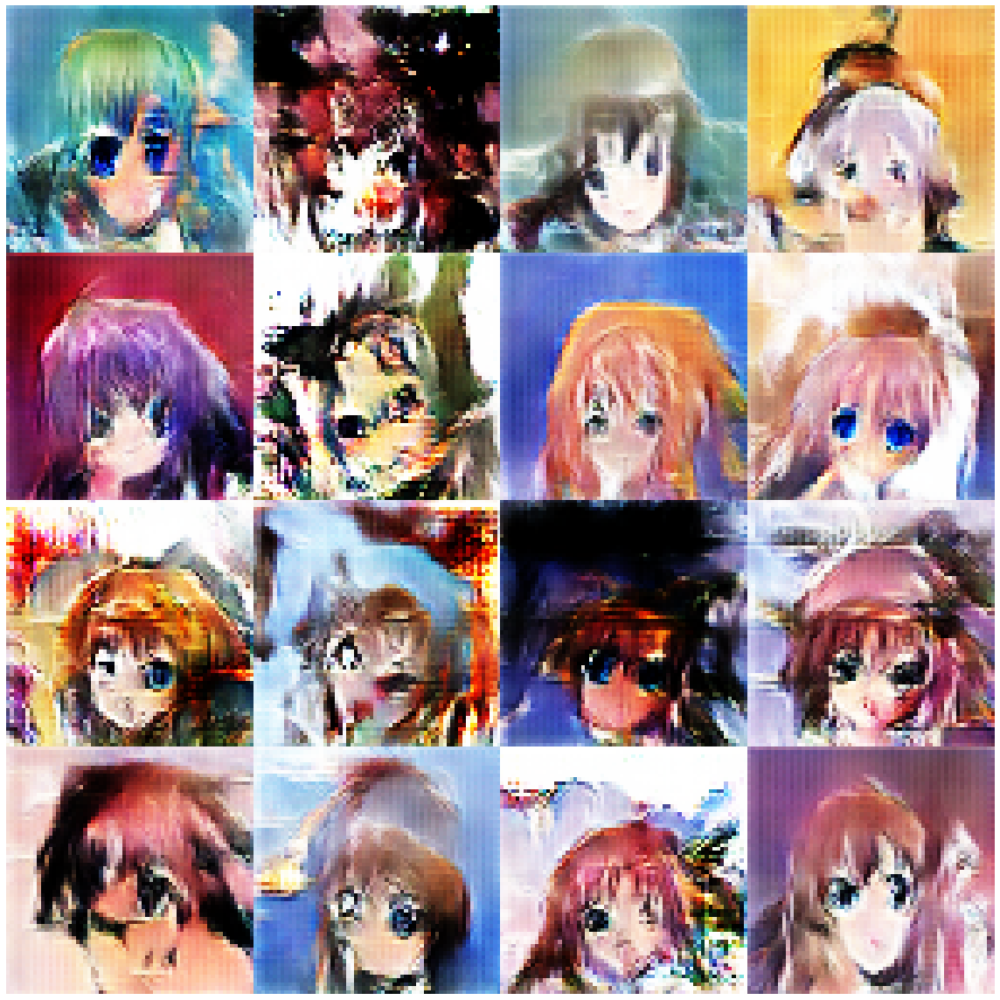

Disc: real loss: 0.520263 fake loss: 0.554226
GAN loss: 2.228954
Step 8000 completed. Time took: 1 secs.
Begin step:  8001
Disc: real loss: 0.612104 fake loss: 0.558274
GAN loss: 2.346722
Step 8001 completed. Time took: 0 secs.
Begin step:  8002
Disc: real loss: 0.658868 fake loss: 0.641338
GAN loss: 2.555569
Step 8002 completed. Time took: 0 secs.
Begin step:  8003
Disc: real loss: 0.475785 fake loss: 0.425774
GAN loss: 2.486913
Step 8003 completed. Time took: 0 secs.
Begin step:  8004
Disc: real loss: 0.586929 fake loss: 1.084464
GAN loss: 4.119775
Step 8004 completed. Time took: 0 secs.
Begin step:  8005
Disc: real loss: 1.204567 fake loss: 0.452311
GAN loss: 1.575484
Step 8005 completed. Time took: 0 secs.
Begin step:  8006
Disc: real loss: 0.381336 fake loss: 0.527431
GAN loss: 1.977355
Step 8006 completed. Time took: 0 secs.
Begin step:  8007
Disc: real loss: 0.444797 fake loss: 0.433188
GAN loss: 1.949533
Step 8007 completed. Time took: 0 secs.
Begin step:  8008
Disc: real loss:

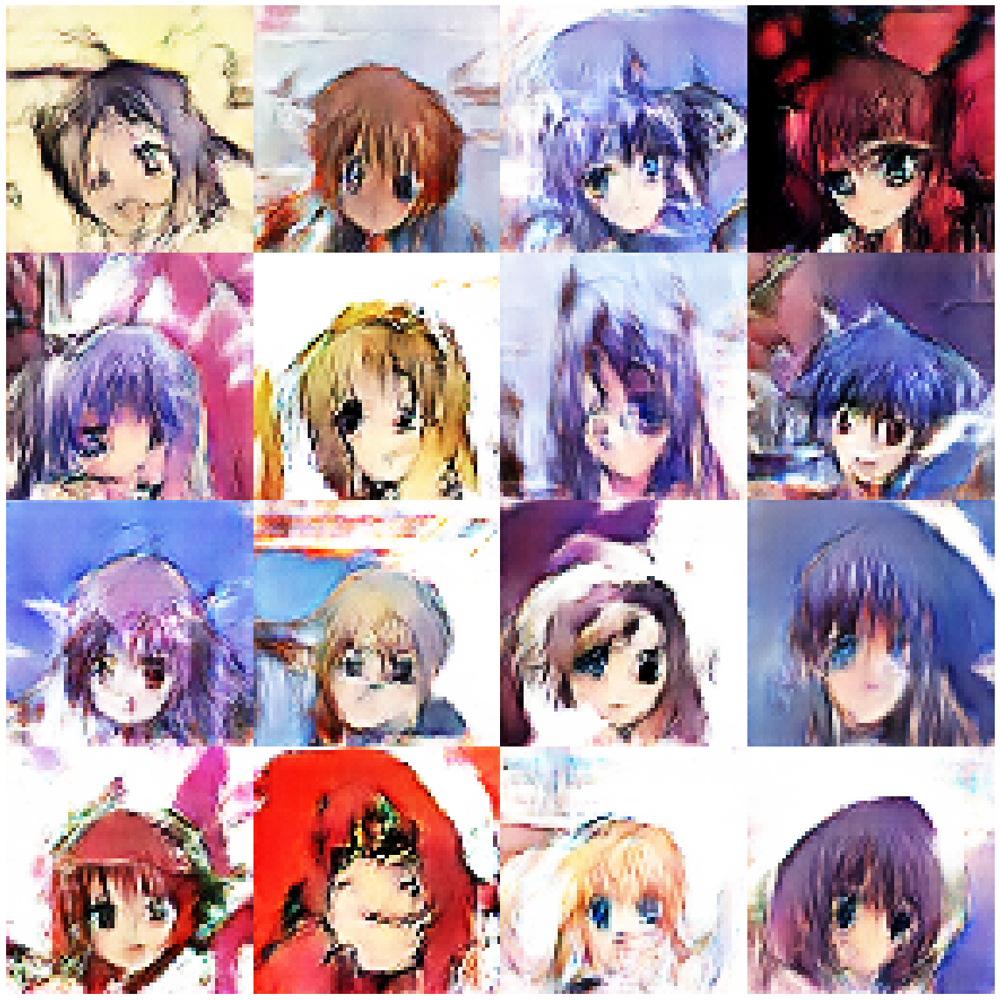

Disc: real loss: 0.348091 fake loss: 0.403749
GAN loss: 2.299444
Step 8100 completed. Time took: 1 secs.
Begin step:  8101
Disc: real loss: 0.339277 fake loss: 0.323897
GAN loss: 2.708538
Step 8101 completed. Time took: 0 secs.
Begin step:  8102
Disc: real loss: 0.362157 fake loss: 0.344641
GAN loss: 2.176472
Step 8102 completed. Time took: 0 secs.
Begin step:  8103
Disc: real loss: 0.354485 fake loss: 0.347599
GAN loss: 2.501542
Step 8103 completed. Time took: 0 secs.
Begin step:  8104
Disc: real loss: 0.417241 fake loss: 0.437600
GAN loss: 2.256724
Step 8104 completed. Time took: 0 secs.
Begin step:  8105
Disc: real loss: 0.389093 fake loss: 0.365185
GAN loss: 2.351571
Step 8105 completed. Time took: 0 secs.
Begin step:  8106
Disc: real loss: 0.348800 fake loss: 0.373715
GAN loss: 2.185121
Step 8106 completed. Time took: 0 secs.
Begin step:  8107
Disc: real loss: 0.328920 fake loss: 0.375553
GAN loss: 2.209072
Step 8107 completed. Time took: 0 secs.
Begin step:  8108
Disc: real loss:

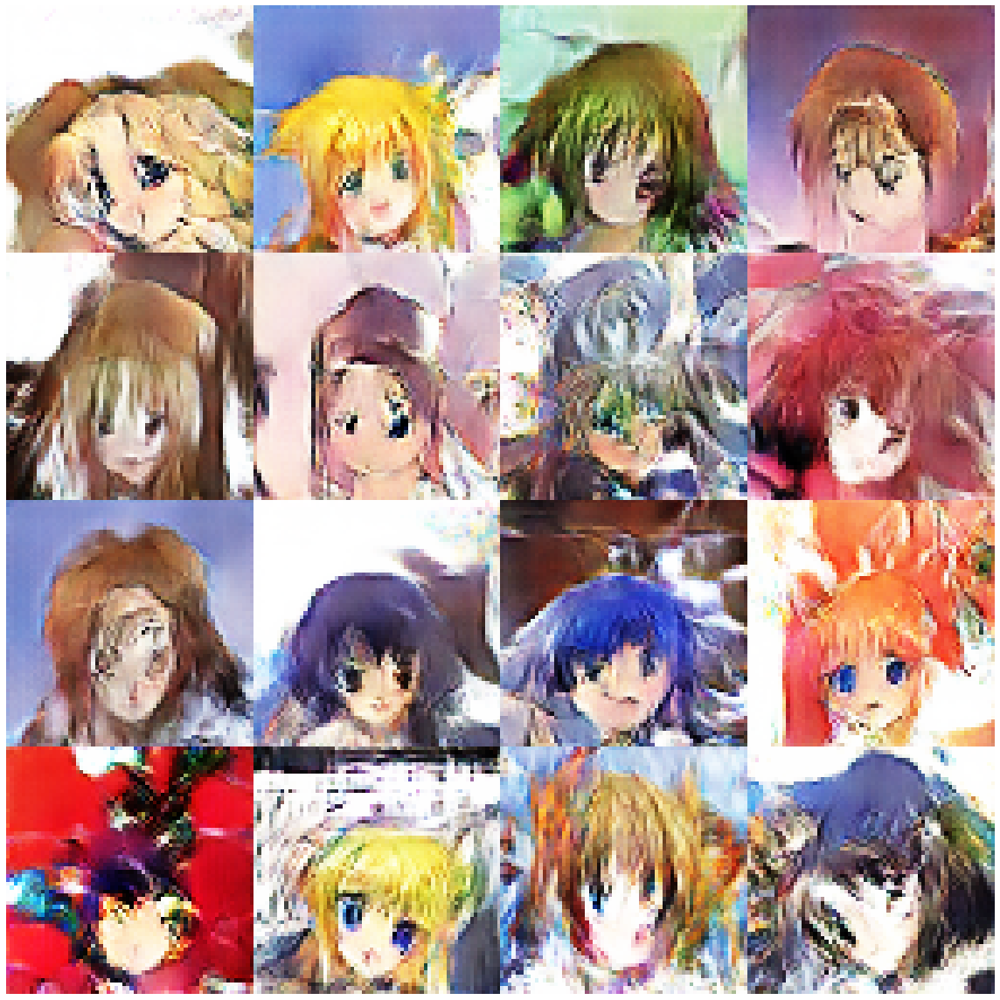

Disc: real loss: 0.349733 fake loss: 0.443821
GAN loss: 3.398068
Step 8200 completed. Time took: 1 secs.
Begin step:  8201
Disc: real loss: 0.403430 fake loss: 0.346453
GAN loss: 1.771531
Step 8201 completed. Time took: 0 secs.
Begin step:  8202
Disc: real loss: 0.336973 fake loss: 0.473921
GAN loss: 3.511620
Step 8202 completed. Time took: 0 secs.
Begin step:  8203
Disc: real loss: 0.436448 fake loss: 0.358211
GAN loss: 1.809546
Step 8203 completed. Time took: 0 secs.
Begin step:  8204
Disc: real loss: 0.358466 fake loss: 0.425269
GAN loss: 2.633834
Step 8204 completed. Time took: 0 secs.
Begin step:  8205
Disc: real loss: 0.358375 fake loss: 0.344048
GAN loss: 2.351947
Step 8205 completed. Time took: 0 secs.
Begin step:  8206
Disc: real loss: 0.324740 fake loss: 0.357681
GAN loss: 2.354736
Step 8206 completed. Time took: 0 secs.
Begin step:  8207
Disc: real loss: 0.326273 fake loss: 0.346183
GAN loss: 1.935573
Step 8207 completed. Time took: 0 secs.
Begin step:  8208
Disc: real loss:

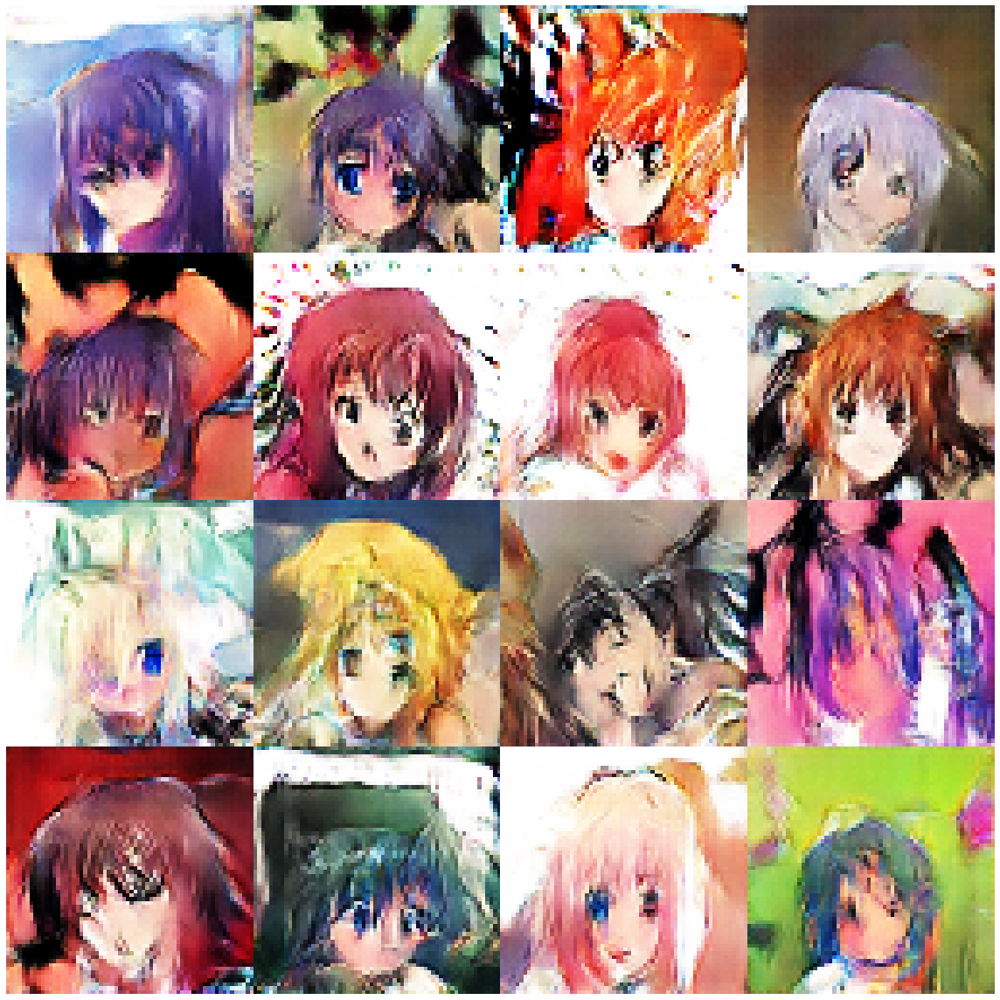

Disc: real loss: 0.449648 fake loss: 0.439010
GAN loss: 2.546839
Step 8300 completed. Time took: 1 secs.
Begin step:  8301
Disc: real loss: 0.336845 fake loss: 0.372481
GAN loss: 2.378652
Step 8301 completed. Time took: 0 secs.
Begin step:  8302
Disc: real loss: 0.334147 fake loss: 0.365870
GAN loss: 2.642368
Step 8302 completed. Time took: 0 secs.
Begin step:  8303
Disc: real loss: 0.395139 fake loss: 0.359945
GAN loss: 2.145130
Step 8303 completed. Time took: 0 secs.
Begin step:  8304
Disc: real loss: 0.358593 fake loss: 0.338003
GAN loss: 2.406948
Step 8304 completed. Time took: 0 secs.
Begin step:  8305
Disc: real loss: 0.347818 fake loss: 0.363363
GAN loss: 2.424793
Step 8305 completed. Time took: 0 secs.
Begin step:  8306
Disc: real loss: 0.366495 fake loss: 0.351722
GAN loss: 1.947849
Step 8306 completed. Time took: 0 secs.
Begin step:  8307
Disc: real loss: 0.343248 fake loss: 0.367246
GAN loss: 2.875744
Step 8307 completed. Time took: 0 secs.
Begin step:  8308
Disc: real loss:

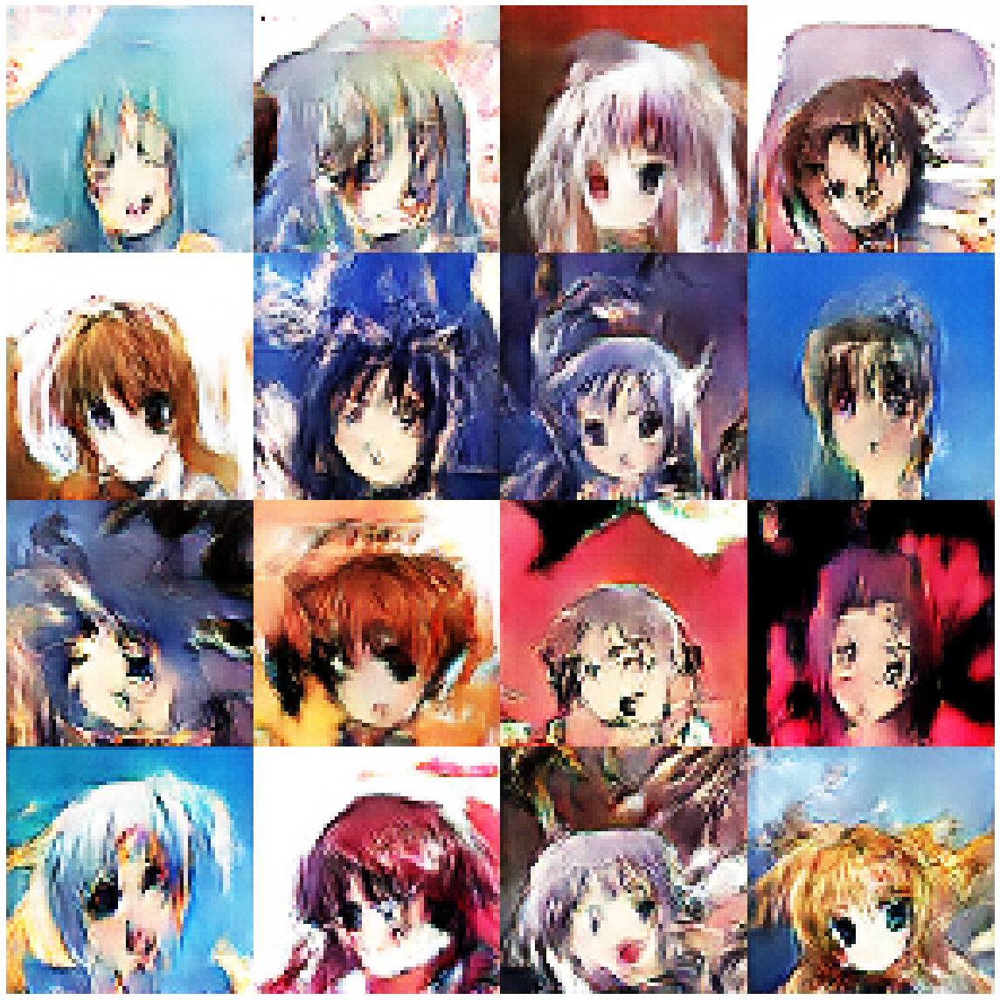

Disc: real loss: 0.366767 fake loss: 0.401688
GAN loss: 2.951668
Step 8400 completed. Time took: 1 secs.
Begin step:  8401
Disc: real loss: 0.350509 fake loss: 0.350337
GAN loss: 2.151760
Step 8401 completed. Time took: 0 secs.
Begin step:  8402
Disc: real loss: 0.332365 fake loss: 0.419003
GAN loss: 3.071065
Step 8402 completed. Time took: 0 secs.
Begin step:  8403
Disc: real loss: 0.476039 fake loss: 0.407382
GAN loss: 2.513985
Step 8403 completed. Time took: 0 secs.
Begin step:  8404
Disc: real loss: 0.344626 fake loss: 0.343346
GAN loss: 2.568853
Step 8404 completed. Time took: 0 secs.
Begin step:  8405
Disc: real loss: 0.337530 fake loss: 0.351757
GAN loss: 2.459191
Step 8405 completed. Time took: 0 secs.
Begin step:  8406
Disc: real loss: 0.345964 fake loss: 0.367100
GAN loss: 2.594661
Step 8406 completed. Time took: 0 secs.
Begin step:  8407
Disc: real loss: 0.385656 fake loss: 0.421487
GAN loss: 2.814599
Step 8407 completed. Time took: 0 secs.
Begin step:  8408
Disc: real loss:

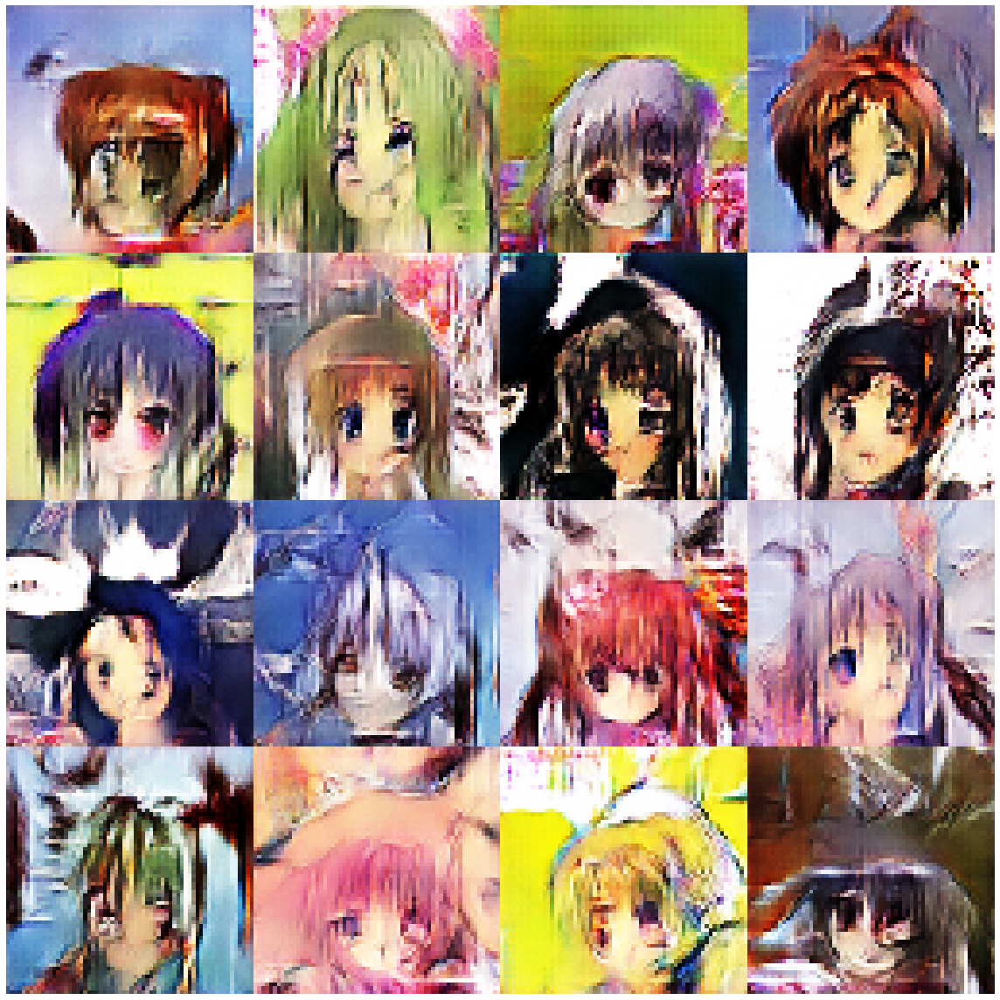

Begin step:  8500


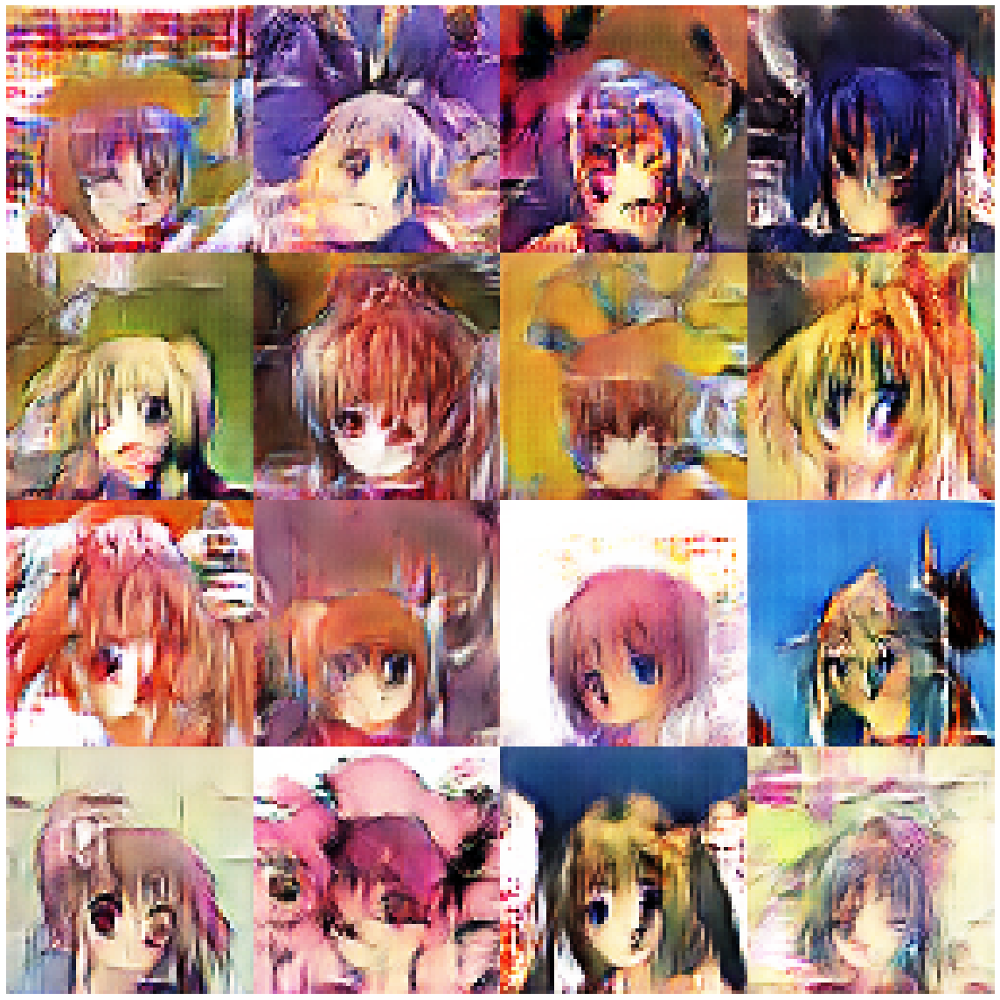

Disc: real loss: 0.406164 fake loss: 0.397957
GAN loss: 2.491040
Step 8500 completed. Time took: 1 secs.
Begin step:  8501
Disc: real loss: 0.353544 fake loss: 0.358470
GAN loss: 2.378542
Step 8501 completed. Time took: 0 secs.
Begin step:  8502
Disc: real loss: 0.365290 fake loss: 0.355531
GAN loss: 2.324685
Step 8502 completed. Time took: 0 secs.
Begin step:  8503
Disc: real loss: 0.383794 fake loss: 0.359813
GAN loss: 2.145675
Step 8503 completed. Time took: 0 secs.
Begin step:  8504
Disc: real loss: 0.343283 fake loss: 0.376910
GAN loss: 2.209846
Step 8504 completed. Time took: 0 secs.
Begin step:  8505
Disc: real loss: 0.368006 fake loss: 0.365587
GAN loss: 2.333185
Step 8505 completed. Time took: 0 secs.
Begin step:  8506
Disc: real loss: 0.355930 fake loss: 0.335131
GAN loss: 2.244757
Step 8506 completed. Time took: 0 secs.
Begin step:  8507
Disc: real loss: 0.389934 fake loss: 0.487639
GAN loss: 3.367504
Step 8507 completed. Time took: 0 secs.
Begin step:  8508
Disc: real loss:

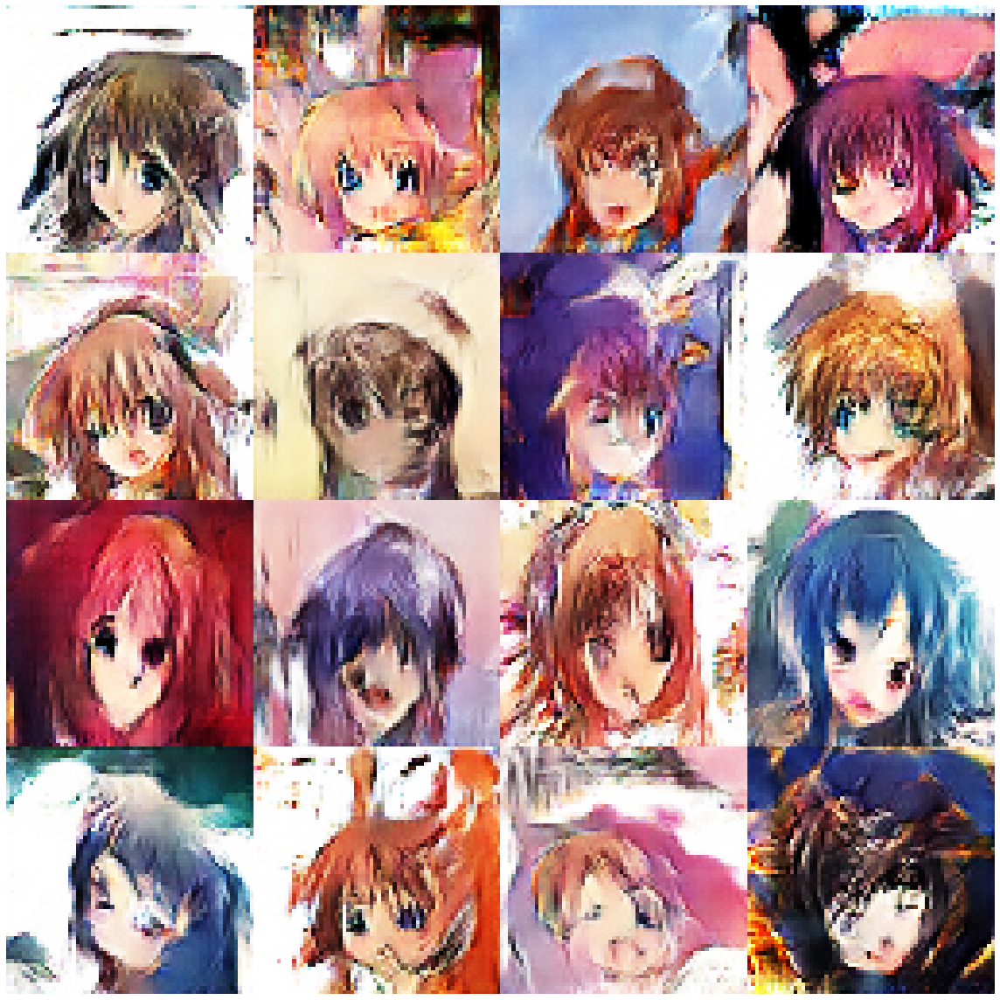

Disc: real loss: 0.349050 fake loss: 0.355464
GAN loss: 2.435926
Step 8600 completed. Time took: 1 secs.
Begin step:  8601
Disc: real loss: 0.343268 fake loss: 0.361841
GAN loss: 2.290617
Step 8601 completed. Time took: 0 secs.
Begin step:  8602
Disc: real loss: 0.350172 fake loss: 0.360178
GAN loss: 2.321126
Step 8602 completed. Time took: 0 secs.
Begin step:  8603
Disc: real loss: 0.367785 fake loss: 0.371207
GAN loss: 2.548910
Step 8603 completed. Time took: 0 secs.
Begin step:  8604
Disc: real loss: 0.343549 fake loss: 0.315488
GAN loss: 2.402549
Step 8604 completed. Time took: 0 secs.
Begin step:  8605
Disc: real loss: 0.329172 fake loss: 0.357094
GAN loss: 2.325771
Step 8605 completed. Time took: 0 secs.
Begin step:  8606
Disc: real loss: 0.375843 fake loss: 0.352918
GAN loss: 2.771117
Step 8606 completed. Time took: 0 secs.
Begin step:  8607
Disc: real loss: 0.388309 fake loss: 0.341063
GAN loss: 2.174698
Step 8607 completed. Time took: 0 secs.
Begin step:  8608
Disc: real loss:

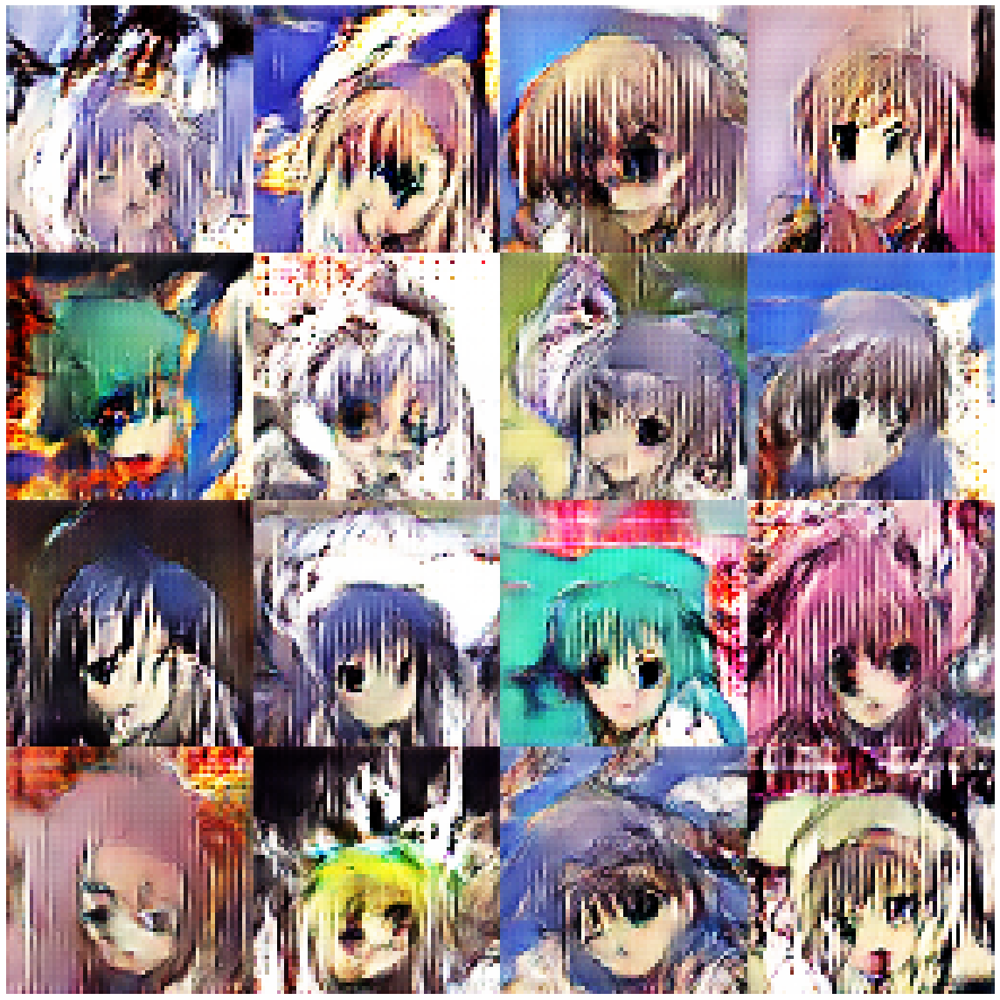

Disc: real loss: 0.377981 fake loss: 0.551071
GAN loss: 3.367629
Step 8700 completed. Time took: 1 secs.
Begin step:  8701
Disc: real loss: 0.387590 fake loss: 0.391378
GAN loss: 2.270771
Step 8701 completed. Time took: 0 secs.
Begin step:  8702
Disc: real loss: 0.353394 fake loss: 0.654585
GAN loss: 4.181368
Step 8702 completed. Time took: 0 secs.
Begin step:  8703
Disc: real loss: 0.618074 fake loss: 0.374453
GAN loss: 1.309534
Step 8703 completed. Time took: 0 secs.
Begin step:  8704
Disc: real loss: 0.378827 fake loss: 0.728654
GAN loss: 4.081125
Step 8704 completed. Time took: 0 secs.
Begin step:  8705
Disc: real loss: 0.721014 fake loss: 0.394653
GAN loss: 1.495102
Step 8705 completed. Time took: 0 secs.
Begin step:  8706
Disc: real loss: 0.391057 fake loss: 0.638675
GAN loss: 3.826431
Step 8706 completed. Time took: 0 secs.
Begin step:  8707
Disc: real loss: 0.606508 fake loss: 0.352820
GAN loss: 1.731479
Step 8707 completed. Time took: 0 secs.
Begin step:  8708
Disc: real loss:

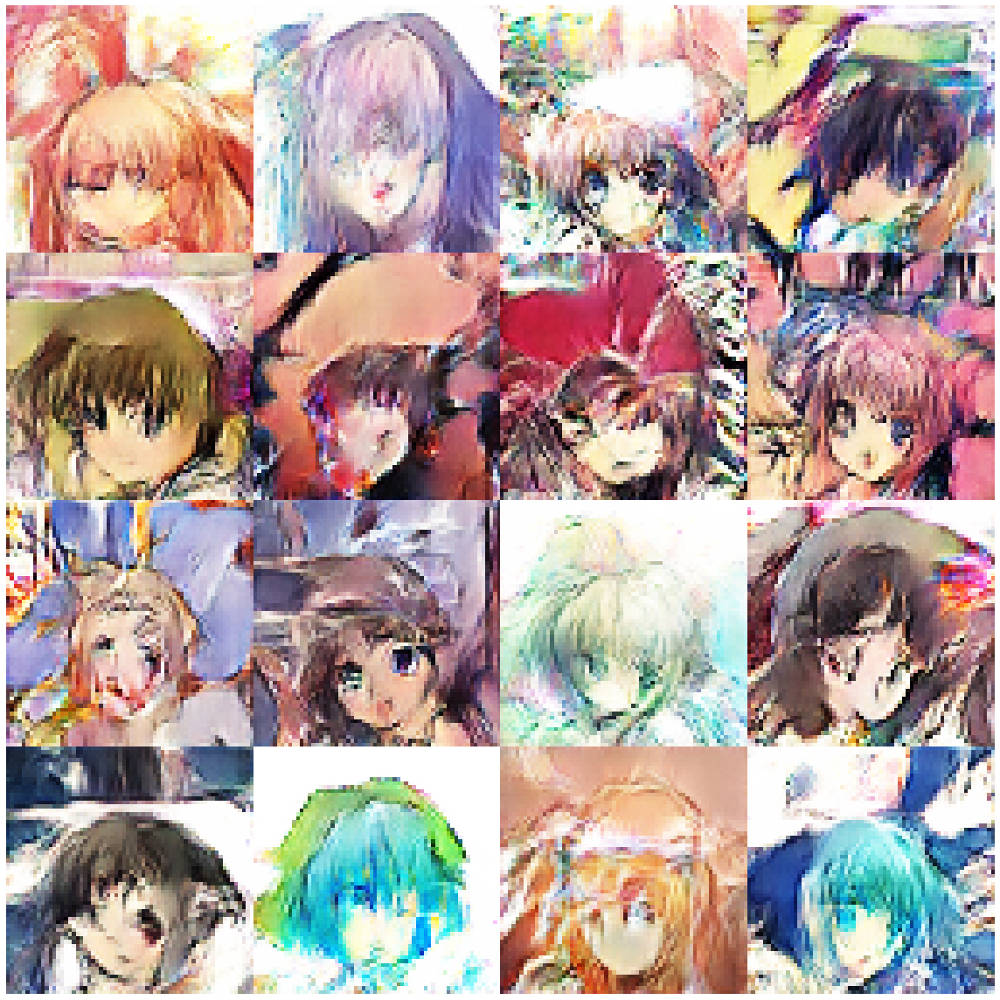

Disc: real loss: 0.349865 fake loss: 0.349932
GAN loss: 2.077787
Step 8800 completed. Time took: 1 secs.
Begin step:  8801
Disc: real loss: 0.357604 fake loss: 0.340596
GAN loss: 2.073295
Step 8801 completed. Time took: 0 secs.
Begin step:  8802
Disc: real loss: 0.353710 fake loss: 0.346900
GAN loss: 2.376559
Step 8802 completed. Time took: 0 secs.
Begin step:  8803
Disc: real loss: 0.339751 fake loss: 0.354317
GAN loss: 2.391710
Step 8803 completed. Time took: 0 secs.
Begin step:  8804
Disc: real loss: 0.360003 fake loss: 0.351508
GAN loss: 2.229376
Step 8804 completed. Time took: 0 secs.
Begin step:  8805
Disc: real loss: 0.345631 fake loss: 0.344677
GAN loss: 2.327117
Step 8805 completed. Time took: 0 secs.
Begin step:  8806
Disc: real loss: 0.360042 fake loss: 0.385233
GAN loss: 2.531160
Step 8806 completed. Time took: 0 secs.
Begin step:  8807
Disc: real loss: 0.357865 fake loss: 0.336236
GAN loss: 2.157423
Step 8807 completed. Time took: 0 secs.
Begin step:  8808
Disc: real loss:

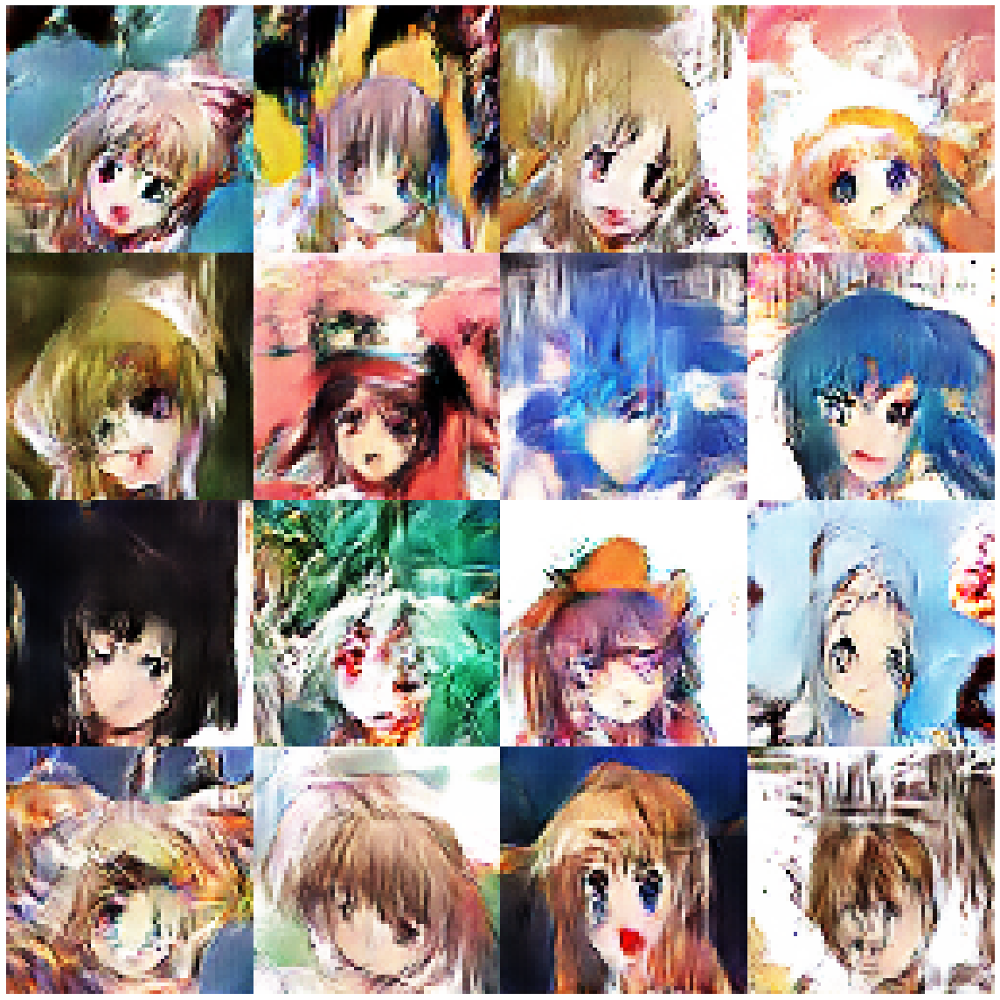

Disc: real loss: 0.354800 fake loss: 0.342454
GAN loss: 2.211507
Step 8900 completed. Time took: 1 secs.
Begin step:  8901
Disc: real loss: 0.334261 fake loss: 0.360719
GAN loss: 2.122406
Step 8901 completed. Time took: 0 secs.
Begin step:  8902
Disc: real loss: 0.392040 fake loss: 0.437906
GAN loss: 2.983390
Step 8902 completed. Time took: 0 secs.
Begin step:  8903
Disc: real loss: 0.494676 fake loss: 0.401866
GAN loss: 2.071860
Step 8903 completed. Time took: 0 secs.
Begin step:  8904
Disc: real loss: 0.346568 fake loss: 0.347732
GAN loss: 2.606520
Step 8904 completed. Time took: 0 secs.
Begin step:  8905
Disc: real loss: 0.350329 fake loss: 0.341878
GAN loss: 2.451603
Step 8905 completed. Time took: 0 secs.
Begin step:  8906
Disc: real loss: 0.343654 fake loss: 0.318064
GAN loss: 2.432282
Step 8906 completed. Time took: 0 secs.
Begin step:  8907
Disc: real loss: 0.363219 fake loss: 0.370970
GAN loss: 2.630298
Step 8907 completed. Time took: 0 secs.
Begin step:  8908
Disc: real loss:

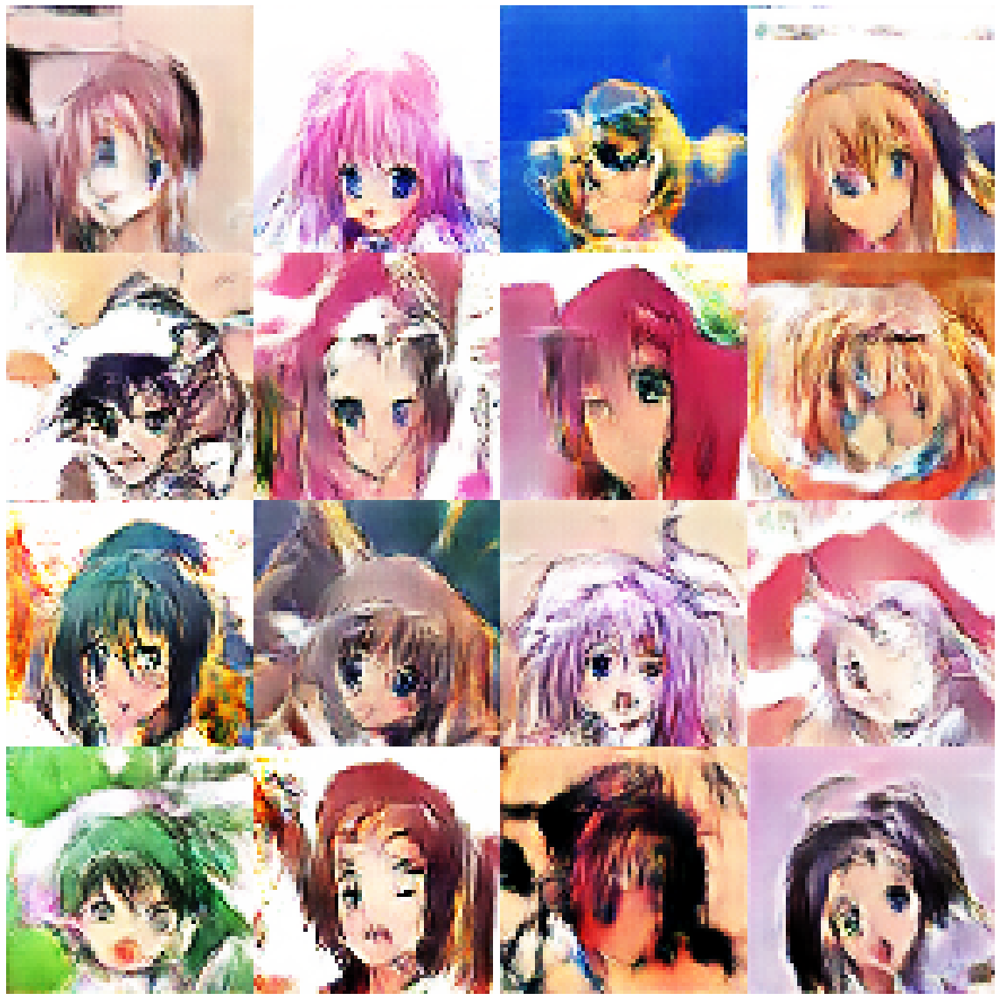

Begin step:  9000


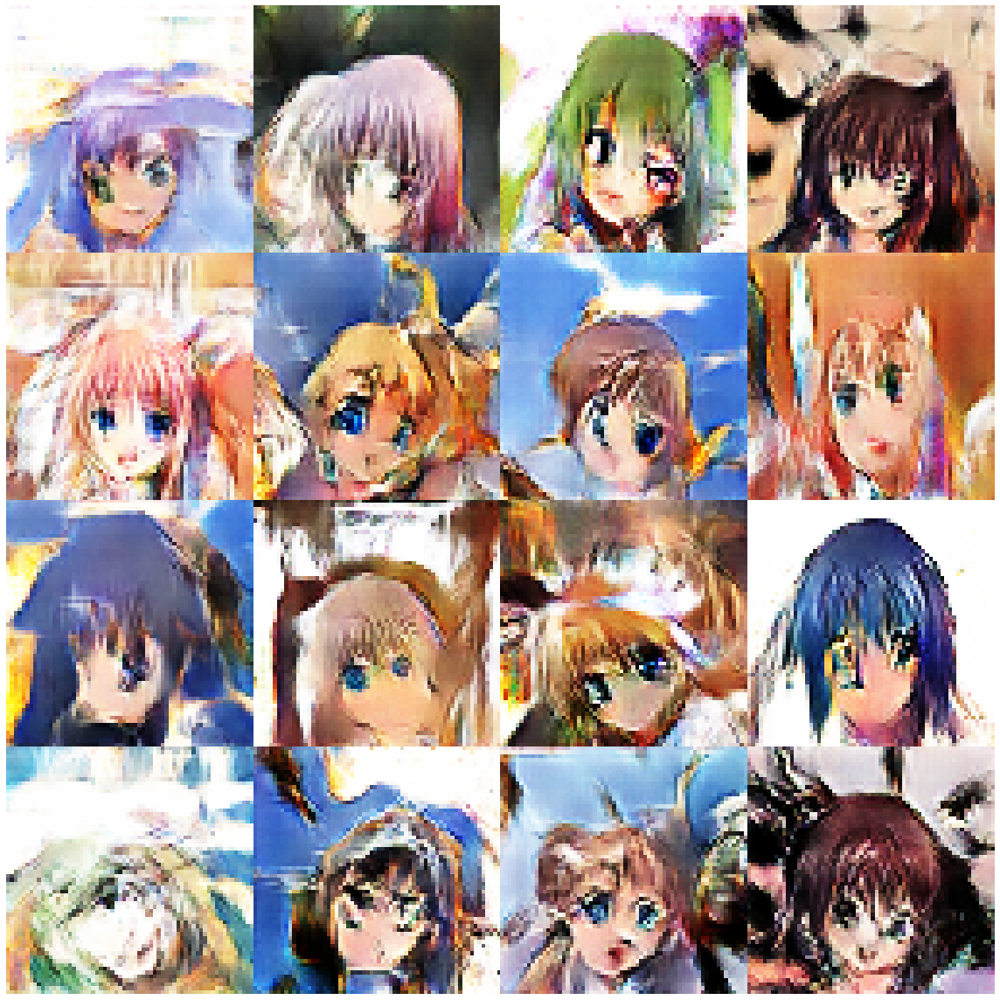

Disc: real loss: 0.341491 fake loss: 0.325900
GAN loss: 2.224862
Step 9000 completed. Time took: 1 secs.
Begin step:  9001
Disc: real loss: 0.324971 fake loss: 0.327957
GAN loss: 2.668586
Step 9001 completed. Time took: 0 secs.
Begin step:  9002
Disc: real loss: 0.366853 fake loss: 0.411720
GAN loss: 2.865502
Step 9002 completed. Time took: 0 secs.
Begin step:  9003
Disc: real loss: 0.383125 fake loss: 0.346851
GAN loss: 2.612353
Step 9003 completed. Time took: 0 secs.
Begin step:  9004
Disc: real loss: 0.355550 fake loss: 0.354671
GAN loss: 2.029796
Step 9004 completed. Time took: 0 secs.
Begin step:  9005
Disc: real loss: 0.346257 fake loss: 0.336209
GAN loss: 2.667112
Step 9005 completed. Time took: 0 secs.
Begin step:  9006
Disc: real loss: 0.345051 fake loss: 0.325271
GAN loss: 2.303083
Step 9006 completed. Time took: 0 secs.
Begin step:  9007
Disc: real loss: 0.336030 fake loss: 0.374279
GAN loss: 2.390427
Step 9007 completed. Time took: 0 secs.
Begin step:  9008
Disc: real loss:

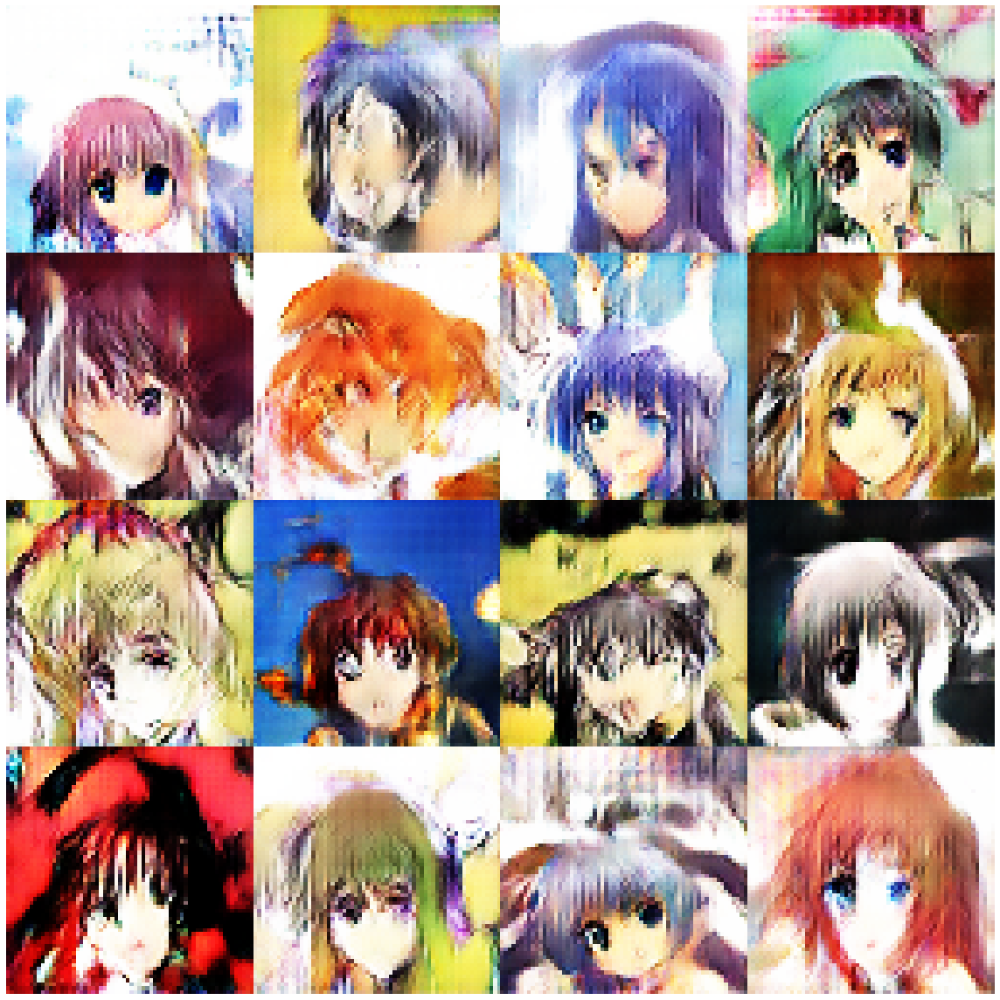

Disc: real loss: 0.402673 fake loss: 0.450130
GAN loss: 2.893953
Step 9100 completed. Time took: 1 secs.
Begin step:  9101
Disc: real loss: 0.354125 fake loss: 0.391393
GAN loss: 2.270436
Step 9101 completed. Time took: 0 secs.
Begin step:  9102
Disc: real loss: 0.358017 fake loss: 0.348245
GAN loss: 2.129750
Step 9102 completed. Time took: 0 secs.
Begin step:  9103
Disc: real loss: 0.370298 fake loss: 0.385860
GAN loss: 2.653344
Step 9103 completed. Time took: 0 secs.
Begin step:  9104
Disc: real loss: 0.456790 fake loss: 0.414805
GAN loss: 2.457292
Step 9104 completed. Time took: 0 secs.
Begin step:  9105
Disc: real loss: 0.383942 fake loss: 0.370667
GAN loss: 2.351207
Step 9105 completed. Time took: 0 secs.
Begin step:  9106
Disc: real loss: 0.378690 fake loss: 0.440929
GAN loss: 2.931032
Step 9106 completed. Time took: 0 secs.
Begin step:  9107
Disc: real loss: 0.441462 fake loss: 0.355844
GAN loss: 2.779761
Step 9107 completed. Time took: 0 secs.
Begin step:  9108
Disc: real loss:

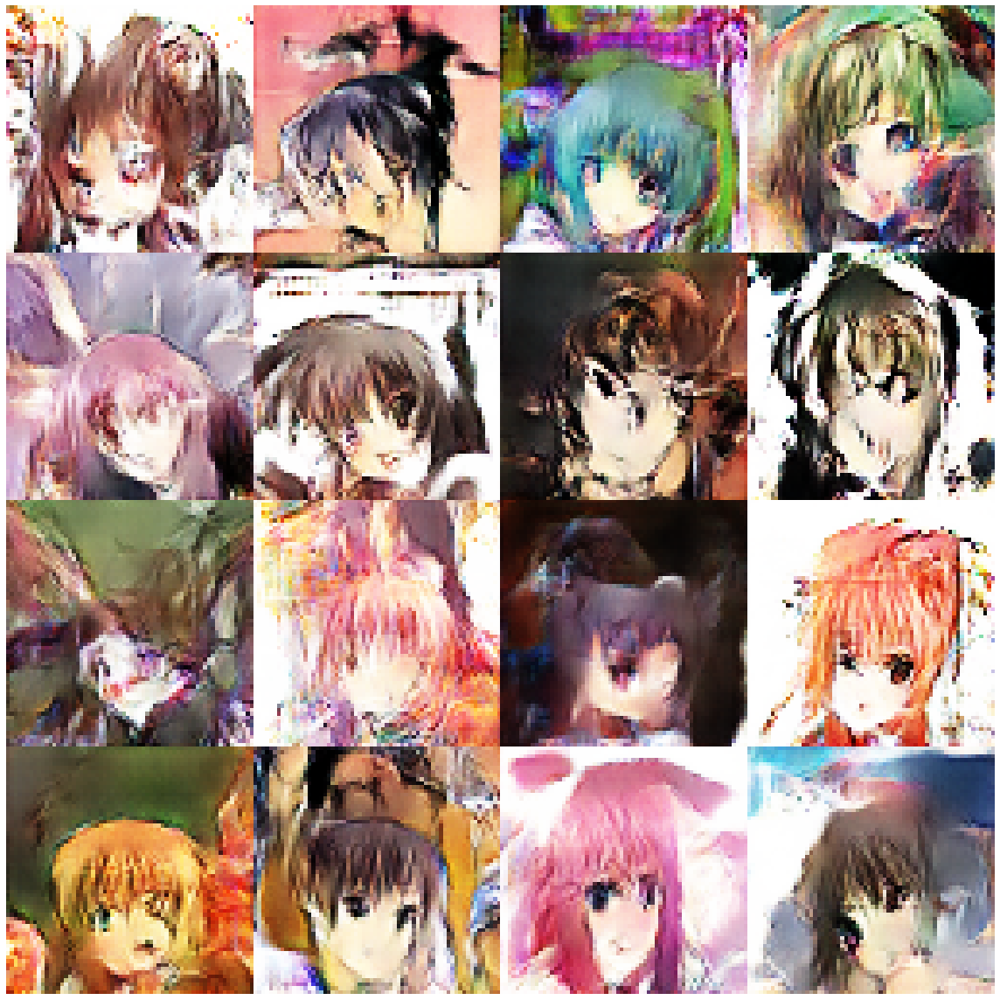

Disc: real loss: 0.338962 fake loss: 0.320720
GAN loss: 2.527781
Step 9200 completed. Time took: 1 secs.
Begin step:  9201
Disc: real loss: 0.369192 fake loss: 0.345438
GAN loss: 2.372914
Step 9201 completed. Time took: 0 secs.
Begin step:  9202
Disc: real loss: 0.367242 fake loss: 0.380680
GAN loss: 2.461395
Step 9202 completed. Time took: 0 secs.
Begin step:  9203
Disc: real loss: 0.341255 fake loss: 0.318419
GAN loss: 2.620788
Step 9203 completed. Time took: 0 secs.
Begin step:  9204
Disc: real loss: 0.382886 fake loss: 0.367775
GAN loss: 2.200675
Step 9204 completed. Time took: 0 secs.
Begin step:  9205
Disc: real loss: 0.345941 fake loss: 0.328778
GAN loss: 2.314396
Step 9205 completed. Time took: 0 secs.
Begin step:  9206
Disc: real loss: 0.355710 fake loss: 0.370924
GAN loss: 2.212246
Step 9206 completed. Time took: 0 secs.
Begin step:  9207
Disc: real loss: 0.364185 fake loss: 0.353267
GAN loss: 2.029048
Step 9207 completed. Time took: 0 secs.
Begin step:  9208
Disc: real loss:

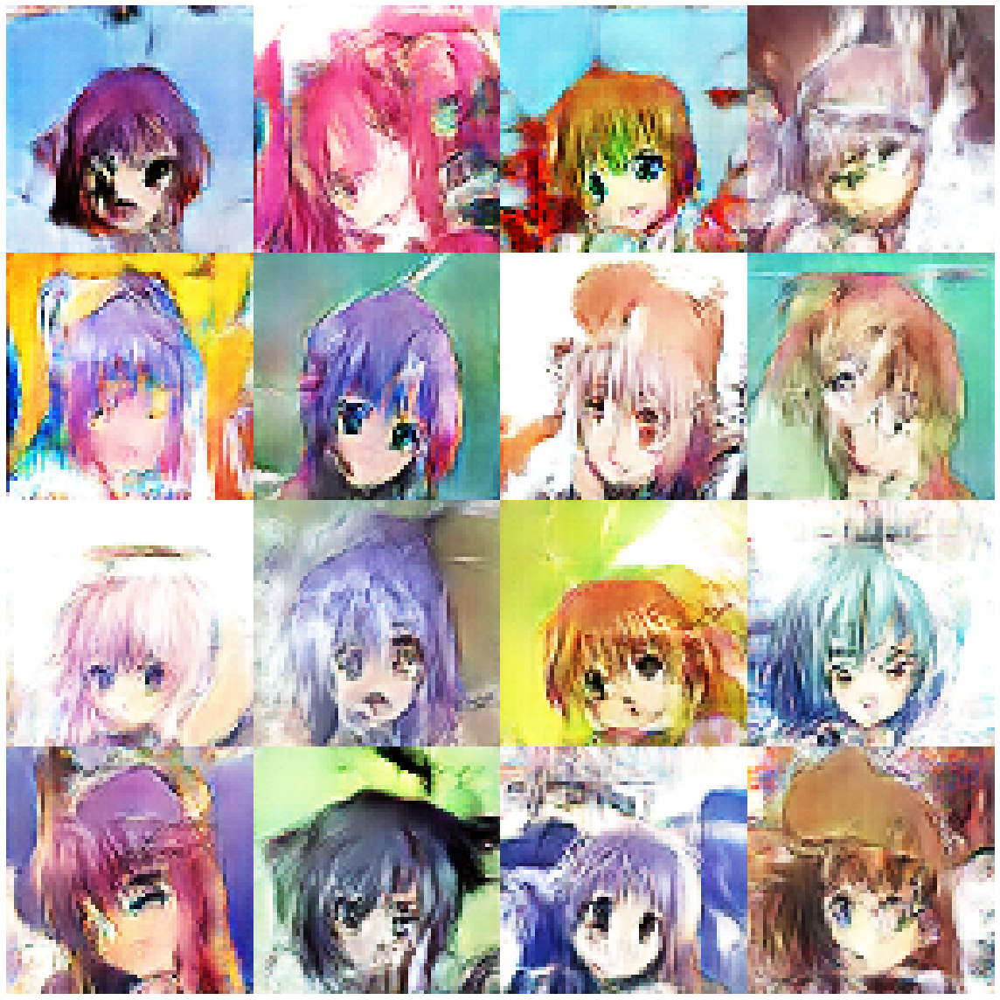

Disc: real loss: 0.343107 fake loss: 0.336999
GAN loss: 2.046051
Step 9300 completed. Time took: 1 secs.
Begin step:  9301
Disc: real loss: 0.353806 fake loss: 0.364180
GAN loss: 2.078163
Step 9301 completed. Time took: 0 secs.
Begin step:  9302
Disc: real loss: 0.342125 fake loss: 0.345150
GAN loss: 2.491361
Step 9302 completed. Time took: 0 secs.
Begin step:  9303
Disc: real loss: 0.362891 fake loss: 0.395642
GAN loss: 3.401436
Step 9303 completed. Time took: 0 secs.
Begin step:  9304
Disc: real loss: 0.406587 fake loss: 0.361691
GAN loss: 1.679505
Step 9304 completed. Time took: 0 secs.
Begin step:  9305
Disc: real loss: 0.332453 fake loss: 0.373340
GAN loss: 3.591944
Step 9305 completed. Time took: 0 secs.
Begin step:  9306
Disc: real loss: 0.401186 fake loss: 0.353750
GAN loss: 1.626356
Step 9306 completed. Time took: 0 secs.
Begin step:  9307
Disc: real loss: 0.341359 fake loss: 0.403820
GAN loss: 3.053837
Step 9307 completed. Time took: 0 secs.
Begin step:  9308
Disc: real loss:

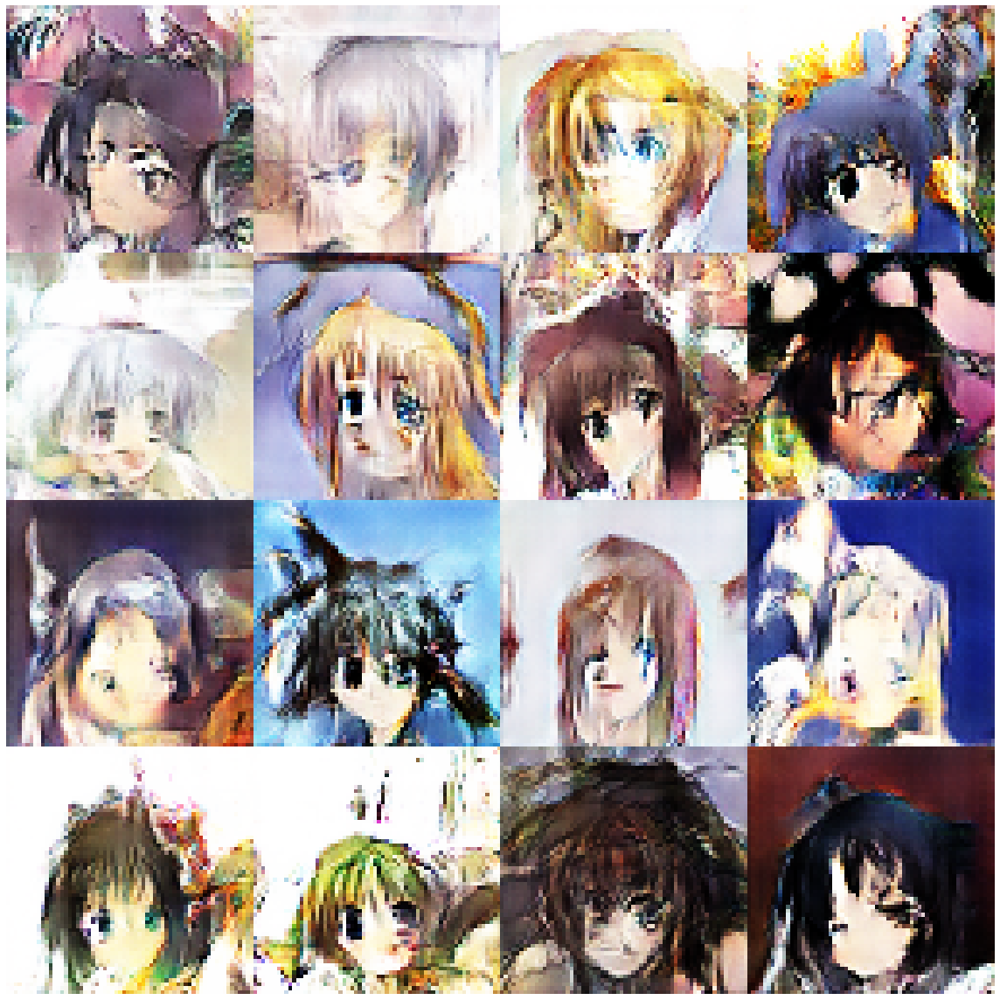

Disc: real loss: 0.340433 fake loss: 0.347893
GAN loss: 2.270677
Step 9400 completed. Time took: 1 secs.
Begin step:  9401
Disc: real loss: 0.333227 fake loss: 0.411666
GAN loss: 2.902488
Step 9401 completed. Time took: 0 secs.
Begin step:  9402
Disc: real loss: 0.364104 fake loss: 0.381277
GAN loss: 1.789254
Step 9402 completed. Time took: 0 secs.
Begin step:  9403
Disc: real loss: 0.360141 fake loss: 0.470154
GAN loss: 3.390065
Step 9403 completed. Time took: 0 secs.
Begin step:  9404
Disc: real loss: 0.474593 fake loss: 0.393910
GAN loss: 2.261457
Step 9404 completed. Time took: 0 secs.
Begin step:  9405
Disc: real loss: 0.338646 fake loss: 0.382612
GAN loss: 2.354659
Step 9405 completed. Time took: 0 secs.
Begin step:  9406
Disc: real loss: 0.348212 fake loss: 0.351198
GAN loss: 2.206349
Step 9406 completed. Time took: 0 secs.
Begin step:  9407
Disc: real loss: 0.342451 fake loss: 0.395675
GAN loss: 2.748386
Step 9407 completed. Time took: 0 secs.
Begin step:  9408
Disc: real loss:

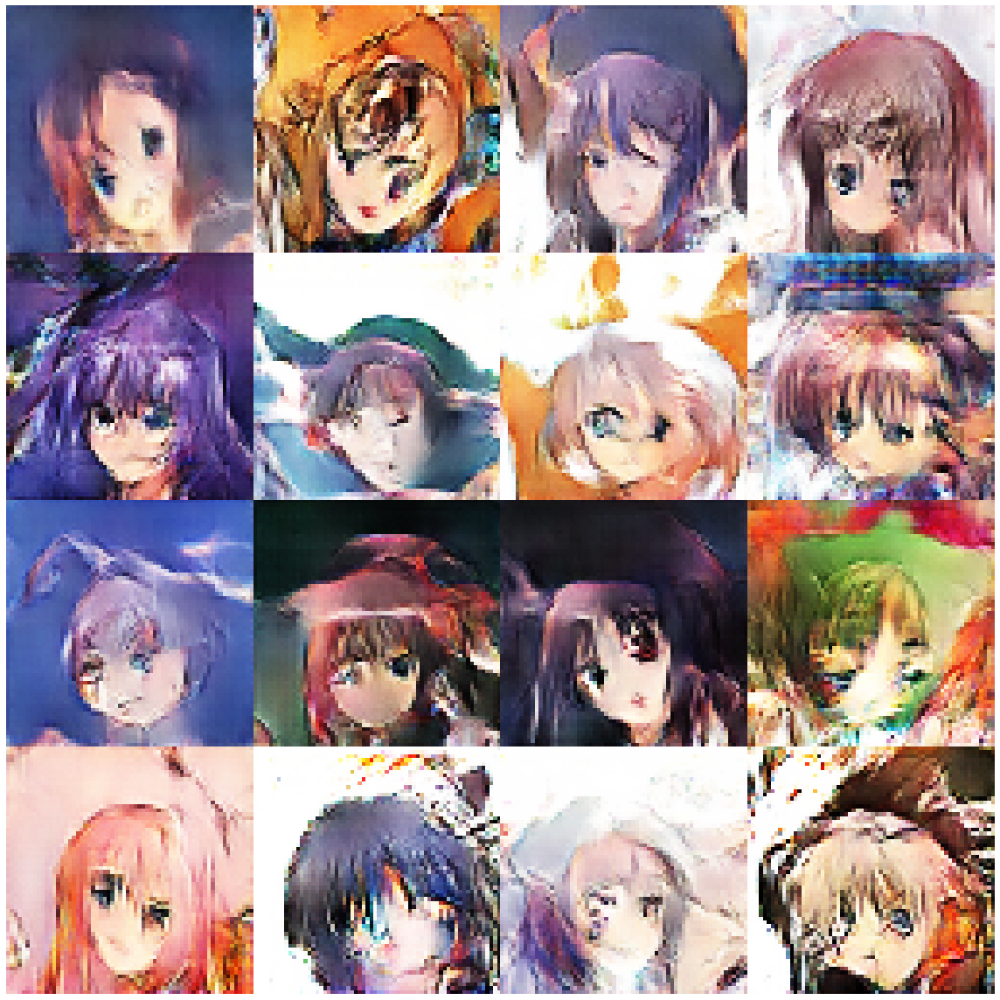

Begin step:  9500


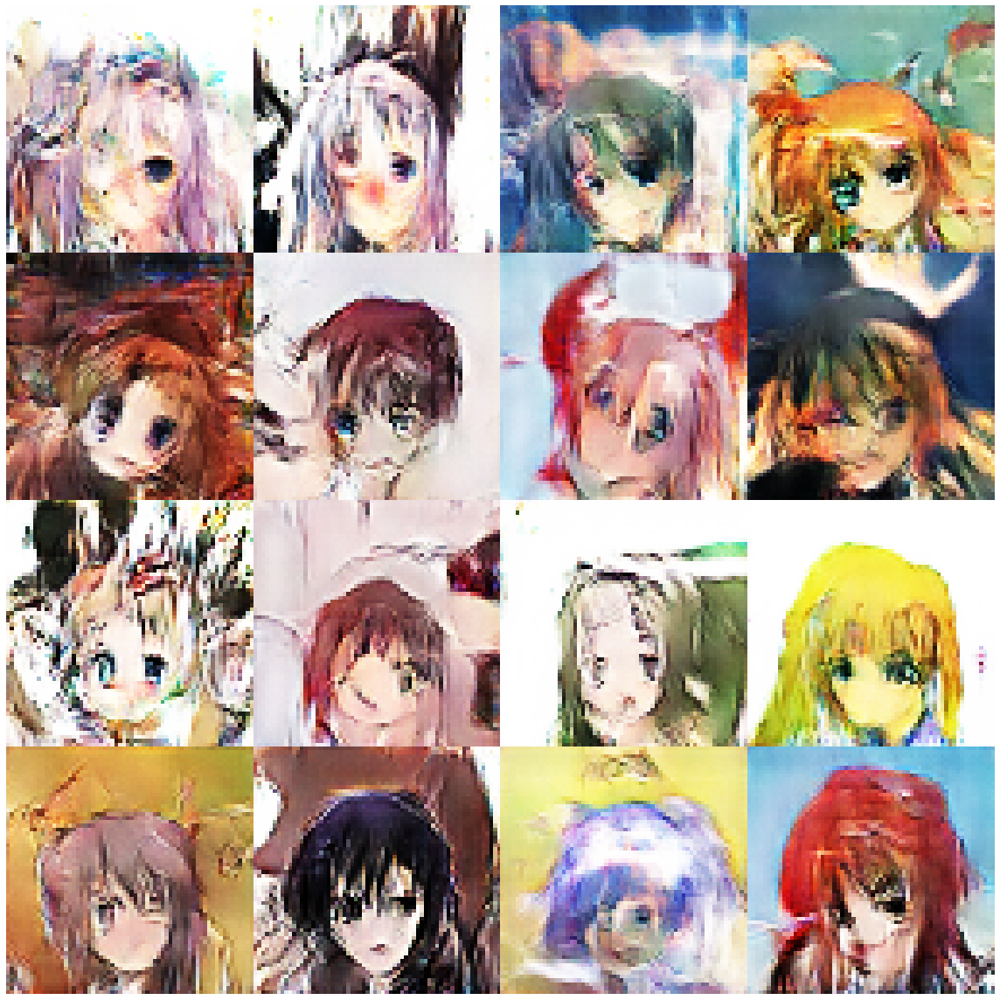

Disc: real loss: 0.355571 fake loss: 0.377050
GAN loss: 2.808478
Step 9500 completed. Time took: 1 secs.
Begin step:  9501
Disc: real loss: 0.402211 fake loss: 0.354250
GAN loss: 2.112405
Step 9501 completed. Time took: 0 secs.
Begin step:  9502
Disc: real loss: 0.336705 fake loss: 0.352314
GAN loss: 2.364337
Step 9502 completed. Time took: 0 secs.
Begin step:  9503
Disc: real loss: 0.348003 fake loss: 0.346138
GAN loss: 2.111689
Step 9503 completed. Time took: 0 secs.
Begin step:  9504
Disc: real loss: 0.340356 fake loss: 0.331715
GAN loss: 2.372302
Step 9504 completed. Time took: 0 secs.
Begin step:  9505
Disc: real loss: 0.320996 fake loss: 0.340232
GAN loss: 2.339090
Step 9505 completed. Time took: 0 secs.
Begin step:  9506
Disc: real loss: 0.381128 fake loss: 0.501338
GAN loss: 3.623475
Step 9506 completed. Time took: 0 secs.
Begin step:  9507
Disc: real loss: 0.463981 fake loss: 0.326061
GAN loss: 1.721860
Step 9507 completed. Time took: 0 secs.
Begin step:  9508
Disc: real loss:

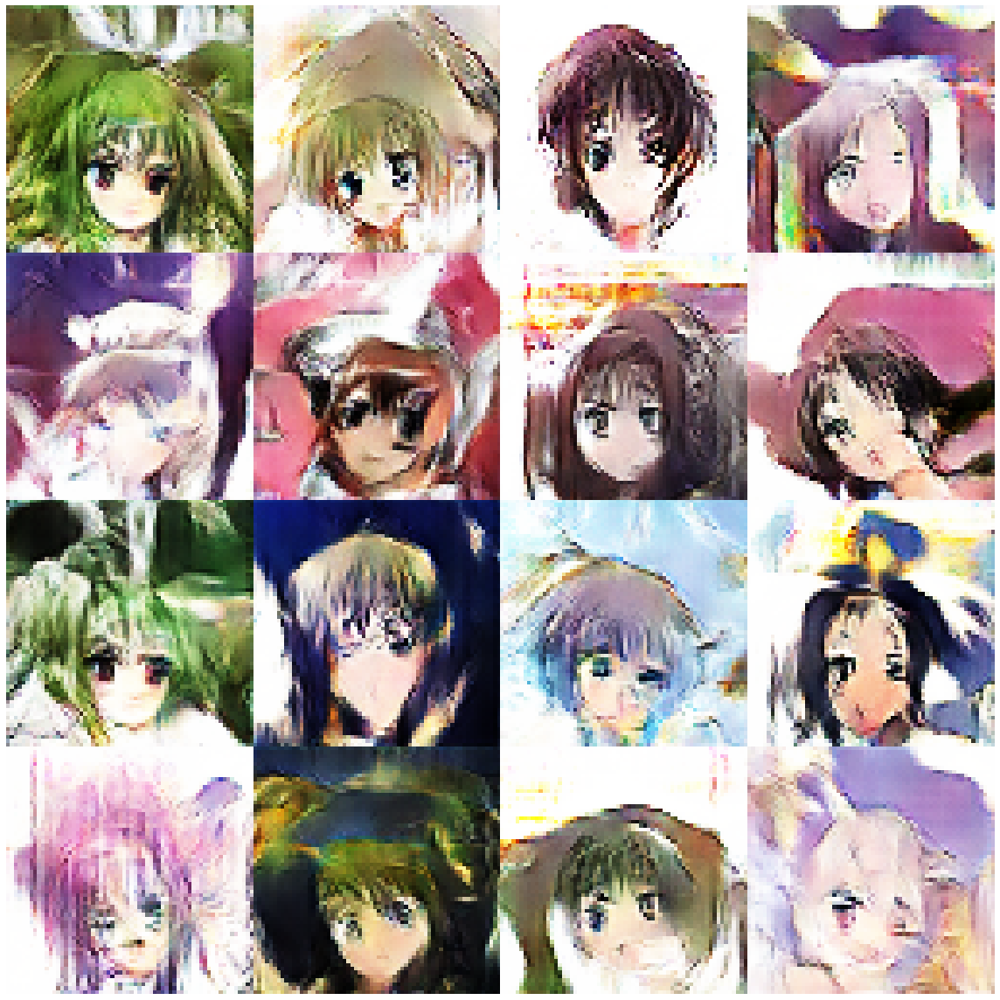

Disc: real loss: 0.349420 fake loss: 0.441009
GAN loss: 3.264830
Step 9600 completed. Time took: 1 secs.
Begin step:  9601
Disc: real loss: 0.422320 fake loss: 0.356972
GAN loss: 1.949314
Step 9601 completed. Time took: 0 secs.
Begin step:  9602
Disc: real loss: 0.367416 fake loss: 0.332843
GAN loss: 2.263677
Step 9602 completed. Time took: 0 secs.
Begin step:  9603
Disc: real loss: 0.336328 fake loss: 0.354663
GAN loss: 2.262715
Step 9603 completed. Time took: 0 secs.
Begin step:  9604
Disc: real loss: 0.352837 fake loss: 0.374812
GAN loss: 3.017431
Step 9604 completed. Time took: 0 secs.
Begin step:  9605
Disc: real loss: 0.354094 fake loss: 0.427937
GAN loss: 2.090414
Step 9605 completed. Time took: 0 secs.
Begin step:  9606
Disc: real loss: 0.368713 fake loss: 0.438883
GAN loss: 3.233525
Step 9606 completed. Time took: 0 secs.
Begin step:  9607
Disc: real loss: 0.492645 fake loss: 0.325088
GAN loss: 1.954082
Step 9607 completed. Time took: 0 secs.
Begin step:  9608
Disc: real loss:

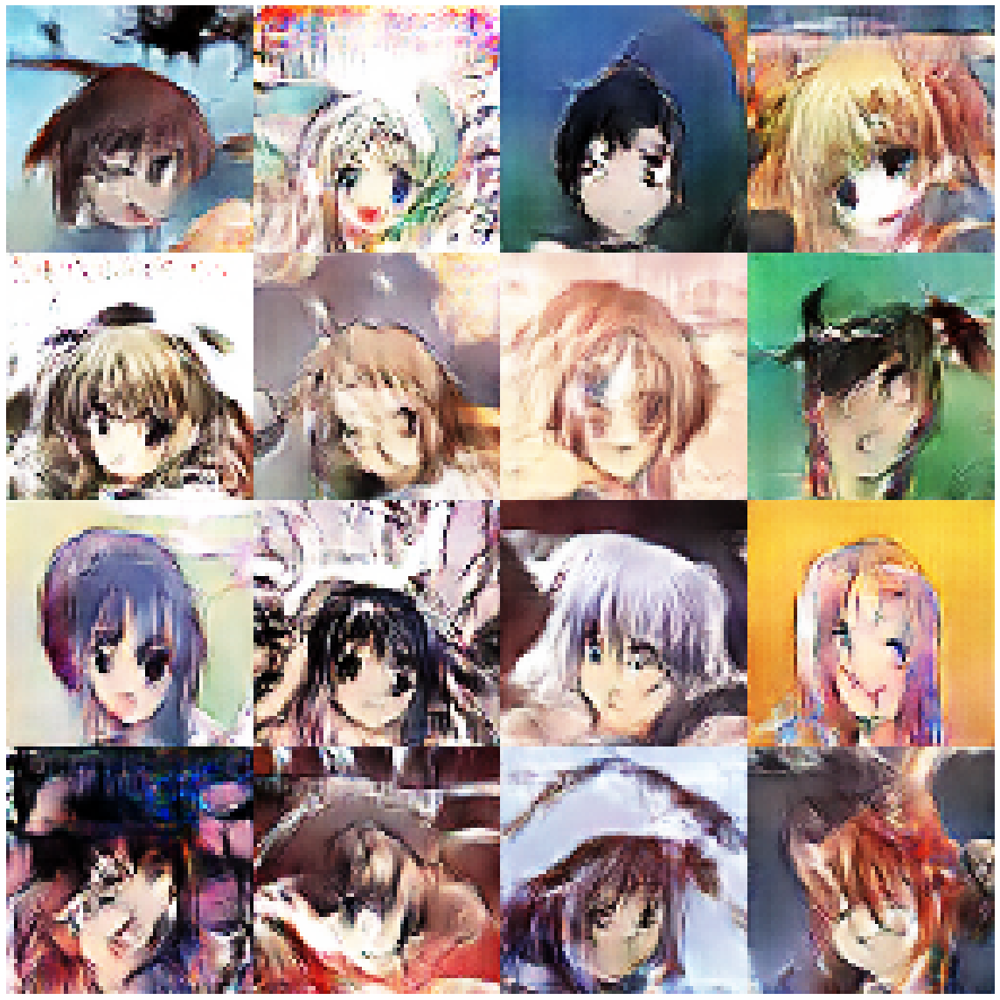

Disc: real loss: 0.342490 fake loss: 0.358125
GAN loss: 2.377834
Step 9700 completed. Time took: 1 secs.
Begin step:  9701
Disc: real loss: 0.331164 fake loss: 0.345653
GAN loss: 2.266203
Step 9701 completed. Time took: 0 secs.
Begin step:  9702
Disc: real loss: 0.355893 fake loss: 0.350955
GAN loss: 2.276045
Step 9702 completed. Time took: 0 secs.
Begin step:  9703
Disc: real loss: 0.335474 fake loss: 0.347139
GAN loss: 2.700224
Step 9703 completed. Time took: 0 secs.
Begin step:  9704
Disc: real loss: 0.355909 fake loss: 0.337813
GAN loss: 1.809509
Step 9704 completed. Time took: 0 secs.
Begin step:  9705
Disc: real loss: 0.325595 fake loss: 0.335472
GAN loss: 2.628748
Step 9705 completed. Time took: 0 secs.
Begin step:  9706
Disc: real loss: 0.316025 fake loss: 0.341988
GAN loss: 2.368671
Step 9706 completed. Time took: 0 secs.
Begin step:  9707
Disc: real loss: 0.332578 fake loss: 0.375865
GAN loss: 2.756756
Step 9707 completed. Time took: 0 secs.
Begin step:  9708
Disc: real loss:

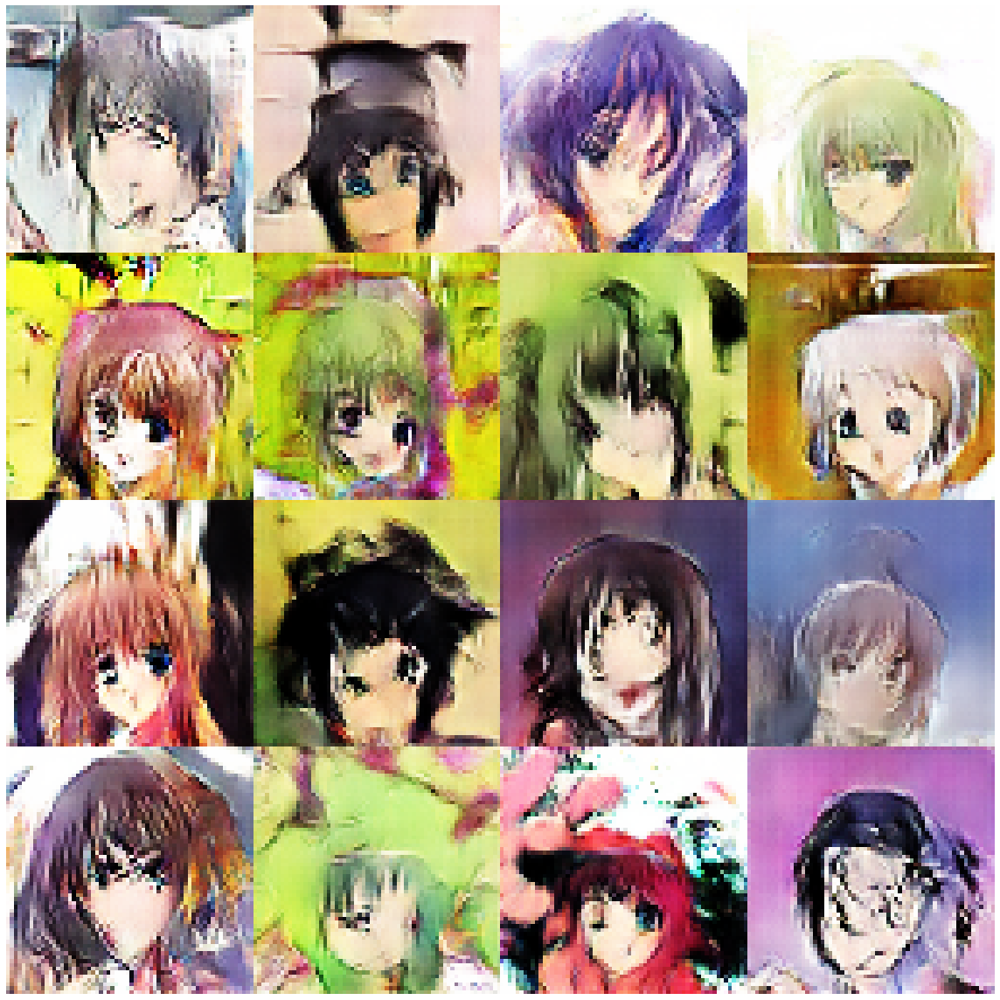

Disc: real loss: 0.350440 fake loss: 0.360011
GAN loss: 2.398222
Step 9800 completed. Time took: 1 secs.
Begin step:  9801
Disc: real loss: 0.344747 fake loss: 0.344834
GAN loss: 2.553573
Step 9801 completed. Time took: 0 secs.
Begin step:  9802
Disc: real loss: 0.357849 fake loss: 0.333264
GAN loss: 2.165987
Step 9802 completed. Time took: 0 secs.
Begin step:  9803
Disc: real loss: 0.344531 fake loss: 0.342514
GAN loss: 2.670429
Step 9803 completed. Time took: 0 secs.
Begin step:  9804
Disc: real loss: 0.386271 fake loss: 0.380018
GAN loss: 2.236535
Step 9804 completed. Time took: 0 secs.
Begin step:  9805
Disc: real loss: 0.325745 fake loss: 0.324848
GAN loss: 2.213157
Step 9805 completed. Time took: 0 secs.
Begin step:  9806
Disc: real loss: 0.330865 fake loss: 0.377661
GAN loss: 2.693531
Step 9806 completed. Time took: 0 secs.
Begin step:  9807
Disc: real loss: 0.331949 fake loss: 0.354891
GAN loss: 2.537368
Step 9807 completed. Time took: 0 secs.
Begin step:  9808
Disc: real loss:

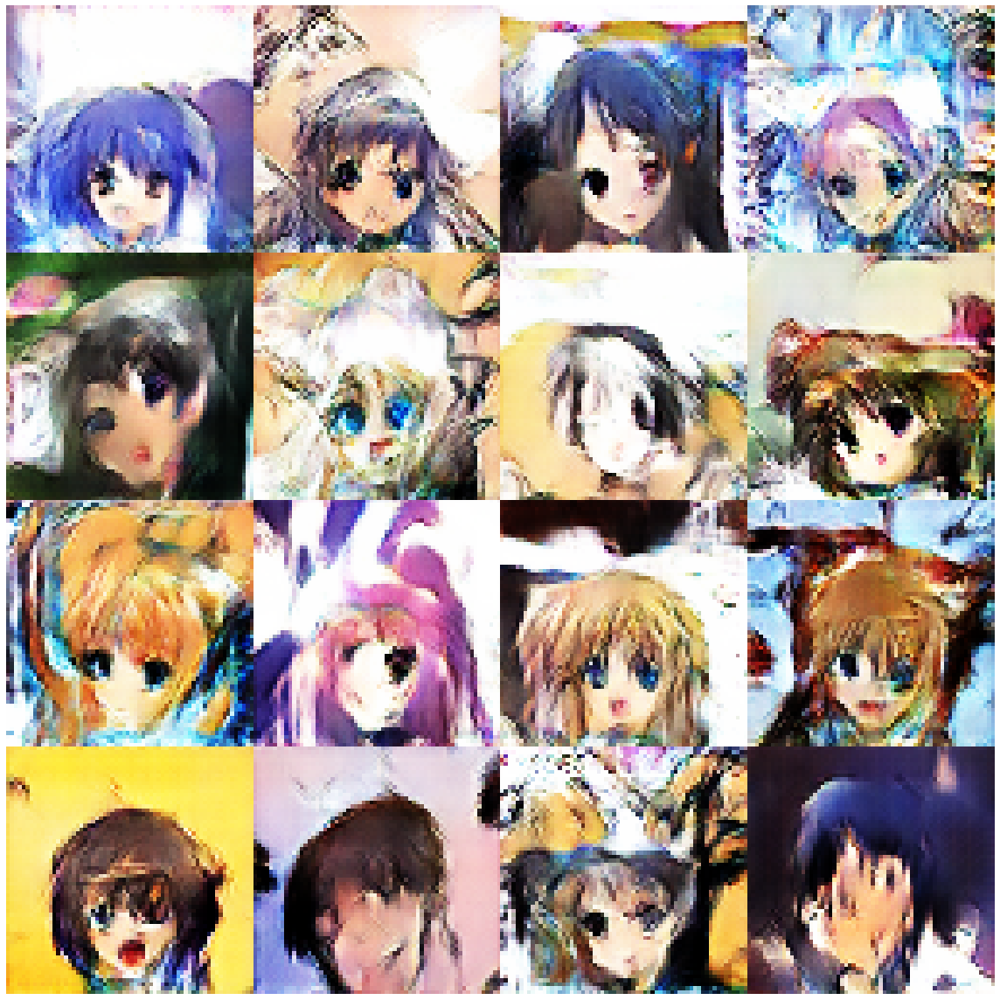

Disc: real loss: 0.365862 fake loss: 0.360534
GAN loss: 2.225499
Step 9900 completed. Time took: 1 secs.
Begin step:  9901
Disc: real loss: 0.360472 fake loss: 0.403892
GAN loss: 2.462766
Step 9901 completed. Time took: 0 secs.
Begin step:  9902
Disc: real loss: 0.365712 fake loss: 0.357119
GAN loss: 1.855485
Step 9902 completed. Time took: 0 secs.
Begin step:  9903
Disc: real loss: 0.375317 fake loss: 0.531958
GAN loss: 2.926117
Step 9903 completed. Time took: 0 secs.
Begin step:  9904
Disc: real loss: 0.495545 fake loss: 0.352352
GAN loss: 2.028946
Step 9904 completed. Time took: 0 secs.
Begin step:  9905
Disc: real loss: 0.376395 fake loss: 0.421251
GAN loss: 2.426366
Step 9905 completed. Time took: 0 secs.
Begin step:  9906
Disc: real loss: 0.400912 fake loss: 0.384992
GAN loss: 1.997930
Step 9906 completed. Time took: 0 secs.
Begin step:  9907
Disc: real loss: 0.343458 fake loss: 0.377559
GAN loss: 2.363030
Step 9907 completed. Time took: 0 secs.
Begin step:  9908
Disc: real loss:

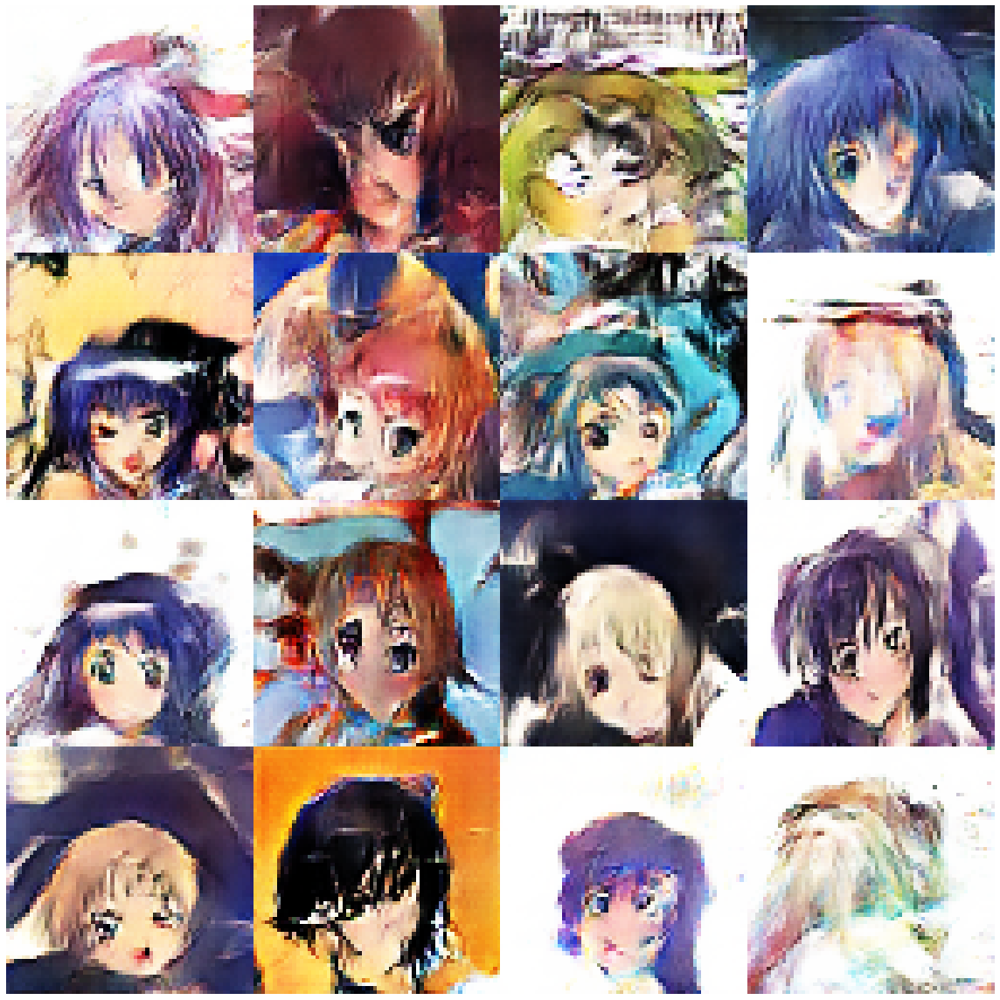

In [0]:
# Use a fixed noise vector to see how the GAN Images transition through time on a fixed noise. 
fixed_noise = gen_noise(16,noise_shape)

# To keep Track of losses
avg_disc_fake_loss = []
avg_disc_real_loss = []
avg_GAN_loss = []

# We will run for num_steps iterations
for step in range(num_steps): 
    tot_step = step
    print("Begin step: ", tot_step)
    # to keep track of time per step
    step_begin_time = time.time() 
    
    # sample a batch of normalized images from the dataset
    real_data_X = sample_from_dataset(batch_size, image_shape, data_dir=data_dir)
    
    # Genearate noise to send as input to the generator
    noise = gen_noise(batch_size,noise_shape)
    
    # Use generator to create(predict) images
    fake_data_X = generator.predict(noise)
    
    # Save predicted images from the generator every 10th step
    if (tot_step % 100) == 0:
        step_num = str(tot_step).zfill(4)
        save_img_batch(fake_data_X,img_save_dir+step_num+"_image.png")
    
    # Create the labels for real and fake data. We don't give exact ones and zeros but add a small amount of noise. This is an important GAN training trick
    real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
    fake_data_Y = np.random.random_sample(batch_size)*0.2
        
    # train the discriminator using data and labels

    discriminator.trainable = True
    generator.trainable = False

    # Training Discriminator seperately on real data
    dis_metrics_real = discriminator.train_on_batch(real_data_X,real_data_Y) 
    # training Discriminator seperately on fake data
    dis_metrics_fake = discriminator.train_on_batch(fake_data_X,fake_data_Y) 
    
    print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))
    
    # Save the losses to plot later
    avg_disc_fake_loss.append(dis_metrics_fake[0])
    avg_disc_real_loss.append(dis_metrics_real[0])
    
    # Train the generator using a random vector of noise and its labels (1's with noise)
    generator.trainable = True
    discriminator.trainable = False

    GAN_X = gen_noise(batch_size,noise_shape)
    GAN_Y = real_data_Y
   
    gan_metrics = gan.train_on_batch(GAN_X,GAN_Y)
    print("GAN loss: %f" % (gan_metrics[0]))
    
    # Log results by opening a file in append mode
    text_file = open(log_dir+"\\training_log.txt", "a")
    text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0], dis_metrics_fake[0],gan_metrics[0]))
    text_file.close()

    # save GAN loss to plot later
    avg_GAN_loss.append(gan_metrics[0])
            
    end_time = time.time()
    diff_time = int(end_time - step_begin_time)
    print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))
    
    # save model at every 500 steps
    if ((tot_step+1) % 500) == 0:
        print("-----------------------------------------------------------------")
        print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss))) 
        print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss))) 
        print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
        print("-----------------------------------------------------------------")
        discriminator.trainable = False
        generator.trainable = False
        # predict on fixed_noise
        fixed_noise_generate = generator.predict(noise)
        step_num = str(tot_step).zfill(4)
        save_img_batch(fixed_noise_generate,img_save_dir+step_num+"fixed_image.png")
        generator.save(save_model_dir+str(tot_step)+"_GENERATOR_weights_and_arch.hdf5")
        discriminator.save(save_model_dir+str(tot_step)+"_DISCRIMINATOR_weights_and_arch.hdf5")

Displaying generated images


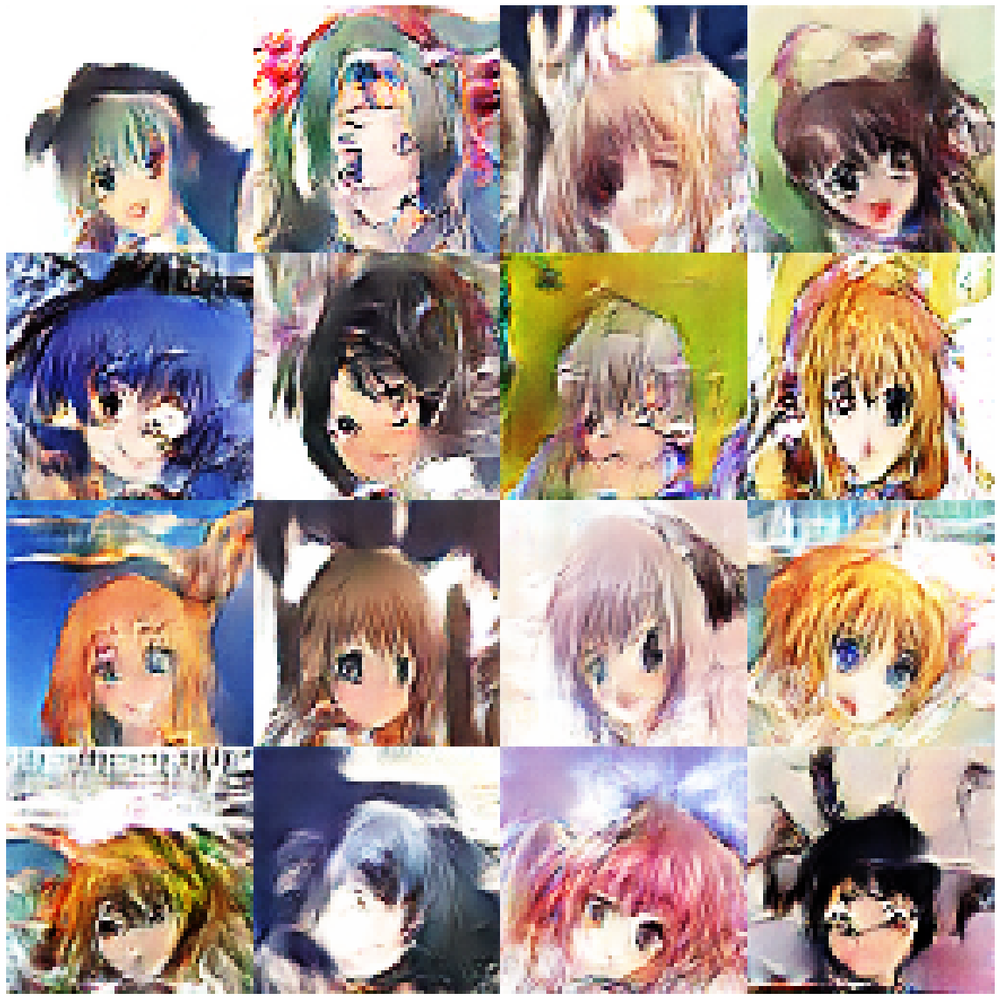

In [0]:
def generate_images(generator, save_dir):
    noise = gen_noise(batch_size,noise_shape)
    fake_data_X = generator.predict(noise)
    print("Displaying generated images")
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(fake_data_X.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = fake_data_X[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(save_dir+str(time.time())+"_GENERATEDimage.png",bbox_inches='tight',pad_inches=0)
    plt.show()

generate_images(generator, img_save_dir)

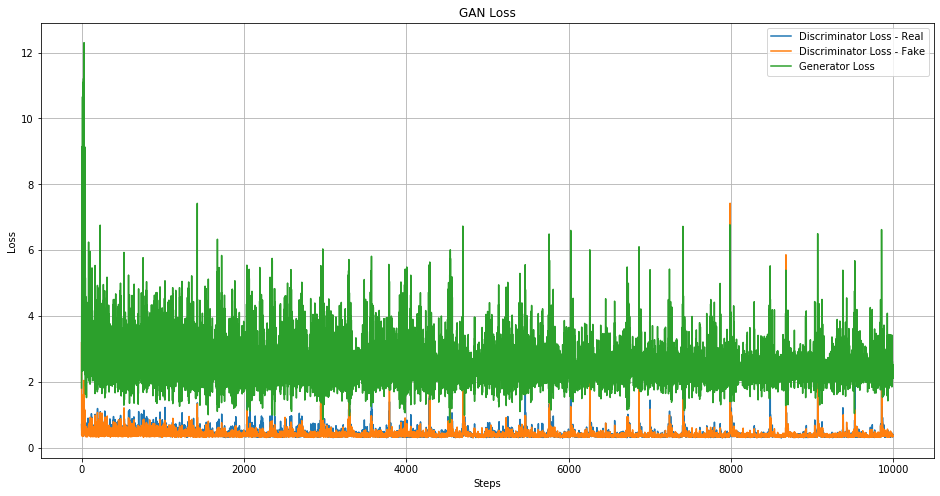

In [0]:
disc_real_loss = np.array(avg_disc_real_loss)
disc_fake_loss = np.array(avg_disc_fake_loss)
GAN_loss = np.array(avg_GAN_loss)

# Plot the losses vs training steps
plt.figure(figsize=(16,8))
plt.plot(range(0,num_steps), disc_real_loss, label="Discriminator Loss - Real")
plt.plot(range(0,num_steps), disc_fake_loss, label="Discriminator Loss - Fake")
plt.plot(range(0,num_steps), GAN_loss, label="Generator Loss")
plt.xlabel('Steps')
plt.ylabel('Loss')
plt.legend()
plt.title('GAN Loss')
plt.grid(True)
plt.show() 

In [0]:
#Generating GIF from PNGs
import imageio
# create a list of PNGs
generated_images = [img_save_dir+str(x).zfill(4)+"_image.png" for x in range(0,num_steps,100)]

In [0]:
images = []
for filename in generated_images:
    images.append(imageio.imread(filename))

imageio.mimsave(img_save_dir+'movie.gif', images) 

In [0]:
# from IPython.display import Image
# with open("images/movie.gif",'rb') as f:
#     display(Image(data=f.read(), format='png'))